In [103]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import pymc as pm
import matplotlib.cm as cm
import arviz as az
from sklearn.preprocessing import StandardScaler
import pytensor.tensor as pt
import matplotlib.cm as cm
import regionmask
import cartopy.crs as ccrs
import pandas as pd
import seaborn as sns
import pytensor
from scipy.signal import detrend
import scipy.stats as stats
%matplotlib inline

In [2]:
rng=np.random.default_rng(seed=123)

In [3]:
nada=xr.open_dataset("/Users/kmarvel/Documents/GEDA_BAYES/DATA/nada_hd2_cl.nc")
nada=nada.where(nada.pdsi>-90)

# Read in CRU TS 
Temperature, precipitation, PDSI from https://www.uea.ac.uk/web/groups-and-centres/climatic-research-unit/data

Accessed October 9, 2024

I want one array.  Time dimension is years.  PDSI is JJA average for that year.  T and P are the total for SOND (year before) and JFMAMJJA (that year)


In [4]:
def detrend_dim(da, dim, deg=1):
    # detrend along a single dimension
    p = da.polyfit(dim=dim, deg=deg)
    fit = xr.polyval(da[dim], p.polyfit_coefficients)
    return da - fit

In [5]:
def convert_timeaxis_years(X):
    return X.time.values.astype('datetime64[Y]').astype(int) + 1970

In [6]:
def latlon(location):
    dlatlon={}
    #Red Mesa, AZ
    dlatlon["RMA"]=(37.25,-109.25)
    #Dodge City, Kansas
    dlatlon["DCK"]=(37.75,-100.25)
    #Sonora Junction, California (Sierra Nevadas, near West Walk River, another hotspot of major drought activity)
    dlatlon["SJC"]=(38.25, -119.25)
    return dlatlon[location]
    


def fullname(location):
    dn={}
    dn["RMA"]="Red Mesa, Arizona"
    dn["DCK"]="Dodge City, Kansas"
    dn["SJC"]="Sonora Junction, California"

In [7]:
class OBS():
    def __init__(self,data=None):
        if data is not None:
            self.data=data
        else:
            #read in cru from datasets
            cru_t=xr.open_dataset("/Users/kmarvel/Documents/Reconstruction/DATA/cru_ts4.08.1901.2023.tmp.dat.nc")
            cru_p=xr.open_dataset("/Users/kmarvel/Documents/Reconstruction/DATA/cru_ts4.08.1901.2023.pre.dat.nc")
            cru_d=xr.open_dataset("/Users/kmarvel/Documents/Reconstruction/DATA/scPDSI.cru_ts4.08early1.1901.2023.cal_1901_23.bams.2024.GLOBAL.IGBP.WHC.1901.2023.nc")
            #select NADA region
            t_nada=cru_t.sel(lat=nada.lat,lon=nada.lon)
            p_nada=cru_p.sel(lat=nada.lat,lon=nada.lon)
            d_nada=cru_d.sel(latitude=nada.lat,longitude=nada.lon)

            ##### SUMMER PDSI #####
            seasonal_d = d_nada.resample(time='QS-DEC').mean('time')
            # get rid of the first JJA because we won't have September-December the year before
            jja_pdsi=seasonal_d.isel(time=np.arange(len(seasonal_d.time))[2::4]).isel(time=slice(1,None))
            PDSI=jja_pdsi.scpdsi
            

            ##### SEP-AUG PRECIPITATION#####
            # I hate time axes, why is this such a nightmare
            years=[x.astype('M8[Y]').astype(int) + 1970 for x in PDSI.time.values]
            months=["SEP","OCT","NOV","DEC","JAN","FEB","MAR","APR","MAY","JUN","JUL","AUG"]
            firstyear=years[0]
            lastyear=years[-1]
            truncated=p_nada.pre.sel(time=slice(str(firstyear-1)+"-09-01",str(lastyear)+"-08-31"))
            newcoords={}
            newcoords["lon"]=truncated.coords["lon"]
            newcoords["lat"]=truncated.coords["lat"]
            newcoords["year"]=years
            newcoords["month"]=months
            ntime,nlat,nlon=truncated.values.shape
            nyears=int(ntime/12)
            reshaped_data=truncated.values.reshape(nyears,12,nlat,nlon)
            PRECIP=xr.DataArray(data=reshaped_data,dims=("year","month","lat","lon"),coords=newcoords)

             ##### SEP-AUG TEMPERATURE #####
            truncated=t_nada.tmp.sel(time=slice(str(firstyear-1)+"-09-01",str(lastyear)+"-08-31"))
            newcoords={}
            newcoords["lon"]=truncated.coords["lon"]
            newcoords["lat"]=truncated.coords["lat"]
            newcoords["year"]=years
            newcoords["month"]=months
            ntime,nlat,nlon=truncated.values.shape
            nyears=int(ntime/12)
            reshaped_data=truncated.values.reshape(nyears,12,nlat,nlon)
            TEMP=xr.DataArray(data=reshaped_data,dims=("year","month","lat","lon"),coords=newcoords)

            self.data={}
            self.data["T"]=TEMP
            self.data["P"]=PRECIP
            self.data["D"]=PDSI
            
  

In [8]:
def get_seasonal(lat,lon,vari):
    X=cru.data[vari].sel(lat=lat,lon=lon)
    X_son=X.sel(month=["SEP","OCT","NOV"]).mean(dim="month").expand_dims({"season":["SON"],"vari":[vari]})
    X_djf=X.sel(month=["DEC","JAN","FEB"]).mean(dim="month").expand_dims({"season":["DJF"],"vari":[vari]})
    X_mam=X.sel(month=["MAR","APR","MAY"]).mean(dim="month").expand_dims({"season":["MAM"],"vari":[vari]})
    X_jja=X.sel(month=["JUN","JUL","AUG"]).mean(dim="month").expand_dims({"season":["JJA"],"vari":[vari]})
    seasonal=xr.concat([X_son,X_djf,X_mam,X_jja],dim="season")
    return seasonal 

In [9]:
cru=OBS()

In [10]:
gistemp_data=pd.read_csv("https://data.giss.nasa.gov/gistemp/tabledata_v4/GLB.Ts+dSST.csv",header=1)
gistemp_data["J-D"]
gistemp=xr.DataArray(data=gistemp_data["J-D"].values[:-1].astype(np.float32),\
                     dims=("year"),\
                     coords={"year":gistemp_data["Year"].values[:-1]}).rename("tas")

In [11]:
### Define a helper function that will construct our vector autoregressive step for the marginal contribution of each previous
### term in each of the respective time series equations
def calc_var_step(lag_coefs, dataset):
    n_vars, n_cross,n_lags=lag_coefs.shape#.eval()
    ars = []
    for k in range(len(coords["vari"])):
        ar_cross=[]
        for j in range(len(coords["cross_vari"])):
            ar_lags=[]
            for i in range(nlags):
                ar_lags.append(lag_coefs[k,j,i]* dataset[j,(i+1):])
            sum_lags=pm.math.sum(ar_lags,axis=0)
            
            ar_cross.append(sum_lags)
        sum_cross=pm.math.sum(ar_cross,axis=0)
        ars.append(sum_cross)
    return pm.math.stack(ars,axis=-1)
 

In [12]:
class Reconstructor():
    def __init__(self,\
                 region,
                 training_period=(1950,2005),\
                 validation_period=(1902,1949),\
                reconstruction_period=(1000,1901)):
        
        self.training_period=training_period
        self.validation_period=validation_period
        self.reconstruction_period=reconstruction_period
        self.region=region
        
        lat,lon=latlon(self.region)
        
        self.lat=lat
        self.lon=lon
        
        T= cru.data["T"].sel(lat=lat,lon=lon).expand_dims({"vari":["T"]})
        P= cru.data["P"].sel(lat=lat,lon=lon).expand_dims({"vari":["P"]}) 
            #M=xr.concat([T.expand_dims({"vari":["T"]}),P.expand_dims({"vari":["P"]})],dim="vari")  
        
        #normalize both
        #T is assumed normally distributed
        muT=T.sel(year=slice(*self.training_period)).mean(dim="year")
        sigT=T.sel(year=slice(*self.training_period)).std(dim="year")
        Tz=(T-muT)/sigT
        
        #Assume P is gamma distributed
        
        self.gamma_params={}
        #Get rid of zero values- gamma asymptotes to zero
        Pm=P.where(P!=0,.0001)
        spis=[]
        for month in P.month.values:
            
            traindata=Pm.sel(month=month,vari="P",year=slice(*self.training_period))
            iszero=np.where(traindata==0)
            #print(iszero)
            alldata=P.sel(month=month,vari="P")
            shape,loc,scale=stats.gamma.fit(traindata.values,floc=0)
            
            self.gamma_params[month]=[shape,loc,scale]
            cumulative_prob = stats.gamma.cdf(alldata.values, shape, loc, scale)
            #spis=stats.norm.ppf(cumulative_prob)
            
            data=stats.norm.ppf(cumulative_prob).ravel()
            da=xr.DataArray(\
                data,\
                dims=("year"),\
                coords=({"year":alldata.coords["year"].values})\
                ).expand_dims({"month":[month]})
            #set -inf to -2 (these will correspond to zero precipitation)
            da=da.where(da.values!=-np.inf,-2.57)
            
            spis += [da]
        Pz=xr.concat(spis,dim="month").expand_dims({"vari":["P"]})
        
        M=xr.concat([T,P],dim="vari").transpose("month","vari","year")    
        Mz=xr.concat([Tz,Pz],dim="vari").transpose("month","vari","year")    
        
        #We only have JJA PDSI
        D=nada.sel(lat=self.lat,lon=self.lon).pdsi
        D=D.rename(time="year")

        #######(HACK for offline: fix this)########
        #Global mean temperature: JJA for now 
        gistemp_data=pd.read_csv("https://data.giss.nasa.gov/gistemp/tabledata_v4/GLB.Ts+dSST.csv",header=1)
        G=xr.DataArray(data=gistemp_data["JJA"].values[:-1].astype(np.float32),\
                     dims=("year"),\
                     coords={"year":gistemp_data["Year"].values[:-1]}).rename("tas")
        #G=gistemp
        self.raw={}
        self.raw["M"]=M
        self.raw["D"]=D
        self.raw["G"]=G
        
        #means and std over the training period
        self.means={}
        #self.means["T"]=float(T.sel(year=slice(*training_period)).mean(dim="year"))
        #self.means["P"]=float(P.sel(year=slice(*training_period)).mean(dim="year"))
        self.means["M"]=M.sel(year=slice(*self.training_period)).mean(dim="year")
        self.means["D"]=float(D.sel(year=slice(*self.training_period)).mean(dim="year"))
        self.means["G"]=float(gistemp.sel(year=slice(*self.training_period)).mean())

        self.stds={}
       #self.stds["T"]=float(T.sel(year=slice(*training_period)).std(dim="year"))
       # self.stds["P"]=float(P.sel(year=slice(*training_period)).std(dim="year"))
        self.stds["M"]=M.sel(year=slice(*self.training_period)).std(dim="year")
        self.stds["D"]=float(D.sel(year=slice(*self.training_period)).std(dim="year"))
        self.stds["G"]=float(gistemp.sel(year=slice(*self.training_period)).std())

        self.z={}
        self.z["M"]=Mz
        # self.z["T"]=(T-self.means["T"])/self.stds["T"]
        # self.z["P"]=(P-self.means["P"])/self.stds["P"]
        #self.z["M"]=(M-self.means["M"])/self.stds["M"]
        self.z["D"]=(D-self.means["D"])/self.stds["D"]
        self.z["G"]=(G-self.means["G"])/self.stds["G"]

       

        self.train={}
        self.train["M"]=self.z["M"].sel(year=slice(*self.training_period))#.values
        self.train["G"]=self.z["G"].sel(year=slice(*self.training_period))#.values
        self.train["D"]=self.z["D"].sel(year=slice(*self.training_period))#.values
        
        self.train["M_flat"]=self.train["M"].stack(smooshed=("month","vari"))

        
        self.val={}
        self.val["M"]=self.z["M"].sel(year=slice(*self.validation_period))#.values
        self.val["G"]=self.z["G"].sel(year=slice(*self.validation_period))#.values
        self.val["D"]=self.z["D"].sel(year=slice(*self.validation_period))#.values
      
        self.val["M_flat"]=self.val["M"].stack(smooshed=("month","vari"))

        self.recon={}
        # We don't have G or M over the reconstriction period
        self.recon["D"]=self.z["D"].sel(year=slice(*self.reconstruction_period))#.values

        self.taxes={}
        self.taxes["train"]=self.z["M"].sel(year=slice(*self.training_period)).year.values
        self.taxes["val"]=self.z["M"].sel(year=slice(*self.validation_period)).year.values
        self.taxes["recon"]=self.z["D"].sel(year=slice(*self.reconstruction_period)).year.values

        #modeling global mean temperature preindustrial
        self.Gsigma=float(detrend(self.val["G"]).std())
        self.Gmean=float(self.val["G"][:20].mean())
            
            
    def make_model(self,overwrite_trace=False):
        
        nlags=1
        smooshed=["_".join(x) for x in self.train["M_flat"].smooshed.values]
        coords={"vari":["T","P"],\
                "time_train":self.taxes["train"][:-nlags],\
               "cross_vari":["T","P"],\
               "lags":[1],\
               "time_validate":self.taxes["val"],
               "time_recon":self.taxes["recon"],\
               "month":self.val["M"].month.values,\
               "smoosh":smooshed,\
               "cross_smoosh":smooshed}
        
        with pm.Model(coords=coords) as self.model:
            ###################
            #                 #
            # LEARN the prior #
            #                 #
            ###################

            Dobs=np.concatenate([self.val["D"],self.train["D"]])

            # prior on global temperature regression slope
            gamma=pm.Normal("gamma",0,1,dims=["month","vari"])
            
            # assumed forced response regresses on global mean temperature
            Ftrain=pm.math.stack([\
                pm.math.stack([gamma[j,k]*self.train["G"].values[:-nlags] for k in range(len(coords["vari"]))])\
                for j in range(len(coords["month"]))])
            
            Ftrain_flat=Ftrain\
            .reshape((len(coords["smoosh"]),len(coords["time_train"])))
            
            # covariance between T and P at time t (Cholesky decomposition)
            noise_chol, _, _ = pm.LKJCholeskyCov(
                "noise_chol",
                eta=1,
                n=len(coords["smoosh"]),
                sd_dist=pm.HalfNormal.dist(sigma=1))
            #For display: reconstitute Cholesky -> cov
            cov = pm.Deterministic('cov', noise_chol.dot(noise_chol.T),dims=("smoosh","cross_smoosh")) 
            
            #Likelihood for Mobs.  Press the inference button to get posteriors for gamma and noise
            lik_Mobs = pm.MvNormal("lik_Mobs",mu=Ftrain_flat.T,chol=noise_chol,observed=self.train["M_flat"].values[:-1,:])    
            
              #################
            #               #
            # TRAINING data #
            #               #
            #################
            
            
            #AR(1) model for D
            #beta is the dependence on same-year meteorology
            beta=pm.Normal("beta",0,1,dims=("month","vari"))
            #L is the dependence on previous-year meteorology- removed because model doesn't perform better
            #L=pm.Normal("L",0,1,dims=self.train["M"].dims[:-1])
            #Rho is the dependence on previous-year soil moisture
            rhoD=pm.Normal("rhoD",0,1)
            #sigma is the Gaussian noise
            sigmaD=pm.HalfNormal("sigmaD",1)
        
           
          
            #Learn parameters from observations
            #soil moisture "memory"
            Dar=rhoD*self.train["D"].values[:-1] 
           
            
            #Dependence on that year's meteorology
            Mr=self.train["M"].isel(year=slice(1,None)).values
            Mprev=self.train["M"].isel(year=slice(None,-1)).values
            
            Dmean= pm.math.sum([
                pm.math.sum([beta[j,k]*Mr[j,k,:] for k in range(len(coords["vari"]))],axis=0) \
                 for j in range(len(coords["month"]))],axis=0)
                
            
            # Dprev=pm.math.sum([
            #     pm.math.sum([L[j,k]*Mprev[j,k,:] for k in range(len(coords["vari"]))],axis=0) \
            #      for j in range(len(coords["month"]))],axis=0)
           
        
            mu_train=Dmean+Dar
        
            
            D_train_likelihood=pm.Normal("Dtrain_lik",mu=mu_train,sigma=sigmaD,observed=self.train["D"].values[1:])
         
        
           #  ###################
           #  #                 #
           #  # VALIDATION data #
           #  #                 #
           #  ###################
        
            # can also use posterior mean of M model if not wrapped in a single large model
            #gamma=Mtrace_mon.posterior.gamma.mean(dim=("chain","draw")).values
          
           
            #cov=Mtrace_mon.posterior.cov.mean(dim=("chain","draw")).values
            
            global_mean_temperature_val=self.val["G"].values
            
            Fval=pm.Deterministic("Fval",\
                pm.math.stack([\
                pm.math.stack([gamma[j,k]*global_mean_temperature_val for k in range(len(coords["vari"]))])\
                for j in range(len(coords["month"]))])\
                                  ,dims=("month","vari","time_validate"))
            
            Fval_flat=Fval\
            .reshape((len(coords["smoosh"]),len(coords["time_validate"])))
            
        
            #prior on the unobserved meterology: use learned posterior means
        
            #First, get the flattened Mval- should have dimensions (nt x nsmoosh)
            
            Mval_flat=pm.MvNormal("Mval_flat",mu=Fval_flat.T,cov=cov)
        
            #now reshape it
            Mval=pm.Deterministic("Mval",Mval_flat.reshape(self.val["M_flat"].unstack().shape),\
                                  dims=("time_validate", 'month', 'vari'))
            
         
            #dependence on same-year meteorology
            
            Dmean_val=pm.math.sum([\
            pm.math.sum([beta[j,k]*Mval[1:,j,k] for k in range(len(coords["vari"]))],axis=0)\
            for j in range(len(coords["month"]))],axis=0)
            #print(Dmean_val.shape.eval())
            
            #dependence on previous-year PDSI
            Dar_val=rhoD*self.val["D"].values[:-1]
           # print(Dar_val.shape.eval())
            mu_val=Dmean_val+Dar_val
            D_val_likelihood=pm.Normal("Dval_lik",\
                                                mu=mu_val,\
                                                sigma=sigmaD,\
                                                observed=self.val["D"].values[1:])
                   
           #  #######################
           #  #                     #
           #  # RECONSTRUCTION data #
           #  #                     #
           #  #######################
        
            global_mean_temperature_recon=pm.Normal("G_recon",mu=self.Gmean,sigma=self.Gsigma,dims=("time_recon"))
            
            Frecon=pm.Deterministic("Frecon",\
                pm.math.stack([\
                pm.math.stack([gamma[j,k]*global_mean_temperature_recon for k in range(len(coords["vari"]))])\
                for j in range(len(coords["month"]))])\
                                  ,dims=("month","vari","time_recon"))
            
            Frecon_flat=Frecon\
            .reshape((len(coords["smoosh"]),len(coords["time_recon"])))
            
            Mrecon_flat=pm.MvNormal("Mrecon_flat",mu=Frecon_flat.T,cov=cov,dims=("time_recon","smoosh"))
            
        
            #now reshape it
            rdims=('time_recon', 'month', 'vari')
            rshape=tuple([len(coords[rdim]) for rdim in rdims])
            Mrecon=pm.Deterministic("Mrecon",Mrecon_flat.reshape(rshape),\
                                         dims=rdims)
            
         
           
                #dependence on same-year meteorology
                
            Dmean_recon=pm.math.sum([\
            pm.math.sum([beta[j,k]*Mrecon[1:,j,k] for k in range(len(coords["vari"]))],axis=0)\
            for j in range(len(coords["month"]))],axis=0)
           
        
            #dependence on previous-year PDSI
            Dar_recon=rhoD*self.recon["D"].values[:-1]
           # print(Dar_val.shape.eval())
            mu_recon=Dmean_recon+Dar_recon
            D_recon_likelihood=pm.Normal("Dval_recon",\
                                                mu=mu_recon,\
                                                sigma=sigmaD,\
                                                observed=self.recon["D"].values[1:])
            if overwrite_trace:
                self.trace=pm.sample()
                self.trace.to_netcdf("../RESULTS/TRACES/"+self.region+"_monthly.nc")
            else:
                self.trace=az.from_netcdf("../RESULTS/TRACES/"+self.region+"_monthly.nc")
        
    def recover_original_units(self,spi=None,spir=None):
        
        if not hasattr(self,"trace"):
            self.make_model(trace=True)
        spi=self.trace.posterior.Mval
        spir=self.trace.posterior.Mrecon
        self.pred={}
        
        put_back=[]
        for month in self.raw["M"].month.values:
            spi_mon=spi.sel(vari="P",month=month)
            cumulative_prob = stats.norm.cdf(spi_mon)
            shape,loc,scale=self.gamma_params[month]
            recovered_precip = stats.gamma.ppf(cumulative_prob, shape, loc, scale)
            da=xr.DataArray(recovered_precip,dims=spi_mon.dims,coords=spi_mon.coords).expand_dims({"month":[month]})
            put_back+=[da]
        Pval_orig=xr.concat(put_back,dim="month")
        
        put_backr=[]
        for month in self.raw["M"].month.values:
            spir_mon=spir.sel(vari="P",month=month)
            cumulative_probr = stats.norm.cdf(spir_mon)
            shape,loc,scale=self.gamma_params[month]
            recovered_precipr = stats.gamma.ppf(cumulative_probr, shape, loc, scale)
            dar=xr.DataArray(recovered_precipr,dims=spir_mon.dims,coords=spir_mon.coords).expand_dims({"month":[month]})
            put_backr+=[dar]
        Precon_orig=xr.concat(put_backr,dim="month")

        Tval_orig=((self.stds["M"] * self.trace.posterior.Mval)+self.means["M"]).sel(vari="T")
        Trecon_orig=((self.stds["M"] * self.trace.posterior.Mrecon)+self.means["M"]).sel(vari="T")
        
        self.pred["val"]=xr.concat([Tval_orig.expand_dims({"vari":["T"]}),\
                          Pval_orig.expand_dims({"vari":["P"]})],\
                          dim="vari")
        self.pred["recon"]=xr.concat([Trecon_orig.expand_dims({"vari":["T"]}),\
                          Precon_orig.expand_dims({"vari":["P"]})],\
                          dim="vari")

        
    
    def plot_validation(self,months=None,hdi_prob=.9):
        if not hasattr(self,"pred"):
            self.recover_original_units()
        if months is None:
            months=self.raw["M"].month
        plt.subplot(121)
        V=self.raw["M"].sel(month=months,year=slice(*self.validation_period)).mean(dim="month").values
        tax=self.taxes["val"]
        az.plot_hdi(tax,self.pred["val"].sel(month=months,vari="T").mean(dim="month"),smooth=False,hdi_prob=hdi_prob)
        plt.plot(tax,V[0],"-o")
        plt.subplot(122)
        tax=self.taxes["val"]
        az.plot_hdi(tax,self.pred["val"].sel(month=months,vari="P").mean(dim="month"),smooth=False,hdi_prob=hdi_prob)
        plt.plot(tax,V[1],"-o")
    def plot_posteriors(self,var_names=None):
        if var_names==None:
            var_names=["L","beta","rhoD","gamma","cov"]
        if not hasattr(self,"trace"):
            self.sample()
        az.plot_posterior(self.trace,var_names=var_names,ref_val=0)   
    def plot_posterior_predictive(self,**hdikwargs):
        if not hasattr(self,"pp"):
            with self.model:
                self.pp=pm.sample_posterior_predictive(self.trace,var_names=["Dtrain_lik"])
        az.plot_hdi(self.taxes["train"][1:],self.pp.posterior_predictive.Dtrain_lik,smooth=False,**hdikwargs)
        plt.plot(self.taxes["train"],self.train["D"].values)
            
            

        



In [45]:
DCK=Reconstructor("DCK")
DCK.make_model(overwrite_trace=False)
DCK.recover_original_units()

In [46]:
RMA=Reconstructor("RMA")
RMA.make_model(overwrite_trace=False)
RMA.recover_original_units()
SJC=Reconstructor("SJC")
SJC.make_model(overwrite_trace=False)
SJC.recover_original_units()

In [37]:
with az.style.context("arviz-brownish"):
    SJC.plot_posterior_predictive(hdi_prob=.66)
plt.ylabel("D (z-score)")

Text(0, 0.5, 'D (z-score)')

In [38]:
with az.style.context("arviz-brownish"):
    RMA.plot_posterior_predictive(hdi_prob=.66)
plt.ylabel("D (z-score)")

Sampling: [Dtrain_lik]


Text(0, 0.5, 'D (z-score)')

In [39]:
with az.style.context("arviz-brownish"):
    DCK.plot_posterior_predictive(hdi_prob=.66)
plt.ylabel("D (z-score)")


Sampling: [Dtrain_lik]


Text(0, 0.5, 'D (z-score)')

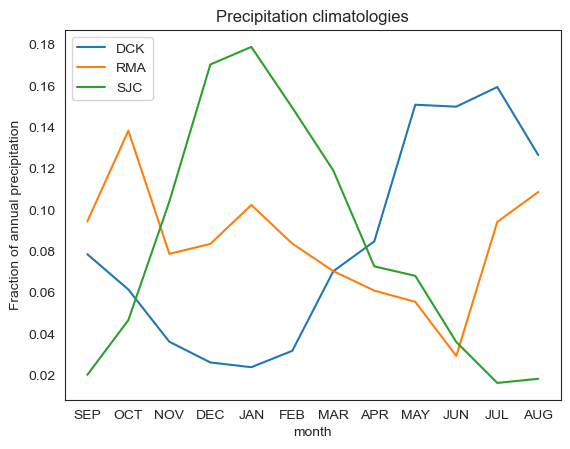

In [41]:
fig=plt.figure()
for X in [DCK,RMA,SJC]:
    tst=X.means["M"].sel(vari="P")/X.means["M"].sel(vari="P").sum()
    tst.plot(label=X.region)
    

#SJC.means["M"].sel(vari="P").plot(label="SJC")
plt.legend()
plt.title("Precipitation climatologies")
plt.ylabel("Fraction of annual precipitation")
plt.savefig("../RESULTS/FIGS/Pclim.pdf")
plt.show()


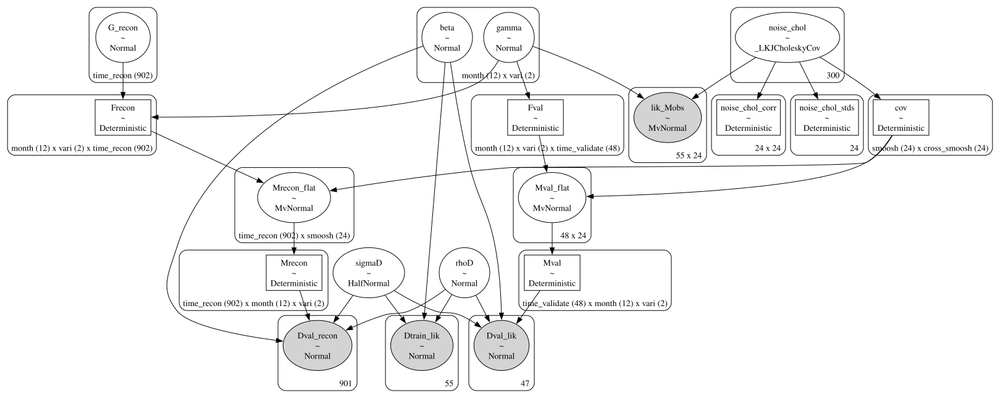

In [16]:
SJC.model.to_graphviz()

In [33]:
def violinplot(trace,varname,ax=None):
   
    X=getattr(trace.posterior,varname)
    # X = xr.DataArray(np.random.randn(4, 1000, 12, 2), 
    #                  dims=["chain", "draw", "month", "vari"])
    
    # Convert to pandas DataFrame
    df = X.to_dataframe(name=varname).reset_index()

    sns.set_theme(style="whitegrid")
   
    my_pal={"T":"r","P":"b"}
    sns.violinplot(data=df, x='month', y=varname, hue='vari', split=True,inner="quart",gap=0.2,palette=my_pal,ax=ax)
    ax.axhline(0,c="k",ls=":")

Sampling: [Dtrain_lik]


/var/folders/l8/1gztm4113nxdtdj6k7cd03b40000gp/T/ipykernel_74477/3437515597.py:37: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


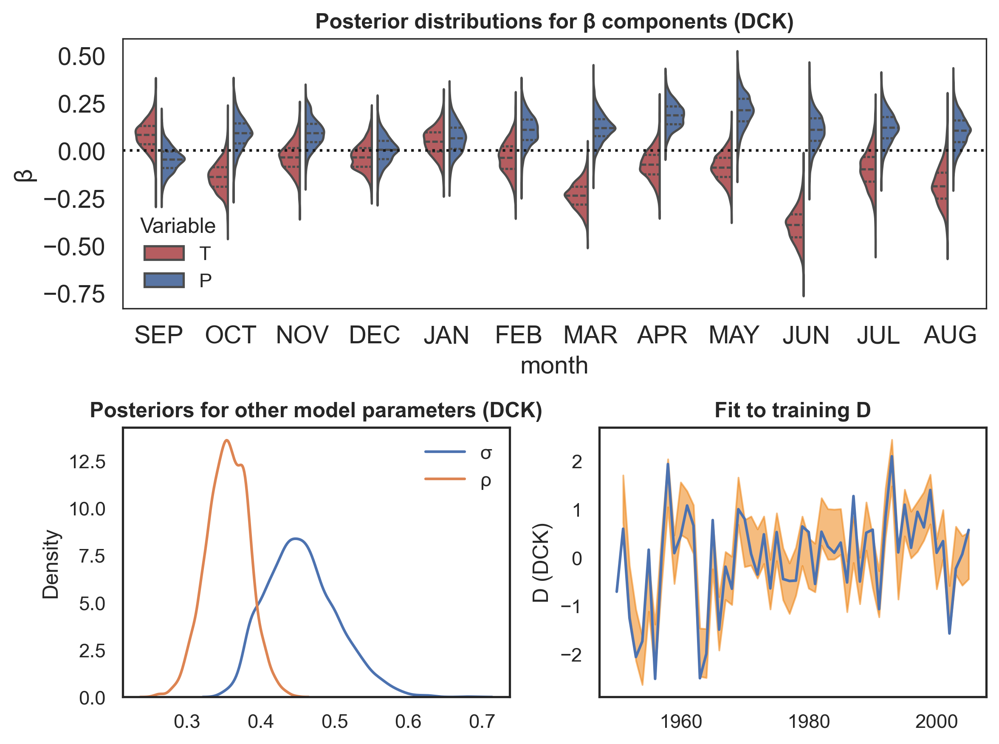

In [232]:
sns.set_style("white")
from matplotlib.gridspec import GridSpec

# Create a figure
fig = plt.figure(figsize=(8, 6))

# Create a GridSpec to control subplot layout
gs = GridSpec(2, 2, figure=fig)

# Subplot 1 spans the top two panels (rows 0-1, columns 0-1)
ax1 = fig.add_subplot(gs[0, :])  # Spans the first row
violinplot(DCK.trace,"beta",ax=ax1)
leg=plt.gca().legend()
leg.set_title("Variable")
leg.set_loc("lower left")
leg.set_ncols(0)
plt.ylabel("β")
ax1.set_title('Posterior distributions for β components (DCK)')

# Subplot 2 spans the bottom-left panel (row 1, column 0)
sns.set_style("white")
ax2 = fig.add_subplot(gs[1, 0])
sns.kdeplot(DCK.trace.posterior.sigmaD.stack(samples=("chain","draw")),label="σ")
sns.kdeplot(DCK.trace.posterior.rhoD.stack(samples=("chain","draw")),label="ρ")
ax2.legend()
ax2.set_title('Posteriors for other model parameters (DCK)')

# Subplot 3 spans the bottom-right panel (row 1, column 1)
sns.set_style("white")
ax3 = fig.add_subplot(gs[1, 1])
ax3.set_title('Fit to training D')
with az.style.context("arviz-brownish"):
    DCK.plot_posterior_predictive(hdi_prob=.66)
plt.ylabel("D (DCK)")

# Adjust layout to prevent overlapping titles
plt.tight_layout()
#plt.savefig("../RESULTS/FIGS/DCK_model_posteriors.pdf")

/var/folders/l8/1gztm4113nxdtdj6k7cd03b40000gp/T/ipykernel_74477/1303912346.py:30: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(ax2.get_xticklabels(), size=8)


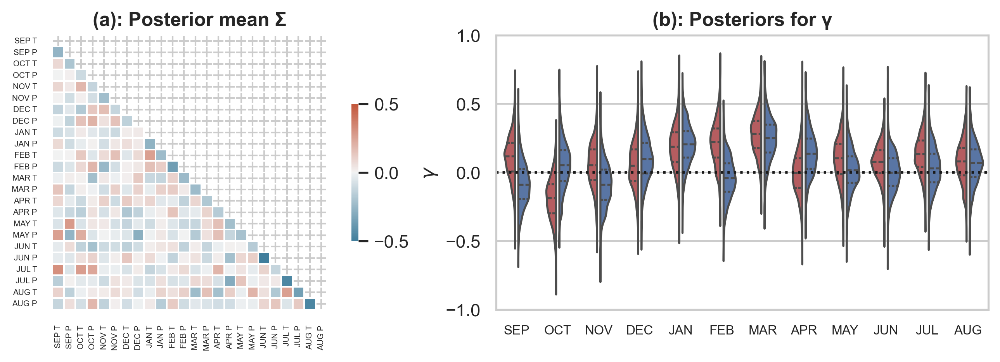

In [336]:
#az.style.use("arviz-default")
covmean=DCK.trace.posterior.cov.mean(dim=("chain","draw"))

Mcov=covmean
mask = np.triu(np.ones_like(Mcov, dtype=bool))
smooshed=[" ".join(x.split("_")) for x in covmean.smoosh.values]

# Set up the matplotlib figure
f=plt.figure(figsize=(10, 3))
ax=f.add_subplot(121)
#f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.heatmap(Mcov, mask=mask, cmap=cmap, vmax=.5,vmin=-.5, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5},ax=ax)
#plt.xticks(np.arange(len(smooshed))[::12],[x.split("_SEP")[0] for x in smooshed[::12]])
#plt.yticks(np.arange(len(smooshed))[::12],[x.split("_SEP")[0] for x in smooshed[::12]])
plt.xticks(np.arange(len(smooshed))+.5,smooshed,rotation=90,fontsize=5)
plt.yticks(np.arange(len(smooshed))+.5,smooshed,rotation=0, fontsize=5)
Mcov_masked=np.ma.masked_where(mask,Mcov.values)
ax2=f.add_subplot(122)

violinplot(DCK.trace,"gamma",ax=ax2)
ax2.set_ylabel(r"$\gamma$")

leg=ax2.get_legend()

leg.set_title("Variable")
ax2.set_xticklabels(ax2.get_xticklabels(), size=8)
#ax2.set_yticklabels(ax2.get_yticks(), size=5)
ax2.set_ylim(-1,1)

plt.setp(ax2.get_legend().get_texts(), fontsize='5')
plt.setp(ax2.get_legend().get_title(), fontsize='5') 
ax2.set_xlabel("")
leg.set_ncols(2)
leg.set_loc("lower left")
ax2.set_yticks([-1,-.5,0,.5,1])
leg.set_visible(False)
ax2.set_title("(b): Posteriors for γ")
ax.set_title("(a): Posterior mean Σ")
#ax2.set_xt
# leg.set_fontsize(5)
# i,j=np.unravel_index(np.argmin(Mcov_masked),Mcov.shape)
# print(smooshed[i],smooshed[j])
#plt.savefig("../RESULTS/FIGS/Covariance_DCK.pdf")

/var/folders/l8/1gztm4113nxdtdj6k7cd03b40000gp/T/ipykernel_74477/1549204600.py:10: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


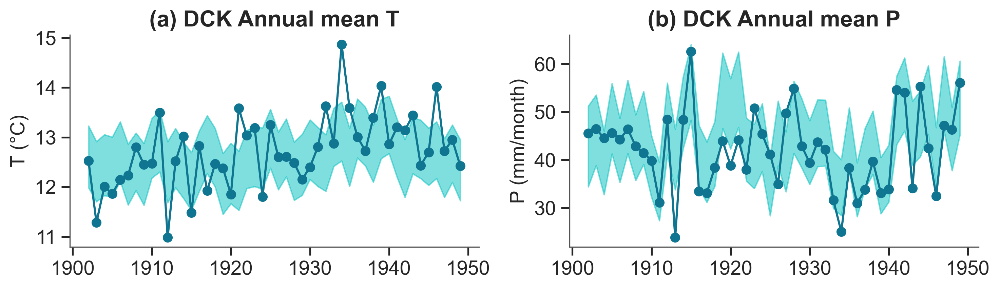

In [1115]:
fig=plt.figure(figsize=(10,3))
#DCK.plot_validation(months=["JUN","JUL","AUG"],hdi_prob=.66)
az.style.use("arviz-doc")
DCK.plot_validation(hdi_prob=.66)

fig.axes[0].set_title("(a) DCK Annual mean T")
fig.axes[0].set_ylabel("T (°C)")
fig.axes[1].set_title("(b) DCK Annual mean P")
fig.axes[1].set_ylabel("P (mm/month)")
plt.tight_layout()
#plt.savefig("../RESULTS/FIGS/DCK_annual_mean_validation.pdf")

/var/folders/l8/1gztm4113nxdtdj6k7cd03b40000gp/T/ipykernel_74477/455249495.py:10: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


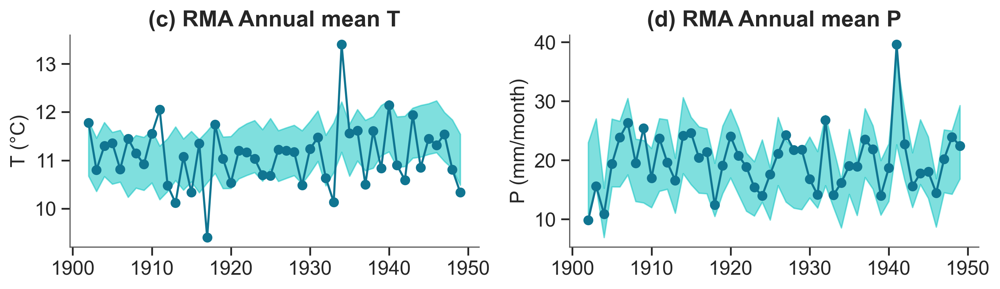

In [1118]:
fig=plt.figure(figsize=(10,3))
#DCK.plot_validation(months=["JUN","JUL","AUG"],hdi_prob=.66)
az.style.use("arviz-doc")
RMA.plot_validation(hdi_prob=.66)

fig.axes[0].set_title("(c) RMA Annual mean T")
fig.axes[0].set_ylabel("T (°C)")
fig.axes[1].set_title("(d) RMA Annual mean P")
fig.axes[1].set_ylabel("P (mm/month)")
plt.tight_layout()
#plt.savefig("../RESULTS/FIGS/RMA_annual_mean_validation.pdf")

/var/folders/l8/1gztm4113nxdtdj6k7cd03b40000gp/T/ipykernel_74477/3148673485.py:10: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


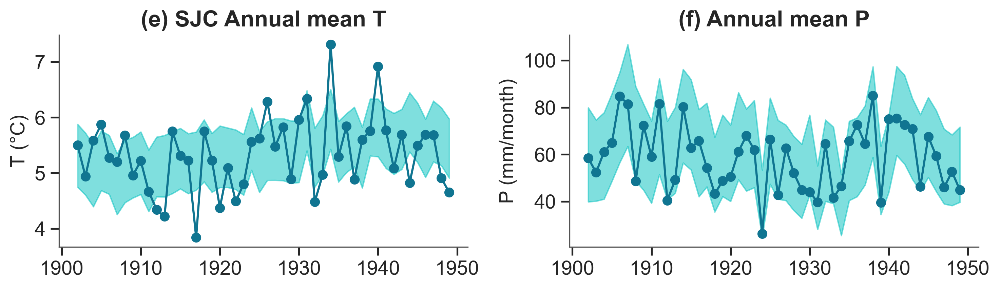

In [1117]:
fig=plt.figure(figsize=(10,3))
#DCK.plot_validation(months=["JUN","JUL","AUG"],hdi_prob=.66)
az.style.use("arviz-doc")
SJC.plot_validation(hdi_prob=.66)

fig.axes[0].set_title("(e) SJC Annual mean T")
fig.axes[0].set_ylabel("T (°C)")
fig.axes[1].set_title("(f) Annual mean P")
fig.axes[1].set_ylabel("P (mm/month)")
plt.tight_layout()
#plt.savefig("../RESULTS/FIGS/SJC_annual_mean_validation.pdf")

Sampling: [Dtrain_lik]


/var/folders/l8/1gztm4113nxdtdj6k7cd03b40000gp/T/ipykernel_74477/817290432.py:37: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


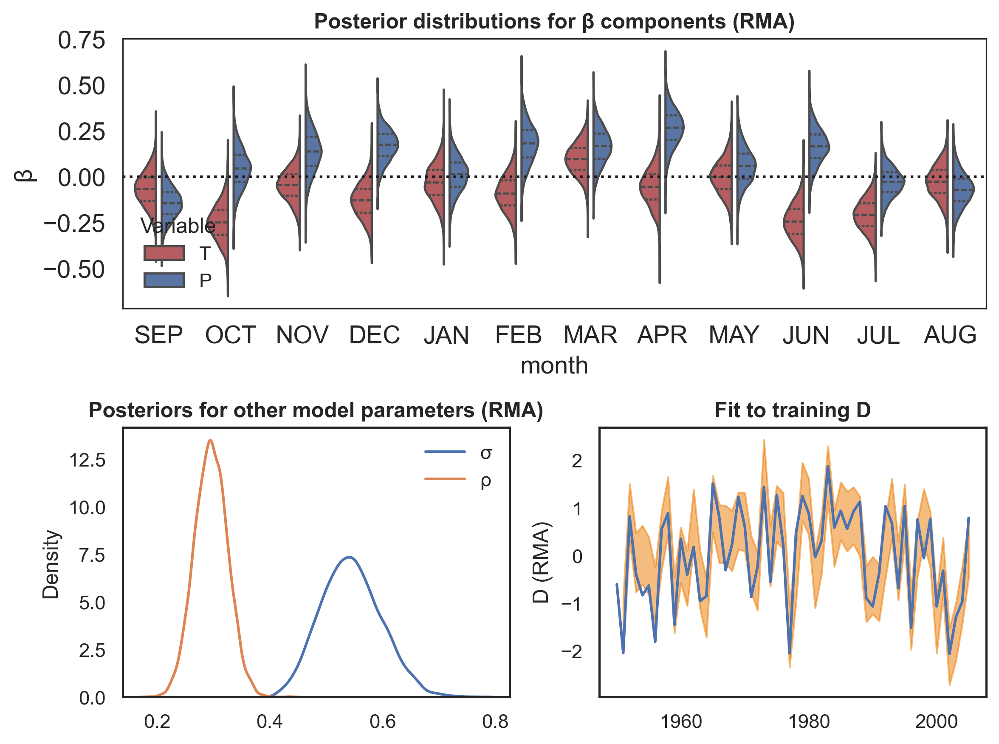

In [244]:
sns.set_style("white")
from matplotlib.gridspec import GridSpec

# Create a figure
fig = plt.figure(figsize=(8, 6))

# Create a GridSpec to control subplot layout
gs = GridSpec(2, 2, figure=fig)

# Subplot 1 spans the top two panels (rows 0-1, columns 0-1)
ax1 = fig.add_subplot(gs[0, :])  # Spans the first row
violinplot(RMA.trace,"beta",ax=ax1)
leg=plt.gca().legend()
leg.set_title("Variable")
leg.set_loc("lower left")
leg.set_ncols(0)
plt.ylabel("β")
ax1.set_title('Posterior distributions for β components (RMA)')

# Subplot 2 spans the bottom-left panel (row 1, column 0)
sns.set_style("white")
ax2 = fig.add_subplot(gs[1, 0])
sns.kdeplot(RMA.trace.posterior.sigmaD.stack(samples=("chain","draw")),label="σ")
sns.kdeplot(RMA.trace.posterior.rhoD.stack(samples=("chain","draw")),label="ρ")
ax2.legend()
ax2.set_title('Posteriors for other model parameters (RMA)')

# Subplot 3 spans the bottom-right panel (row 1, column 1)
sns.set_style("white")
ax3 = fig.add_subplot(gs[1, 1])
ax3.set_title('Fit to training D')
with az.style.context("arviz-brownish"):
    RMA.plot_posterior_predictive(hdi_prob=.66)
plt.ylabel("D (RMA)")

# Adjust layout to prevent overlapping titles
plt.tight_layout()
#plt.savefig("../RESULTS/FIGS/RMA_model_posteriors.pdf")

Sampling: [Dtrain_lik]


/var/folders/l8/1gztm4113nxdtdj6k7cd03b40000gp/T/ipykernel_74477/1138439888.py:37: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


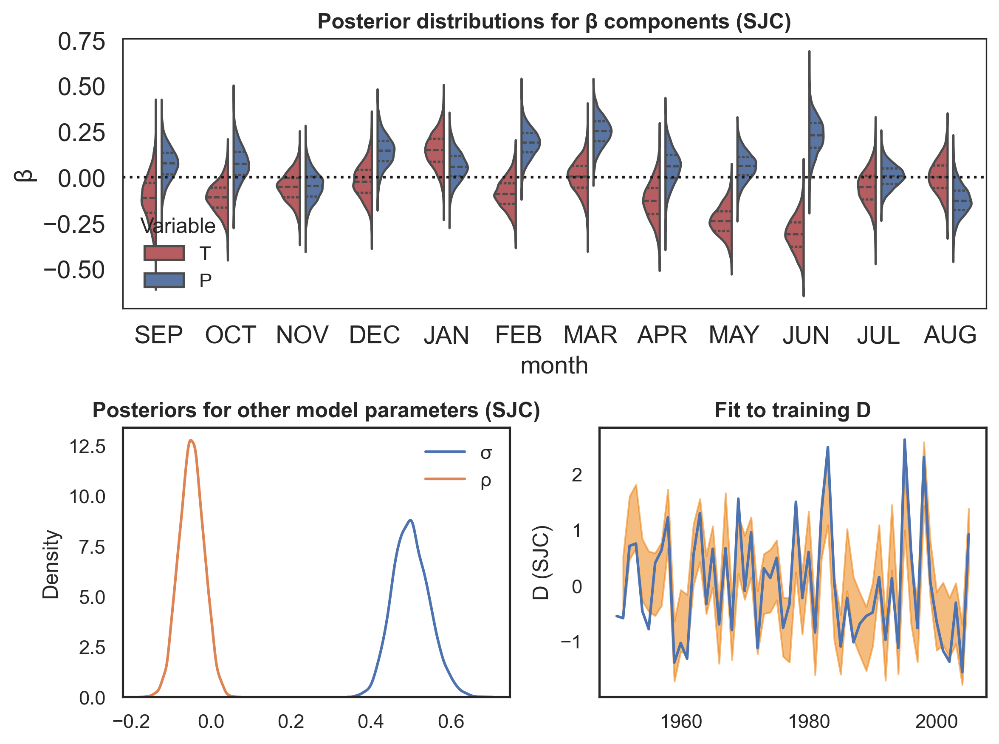

In [248]:
sns.set_style("white")
from matplotlib.gridspec import GridSpec

# Create a figure
fig = plt.figure(figsize=(8, 6))

# Create a GridSpec to control subplot layout
gs = GridSpec(2, 2, figure=fig)

# Subplot 1 spans the top two panels (rows 0-1, columns 0-1)
ax1 = fig.add_subplot(gs[0, :])  # Spans the first row
violinplot(SJC.trace,"beta",ax=ax1)
leg=plt.gca().legend()
leg.set_title("Variable")
leg.set_loc("lower left")
leg.set_ncols(0)
plt.ylabel("β")
ax1.set_title('Posterior distributions for β components (SJC)')

# Subplot 2 spans the bottom-left panel (row 1, column 0)
sns.set_style("white")
ax2 = fig.add_subplot(gs[1, 0])
sns.kdeplot(SJC.trace.posterior.sigmaD.stack(samples=("chain","draw")),label="σ")
sns.kdeplot(SJC.trace.posterior.rhoD.stack(samples=("chain","draw")),label="ρ")
ax2.legend()
ax2.set_title('Posteriors for other model parameters (SJC)')

# Subplot 3 spans the bottom-right panel (row 1, column 1)
sns.set_style("white")
ax3 = fig.add_subplot(gs[1, 1])
ax3.set_title('Fit to training D')
with az.style.context("arviz-brownish"):
    SJC.plot_posterior_predictive(hdi_prob=.66)
plt.ylabel("D (SJC)")

# Adjust layout to prevent overlapping titles
plt.tight_layout()
#plt.savefig("../RESULTS/FIGS/SJC_model_posteriors.pdf")

In [1181]:
# D in 1913 isn't particularly low
year=1913
self=DCK
self.val["D"].sel(year=year).values
import scipy.spatial.distance as spatial
VI=DCK.trace.posterior.cov.mean(dim=("chain","draw"))
VI.shape
#spatial.mahalanobis(


(24, 24)

In [34]:
#1915: observations are a bit rainier than expected, and much colder


def plot_lowest(self,ylim=None,xlim=None):
    year=self.taxes["val"][self.val["M"].sel(vari="P").mean(dim="month").argmin(dim="year")]
    
    #months=["DEC","JAN", "FEB"]
    months=DCK.raw["M"].month.values
    Tmean,Pmean=self.raw["M"].sel(month=months,year=slice(*self.training_period)).mean(dim="month").mean(dim="year")
    with az.style.context("default"):
        axes=az.plot_pair(self.pred["val"].sel(time_validate=year,month=months).mean(dim="month"),kind="kde",marginals=True)
    obs=self.raw["M"].sel(year=year,month=months).mean(dim="month").values
    
    axes[1,0].plot([obs[0]],[obs[1]],marker="*",color="r",markersize=20,markeredgecolor="w")
    axes[1,0].set_xlabel("T (°C)")
    axes[1,0].set_ylabel("P (mm/day)")
    axes[1,0].axvline(float(Tmean),ls=":",c="k")
    axes[1,0].axhline(float(Pmean),ls=":",c="k")
    axes[1,1].axhline(float(obs[1]),color="r")
    if ylim is not None:
        axes[1,0].set_ylim(*ylim)
    if xlim is not None:
        axes[1,0].set_xlim(*xlim)
    
    axes[0,0].axvline(float(obs[0]),color="r")
    if self.region=="DCK":
        lab="(a) "
    elif self.region=="RMA":
        lab="(b) "
    elif self.region=="SJC":
        lab="(c) "
        
    plt.gcf().suptitle(lab+self.region+" "+str(year))

In [275]:
np.tile(self.means["M"].sel(vari="P").values,3)

array([ 15.096428,  34.964283,  77.9857  , 127.75001 , 134.12498 ,
       112.07679 ,  89.28571 ,  54.480354,  51.037502,  27.042852,
        12.173213,  13.676787,  15.096428,  34.964283,  77.9857  ,
       127.75001 , 134.12498 , 112.07679 ,  89.28571 ,  54.480354,
        51.037502,  27.042852,  12.173213,  13.676787,  15.096428,
        34.964283,  77.9857  , 127.75001 , 134.12498 , 112.07679 ,
        89.28571 ,  54.480354,  51.037502,  27.042852,  12.173213,
        13.676787], dtype=float32)

(120,)
(120, 4, 1000)


/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/arviz/data/base.py:221: UserWarning: More chains (1000) than draws (4). Passed array should have shape (chains, draws, *shape)
  warnings.warn(


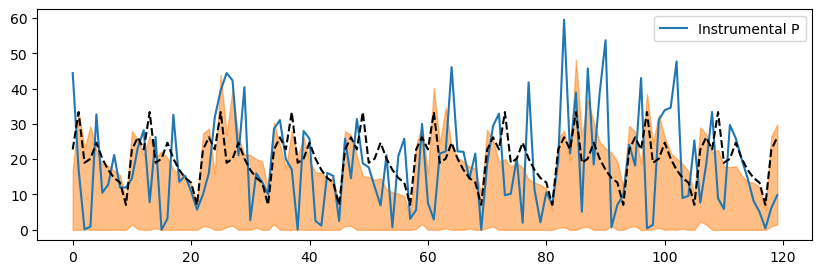

In [294]:
#check the seasonality
#az.style.use("arviz-doc")
fig=plt.figure(figsize=(10,3))
ax=fig.add_subplot(111)
self=RMA
# year=1934
# xax=np.arange(12)
# driest=self.pred["val"].sel(time_validate=year,vari="P")
# az.plot_hdi(xax,driest.T,smooth=False,ax=ax,color="forestgreen",hdi_prob=.66)

# ax.plot(xax,self.raw["M"].sel(year=year,vari="P").values,label='1934',color="forestgreen")
#ax.plot(xax,self.means["M"].sel(vari="P").values,c="k",ls=":",label="Climatological mean P")

years=np.arange(1930,1940)
#years=[1902,1903,1904]
xax=np.arange(12*len(years))
driest=self.pred["val"].sel(time_validate=years,vari="P").stack(time=("time_validate","month")).transpose("time","chain","draw")
print(xax.shape)
print(driest.shape)
az.plot_hdi(xax,driest.T,smooth=False,ax=ax,hdi_prob=.66)

ax.plot(xax,self.raw["M"].sel(year=years,vari="P").stack(time=("year","month")).values,label='Instrumental P')
ax.plot(xax,np.tile(self.means["M"].sel(vari="P").values,len(years)),"k--")
#ax.plot(xax,self.means["M"].sel(vari="P").values)
plt.legend()
#tmp=plt.xticks(xax,self.raw["M"].month.values)


<Axes: title={'center': 'Mval'}>

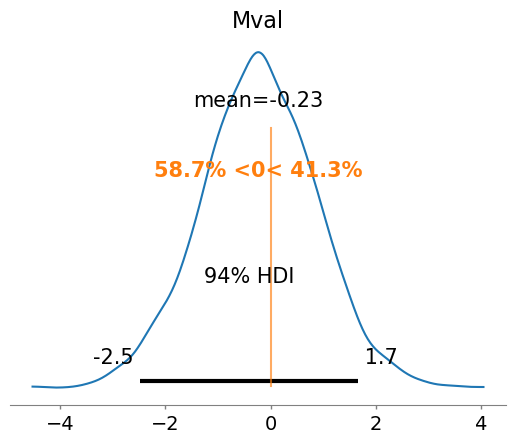

In [301]:
az.plot_posterior(self.trace.posterior.Mval.sel(time_validate=1934,vari="P",month="SEP"),ref_val=0)

In [35]:
plot_lowest(DCK,ylim=(20,60))
#plt.savefig("LOWEST_DCK.pdf")

AttributeError: 'Reconstructor' object has no attribute 'pred'

/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/arviz/plots/pairplot.py:232: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  gridsize = int(dataset.dims["draw"] ** 0.35)


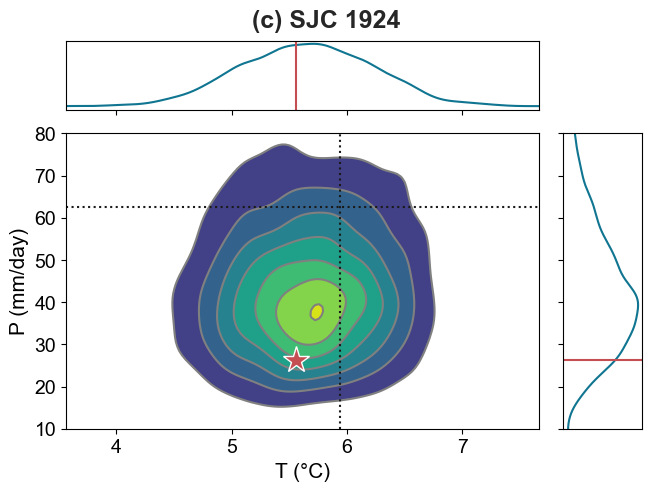

In [1172]:
plot_lowest(SJC,ylim=(10,80))
plt.savefig("LOWEST_SJC.pdf")

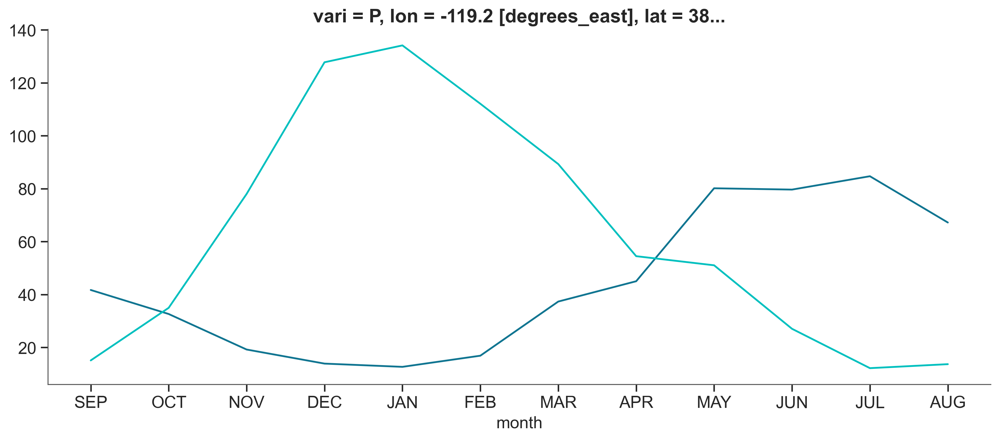

In [1141]:
DCK.means["M"].sel(vari="P").plot()
SJC.means["M"].sel(vari="P").plot()

/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/arviz/plots/pairplot.py:232: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  gridsize = int(dataset.dims["draw"] ** 0.35)


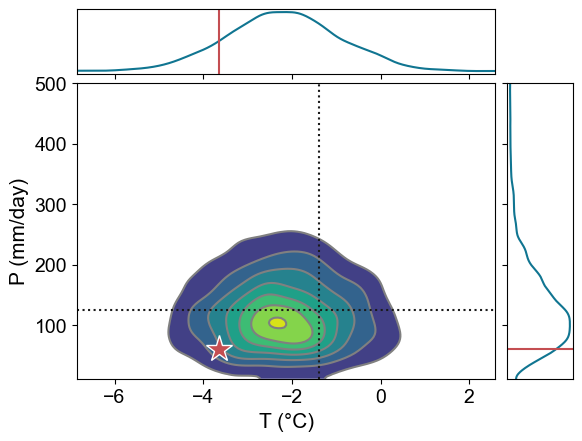

In [1140]:
#1913 was a little colder than normal and MUCH drier.  Reconstruction thinks this is because 
year=1913
self=SJC
months=["JUN","JUL", "AUG"]
#months=["MAR","APR","MAY"]
#months=["SEP","OCT","NOV"]
months=["DEC","JAN","FEB"]
#months=DCK.raw["M"].month.values
Tmean,Pmean=self.raw["M"].sel(month=months,year=slice(*DCK.training_period)).mean(dim="month").mean(dim="year")
with az.style.context("default"):
    axes=az.plot_pair(self.pred["val"].sel(time_validate=year,month=months).mean(dim="month"),kind="kde",marginals=True)
obs=self.raw["M"].sel(year=year,month=months).mean(dim="month").values

axes[1,0].plot([obs[0]],[obs[1]],marker="*",color="r",markersize=20,markeredgecolor="w")
axes[1,0].set_xlabel("T (°C)")
axes[1,0].set_ylabel("P (mm/day)")
axes[1,0].axvline(float(Tmean),ls=":",c="k")
axes[1,0].axhline(float(Pmean),ls=":",c="k")
axes[1,1].axhline(float(obs[1]),color="r")
#axes[1,0].set_ylim(20,60)

axes[0,0].axvline(float(obs[0]),color="r")
#plt.gcf().suptitle("Dodge City, Kansas: "+str(year))

/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/arviz/data/base.py:221: UserWarning: More chains (1000) than draws (4). Passed array should have shape (chains, draws, *shape)
  warnings.warn(


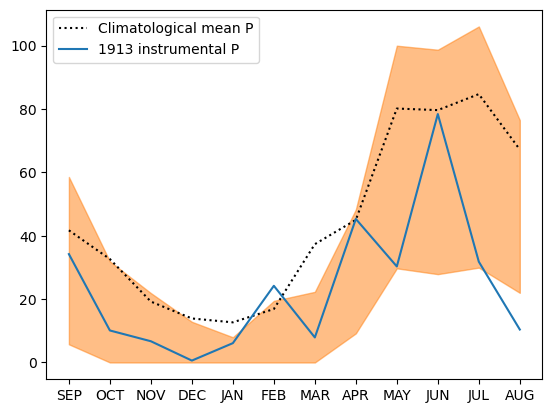

In [254]:
#check the seasonality
#az.style.use("arviz-doc")
fig=plt.figure()
ax=fig.add_subplot(111)
self=DCK
# year=1934
# xax=np.arange(12)
# driest=self.pred["val"].sel(time_validate=year,vari="P")
# az.plot_hdi(xax,driest.T,smooth=False,ax=ax,color="forestgreen",hdi_prob=.66)

# ax.plot(xax,self.raw["M"].sel(year=year,vari="P").values,label='1934',color="forestgreen")
ax.plot(xax,self.means["M"].sel(vari="P").values,c="k",ls=":",label="Climatological mean P")

year=1913
xax=np.arange(12)
driest=self.pred["val"].sel(time_validate=year,vari="P")
az.plot_hdi(xax,driest.T,smooth=False,ax=ax,hdi_prob=.66)

ax.plot(xax,self.raw["M"].sel(year=year,vari="P").values,label='1913 instrumental P')
#ax.plot(xax,self.means["M"].sel(vari="P").values)
plt.legend()
tmp=plt.xticks(xax,self.raw["M"].month.values)
plt.savefig("../RESULTS/FIGS/DCK1913.pdf")

# Comparing 1913 and 1934 in DCK
1913 had near-normal P in April and June and REALLY large deficits in March, May, and August.  Additionally, the fall and winter were exceptionally dry in 1913.  It probably shows up as normal in 

In [120]:
DCK.z["D"].sel(year=1913)

<xarray.DataArray 'pdsi' ()> Size: 8B
array(-0.19833403)
Coordinates:
    lon      float64 8B -100.2
    lat      float64 8B 37.75
    year     float64 8B 1.913e+03

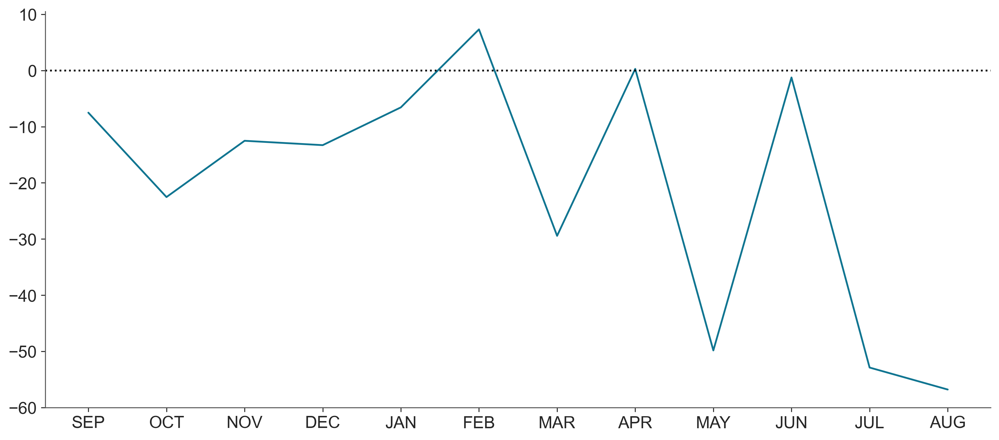

In [122]:
P1913=self.raw["M"].sel(year=1913,vari="P").values
P1934=self.raw["M"].sel(year=1934,vari="P").values
averageP=self.means["M"].sel(vari="P").values
plt.plot(P1913-averageP)
plt.axhline(0,c="k",ls=":")
np.sum(P1913-P1934)
tmp=plt.xticks(xax,self.raw["M"].month.values)

# 1934
The observations are a bit drier than predicted by the model, and much warmer
During the training period, most anomalously low values of PDSI were associated with precipitation deficits.  For example, the 1956 drought (D even lower than 1934) was associated with low summertime precipitation (roughly similar to 1934) but was 1.67 degrees colder.



/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/arviz/plots/pairplot.py:232: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  gridsize = int(dataset.dims["draw"] ** 0.35)


Text(0.5, 0.98, 'Dodge City, Kansas: 1934')

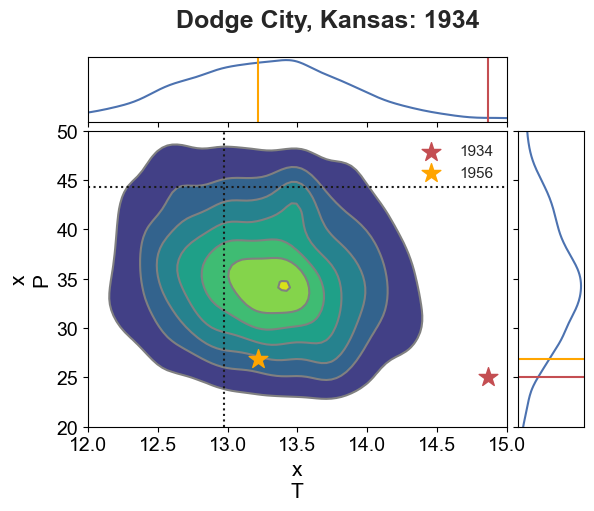

In [359]:
#1934: observations are a bit drier than expected, and much warmer
#During the training period, most anomalously low values of PDSI were associated with precipitation deficits.  For example, the 1956 drought was associated with low summertime precipitation (roughly similar to 1934) but was 1.67 degrees colder.
year=1934
compyear=1956
#months=["JUN","JUL", "AUG"]
months=DCK.raw["M"].month
with az.style.context("default"):
    axes=az.plot_pair(DCK.pred["val"].sel(time_validate=year,month=months).mean(dim="month"),kind="kde",marginals=True)
obs=DCK.raw["M"].sel(year=year,month=months).mean(dim="month").values
compare_with_training=DCK.raw["M"].sel(year=compyear,month=months).mean(dim="month").values
axes[1,0].scatter([obs[0]],[obs[1]],marker="*",color="r",s=200,label=str(year),zorder=2)
axes[1,0].scatter([compare_with_training[0]],[compare_with_training[1]],marker="*",color="orange",s=200,label=str(compyear),zorder=2)
axes[1,0].legend()

Tmean,Pmean=DCK.raw["M"].sel(month=months,year=slice(*DCK.training_period)).mean(dim="month").mean(dim="year")

axes[1,0].axvline(float(Tmean),ls=":",c="k")
axes[1,0].axhline(float(Pmean),ls=":",c="k")
axes[1,0].set_ylim(20,50)
axes[1,0].set_xlim(12,15)
axes[1,1].axhline(float(obs[1]),color="r")
axes[1,1].axhline(float(compare_with_training[1]),color="orange")

axes[0,0].axvline(float(obs[0]),color="r")
axes[0,0].axvline(float(compare_with_training[0]),color="orange")
plt.gcf().suptitle("Dodge City, Kansas: 1934")


In [134]:
# the dry anomaly in 1956 is associated with much lower temperatures and the same precipitation!
compare_with_training[0]-obs[0]

-1.666666

Sampling: [Dtrain_lik]


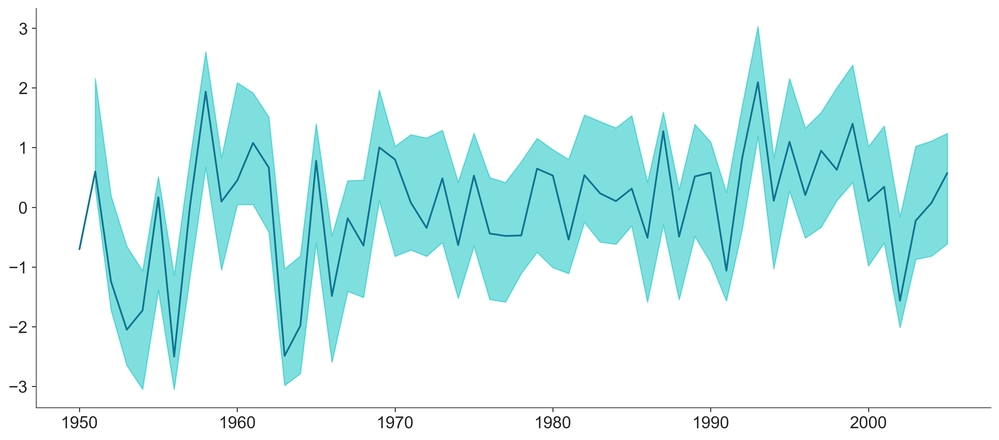

In [104]:
DCK.plot_posterior_predictive()


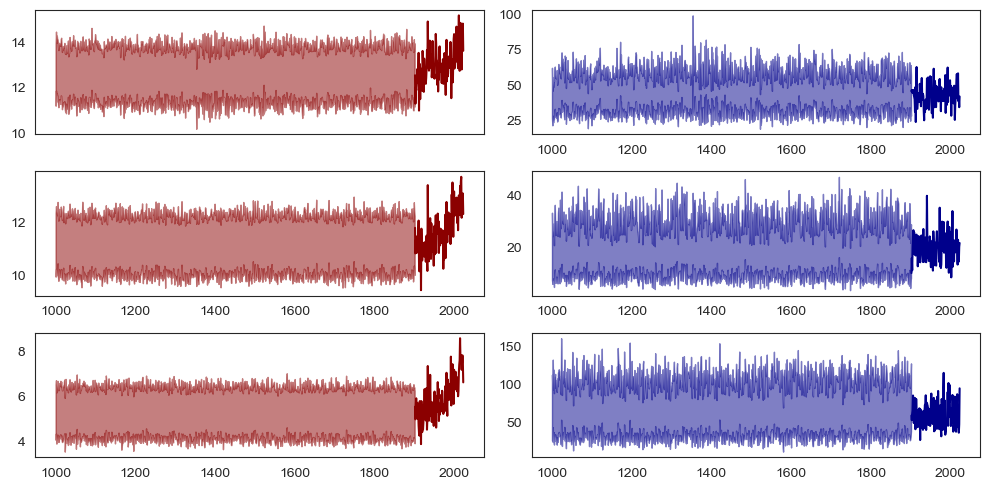

In [69]:
plt.figure(figsize=(10,5))
sns.set_style("white")
axes=[]
i=1
roll=1
hdi_prob=.95
for X in [DCK,RMA,SJC]:
    ax=plt.subplot(3,2,i)
    axes+=[ax]
    roll10=X.pred["recon"].mean(dim="month").sel(vari="T").rolling(time_recon=roll).mean()
    az.plot_hdi(roll10.time_recon.values,roll10,smooth=False,hdi_prob=hdi_prob,color="darkred")

    roll10=X.pred["val"].mean(dim="month").sel(vari="T").rolling(time_validate=roll).mean()
   # az.plot_hdi(roll10.time_validate.values,roll10,smooth=False,hdi_prob=hdi_prob,color="orange")
    
    roll10raw=X.raw["M"].mean(dim="month").sel(vari="T").rolling(year=roll).mean()
    plt.plot(roll10raw.year.values,roll10raw.values,color='darkred')
    i=i+1
    plt.subplot(3,2,i)
    roll10=X.pred["recon"].mean(dim="month").sel(vari="P").rolling(time_recon=roll).mean()
    az.plot_hdi(roll10.time_recon.values,roll10,smooth=False,hdi_prob=hdi_prob,color="darkblue")
    roll10raw=X.raw["M"].mean(dim="month").sel(vari="P").rolling(year=roll).mean()
    roll10=X.pred["val"].mean(dim="month").sel(vari="P").rolling(time_validate=roll).mean()
   # az.plot_hdi(roll10.time_validate.values,roll10,smooth=False,hdi_prob=hdi_prob,color="orange")
    
    
    plt.plot(roll10raw.year.values,roll10raw.values,color='darkblue')
   
    i=i+1
plt.tight_layout()

[ax.set_xticks([]) for ax in axes[:-2]]
plt.show()

In [86]:
fig=plt.figure(figsize=(12,5))
sns.set_style("white")
axes=[]
i=1

hdi_prob=.66
for X in [DCK,RMA,SJC]:
    ax=fig.add_subplot(3,2,i)
    axes+=[ax]
    roll10=X.pred["recon"].mean(dim="month").sel(vari="T")
    az.plot_hdi(roll10.time_recon.values,roll10,smooth=False,hdi_prob=hdi_prob,color="darkred",ax=ax)

    roll10=X.pred["val"].mean(dim="month").sel(vari="T")
   # az.plot_hdi(roll10.time_validate.values,roll10,smooth=False,hdi_prob=hdi_prob,color="orange")
    
    roll10raw=X.raw["M"].mean(dim="month").sel(vari="T")
    ax.plot(roll10raw.year.values,roll10raw.values,color='darkred')
    ax.set_title(X.region+" T")
    ax.set_ylabel("T (°C)")
    if i != 5:
        ax.set_xticks([])
    i=i+1
    ax=fig.add_subplot(3,2,i)
    axes+=[ax]
    roll10=X.pred["recon"].mean(dim="month").sel(vari="P")
    az.plot_hdi(roll10.time_recon.values,roll10,smooth=False,hdi_prob=hdi_prob,color="darkblue",ax=ax)
    roll10raw=X.raw["M"].mean(dim="month").sel(vari="P")
    roll10=X.pred["val"].mean(dim="month").sel(vari="P")
   # az.plot_hdi(roll10.time_validate.values,roll10,smooth=False,hdi_prob=hdi_prob,color="orange")
    
    ax.set_title(X.region+" P")
    ax.plot(roll10raw.year.values,roll10raw.values,color='darkblue')
    ax.set_ylabel("P (mm)")
    if i != 6:
        ax.set_xticks([])
   
    i=i+1
plt.tight_layout()


#plt.show()
plt.savefig("../RESULTS/FIGS/Reconstructions.pdf")

In [85]:
roll10raw.year.values


array([1902, 1903, 1904, 1905, 1906, 1907, 1908, 1909, 1910, 1911, 1912,
       1913, 1914, 1915, 1916, 1917, 1918, 1919, 1920, 1921, 1922, 1923,
       1924, 1925, 1926, 1927, 1928, 1929, 1930, 1931, 1932, 1933, 1934,
       1935, 1936, 1937, 1938, 1939, 1940, 1941, 1942, 1943, 1944, 1945,
       1946, 1947, 1948, 1949, 1950, 1951, 1952, 1953, 1954, 1955, 1956,
       1957, 1958, 1959, 1960, 1961, 1962, 1963, 1964, 1965, 1966, 1967,
       1968, 1969, 1970, 1971, 1972, 1973, 1974, 1975, 1976, 1977, 1978,
       1979, 1980, 1981, 1982, 1983, 1984, 1985, 1986, 1987, 1988, 1989,
       1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000,
       2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011,
       2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022,
       2023])

In [77]:
axes

[<Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >]

(1800.0, 2000.0)

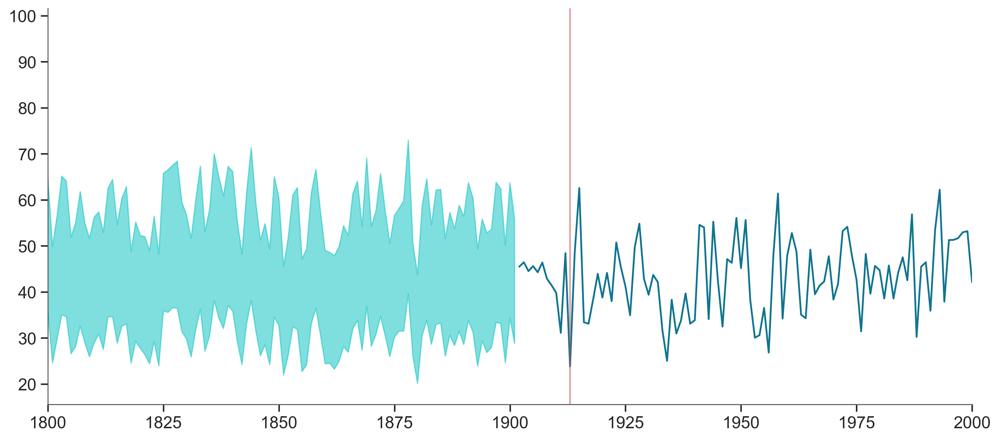

In [597]:
az.plot_hdi(DCK.taxes["recon"],DCK.pred["recon"].mean(dim="month").sel(vari="P"),smooth=False)
#az.plot_hdi(DCK.taxes["val"],DCK.pred["val"].mean(dim="month").sel(vari="P"),smooth=False,color="k")
plt.plot(DCK.raw["M"].year.values,DCK.raw["M"].mean(dim="month").sel(vari="P"))
plt.axvline(1913,c="r",alpha=.5)
plt.xlim(1800,2000)

In [142]:
?sns.histplot

Signature:
sns.histplot(
    data=None,
    *,
    x=None,
    y=None,
    hue=None,
    weights=None,
    stat='count',
    bins='auto',
    binwidth=None,
    binrange=None,
    discrete=None,
    cumulative=False,
    common_bins=True,
    common_norm=True,
    multiple='layer',
    element='bars',
    fill=True,
    shrink=1,
    kde=False,
    kde_kws=None,
    line_kws=None,
    thresh=0,
    pthresh=None,
    pmax=None,
    cbar=False,
    cbar_ax=None,
    cbar_kws=None,
    palette=None,
    hue_order=None,
    hue_norm=None,
    color=None,
    log_scale=None,
    legend=True,
    ax=None,
    **kwargs,
)
Docstring:
Plot univariate or bivariate histograms to show distributions of datasets.

A histogram is a classic visualization tool that represents the distribution
of one or more variables by counting the number of observations that fall within
discrete bins.

This function can normalize the statistic computed within each bin to estimate
frequency, density or probability mas

In [182]:
#Pluvial year: 
self=DCK
vari="P"
kind="lowest"
roll=None

def get_extrema(self,vari,kind="lowest",roll=None,verbose=True):
    recon_M=self.pred["recon"].rename({"time_recon":"time"}).stack(sample=("chain","draw")).transpose("month","vari","time","sample")
    #print(recon_M.shape)
    rawdata=np.repeat(self.raw["M"].values[:,:,:,np.newaxis],4000,axis=-1)
    coords={"month":recon_M.month.values,\
    "vari":recon_M.vari.values,\
    "time":self.raw["M"].year.values,\
    "sample":recon_M.sample}
    recent_M=xr.DataArray(data=rawdata,coords=coords)
    X=xr.concat([recon_M,recent_M],dim="time").mean(dim="month")
    if roll is not None:
        X=X.rolling(time=roll,center=False).mean(dim="time")
    #X=DCK.pred["recon"].mean(dim="month").rename({"time_recon":"time"}).stack(sample=("chain","draw"))
    if kind == "lowest":
        extreme=X.time[X.argmin(dim=("time"))]
    else:
        extreme=X.time[X.argmax(dim=("time"))]
    L=len(X.time)
    
    extreme=extreme.sel(vari=vari)
    counts,bins=np.histogram(extreme,bins=X.time.values,density=True)
    if verbose:
        print("Most likely "+kind+" "+vari ,X.time.values[np.argsort(counts)][::-1][:25])
    DTest=self.raw["D"].sel(year=slice(1000,2005))
    if roll is not None:
        DTest=DTest.rolling(year=roll).mean(dim="year")
    if verbose:
        print("10 lowest D ",DTest.year.values[np.argsort(DTest)][:25])
        #print("probability",100*(np.sort(counts)[::-1][:25]/4000))
        print("probability",100*(np.sort(counts)[::-1][:25]))
    #plt.xlim(1000,2023)
    return extreme

In [215]:
np.arange(1000,2100,100)

array([1000, 1100, 1200, 1300, 1400, 1500, 1600, 1700, 1800, 1900, 2000])

******* DCK *******


/var/folders/l8/1gztm4113nxdtdj6k7cd03b40000gp/T/ipykernel_5366/178601134.py:18: DeprecationWarning: Reductions are applied along the rolling dimension(s) '['time']'. Passing the 'dim' kwarg to reduction operations has no effect.
  X=X.rolling(time=roll,center=False).mean(dim="time")


Most likely highest P [2001. 1372. 1844. 1661. 1034. 1662. 1402. 1314. 1529. 1572. 1325. 1129.
 1845. 1410. 1327. 1336. 1569. 1125. 1338. 1311. 1414. 1444. 1621. 1568.
 1337.]
10 lowest D  [1865. 1866. 1864. 1867. 1108. 1109. 1103. 1105. 1104. 1102. 1106. 1107.
 1868. 1870. 1869. 1863. 1159. 1101. 1158. 1871. 1020. 1157. 1591. 1110.
 1153.]
probability [10.775  6.975  4.175  3.375  2.55   2.05   1.9    1.55   1.475  1.275
  1.25   1.25   1.25   1.25   1.2    1.2    1.125  1.     1.     0.95
  0.925  0.9    0.9    0.875  0.875]


/var/folders/l8/1gztm4113nxdtdj6k7cd03b40000gp/T/ipykernel_5366/178601134.py:32: DeprecationWarning: Reductions are applied along the rolling dimension(s) '['year']'. Passing the 'dim' kwarg to reduction operations has no effect.
  DTest=DTest.rolling(year=roll).mean(dim="year")


******* RMA *******


/var/folders/l8/1gztm4113nxdtdj6k7cd03b40000gp/T/ipykernel_5366/178601134.py:18: DeprecationWarning: Reductions are applied along the rolling dimension(s) '['time']'. Passing the 'dim' kwarg to reduction operations has no effect.
  X=X.rolling(time=roll,center=False).mean(dim="time")


Most likely highest P [1998. 1337. 1621. 1066. 1327. 1315. 1844. 1321. 1622. 1320. 1332. 1129.
 1328. 1336. 1314. 1344. 1840. 1213. 1727. 1319. 1494. 1119. 1065. 1850.
 1128.]
10 lowest D  [1592. 1593. 1158. 1151. 1591. 1159. 1150. 1161. 1590. 1295. 1157. 1162.
 1152. 1292. 1296. 1586. 1289. 1156. 1153. 1585. 1154. 1297. 1461. 1594.
 1160.]
probability [36.725  4.575  3.65   1.575  1.525  1.45   1.4    1.325  1.025  1.025
  0.875  0.825  0.8    0.75   0.725  0.675  0.575  0.575  0.575  0.525
  0.525  0.525  0.525  0.525  0.525]


/var/folders/l8/1gztm4113nxdtdj6k7cd03b40000gp/T/ipykernel_5366/178601134.py:32: DeprecationWarning: Reductions are applied along the rolling dimension(s) '['year']'. Passing the 'dim' kwarg to reduction operations has no effect.
  DTest=DTest.rolling(year=roll).mean(dim="year")


******* SJC *******


/var/folders/l8/1gztm4113nxdtdj6k7cd03b40000gp/T/ipykernel_5366/178601134.py:18: DeprecationWarning: Reductions are applied along the rolling dimension(s) '['time']'. Passing the 'dim' kwarg to reduction operations has no effect.
  X=X.rolling(time=roll,center=False).mean(dim="time")


Most likely highest P [1568. 1620. 1617. 1998. 1569. 1618. 1349. 1346. 1612. 1125. 1570. 1621.
 1749. 1539. 1615. 1803. 1901. 1553. 1885. 1094. 1350. 1605. 1623. 1092.
 1817.]
10 lowest D  [1159. 1158. 1189. 1162. 1187. 1072. 1227. 1936. 1937. 1218. 1223. 1224.
 1468. 1246. 1935. 1222. 1232. 1053. 1164. 1236. 1151. 1237. 1074. 1220.
 1245.]
probability [4.    3.225 2.7   1.875 1.7   1.475 1.375 1.225 1.175 1.15  1.075 1.
 0.9   0.875 0.8   0.775 0.75  0.725 0.7   0.7   0.675 0.65  0.6   0.6
 0.575]


/var/folders/l8/1gztm4113nxdtdj6k7cd03b40000gp/T/ipykernel_5366/178601134.py:32: DeprecationWarning: Reductions are applied along the rolling dimension(s) '['year']'. Passing the 'dim' kwarg to reduction operations has no effect.
  DTest=DTest.rolling(year=roll).mean(dim="year")


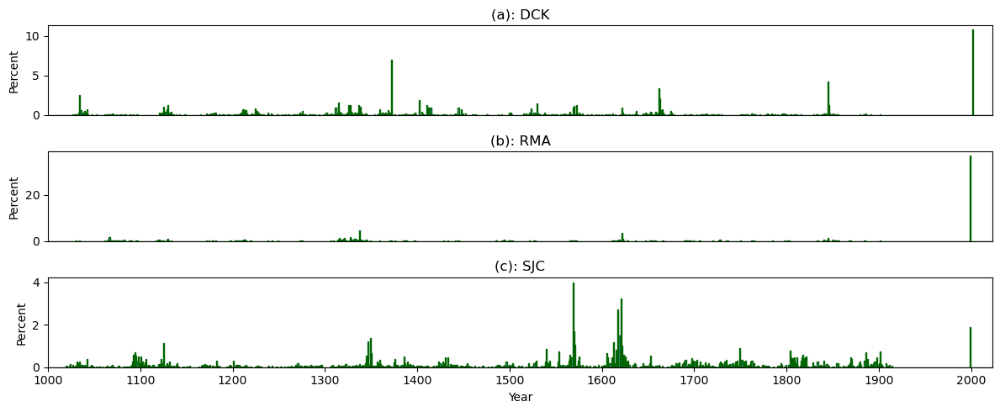

In [302]:
#az.style.use("default")
vari="P"
kind="highest"
if kind == "highest":
    color="darkgreen"
else:
    color="saddlebrown"
roll=20

fig=plt.figure(figsize=(12,5))
ax=fig.add_subplot(311)
print("******* DCK *******")
X=get_extrema(DCK,vari,kind=kind,roll=roll,verbose=True)
sns.histplot(X,bins=np.arange(1000,2024),edgecolor=color,stat='percent',ax=ax,linewidth=1)
ax.set_xlim(1000,2023)
ax.set_xticks([])
ax.set_title("(a): DCK")
ax=fig.add_subplot(312)
print("******* RMA *******")
X=get_extrema(RMA,vari,kind=kind,roll=roll,verbose=True)
sns.histplot(X,bins=np.arange(1000,2024),edgecolor=color,stat='percent',ax=ax,linewidth=1)
ax.set_xlim(1000,2023)
ax.set_xticks([])
ax.set_title("(b): RMA")
ax=fig.add_subplot(313)
print("******* SJC *******")
X=get_extrema(SJC,vari,kind=kind,roll=roll,verbose=True)
sns.histplot(X,bins=np.arange(1000,2024),edgecolor=color,stat='percent',ax=ax,linewidth=1)
ax.set_xlim(1000,2023)
ax.set_title("(c): SJC")
ax.set_xticks(np.arange(1000,2100,100))
ax.set_xlabel("Year")
plt.tight_layout()
#plt.savefig("../RESULTS/FIGS/WettestDecadeEver.pdf")

In [243]:
X=get_extrema(SJC,vari,kind=kind,roll=roll,verbose=False)
counts,bins=np.histogram(X,bins=np.arange(1000,2024),density=True)
istart=np.where(bins>1901)[0][0]
100*np.sum(counts[istart:])

0.95

1913

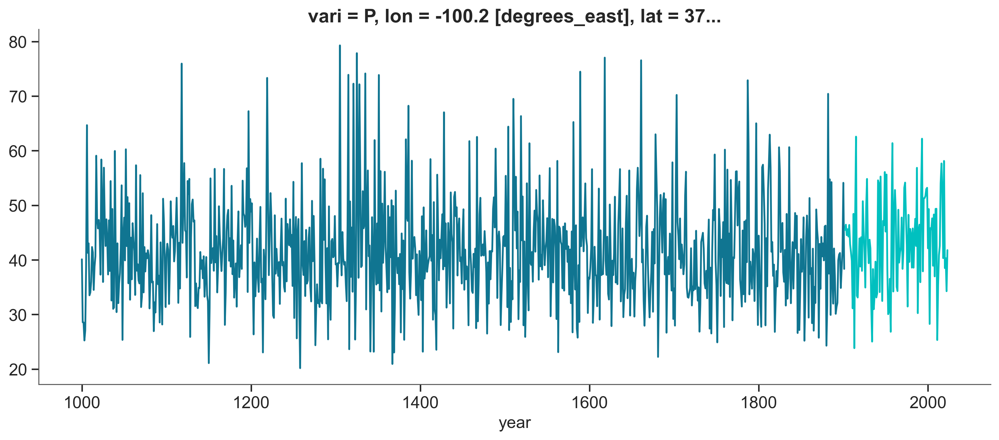

In [602]:
X.isel(sample=100).sel(vari="P").plot()
DCK.raw["M"].sel(vari="P").mean(dim="month").plot()
#1913 is the lowest value of precipitation in the observational period
DCK.raw["M"].year.values[DCK.raw["M"].sel(vari="P").mean(dim="month").argmin(dim="year")]

In [ ]:
#This is because the low D anomaly in 1522 was preceded by a extended period of 

(1900.0, 2005.0)

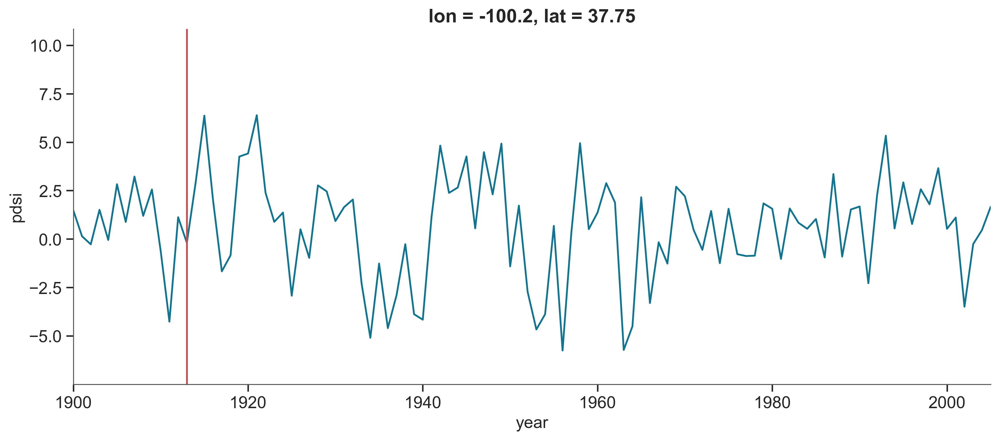

In [584]:
#DCK.recon["D"].plot()
DCK.raw["D"].sel(year=slice(1000,2025)).plot()
#DCK.recon["D"].plot()
plt.axvline(1522,c="r")
plt.axvline(1880,c="r")
plt.axvline(1913,c="r")
plt.xlim(1900,2005)

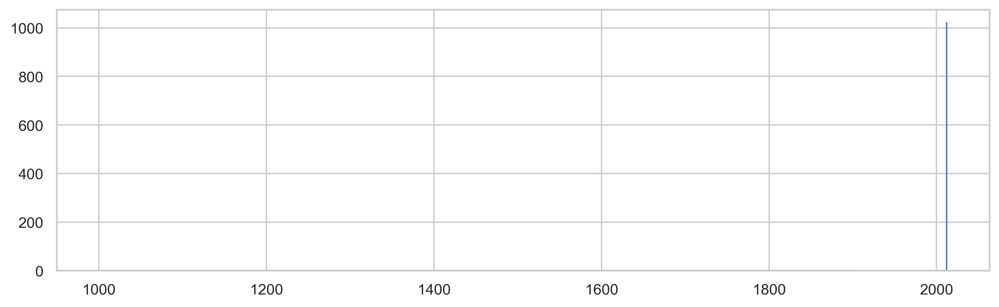

In [463]:
# by decades
plt.figure(figsize=(10,3))
#X=DCK.pred["recon"].mean(dim="month")
#X=X.rolling(time_recon=30).mean()
#X=to_concat.mean(dim="month")
L=len(X.time)
lowest=X.time[X.argmin(dim=("time"))]
highest=X.time[X.argmax(dim=("time"))]
#tmp=plt.hist(highest.sel(vari="T").stack(samples=("chain","draw")).values,len(X.time_recon.values),density=True)
tmp=plt.hist(lowest.sel(vari="P").values,L,edgecolor="k",density=True)
tmp=plt.hist(highest.sel(vari="T").values,L,edgecolor="b",density=True)

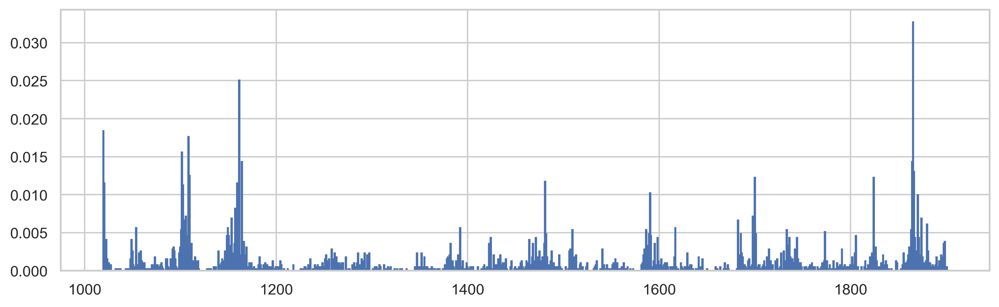

In [423]:
plt.figure(figsize=(10,3))
tmp=plt.hist(highest.sel(vari="T").stack(samples=("chain","draw")).values,902,edgecolor="b",density=True)

In [31]:
SJC=Reconstructor("SJC")
SJC.make_model(overwrite_trace=False)

In [122]:
with SJC.model:
    SJC.pp=pm.sample_posterior_predictive(SJC.trace,var_names=["Dtrain_lik"])

Sampling: [Dtrain_lik]


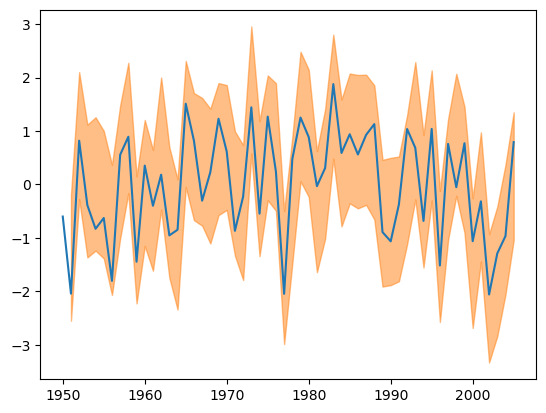

In [121]:
az.plot_hdi(RMA.taxes["train"][1:],RMA.pp.posterior_predictive.Dtrain_lik,smooth=False)
plt.plot(RMA.taxes["train"],RMA.train["D"].values)

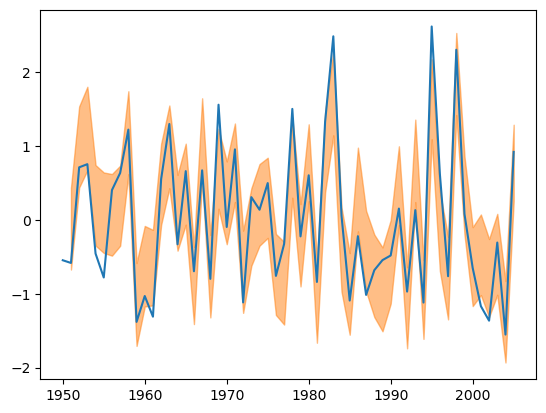

In [124]:
az.plot_hdi(RMA.taxes["train"][1:],SJC.pp.posterior_predictive.Dtrain_lik,smooth=False,hdi_prob=.66)
plt.plot(RMA.taxes["train"],SJC.train["D"].values)

In [ ]:
RMA=Reconstructor("RMA")

#RMA.make_model(trace=True)
#RMA.trace.to_netcdf("../RESULTS/TRACES/RMA_monthly.nc")

In [104]:
SJC=Reconstructor("SJC")

SJC.make_model(trace=True)
SJC.trace.to_netcdf("../RESULTS/TRACES/SJC_monthly.nc")


# DCKseas=old_Reconstructor("DCK")

# DCKseas.get_data(seasonal=True)
# print(DCKseas.train["M"].dims)
# print(DCKmon.train["M"].transpose("month","vari","year").dims)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [gamma, noise_chol, beta, rhoD, sigmaD, Mval_flat, Mrecon_flat]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 1596 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details
There were 12 divergences after tuning. Increase `target_accept` or reparameterize.


'../RESULTS/TRACES/SJC_monthly.nc'

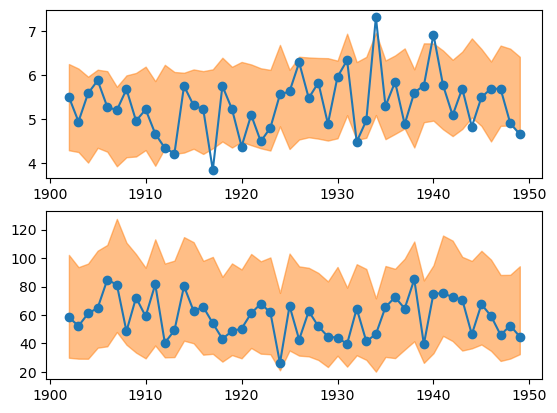

In [105]:
SJC.plot_validation()

26.6

In [471]:
im=np.argmax(DCKmon.val["M"].sel(vari="P",month="JUN").values)
DCKmon.taxes["val"][im]

1908

/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/arviz/plots/pairplot.py:232: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  gridsize = int(dataset.dims["draw"] ** 0.35)


array([[<Axes: >, None],
       [<Axes: xlabel='Mval\nJUN', ylabel='Mval\nJUL'>, <Axes: >]],
      dtype=object)

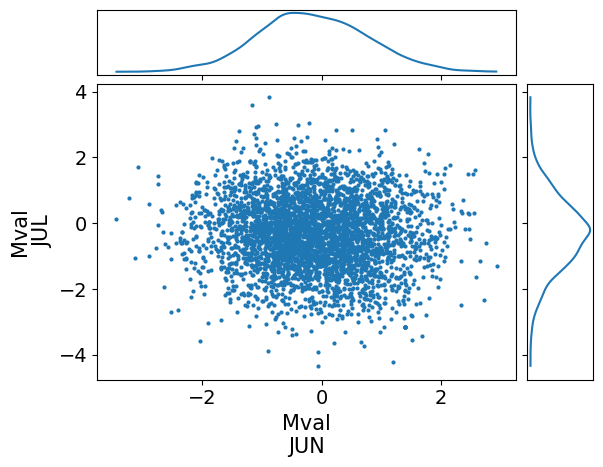

In [484]:
az.plot_pair(DCKmon.trace.posterior.Mval.sel(time_validate=1908,month=["JUN","JUL"],vari="T"),marginals=True)
#DCKmon.val["M"].sel(year=1908,month="JUN")

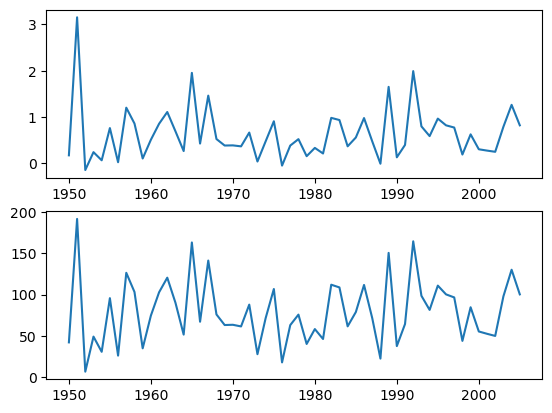

In [366]:
plt.subplot(211)
plt.plot(self.taxes["train"],spi.sel(month="JUN",vari="P").values)
plt.subplot(212)
plt.plot(self.taxes["train"],Pval_orig.sel(month="JUN").values)

In [43]:
#LAST WORKING CODE: DO NOT BREAK
class old_Reconstructor():
    def __init__(self,\
                 region,
                 training_period=(1950,2005),\
                 validation_period=(1902,1949),\
                reconstruction_period=(1000,1901)):
        
        self.training_period=training_period
        self.validation_period=validation_period
        self.reconstruction_period=reconstruction_period
        self.region=region
        
        lat,lon=latlon(self.region)
        self.lat=lat
        self.lon=lon
    def get_data(self,seasonal=False):
        lat=self.lat
        lon=self.lon
        if not seasonal:
            T= cru.data["T"].sel(lat=lat,lon=lon).mean(dim="month").expand_dims({"vari":["T"]})
            P= cru.data["P"].sel(lat=lat,lon=lon).mean(dim="month").expand_dims({"vari":["P"]}) 
            #M=xr.concat([T.expand_dims({"vari":["T"]}),P.expand_dims({"vari":["P"]})],dim="vari")  
        else:
            T=get_seasonal(self.lat,self.lon,"T")
            P=get_seasonal(self.lat,self.lon,"P")
        #normalize both
        #T is assumed normally distributed
        muT=T.sel(year=slice(*self.training_period)).mean(dim="year")
        sigT=T.sel(year=slice(*self.training_period)).std(dim="year")
        Tz=(T-muT)/sigT

        if seasonal:
        #Assume P is gamma distributed
            self.gamma={}
            spis=[]
            
            for season in P.season.values:
                traindata=P.sel(season=season,year=slice(*self.training_period))
                alldata=P.sel(season=season)
                shape,loc,scale=stats.gamma.fit(traindata.values,floc=0)
                #shapea,loca,scalea=stats.gamma.fit(traindata)
                self.gamma[season]=[shape,loc,scale]
                cumulative_prob = stats.gamma.cdf(alldata.values, shape, loc, scale)
                #spis=stats.norm.ppf(cumulative_prob)
                
                data=stats.norm.ppf(cumulative_prob).ravel()
                print(data.shape)
                spis += [xr.DataArray(\
                    data,\
                    dims=("year"),\
                    coords=({"year":alldata.coords["year"].values})\
                    ).expand_dims({"season":[season]})]
            Pz=xr.concat(spis,dim="season").expand_dims({"vari":["P"]})
        else:
            muP=P.sel(year=slice(*self.training_period)).mean(dim="year")
            sigP=P.sel(year=slice(*self.training_period)).std(dim="year")
            Pz=(P-muP)/sigP
            


        
        M=xr.concat([T,P],dim="vari")    
        Mz=xr.concat([Tz,Pz],dim="vari")    
        
        #We only have JJA PDSI
        D=nada.sel(lat=self.lat,lon=self.lon).pdsi
        D=D.rename(time="year")

        #######(HACK for offline: fix this)########
        #Global mean temperature: JJA for now 
        gistemp_data=pd.read_csv("https://data.giss.nasa.gov/gistemp/tabledata_v4/GLB.Ts+dSST.csv",header=1)
        G=xr.DataArray(data=gistemp_data["JJA"].values[:-1].astype(np.float32),\
                     dims=("year"),\
                     coords={"year":gistemp_data["Year"].values[:-1]}).rename("tas")
        #G=gistemp
        self.raw={}
        self.raw["M"]=M
        self.raw["D"]=D
        self.raw["G"]=G
        
        #means and std over the training period
        self.means={}
        #self.means["T"]=float(T.sel(year=slice(*training_period)).mean(dim="year"))
        #self.means["P"]=float(P.sel(year=slice(*training_period)).mean(dim="year"))
        self.means["M"]=M.sel(year=slice(*self.training_period)).mean(dim="year")
        self.means["D"]=float(D.sel(year=slice(*self.training_period)).mean(dim="year"))
        self.means["G"]=float(gistemp.sel(year=slice(*self.training_period)).mean())

        self.stds={}
       #self.stds["T"]=float(T.sel(year=slice(*training_period)).std(dim="year"))
       # self.stds["P"]=float(P.sel(year=slice(*training_period)).std(dim="year"))
        self.stds["M"]=M.sel(year=slice(*self.training_period)).std(dim="year")
        self.stds["D"]=float(D.sel(year=slice(*self.training_period)).std(dim="year"))
        self.stds["G"]=float(gistemp.sel(year=slice(*self.training_period)).std())

        self.z={}
        self.z["M"]=Mz
        # self.z["T"]=(T-self.means["T"])/self.stds["T"]
        # self.z["P"]=(P-self.means["P"])/self.stds["P"]
        #self.z["M"]=(M-self.means["M"])/self.stds["M"]
        self.z["D"]=(D-self.means["D"])/self.stds["D"]
        self.z["G"]=(G-self.means["G"])/self.stds["G"]

       

        self.train={}
        self.train["M"]=self.z["M"].sel(year=slice(*self.training_period))#.values
        self.train["G"]=self.z["G"].sel(year=slice(*self.training_period))#.values
        self.train["D"]=self.z["D"].sel(year=slice(*self.training_period))#.values
        if seasonal:
            self.train["M_flat"]=self.train["M"].stack(smooshed=("season","vari"))

        
        self.val={}
        self.val["M"]=self.z["M"].sel(year=slice(*self.validation_period))#.values
        self.val["G"]=self.z["G"].sel(year=slice(*self.validation_period))#.values
        self.val["D"]=self.z["D"].sel(year=slice(*self.validation_period))#.values
        if seasonal:
            self.val["M_flat"]=self.val["M"].stack(smooshed=("season","vari"))

        self.recon={}
        # We don't have G or M over the reconstriction period
        self.recon["D"]=self.z["D"].sel(year=slice(*self.reconstruction_period))#.values

        self.taxes={}
        self.taxes["train"]=self.z["M"].sel(year=slice(*self.training_period)).year.values
        self.taxes["val"]=self.z["M"].sel(year=slice(*self.validation_period)).year.values
        self.taxes["recon"]=self.z["D"].sel(year=slice(*self.reconstruction_period)).year.values

        #modeling global mean temperature preindustrial
        self.Gsigma=float(detrend(self.val["G"]).std())
        self.Gmean=float(self.val["G"][:20].mean())
        

    def annual_model(self,trace=True):
        self.get_data(seasonal=False)
        nlags=1
    
        coords={"vari":["T","P"],\
                "time_train":self.taxes["train"][:-nlags],\
               "cross_vari":["T","P"],\
               "lags":[1],\
               "time_validate":self.taxes["val"],
               "time_recon":self.taxes["recon"]}
        
        with pm.Model(coords=coords) as self.annualmodel:
            #################
            #               #
            # TRAINING data #
            #               #
            #################
            Mobs=pm.Data("Mobs",self.train["M"].values.T[:-nlags],mutable=False)
            #Dobs=pm.Data("Dobs",np.concatenate([self.val["D"],self.train["D"]]),mutable=False)
            Dobs=np.concatenate([self.val["D"].values,self.train["D"].values])
            
            #AR(1) model for D
            beta=pm.Normal("beta",0,1,dims=["vari"])
            rhoD=pm.Normal("rhoD",0,1)
            sigmaD=pm.HalfNormal("sigmaD",1)
            L=pm.Normal("L",0,1,dims=("vari"))
        
            # prior on global temperature regression slope
            gamma=pm.Normal("gamma",0,1,dims=["vari"])
            
            # assumed forced response regresses on global mean temperature
            Ftrain=pm.Deterministic("Ftrain",\
                                    gamma*np.stack([self.train["G"].values[:-nlags],self.train["G"].values[:-nlags]]).T,\
                                    dims=("time_train","vari")) 
                
            # covariance between T and P at time t (Cholesky decomposition)
            noise_chol, _, _ = pm.LKJCholeskyCov(
                "noise_chol",
                eta=1,
                n=len(coords["vari"]),
                sd_dist=pm.HalfNormal.dist(sigma=1),
            )
            #For display: reconstitute Cholesky -> cov
            cov = pm.Deterministic('cov', noise_chol.dot(noise_chol.T),dims=("vari","cross_vari")) 
            
            #Likelihood for Mobs.  Press the inference button to get posteriors for gamma and noise
            lik_Mobs = pm.MvNormal("lik_Mobs",mu=Ftrain,chol=noise_chol,observed=Mobs,dims=("time_train","vari"))
        
            #Learn parameters from observations
            #soil moisture "memory"
            Dar=rhoD*self.train["D"].values[:-2]
           
        #    #Dependence on that year's meteorology
            Dmean=pt.dot(beta.T,self.train["M"].values[:,1:-1])
            
            # Correlation with following year meteorology
            Dforward=pt.dot(L.T,self.train["M"].values[:,2:])
            
            #Likelihood for D given M, gamma, L, beta, T
            mu_train=Dmean+Dforward+Dar

            Dtrain_lik=pm.Normal("Dtrain_lik",mu=Dmean+Dforward+Dar,sigma=sigmaD,observed=self.train["D"].values[1:-1])
        
            ###################
            #                 #
            # VALIDATION data #
            #                 #
            ###################
            # Forced response: observed GMT
            #Assume GMT is normally distributed
            #Gval=pm.Normal("Gval",mu=self.Gmean,sigma=self.Gsigma,dims=("time_validate"))

            # Forced response: unobserved GMT
    
            #Fval=pm.Deterministic("Fval",pm.math.stack([gamma[0]*Gval,gamma[1]*Gval]).T,dims=("time_validate","vari"))
            Fval=pm.Deterministic("Fval",gamma*np.stack([self.val["G"].values,self.val["G"].values]).T,dims=("time_validate","vari")) 
            
            #Prior on the unobserved meteorology
            Munobs=pm.MvNormal("Mval",mu=Fval,chol=noise_chol,dims=("time_validate","vari"))
           
            Munobsconc=pm.math.concatenate([Munobs,self.train["M"].values.T[:1]])
            Dobsconc=np.concatenate([self.val["D"].values,self.train["D"].values[:1]])
        
            Dar_val=rhoD*Dobsconc[:-2]
            
            Dforward_val=pt.dot(L.T,Munobsconc[2:].T)
            Dmean_val=pt.dot(beta.T,Munobsconc[1:-1].T)
           
            mu_val=Dmean_val+Dforward_val+Dar_val
            
            Dval_lik=pm.Normal("Dval_lik",mu=mu_val,sigma=sigmaD,observed=Dobsconc[1:-1])

            
            #######################
            #                     #
            # RECONSTRUCTION data #
            #                     #
            #######################

            #Assume GMT is normally distributed
            Grecon=pm.Normal("Grecon",mu=self.Gmean,sigma=self.Gsigma,dims=("time_recon"))

            # Forced response: unobserved GMT
    
            Frecon=pm.Deterministic("Frecon",pm.math.stack([gamma[0]*Grecon,gamma[1]*Grecon]).T,dims=("time_recon","vari"))
            #Frecon=np.average(self.val["M"][:,:20],axis=-1)
            #print("Frecon.shape",Frecon.shape.eval())
             
            # #Prior on the reconstructed meteorology
            Mrecon=pm.MvNormal("Mrecon",mu=Frecon,chol=noise_chol,dims=("time_recon","vari"))
            #print(Munobs[:1].shape.eval())
           # print("Mrecon shape",Mrecon.shape.eval())
            Mreconconc=pm.math.concatenate([Mrecon,Munobs[:1]],axis=0)
            
            Dpaleoconc=np.concatenate([self.recon["D"].values,self.val["D"].values[:1]])
        
            Dar_recon=rhoD*Dpaleoconc[:-2]
            
            Dforward_recon=pt.dot(L.T,Mreconconc[2:].T)
            Dmean_recon=pt.dot(beta.T,Mreconconc[1:-1].T)
           
            mu_recon=Dmean_recon+Dforward_recon+Dar_recon
            
            
            Drecon_lik=pm.Normal("Drecon_lik",mu=mu_recon,sigma=sigmaD,observed=Dpaleoconc[1:-1])
            if trace:
                self.annualtrace=pm.sample()
            
    def seasonal_model(self,trace=True):
        self.get_data(seasonal=True)
        nlags=1
        smooshed=["_".join(x) for x in self.train["M_flat"].smooshed.values]
        coords={"vari":["T","P"],\
                "time_train":self.taxes["train"][:-nlags],\
               "cross_vari":["T","P"],\
               "lags":[1],\
               "time_validate":self.taxes["val"],
               "time_recon":self.taxes["recon"],\
               "season":self.val["M"].season.values,\
               "smoosh":smooshed,\
               "cross_smoosh":smooshed}
        
        with pm.Model(coords=coords) as self.model:
            ###################
            #                 #
            # LEARN the prior #
            #                 #
            ###################

            Dobs=np.concatenate([self.val["D"],self.train["D"]])

            # prior on global temperature regression slope
            gamma=pm.Normal("gamma",0,1,dims=["season","vari"])
            
            # assumed forced response regresses on global mean temperature
            Ftrain=pm.math.stack([\
                pm.math.stack([gamma[j,k]*self.train["G"].values[:-nlags] for k in range(len(coords["vari"]))])\
                for j in range(len(coords["season"]))])
            
            Ftrain_flat=Ftrain\
            .reshape((len(coords["smoosh"]),len(coords["time_train"])))
            
            # covariance between T and P at time t (Cholesky decomposition)
            noise_chol, _, _ = pm.LKJCholeskyCov(
                "noise_chol",
                eta=1,
                n=len(coords["smoosh"]),
                sd_dist=pm.HalfNormal.dist(sigma=1))
            #For display: reconstitute Cholesky -> cov
            cov = pm.Deterministic('cov', noise_chol.dot(noise_chol.T),dims=("smoosh","cross_smoosh")) 
            
            #Likelihood for Mobs.  Press the inference button to get posteriors for gamma and noise
            lik_Mobs = pm.MvNormal("lik_Mobs",mu=Ftrain_flat.T,chol=noise_chol,observed=self.train["M_flat"].values[:-1,:])    
            
              #################
            #               #
            # TRAINING data #
            #               #
            #################
            
            
            #AR(1) model for D
            #beta is the dependence on same-year meteorology
            beta=pm.Normal("beta",0,1,dims=self.train["M"].dims[:-1])
            #L is the dependence on previous-year meteorology- removed because model doesn't perform better
            #L=pm.Normal("L",0,1,dims=self.train["M"].dims[:-1])
            #Rho is the dependence on previous-year soil moisture
            rhoD=pm.Normal("rhoD",0,1)
            #sigma is the Gaussian noise
            sigmaD=pm.HalfNormal("sigmaD",1)
        
           
          
            #Learn parameters from observations
            #soil moisture "memory"
            Dar=rhoD*self.train["D"].values[:-1] 
           
            
            #Dependence on that year's meteorology
            Mr=self.train["M"].isel(year=slice(1,None)).values
            Mprev=self.train["M"].isel(year=slice(None,-1)).values
            
            Dmean= pm.math.sum([
                pm.math.sum([beta[j,k]*Mr[j,k,:] for k in range(len(coords["vari"]))],axis=0) \
                 for j in range(len(coords["season"]))],axis=0)
                
            
            # Dprev=pm.math.sum([
            #     pm.math.sum([L[j,k]*Mprev[j,k,:] for k in range(len(coords["vari"]))],axis=0) \
            #      for j in range(len(coords["season"]))],axis=0)
           
        
            mu_train=Dmean+Dar
        
            
            D_train_likelihood=pm.Normal("Dtrain_lik",mu=mu_train,sigma=sigmaD,observed=self.train["D"].values[1:])
         
        
           #  ###################
           #  #                 #
           #  # VALIDATION data #
           #  #                 #
           #  ###################
        
            # can also use posterior mean of M model if not wrapped in a single large model
            #gamma=Mtrace_mon.posterior.gamma.mean(dim=("chain","draw")).values
          
           
            #cov=Mtrace_mon.posterior.cov.mean(dim=("chain","draw")).values
            
            global_mean_temperature_val=self.val["G"].values
            
            Fval=pm.Deterministic("Fval",\
                pm.math.stack([\
                pm.math.stack([gamma[j,k]*global_mean_temperature_val for k in range(len(coords["vari"]))])\
                for j in range(len(coords["season"]))])\
                                  ,dims=("season","vari","time_validate"))
            
            Fval_flat=Fval\
            .reshape((len(coords["smoosh"]),len(coords["time_validate"])))
            
        
            #prior on the unobserved meterology: use learned posterior means
        
            #First, get the flattened Mval- should have dimensions (nt x nsmoosh)
            
            Mval_flat=pm.MvNormal("Mval_flat",mu=Fval_flat.T,cov=cov)
        
            #now reshape it
            Mval=pm.Deterministic("Mval",Mval_flat.reshape(self.val["M_flat"].unstack().shape),\
                                  dims=("time_validate", 'season', 'vari'))
            
         
            #dependence on same-year meteorology
            
            Dmean_val=pm.math.sum([\
            pm.math.sum([beta[j,k]*Mval[1:,j,k] for k in range(len(coords["vari"]))],axis=0)\
            for j in range(len(coords["season"]))],axis=0)
            #print(Dmean_val.shape.eval())
            
            #dependence on previous-year PDSI
            Dar_val=rhoD*self.val["D"].values[:-1]
           # print(Dar_val.shape.eval())
            mu_val=Dmean_val+Dar_val
            D_val_likelihood=pm.Normal("Dval_lik",\
                                                mu=mu_val,\
                                                sigma=sigmaD,\
                                                observed=self.val["D"].values[1:])
                   
           #  #######################
           #  #                     #
           #  # RECONSTRUCTION data #
           #  #                     #
           #  #######################
        
        
            Mrecon_flat=pm.MvNormal("Mrecon_flat",mu=self.Gmean,cov=cov,dims=("time_recon","smoosh"))
            
        
            #now reshape it
            rdims=('time_recon', 'season', 'vari')
            rshape=tuple([len(coords[rdim]) for rdim in rdims])
            Mrecon=pm.Deterministic("Mrecon",Mrecon_flat.reshape(rshape),\
                                         dims=rdims)
            
         
           
                #dependence on same-year meteorology
                
            Dmean_recon=pm.math.sum([\
            pm.math.sum([beta[j,k]*Mrecon[1:,j,k] for k in range(len(coords["vari"]))],axis=0)\
            for j in range(len(coords["season"]))],axis=0)
           
        
            #dependence on previous-year PDSI
            Dar_recon=rhoD*self.recon["D"].values[:-1]
           # print(Dar_val.shape.eval())
            mu_recon=Dmean_recon+Dar_recon
            D_recon_likelihood=pm.Normal("Dval_recon",\
                                                mu=mu_recon,\
                                                sigma=sigmaD,\
                                                observed=self.recon["D"].values[1:])
            if trace:
                self.seasontrace=pm.sample()
            
        
    def recover_original_units(self):
        self.pred={}
        if not hasattr(self,"seasontrace"):
            self.seasonal_model(trace=True)
        put_back=[]
        for season in self.raw["M"].season.values:
            spi=self.seasontrace.posterior.Mval.sel(vari="P",season=season)
            cumulative_prob = stats.norm.cdf(spi)
            shape,loc,scale=self.gamma[season]
            recovered_precip = stats.gamma.ppf(cumulative_prob, shape, loc, scale)
            da=xr.DataArray(recovered_precip,dims=spi.dims,coords=spi.coords).expand_dims({"season":[season]})
            put_back+=[da]
        Pval_orig=xr.concat(put_back,dim="season")
        put_backr=[]
        for season in self.raw["M"].season.values:
            spir=self.seasontrace.posterior.Mrecon.sel(vari="P",season=season)
            cumulative_probr = stats.norm.cdf(spir)
            shape,loc,scale=self.gamma[season]
            recovered_precipr = gamma.ppf(cumulative_probr, shape, loc, scale)
            dar=xr.DataArray(recovered_precipr,dims=spir.dims,coords=spir.coords).expand_dims({"season":[season]})
            put_backr+=[dar]
        Precon_orig=xr.concat(put_backr,dim="season")

        Tval_orig=((self.stds["M"] * self.seasontrace.posterior.Mval)+self.means["M"]).sel(vari="T")
        Trecon_orig=((self.stds["M"] * self.seasontrace.posterior.Mrecon)+self.means["M"]).sel(vari="T")
        
        self.pred["val"]=xr.concat([Tval_orig.expand_dims({"vari":["T"]}),\
                          Pval_orig.expand_dims({"vari":["P"]})],\
                          dim="vari")
        self.pred["recon"]=xr.concat([Trecon_orig.expand_dims({"vari":["T"]}),\
                          Precon_orig.expand_dims({"vari":["P"]})],\
                          dim="vari")

        
    
    def plot_validation(self):
        if not hasattr(self,"pred"):
            self.recover_original_units()
        plt.subplot(211)
        V=self.raw["M"].sel(year=slice(*self.validation_period)).mean(dim="season").values
        tax=self.taxes["val"]
        az.plot_hdi(tax,self.pred["val"].sel(vari="T").mean(dim="season"),smooth=False,hdi_prob=.90)
        plt.plot(tax,V[0],"-o")
        plt.subplot(212)
        tax=self.taxes["val"]
        az.plot_hdi(tax,self.pred["val"].sel(vari="P").mean(dim="season"),smooth=False,hdi_prob=.90)
        plt.plot(tax,V[1],"-o")
    def plot_posteriors(self,var_names=None):
        if var_names==None:
            var_names=["L","beta","rhoD","gamma","cov"]
        if not hasattr(self,"trace"):
            self.sample()
        az.plot_posterior(self.trace,var_names=var_names,ref_val=0)   
    def undo_z(self,Z):
        mu=self.means["M"]
        sigma=self.stds["M"]
        return (sigma*Z)+mu
        
        
            

        



In [44]:
RMA_old=old_Reconstructor("RMA")
#RMA_old.annual_model(trace=True)

In [45]:
RMA_old.annualtrace=RMA_old_trace


In [64]:
RMA_old.get_data(seasonal=False)

(122,)
(122,)
(122,)
(122,)


NameError: name 'gamma' is not defined

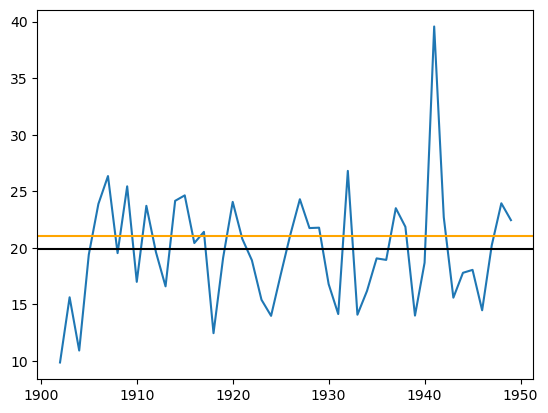

In [103]:
#It's the gamma decomposition that's making things a little weird
RMA_old.get_data(seasonal=False)
A=float(RMA_old.stds["M"].sel(vari="P"))*RMA_old.annualtrace.posterior.Mval.sel(vari="P")\
            +RMA_old.means["M"].sel(vari="P")
B=RMA.pred["val"].sel(vari="P").mean(dim="month")
# az.plot_hdi(RMA_old.taxes['val'],float(RMA_old.stds["M"].sel(vari="P"))*RMA_old.annualtrace.posterior.Mval.sel(vari="P")\
#             +RMA_old.means["M"].sel(vari="P"),smooth=False)
# az.plot_hdi(RMA.taxes['val'],RMA.pred["val"].sel(vari="P").mean(dim="month"),color="k",smooth=False,hdi_prob=.66)
# az.plot_hdi(RMA.taxes['val'],RMA_old.pred["val"].sel(vari="P").mean(dim="season"),color="r",smooth=False,hdi_prob=.66)
plt.plot(RMA.taxes['val'],RMA_old.raw["M"].sel(year=slice(*RMA_old.validation_period),vari="P").values)
plt.axhline(float(A.mean()),c="orange")
plt.axhline(float(B.mean()),c="k")

(array([ 1.,  4.,  8., 12.,  8.,  6., 15., 12., 20.,  9., 11.,  9.,  1.,
         3.,  0.,  0.,  1.,  1.,  0.,  1.]),
 array([ 8.1833334 ,  9.75291634, 11.32250023, 12.89208317, 14.46166706,
        16.03125   , 17.60083389, 19.17041779, 20.73999977, 22.30958366,
        23.87916756, 25.44874954, 27.01833344, 28.58791733, 30.15750122,
        31.72708321, 33.29666901, 34.86624908, 36.43583298, 38.00541687,
        39.57500076]),
 <BarContainer object of 20 artists>)

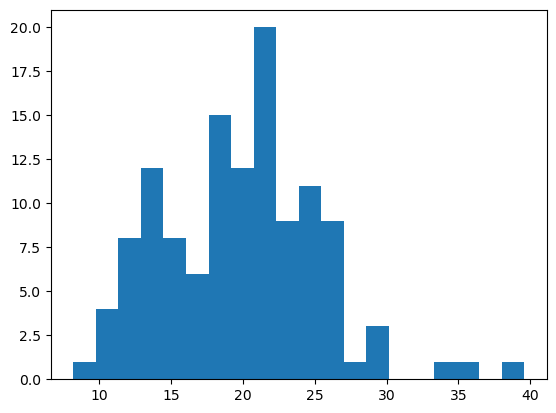

In [95]:
# is it normal?
RMA_old.get_data(seasonal=False)
plt.hist(RMA_old.raw["M"].sel(vari="P").values,20)

<Axes: >

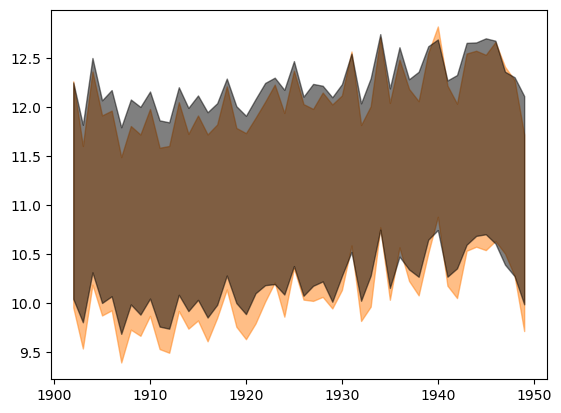

In [41]:
az.plot_hdi(RMA_old.taxes['val'],float(RMA_old.stds["M"].sel(vari="T"))*RMA_old.annualtrace.posterior.Mval.sel(vari="T")\
            +RMA_old.means["M"].sel(vari="T"),smooth=False)
az.plot_hdi(RMA.taxes['val'],RMA.pred["val"].sel(vari="T").mean(dim="month"),color="k",smooth=False)

In [46]:
RMA_old.seasonal_model(trace=True)

(122,)
(122,)
(122,)
(122,)


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [gamma, noise_chol, beta, rhoD, sigmaD, Mval_flat, Mrecon_flat]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 216 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details
There were 2 divergences after tuning. Increase `target_accept` or reparameterize.


In [77]:
RMA_old.get_data(seasonal=True)
RMA_old.raw["M"].season.values

(122,)
(122,)
(122,)
(122,)


array(['SON', 'DJF', 'MAM', 'JJA'], dtype=object)

In [79]:
        
def recover_original_units_seasonal(X,gamma_params):
    
    put_back=[]
    for season in ['SON', 'DJF', 'MAM', 'JJA']:
        spi=X.sel(vari="P",season=season)
        cumulative_prob = stats.norm.cdf(spi)
        shape,loc,scale=gamma_params[season]
        recovered_precip = stats.gamma.ppf(cumulative_prob, shape, loc, scale)
        da=xr.DataArray(recovered_precip,dims=spi.dims,coords=spi.coords).expand_dims({"season":[season]})
        put_back+=[da]
    return xr.concat(put_back,dim="season")
   

(122,)
(122,)
(122,)
(122,)


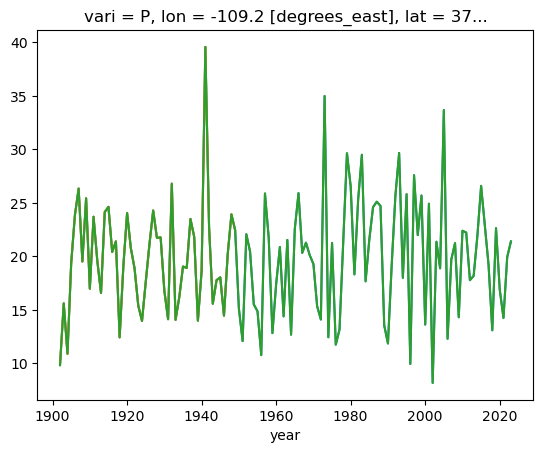

In [88]:
RMA_old.get_data(seasonal=True)
test=recover_original_units_seasonal(RMA_old.val["M"],RMA_old.gamma)
RMA_old.raw["M"].sel(vari="P").mean(dim="season").plot()
test.mean(dim="season").plot()
RMA_old.get_data(seasonal=False)
RMA_old.raw["M"].sel(vari="P").plot()

In [68]:
#Is it just that I've standardized one and not the other?


In [266]:
self.pred["recon"].isel(draw=slice(750,None)).stack(sample=("chain","draw")).rename({"time_recon":"year"}).\
stack(time=("year","season")).sel(vari="P").T.to_pandas().to_csv("DCK_P.csv")


self.pred["recon"].isel(draw=slice(750,None)).stack(sample=("chain","draw")).rename({"time_recon":"year"}).\
stack(time=("year","season")).sel(vari="T").T.to_pandas().to_csv("DCK_T.csv")


In [261]:
data=self.pred["val"]
data_stacked_time = data.stack(time=("time_validate","season"))

# Step 2: Stack 'chain' and 'draw' into 'sample'
data_stacked_sample = data_stacked_time.stack(sample=("chain", "draw"))

# Step 3: Convert to pandas DataFrame
# We want the time dimension to be the rows and the sample dimension to be the columns
data_stacked_sample.sel(vari="P").to_csv("DCK_P.csv")
# # Step 4: Save to Excel, separate by 'vari'
# with pd.ExcelWriter('output.xlsx', engine='openpyxl') as writer:
#     for vari_val in data['vari'].values:
#         # Select data for this 'vari'
#         df_vari = df.xs(vari_val, level='vari', axis=0)
        
#         # Write to the sheet named after the 'vari' value
#         df_vari.to_excel(writer, sheet_name=str(vari_val))

# print("Data saved to 'output.xlsx'.")

AttributeError: 'DataArray' object has no attribute 'to_csv'

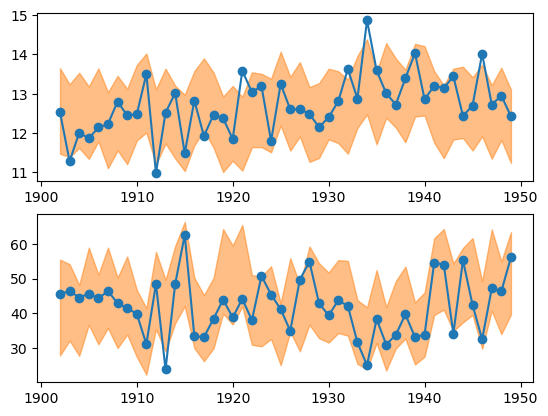

In [249]:
plot_validation(DCK)

In [185]:
DCK=Reconstructor("DCK")
DCK.get_data(seasonal=True)
DCK.seasonal_model(trace=True)

(122,)
(122,)
(122,)
(122,)
(122,)
(122,)
(122,)
(122,)


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [gamma, noise_chol, beta, rhoD, sigmaD, Mval_flat, Mrecon_flat]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 223 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details
There were 4 divergences after tuning. Increase `target_accept` or reparameterize.


In [231]:
DCK.stds["M"]

<xarray.DataArray (season: 4, vari: 2)> Size: 32B
array([[ 1.0705022, 12.8597145],
       [ 1.5991299,  7.608094 ],
       [ 1.1680793, 18.074936 ],
       [ 1.0281799, 24.993916 ]], dtype=float32)
Coordinates:
  * season   (season) object 32B 'SON' 'DJF' 'MAM' 'JJA'
  * vari     (vari) object 16B 'T' 'P'
    lon      float32 4B -100.2
    lat      float32 4B 37.75

In [238]:
self=DCK
def recover_original_units(self):
    self.pred={}
    if not hasattr(self,"seasontrace"):
        self.seasonal_model(trace=True)
    put_back=[]
    for season in self.raw["M"].season.values:
        spi=self.seasontrace.posterior.Mval.sel(vari="P",season=season)
        cumulative_prob = stats.norm.cdf(spi)
        shape,loc,scale=self.gamma[season]
        recovered_precip = gamma.ppf(cumulative_prob, shape, loc, scale)
        da=xr.DataArray(recovered_precip,dims=spi.dims,coords=spi.coords).expand_dims({"season":[season]})
        put_back+=[da]
    Pval_orig=xr.concat(put_back,dim="season")
    put_backr=[]
    for season in self.raw["M"].season.values:
        spir=self.seasontrace.posterior.Mrecon.sel(vari="P",season=season)
        cumulative_probr = stats.norm.cdf(spir)
        shape,loc,scale=self.gamma[season]
        recovered_precipr = gamma.ppf(cumulative_probr, shape, loc, scale)
        dar=xr.DataArray(recovered_precipr,dims=spir.dims,coords=spir.coords).expand_dims({"season":[season]})
        put_backr+=[dar]
    Precon_orig=xr.concat(put_backr,dim="season")

    Tval_orig=((self.stds["M"] * self.seasontrace.posterior.Mval)+self.means["M"]).sel(vari="T")
    Trecon_orig=((self.stds["M"] * self.seasontrace.posterior.Mrecon)+self.means["M"]).sel(vari="T")
    
    self.pred["val"]=xr.concat([Tval_orig.expand_dims({"vari":["T"]}),\
                      Pval_orig.expand_dims({"vari":["P"]})],\
                      dim="vari")
    self.pred["recon"]=xr.concat([Trecon_orig.expand_dims({"vari":["T"]}),\
                      Precon_orig.expand_dims({"vari":["P"]})],\
                      dim="vari")




<Axes: >

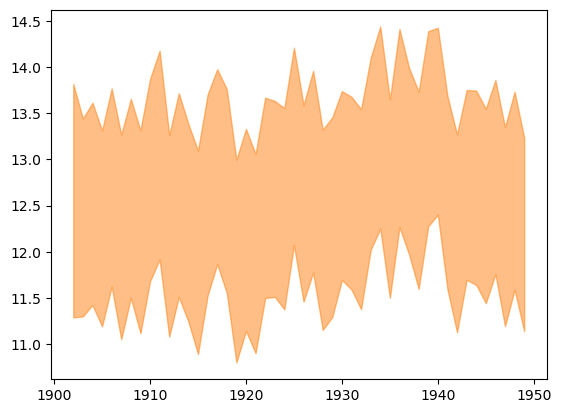

In [239]:
az.plot_hdi(self.taxes["val"],DCK.pred["val"].sel(vari="T").mean(dim="season"),smooth =False)

(4, 1000, 48)


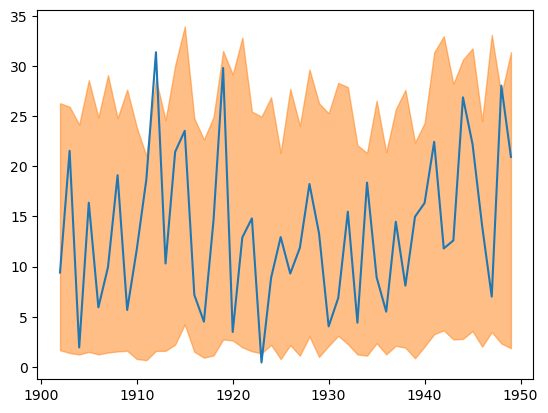

In [199]:
self=DCK
season="DJF"
cumulative_prob = stats.norm.cdf(self.seasontrace.posterior.Mval.sel(vari="P",season=season))
print(cumulative_prob.shape)
shape,loc,scale=self.gamma[season]
# Step 2: Use the cumulative probabilities to recover the precipitation values
# The cumulative probabilities can now be used as inputs to the inverse Gamma CDF
recovered_precip = gamma.ppf(cumulative_prob, shape, loc, scale)
az.plot_hdi(self.taxes["val"],recovered_precip,smooth=False)
plt.plot(self.taxes["val"],self.raw["M"].sel(vari="P",season=season,year=slice(*self.validation_period)).values)

<Axes: >

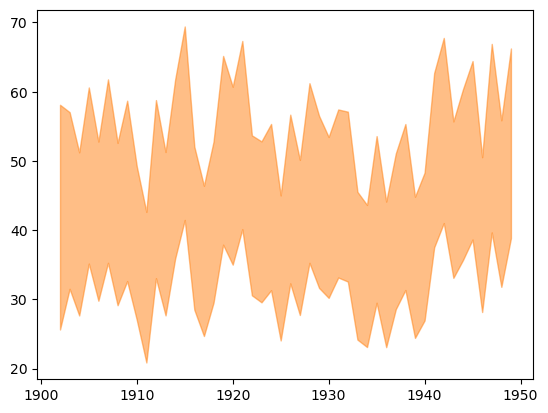

In [224]:
# annual precipitation
put_back=[]
for season in self.raw["M"].season.values:
    spi=self.seasontrace.posterior.Mval.sel(vari="P",season=season)
    cumulative_prob = stats.norm.cdf(self.seasontrace.posterior.Mval.sel(vari="P",season=season))
    shape,loc,scale=self.gamma[season]
    recovered_precip = gamma.ppf(cumulative_prob, shape, loc, scale)
    da=xr.DataArray(recovered_precip,dims=spi.dims,coords=spi.coords).expand_dims({"season":[season]})
    put_back+=[da]
all_recovered=xr.concat(put_back,dim="season")
az.plot_hdi(self.taxes["val"],all_recovered.mean(dim="season"),smooth=False)

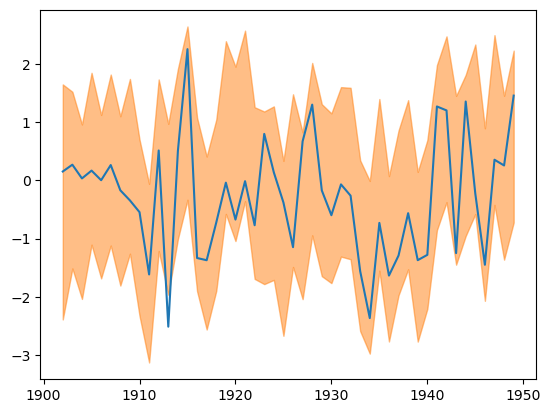

In [18]:
DCK.get_data(seasonal=True)

unZ=DCK.undo_z(DCK.seasontrace.posterior.Mval)
unZ_recon=DCK.undo_z(DCK.seasontrace.posterior.Mrecon)
DCK.get_data(seasonal=False)
Zback=(unZ.mean(dim="season")-DCK.means["M"])/DCK.stds["M"]

tax=DCK.taxes["val"]
az.plot_hdi(tax,Zback.sel(vari="P"),smooth=False)
DCK.get_data(seasonal=False)
plt.plot(tax,DCK.val["M"].sel(vari="P").values)

In [27]:
#burn-in: 750 samples on each chain
df_T=unZ_recon.isel(draw=slice(750,None)).stack(sample=("chain","draw")).rename({"time_recon":"year"}).\
stack(time=("year","season")).sel(vari="T").T.to_pandas()
df_P=unZ_recon.isel(draw=slice(750,None)).stack(sample=("chain","draw")).rename({"time_recon":"year"}).\
stack(time=("year","season")).sel(vari="P").T.to_pandas()
# with pd.ExcelWriter('DCK.xlsx') as writer:
#     df_T.to_excel(writer,sheet_name="T")#,index=False)
#     df_P.to_excel(writer,sheet_name="P")#,index=False)

In [26]:
df_P.to_csv("DCK_P.csv")

In [37]:
DCK.get_data(seasonal=True)
DCK.means["M"].sel(vari="P")

<xarray.DataArray (season: 4)> Size: 16B
array([31.18393 , 14.476785, 54.161312, 77.176796], dtype=float32)
Coordinates:
  * season   (season) object 32B 'SON' 'DJF' 'MAM' 'JJA'
    vari     <U1 4B 'P'
    lon      float32 4B -100.2
    lat      float32 4B 37.75

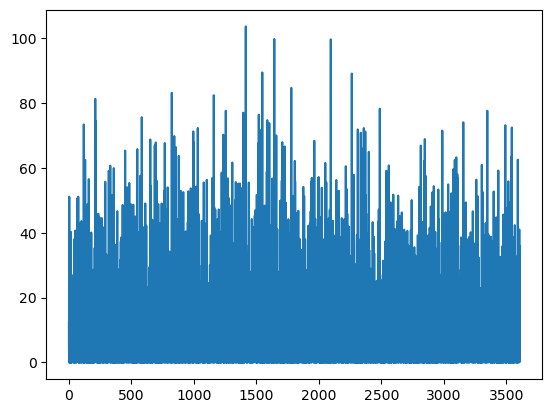

In [39]:
test=df_P=unZ_recon.isel(draw=slice(750,None)).stack(sample=("chain","draw")).rename({"time_recon":"year"}).\
stack(time=("year","season")).sel(vari="P")
plt.plot(softplus(test.isel(sample=0).values))

(array([2113.,  579.,  383.,  256.,  146.,   75.,   35.,   14.,    4.,
           3.]),
 array([  0.        ,  10.35722129,  20.71444259,  31.07166388,
         41.42888518,  51.78610647,  62.14332776,  72.50054906,
         82.85777035,  93.21499165, 103.57221294]),
 <BarContainer object of 10 artists>)

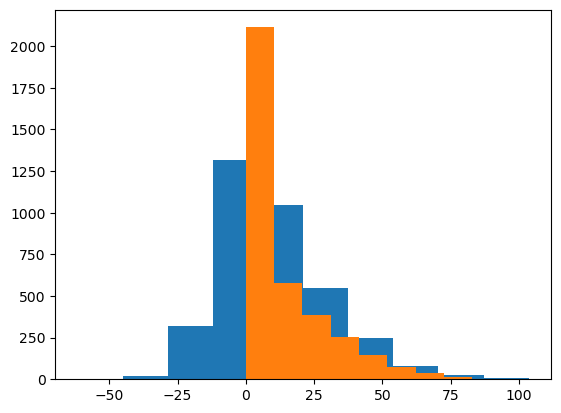

In [44]:
B=test.isel(sample=0).values
plt.hist(B)
plt.hist(softplus(B))

In [205]:
def seasonalmodel(self),trace=True)    
    nlags=1
    
    coords={"vari":["T","P"],\
            "time_train":self.taxes["train"][:-nlags],\
           "cross_vari":["T","P"],\
           "lags":[1],\
           "time_validate":self.taxes["val"],
           "time_recon":self.taxes["recon"],\
           "season":self.val["M"].season.values,\
           "smoosh":smooshed,\
           "cross_smoosh":smooshed}
    smooshed=["_".join(x) for x in self.train["M_flat"].smooshed.values]
    with pm.Model(coords=coords) as self.model:
        #################
        #               #
        # TRAINING data #
        #               #
        #################
        #Mobs=pm.Data("Mobs",self.train["M"].T[:-nlags],mutable=False)
        #Dobs=pm.Data("Dobs",np.concatenate([self.val["D"],self.train["D"]]),mutable=False)
        Dobs=np.concatenate([self.val["D"],self.train["D"]])
        
        #AR(1) model for D
        # beta=pm.Normal("beta",0,1,dims=["vari"])
        # rhoD=pm.Normal("rhoD",0,1)
        # sigmaD=pm.HalfNormal("sigmaD",1)
        # L=pm.Normal("L",0,1,dims=("vari"))
    
        # prior on global temperature regression slope
        gamma=pm.Normal("gamma",0,1,dims=["season","vari"])
        
        # assumed forced response regresses on global mean temperature
        Ftrain=pm.math.stack([\
            pm.math.stack([gamma[j,k]*self.train["G"].values[:-nlags] for k in range(len(coords["vari"]))])\
            for j in range(len(coords["season"]))])
        
        Ftrain_flat=Ftrain\
        .reshape((len(coords["smoosh"]),len(coords["time_train"])))
        
        # covariance between T and P at time t (Cholesky decomposition)
        noise_chol, _, _ = pm.LKJCholeskyCov(
            "noise_chol",
            eta=1,
            n=len(coords["smoosh"]),
            sd_dist=pm.HalfNormal.dist(sigma=1))
        #For display: reconstitute Cholesky -> cov
        cov = pm.Deterministic('cov', noise_chol.dot(noise_chol.T),dims=("smoosh","cross_smoosh")) 
        
        #Likelihood for Mobs.  Press the inference button to get posteriors for gamma and noise
        lik_Mobs = pm.MvNormal("lik_Mobs",mu=Ftrain_flat.T,chol=noise_chol,observed=self.train["M_flat"].values[:-1,:])    
        #Mtrace_mon=pm.sample()
        
    
    #with pm.Model(coords=coords) as inversemodel_mon:
          #################
        #               #
        # TRAINING data #
        #               #
        #################
        
        
        #AR(1) model for D
        #beta is the dependence on same-year meteorology
        beta=pm.Normal("beta",0,1,dims=self.train["M"].dims[:-1])
        #L is the dependence on previous-year meteorology
        #L=pm.Normal("L",0,1,dims=self.train["M"].dims[:-1])
        #Rho is the dependence on previous-year soil moisture
        rhoD=pm.Normal("rhoD",0,1)
        #sigma is the Gaussian noise
        sigmaD=pm.HalfNormal("sigmaD",1)
    
       
      
        #Learn parameters from observations
        #soil moisture "memory"
        Dar=rhoD*self.train["D"].values[:-1] 
       
        
        #Dependence on that year's meteorology
        Mr=self.train["M"].isel(year=slice(1,None)).values
        Mprev=self.train["M"].isel(year=slice(None,-1)).values
        
        Dmean= pm.math.sum([
            pm.math.sum([beta[j,k]*Mr[j,k,:] for k in range(len(coords["vari"]))],axis=0) \
             for j in range(len(coords["season"]))],axis=0)
            
        
        # Dprev=pm.math.sum([
        #     pm.math.sum([L[j,k]*Mprev[j,k,:] for k in range(len(coords["vari"]))],axis=0) \
        #      for j in range(len(coords["season"]))],axis=0)
       
    
        mu_train=Dmean+Dar
    
        
        D_train_likelihood=pm.Normal("Dtrain_lik",mu=mu_train,sigma=sigmaD,observed=self.train["D"].values[1:])
        #forwardtrace=pm.sample()
    
       #  ###################
       #  #                 #
       #  # VALIDATION data #
       #  #                 #
       #  ###################
    
        
        #gamma=Mtrace_mon.posterior.gamma.mean(dim=("chain","draw")).values
      
       
        #cov=Mtrace_mon.posterior.cov.mean(dim=("chain","draw")).values
        
        global_mean_temperature_val=self.val["G"].values
        
        Fval=pm.Deterministic("Fval",\
            pm.math.stack([\
            pm.math.stack([gamma[j,k]*global_mean_temperature_val for k in range(len(coords["vari"]))])\
            for j in range(len(coords["season"]))])\
                              ,dims=("season","vari","time_validate"))
        
        Fval_flat=Fval\
        .reshape((len(coords["smoosh"]),len(coords["time_validate"])))
        
    
        #prior on the unobserved meterology: use learned posterior means
    
        #First, get the flattened Mval- should have dimensions (nt x nsmoosh)
        
        Mval_flat=pm.MvNormal("Mval_flat",mu=Fval_flat.T,cov=cov)
    
        #now reshape it
        Mval=pm.Deterministic("Mval",Mval_flat.reshape(self.val["M_flat"].unstack().shape),\
                              dims=("time_validate", 'season', 'vari'))
        
     
        #dependence on same-year meteorology
        
        Dmean_val=pm.math.sum([\
        pm.math.sum([beta[j,k]*Mval[1:,j,k] for k in range(len(coords["vari"]))],axis=0)\
        for j in range(len(coords["season"]))],axis=0)
        #print(Dmean_val.shape.eval())
        
        #dependence on previous-year PDSI
        Dar_val=rhoD*self.val["D"].values[:-1]
       # print(Dar_val.shape.eval())
        mu_val=Dmean_val+Dar_val
        D_val_likelihood=pm.Normal("Dval_lik",\
                                            mu=mu_val,\
                                            sigma=sigmaD,\
                                            observed=self.val["D"].values[1:])
               
       #  #######################
       #  #                     #
       #  # RECONSTRUCTION data #
       #  #                     #
       #  #######################
    
    
        Mrecon_flat=pm.MvNormal("Mrecon_flat",mu=DCK.Gmean,cov=cov,dims=("time_recon","smoosh"))
        
    
        #now reshape it
        rdims=('time_recon', 'season', 'vari')
        rshape=tuple([len(coords[rdim]) for rdim in rdims])
        Mrecon=pm.Deterministic("Mrecon",Mrecon_flat.reshape(rshape),\
                                     dims=rdims)
        
     
       
            #dependence on same-year meteorology
            
        Dmean_recon=pm.math.sum([\
        pm.math.sum([beta[j,k]*Mrecon[1:,j,k] for k in range(len(coords["vari"]))],axis=0)\
        for j in range(len(coords["season"]))],axis=0)
       
    
        #dependence on previous-year PDSI
        Dar_recon=rhoD*self.recon["D"].values[:-1]
       # print(Dar_val.shape.eval())
        mu_recon=Dmean_recon+Dar_recon
        D_recon_likelihood=pm.Normal("Dval_recon",\
                                            mu=mu_recon,\
                                            sigma=sigmaD,\
                                            observed=self.recon["D"].values[1:])
    
        seasontrace=pm.sample()
        
    
                
            
                
        

Ftrain [ 4  2 55]
Ftrain_flat [ 8 55]
cov [8 8]
obs (56, 8)


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [gamma, noise_chol, beta, rhoD, sigmaD, Mval_flat, Mrecon_flat]


ValueError: Not enough samples to build a trace.

In [194]:
# put back z
DCK.get_data(seasonal=True)

unZ=DCK.undo_z(tracerecon.posterior.Mval)

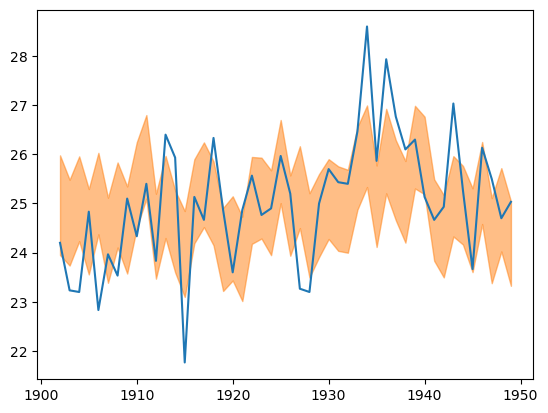

In [202]:
az.plot_hdi(tax,unZ.sel(season="JJA",vari="T"),smooth=False,hdi_prob=.66)
plt.plot(tax,DCK.undo_z(DCK.val["M"]).sel(season="JJA",vari="T").values)

In [189]:
season="JJA"
vari="P"
tax=self.taxes["val"]
# put back the anomalies
DCK.get_data(seasonal=True)

unZ=DCK.undo_z(tracevalidate.posterior.Mval)
DCK.get_data(seasonal=False)
Zback=(unZ.mean(dim="season")-DCK.means["M"])/DCK.stds["M"]

#az.plot_hdi(tax,tracevalidate.posterior.Mval.sel(season=season,vari=vari),smooth=False)
#plt.plot(tax,self.val["M"].sel(season=season,vari=vari).values)

<Axes: >

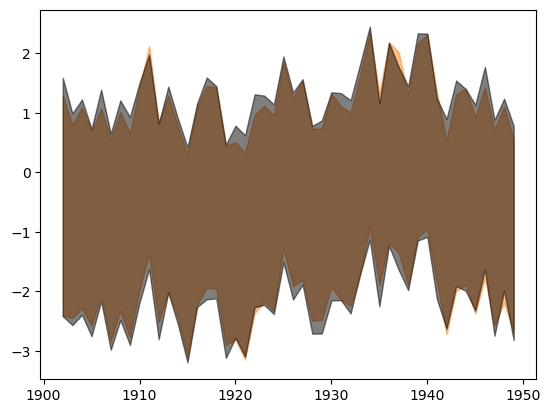

In [190]:
az.plot_hdi(tax,DCK.annualtrace.posterior.Mval.sel(vari="T"),smooth=False)
az.plot_hdi(tax,Zback.sel(vari="T"),smooth=False,color="k")
#az.plot_hdi(tax,tracevalidate.posterior.Mval.sel(vari=vari,season="JJA"),smooth=False,color="k")

In [ ]:
       
   #  #######################
   #  #                     #
   #  # RECONSTRUCTION data #
   #  #                     #
   #  #######################


    Mrecon_flat=pm.MvNormal("Mrecon_flat",mu=DCK.Gmean,cov=cov,dims=("time_recon","smoosh"))
    

    #now reshape it
    rdims=('time_recon', 'season', 'vari')
    rshape=tuple([len(monthcoords[rdim]) for rdim in rdims])
    Mrecon=pm.Deterministic("Mrecon",Mrecon_flat.reshape(rshape),\
                                 dims=rdims)
    
 
   
        #dependence on same-year meteorology
        
    Dmean_recon=pm.math.sum([\
    pm.math.sum([beta[i,j,k]*Mrecon[1:,i,j,k] for k in range(len(monthcoords["vari"]))],axis=0)\
    for j in range(len(monthcoords["season"]))],axis=0)
   

    #dependence on previous-year PDSI
    Dar_recon=rhoD*RECON["D"].values[:-1]
   # print(Dar_val.shape.eval())
    mu_recon=Dmean_recon+Dar_recon
    D_recon_likelihood=pm.Normal("Dval_recon",\
                                        mu=mu_recon,\
                                        sigma=sigmaD,\
                                        observed=RECON["D"].values[1:])

    tracerecon=pm.sample()
    

            
        
            
    

JJA_P JJA_T


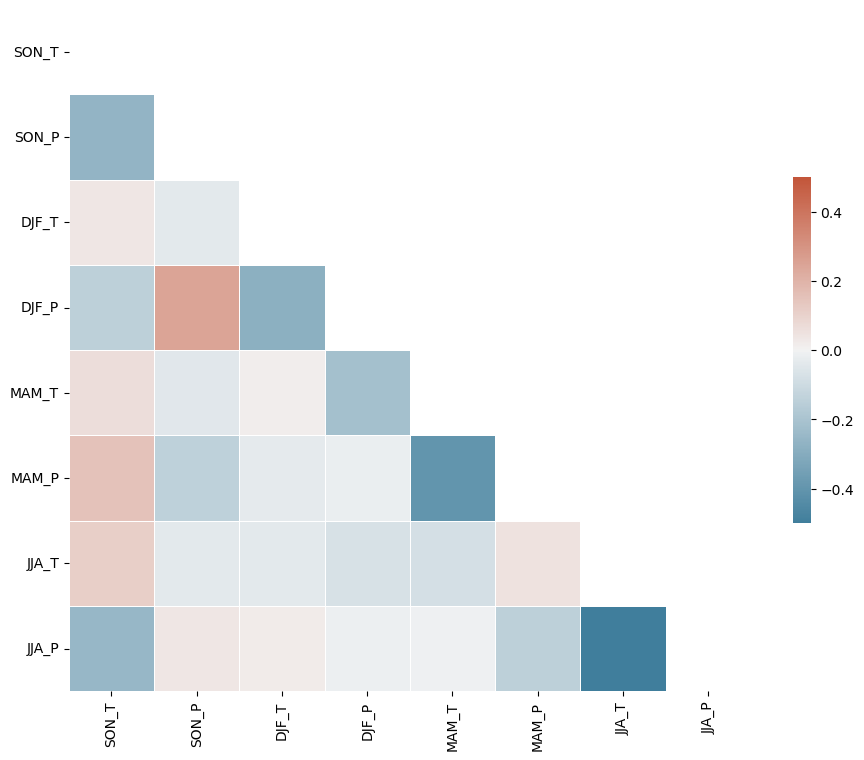

In [78]:
covmean=Mtrace_mon.posterior.cov.mean(dim=("chain","draw"))
Mcov=covmean
mask = np.triu(np.ones_like(Mcov, dtype=bool))

# Set up the matplotlib figure
f=plt.figure(figsize=(11, 9))
ax=f.add_subplot(111)
#f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.heatmap(Mcov, mask=mask, cmap=cmap, vmax=.5,vmin=-.5, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})
#plt.xticks(np.arange(len(smooshed))[::12],[x.split("_SEP")[0] for x in smooshed[::12]])
#plt.yticks(np.arange(len(smooshed))[::12],[x.split("_SEP")[0] for x in smooshed[::12]])
plt.xticks(np.arange(len(smooshed))+.5,smooshed,rotation=90)
plt.yticks(np.arange(len(smooshed))+.5,smooshed,rotation=0)
Mcov_masked=np.ma.masked_where(mask,Mcov.values)
i,j=np.unravel_index(np.argmin(Mcov_masked),Mcov.shape)
print(smooshed[i],smooshed[j])

array([[<Axes: title={'center': 'gamma\nSON, T'}>,
        <Axes: title={'center': 'gamma\nSON, P'}>,
        <Axes: title={'center': 'gamma\nDJF, T'}>,
        <Axes: title={'center': 'gamma\nDJF, P'}>],
       [<Axes: title={'center': 'gamma\nMAM, T'}>,
        <Axes: title={'center': 'gamma\nMAM, P'}>,
        <Axes: title={'center': 'gamma\nJJA, T'}>,
        <Axes: title={'center': 'gamma\nJJA, P'}>]], dtype=object)

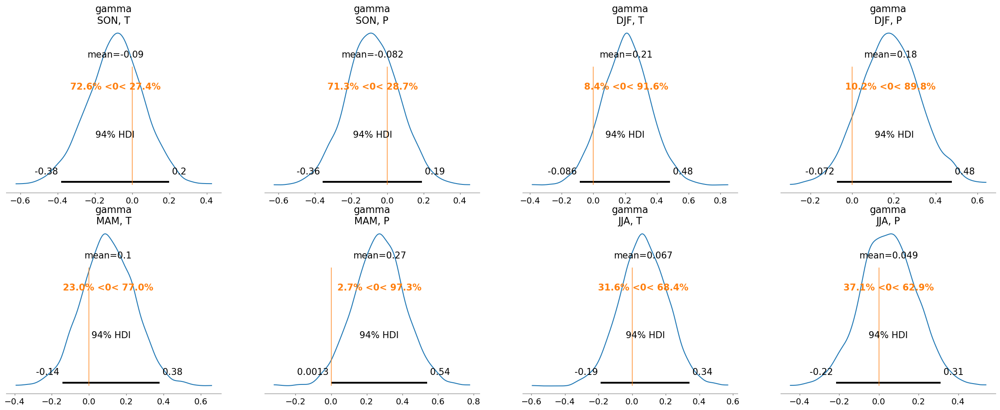

In [79]:
az.plot_posterior(Mtrace_mon.posterior.gamma,ref_val=0.)

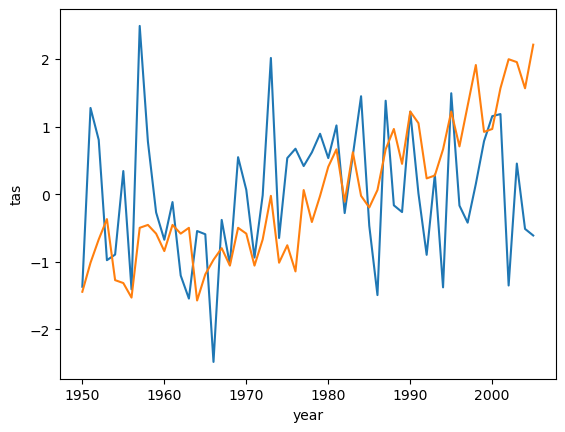

In [81]:
DCK.train["M"].sel(season="MAM",vari="P").plot()
DCK.train["G"].plot()

In [61]:
DCK=Reconstructor("DCK")
#DCK.sample()
RMA=Reconstructor("RMA")
#RMA.sample()
SJC=Reconstructor("SJC")
#SJC.sample()
data_holder={}
data_holder["DCK"]=DCK
data_holder["RMA"]=RMA
data_holder["SJC"]=SJC

# Monthly data


In [919]:

training_period=(1950,2005)
validation_period=(1902, 1949)
reconstruction_period=(1000,1901)


Dlist=[]
for region in regions:
    lat,lon=latlon(region)
    Dlist+=[nada.pdsi.sel(lat=lat,lon=lon).expand_dims({"region":[region]})]
bigD=xr.concat(Dlist,dim="region")
Dmu=bigD.sel(time=slice(*training_period)).mean(dim="time")
Dsigma=bigD.sel(time=slice(*training_period)).std(dim="time")

Dz=(bigD-Dmu)/Dsigma
Dz_val=Dz.sel(time=slice(*validation_period))
Dz_train=Dz.sel(time=slice(*training_period))
Dz_recon=Dz.sel(time=slice(*reconstruction_period))


In [920]:
def get_seasonal(lat,lon,vari):
    X=cru.data[vari].sel(lat=lat,lon=lon)
    X_son=X.sel(month=["SEP","OCT","NOV"]).mean(dim="month").expand_dims({"season":["SON"],"vari":[vari]})
    X_djf=X.sel(month=["DEC","JAN","FEB"]).mean(dim="month").expand_dims({"season":["DJF"],"vari":[vari]})
    X_mam=X.sel(month=["MAR","APR","MAY"]).mean(dim="month").expand_dims({"season":["MAM"],"vari":[vari]})
    X_jja=X.sel(month=["JUN","JUL","AUG"]).mean(dim="month").expand_dims({"season":["JJA"],"vari":[vari]})
    seasonal=xr.concat([X_son,X_djf,X_mam,X_jja],dim="season")
    return seasonal  
seasonal_list=[]
for region in ["DCK","RMA","SJC"]:
    lat,lon=latlon(region)
    vari_list=[]
    for vari in ["T","P"]:
        vari_list+=[get_seasonal(lat,lon,vari).expand_dims({"region":[region]})]
    seasonal_list+=[xr.concat(vari_list,dim="vari")]
seasonal=xr.concat(seasonal_list,dim="region")
                     
                   

train_raw=seasonal.sel(year=slice(*training_period))
val_raw=seasonal.sel(year=slice(*validation_period))

seasonal_mu=train_raw.mean(dim="year")
seasonal_sigma=train_raw.std(dim="year")
TRAIN={}
TRAIN["D"]=Dz_train.rename({"time":"time_train"})
TRAIN["M"]=((train_raw-seasonal_mu)/seasonal_sigma).transpose("region","season","vari","year").rename({"year":"time_train"})
TRAIN["M_flat"]=TRAIN["M"].stack(smooshed=("region","season","vari"))

VALIDATE={}
VALIDATE["D"]=Dz_val.rename({"time":"time_validate"})
VALIDATE["M"]=((val_raw-seasonal_mu)/seasonal_sigma).transpose("region","season","vari","year").rename({"year":"time_validate"})
VALIDATE["M_flat"]=VALIDATE["M"].stack(smooshed=("region","season","vari"))
# VALIDATE["M"]=M_monthly_val_z.transpose("region","vari","month","year")

RECON={}
RECON["D"]=Dz_recon.rename({"time":"time_recon"})


In [806]:
#Make a coordinate that the pymc model can read
smooshed=["_".join(x) for x in TRAIN["M_flat"].smooshed.values]
TRAIN["M_flat"].shape

(56, 24)

In [921]:
#split it up, learn the posterior first

nlags=1
monthcoords={"vari":VALIDATE["M"].vari.values,\
        "time_train":TRAIN["M"].time_train.values,\
       "cross_vari":["T","P"],\
       "lags":[1],\
       "time_validate":VALIDATE["M"].time_validate.values,
       "time_recon":RECON["D"].time_recon.values,\
           "region":["DCK","RMA","SJC"],\
           "season": TRAIN["M"].season.values,
           "smoosh":smooshed,
           "cross_smoosh":smooshed}

with pm.Model(coords=monthcoords) as monthlymodel:
     # prior on global temperature regression slope
    gamma=pm.Normal("gamma",0,1,dims=("region","season","vari"))
   # gamma=pm.Normal("gamma",0,1,dims=("smoosh",))
    
    # assumed forced response regresses on global mean temperature
    global_mean_temperature_train=self.train["G"]
    
    Ftrain=pm.Deterministic("Ftrain",pm.math.stack([\
        pm.math.stack([\
        pm.math.stack([gamma[i,j,k]*global_mean_temperature_train for k in range(len(monthcoords["vari"]))])\
        for j in range(len(monthcoords["season"]))])\
        for i in range((len(monthcoords["region"])))]),dims=("region","season","vari","time_train"))
    Ftrain_flat=Ftrain\
    .reshape((len(monthcoords["smoosh"]),len(monthcoords["time_train"])))
    print("Ftrain_flat",Ftrain_flat.shape.eval())

    # Ftrain=pm.math.stack([gamma[i]*global_mean_temperature_train for i in range(len(monthcoords["smoosh"]))],axis=1)
    # print("Ftrain",Ftrain.shape.eval())
   # covariance between T and P at time t (Cholesky decomposition)
    noise_chol, _, _ = pm.LKJCholeskyCov(
        "noise_chol",
        eta=1,
        n=len(monthcoords["smoosh"]),
        sd_dist=pm.HalfNormal.dist(sigma=1),
    )
    #For display: reconstitute Cholesky -> cov
    cov = pm.Deterministic('cov', noise_chol.dot(noise_chol.T),dims=("smoosh","cross_smoosh")) 
    print("cov",cov.shape.eval())
    # #Likelihood for Mobs.  Press the inference button to get posteriors for gamma and noise
    lik_Mobs = pm.MvNormal("lik_Mobs",mu=Ftrain_flat.T,chol=noise_chol,observed=TRAIN["M_flat"].values)    
    Mtrace_mon=pm.sample()
    

Ftrain_flat [24 56]
cov [24 24]


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [gamma, noise_chol]


/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/pytensor/compile/function/types.py:970: RuntimeWarning: invalid value encountered in accumulate
  self.vm()
Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 36 seconds.


DCK_JJA_P DCK_JJA_T


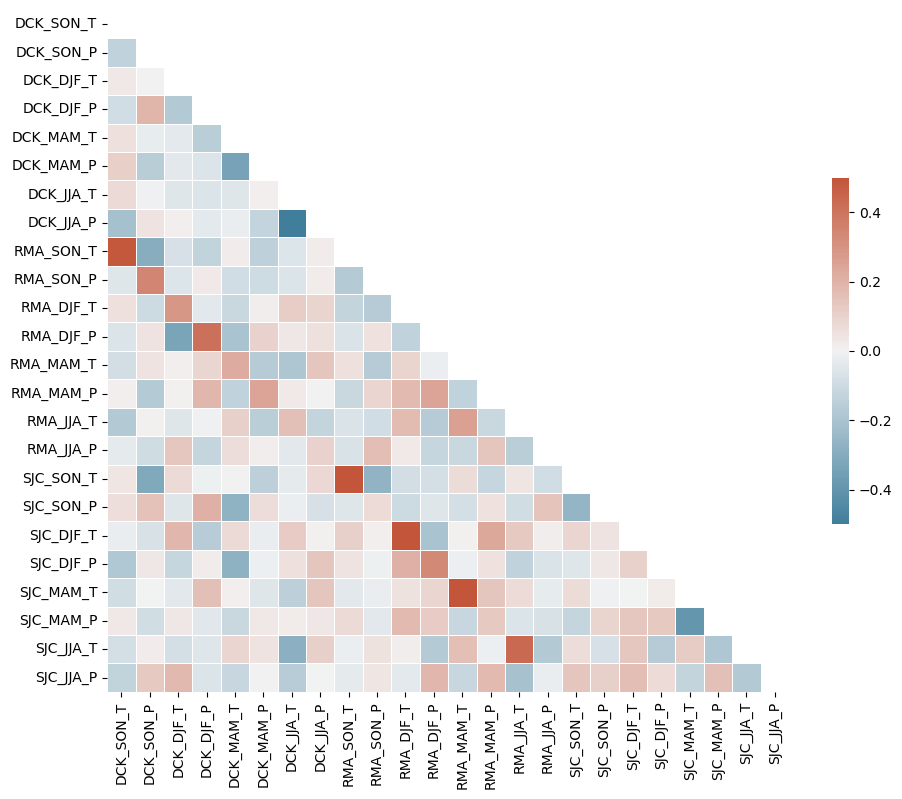

In [923]:
covmean=Mtrace_mon.posterior.cov.mean(dim=("chain","draw"))
Mcov=covmean
mask = np.triu(np.ones_like(Mcov, dtype=bool))

# Set up the matplotlib figure
f=plt.figure(figsize=(11, 9))
ax=f.add_subplot(111)
#f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.heatmap(Mcov, mask=mask, cmap=cmap, vmax=.5,vmin=-.5, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})
#plt.xticks(np.arange(len(smooshed))[::12],[x.split("_SEP")[0] for x in smooshed[::12]])
#plt.yticks(np.arange(len(smooshed))[::12],[x.split("_SEP")[0] for x in smooshed[::12]])
plt.xticks(np.arange(len(smooshed))+.5,smooshed,rotation=90)
plt.yticks(np.arange(len(smooshed))+.5,smooshed,rotation=0)
Mcov_masked=np.ma.masked_where(mask,Mcov.values)
i,j=np.unravel_index(np.argmin(Mcov_masked),Mcov.shape)
print(smooshed[i],smooshed[j])

In [927]:

rdims=('time_recon', 'region', 'season', 'vari')
tuple([len(monthcoords[rdim]) for rdim in rdims])

(902, 3, 4, 2)

In [929]:
with pm.Model(coords=monthcoords) as inversemodel_mon:
      #################
    #               #
    # TRAINING data #
    #               #
    #################
    
    
    #AR(1) model for D
    beta=pm.Normal("beta",0,1,dims=TRAIN["M"].dims[:-1])
    rhoD=pm.Normal("rhoD",0,1,dims=("region",))
    sigmaD=pm.HalfNormal("sigmaD",1,dims=("region",))

   
  
    #Learn parameters from observations
    #soil moisture "memory"
    Dar=pm.math.stack([rhoD[i]*TRAIN["D"].values[i,:-1] for i in range(len(monthcoords["region"]))])
   
    
    #Dependence on that year's meteorology
    Mr=TRAIN["M"].isel(time_train=slice(1,None)).values
    
    Dmean= pm.math.stack([\
        pm.math.sum([
        pm.math.sum([beta[i,j,k]*Mr[i,j,k,:] for k in range(len(monthcoords["vari"]))],axis=0) \
         for j in range(len(monthcoords["season"]))],axis=0)\
        for i in range(len(monthcoords["region"]))],axis=0)
    
    
   

    mu_train=Dmean+Dar

    D_train_likelihoods={}
    for i in range(len(fullcoords["region"])):
        region=fullcoords["region"][i]
        D_train_likelihoods[region]=pm.Normal("Dtrain_lik_"+region,mu=mu_train[i],sigma=sigmaD[i],observed=TRAIN["D"].values[:,1:])
   
   #  ###################
   #  #                 #
   #  # VALIDATION data #
   #  #                 #
   #  ###################

    
    gamma=Mtrace_mon.posterior.gamma.mean(dim=("chain","draw")).values
  
   
    cov=Mtrace_mon.posterior.cov.mean(dim=("chain","draw")).values
    
    global_mean_temperature_val=self.val["G"]
    
    Fval=pm.Deterministic("Fval",pm.math.stack([\
        pm.math.stack([\
        pm.math.stack([gamma[i,j,k]*global_mean_temperature_val for k in range(len(monthcoords["vari"]))])\
        for j in range(len(monthcoords["season"]))])\
        for i in range((len(monthcoords["region"])))]),dims=("region","season","vari","time_validate"))
    
    Fval_flat=Fval\
    .reshape((len(monthcoords["smoosh"]),len(monthcoords["time_validate"])))
    

    #prior on the unobserved meterology: use learned posterior means

    #First, get the flattened Mval- should have dimensions (nt x nsmoosh)
    
    Mval_flat=pm.MvNormal("Mval_flat",mu=Fval_flat.T,cov=cov)

    #now reshape it
    Mval=pm.Deterministic("Mval",Mval_flat.reshape(VALIDATE["M_flat"].unstack().shape),dims=VALIDATE["M_flat"].unstack().dims)
    
 
    D_val_likelihoods={}
    for i in range(len(fullcoords["region"])):
        region=fullcoords["region"][i]
        #dependence on same-year meteorology
        
        Dmean_val=pm.math.sum([\
        pm.math.sum([beta[i,j,k]*Mval[1:,i,j,k] for k in range(len(monthcoords["vari"]))],axis=0)\
        for j in range(len(monthcoords["season"]))],axis=0)
        #print(Dmean_val.shape.eval())
        
        #dependence on previous-year PDSI
        Dar_val=rhoD[i]*VALIDATE["D"].values[i,:-1]
       # print(Dar_val.shape.eval())
        mu_val=Dmean_val+Dar_val
        D_val_likelihoods[region]=pm.Normal("Dval_lik_"+region,\
                                            mu=mu_val,\
                                            sigma=sigmaD[i],\
                                            observed=VALIDATE["D"].values[i,1:])


       
   #  #######################
   #  #                     #
   #  # RECONSTRUCTION data #
   #  #                     #
   #  #######################


    Mrecon_flat=pm.MvNormal("Mrecon_flat",mu=DCK.Gmean,cov=cov,dims=("time_recon","smoosh"))
    

    #now reshape it
    rdims=('time_recon', 'region', 'season', 'vari')
    rshape=tuple([len(monthcoords[rdim]) for rdim in rdims])
    Mrecon=pm.Deterministic("Mrecon",Mrecon_flat.reshape(rshape),\
                                 dims=rdims)
    
 
    D_recon_likelihoods={}
    for i in range(len(monthcoords["region"])):
        region=monthcoords["region"][i]
        #dependence on same-year meteorology
        
        Dmean_recon=pm.math.sum([\
        pm.math.sum([beta[i,j,k]*Mrecon[1:,i,j,k] for k in range(len(monthcoords["vari"]))],axis=0)\
        for j in range(len(monthcoords["season"]))],axis=0)
       
        
        #dependence on previous-year PDSI
        Dar_recon=rhoD[i]*RECON["D"].values[i,:-1]
       # print(Dar_val.shape.eval())
        mu_recon=Dmean_recon+Dar_recon
        D_recon_likelihoods[region]=pm.Normal("Dval_recon_"+region,\
                                            mu=mu_recon,\
                                            sigma=sigmaD[i],\
                                            observed=RECON["D"].values[i,1:])

    tracerecon=pm.sample()
    

            
        
            
    

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [beta, rhoD, sigmaD, Mval_flat, Mrecon_flat]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 310 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details


array([<Axes: title={'center': 'rhoD\nDCK'}>,
       <Axes: title={'center': 'rhoD\nRMA'}>,
       <Axes: title={'center': 'rhoD\nSJC'}>], dtype=object)

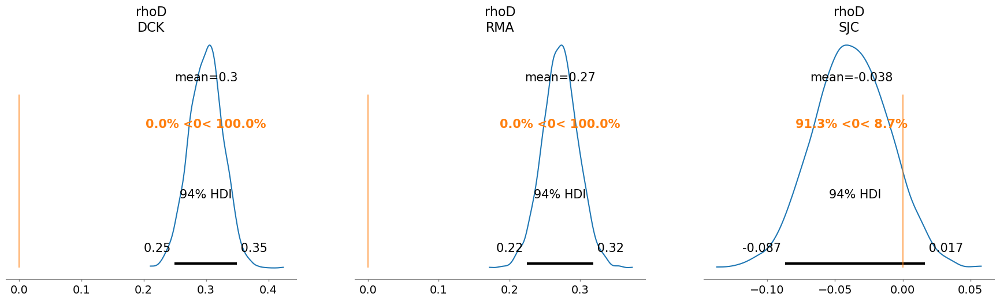

In [935]:
az.plot_posterior(tracerecon.posterior.rhoD,ref_val=0)

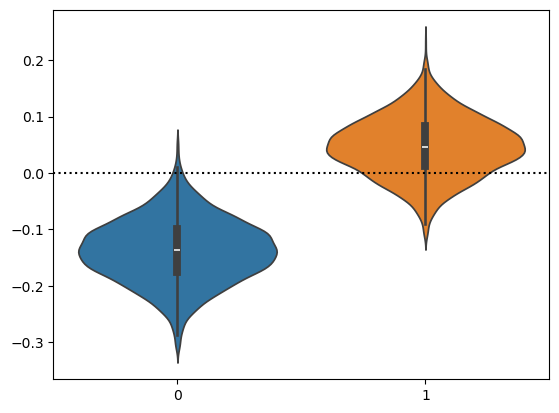

In [939]:
sns.violinplot(tracerecon.posterior.beta.sel(region="DCK",season="JJA").stack(sample=("chain","draw")).T)
plt.axhline(0,c="k",ls=":")

In [966]:
from eofs.xarray import Eof
solver=Eof(nada.sel(time=slice(1920,2005)).pdsi.transpose())

In [ ]:
# how do I i

In [978]:
Tsolver=Eof(cru.data["T"].mean(dim="month").sel(year=slice(*training_period)).rename({"year":"time"}))
Psolver=Eof(cru.data["P"].mean(dim="month").sel(year=slice(*training_period)).rename({"year":"time"}))

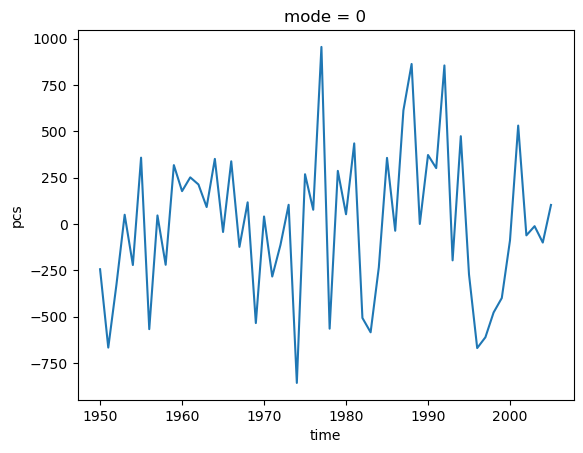

In [979]:
Psolver.pcs().sel(mode=0).plot()

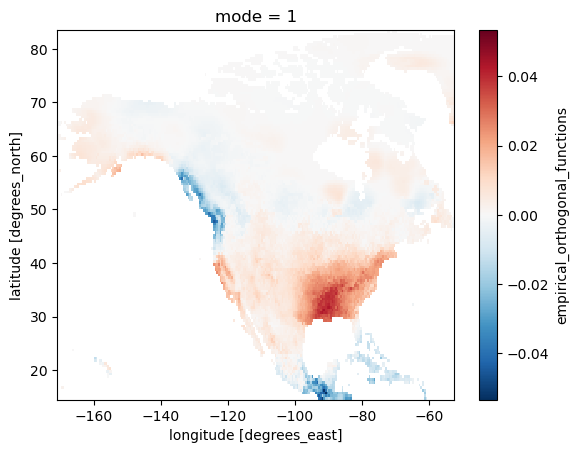

In [981]:
Psolver.eofs().sel(mode=1).plot()


array([<Axes: title={'center': 'beta\nSON'}>,
       <Axes: title={'center': 'beta\nDJF'}>,
       <Axes: title={'center': 'beta\nMAM'}>,
       <Axes: title={'center': 'beta\nJJA'}>], dtype=object)

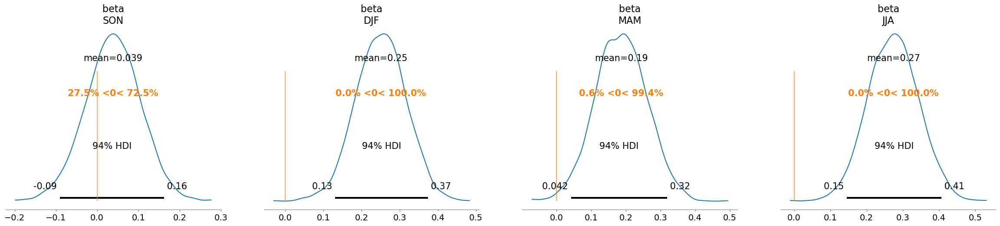

In [895]:
az.plot_posterior(tracevalidate.posterior.beta.sel(region="SJC",vari="P"),ref_val=0)

In [841]:
Zback_trace=seasonal_sigma*tracevalidate.posterior.Mval+seasonal_mu
Zback_data=seasonal_sigma*VALIDATE["M"]+seasonal_mu


48


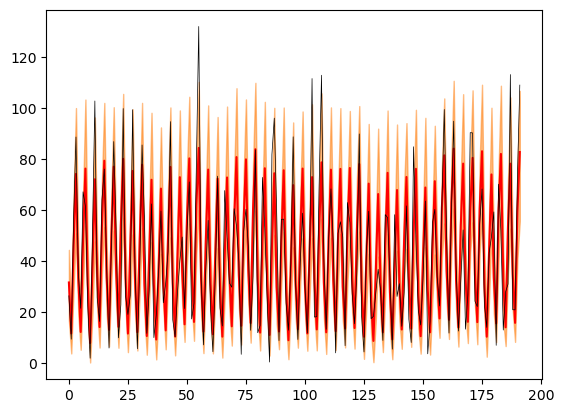

In [845]:
##WHAT IS GOING ON????????????? (The average is going to be different becasue I'm rescaling each season by different values)
#TODO: put Z back, then group by season, then subtract off annual
print(len(monthcoords["time_validate"]))
stakk=Zback_trace.sel(region="DCK",vari="P").stack(time=("time_validate","season"))
X=np.arange(len(monthcoords["time_validate"])*4)
az.plot_hdi(X,stakk,smooth=False,hdi_prob=.66)
plt.plot(X,stakk.mean(dim=("chain","draw")).values,c="r")
plt.plot(X,Zback_data.sel(region="DCK",vari="P").stack(time=("time_validate","season")).values,c="k",lw=.5)
#plt.axhline(0,c="k",ls=":")
# #.plot_hdi(monthcoords["time_validate"],inversetrace.posterior.Mval.sel(Mreg='DCK_T'),smooth=False,color="k")
# # plt.plot(monthcoords["time_validate"],VALIDATE["M"].sel(region="DCK",vari="T").mean(dim="season").values)
# # plt.plot(monthcoords["time_validate"],DCK.val["M"][0])
# az.plot_hdi(X[::4],tracevalidate.posterior.Mval.sel(region="DCK",vari="P",season="SON"),smooth=False)
# az.plot_hdi(X[1::4],tracevalidate.posterior.Mval.sel(region="DCK",vari="P",season="DJF"),smooth=False)

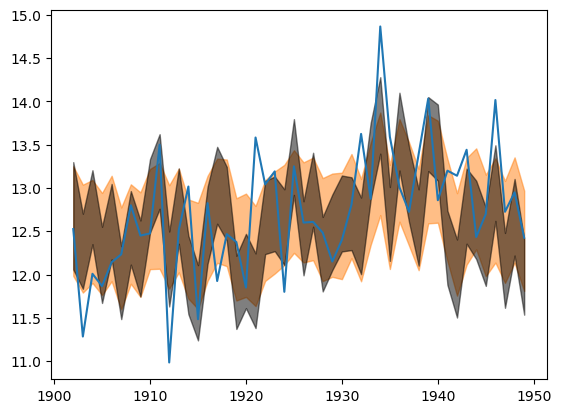

In [878]:
az.plot_hdi(np.arange(48)+1902,Zback_trace.sel(region="DCK",vari="T").mean(dim="season"),smooth=False,hdi_prob=.66)
#plt.plot(np.arange(48)+1902, DCK.undo_z(DCK.val["M"])[1])
az.plot_hdi(np.arange(48)+1902,DCK.means["M"][0]+DCK.stds["M"][0]*inversetrace.posterior.Mval.sel(Mreg="DCK_T"),smooth=False,\
            color="k",hdi_prob=.66)

plt.plot(np.arange(48)+1902,Zback_data.sel(region="DCK",vari="T").mean(dim="season").values)
#plt.plot(np.arange(48)+1902,DCK.raw["M"].sel(year=slice(*validation_period),vari="P").values)

/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/arviz/plots/pairplot.py:232: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  gridsize = int(dataset.dims["draw"] ** 0.35)


array([[<Axes: ylabel='Mval\nDCK, DJF'>, <Axes: >, <Axes: >, <Axes: >,
        <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='Mval\nDCK, MAM'>, <Axes: >, <Axes: >, <Axes: >,
        <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='Mval\nDCK, JJA'>, <Axes: >, <Axes: >, <Axes: >,
        <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='Mval\nRMA, SON'>, <Axes: >, <Axes: >, <Axes: >,
        <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='Mval\nRMA, DJF'>, <Axes: >, <Axes: >, <Axes: >,
        <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='Mval\nRMA, MAM'>, <Axes: >, <Axes: >, <Axes: >,
        <Axes: >, <Axes: >, <Axes: >],
       [<Axes: xlabel='Mval\nDCK, SON', ylabel='Mval\nRMA, JJA'>,
        <Axes: xlabel='Mval\nDCK, DJF'>, <Axes: xlabel='Mval\nDCK, MAM'>,
        <Axes: xlabel='Mval\nDCK, JJA'>, <Axes: xlabel='Mval\nRMA, SON'>,
        <Axes: xlabel='Mval\nRMA, DJF'>, <Axes: xlabel='Mval\nRMA, MAM'>]],
      dtype=object)

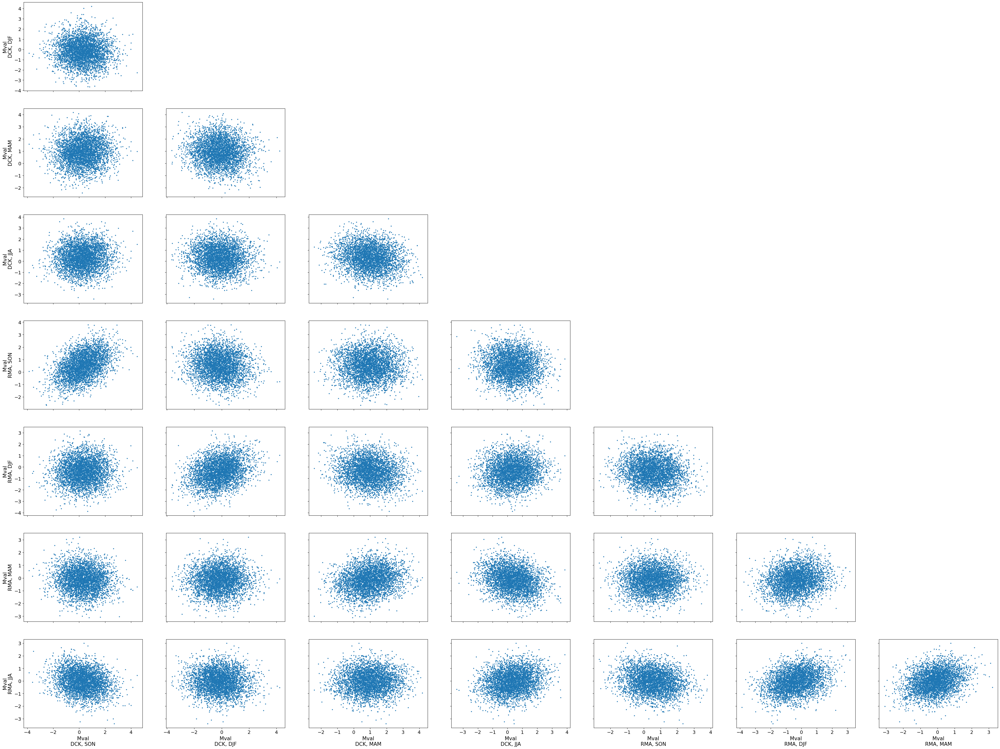

In [882]:
az.plot_pair(tracevalidate.posterior.Mval.sel(region=["DCK","RMA"],vari="T",season=,time_validate=1934))

In [570]:
Mr=TRAIN["M"].sel(region="DCK").isel(year=slice(None,-1))
Mr.season

<xarray.DataArray 'season' (season: 4)> Size: 32B
array(['SON', 'DJF', 'MAM', 'JJA'], dtype=object)
Coordinates:
  * season   (season) object 32B 'SON' 'DJF' 'MAM' 'JJA'
    region   <U3 12B 'DCK'

In [577]:
with pm.Model(coords=monthcoords) as inversemodel:
    Y=TRAIN["D"].sel(region="DCK").values
      #################
    #               #
    # TRAINING data #
    #               #
    #################
    
    
    #AR(1) model for D
    beta=pm.Normal("beta",0,1,dims=("season","vari"))
    
    rhoD=pm.Normal("rhoD",0,1)
    sigmaD=pm.HalfNormal("sigmaD",1)
   
   
  
    #Learn parameters from observations
    #soil moisture "memory"
    Dar=rhoD*Y[:-1] 
   # print("Dar",Dar.shape.eval())
    
    #Dependence on that year's meteorology
    Mr=TRAIN["M"].sel(region="DCK").isel(year=slice(1,None))
    

    Dmean=pm.math.sum([\
        pm.math.sum([beta[j,k]*Mr.values[j,k,:] for k in range(len(monthcoords["vari"]))],axis=0)\
        for j in range(len(monthcoords["season"]))],axis=0)
    
    
   #  # Correlation with following year meteorology
   #  # Mnext=reshaped_training_M[:,:,2:]
   #  # Dforward=pm.math.stack([
   #  #     pm.math.sum([L[i,j]*Mnext[i,j] for j in range(len(fullcoords["vari"]))],axis=0) \
   #  #      for i in range(len(fullcoords["region"]))],axis=0)
   
    
   # # mu_train=Dmean+Dforward+Dar
   #  #print("mu_train",mu_train.shape.eval())
    #mu_train=Dmean+Dar
    mu_train=Dmean+Dar

   #  #print(training_D[:,1:-1].shape)
   # # print(sigmaD.shape.eval())
   
    region="DCK"
    D_train_likelihood=pm.Normal("Dtrain_lik_"+region,mu=mu_train,sigma=sigmaD,observed=Y[1:])
    traceDCK=pm.sample()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [beta, rhoD, sigmaD]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 1 seconds.


array([<Axes: title={'center': 'beta\nSON'}>,
       <Axes: title={'center': 'beta\nDJF'}>,
       <Axes: title={'center': 'beta\nMAM'}>,
       <Axes: title={'center': 'beta\nJJA'}>], dtype=object)

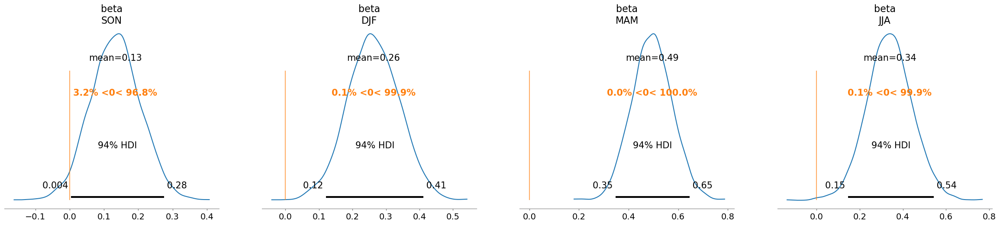

In [578]:
#The model thinks it's all random noise.  But it definitely isn't!
az.plot_posterior(traceDCK.posterior.beta.sel(vari="P"),ref_val=0)

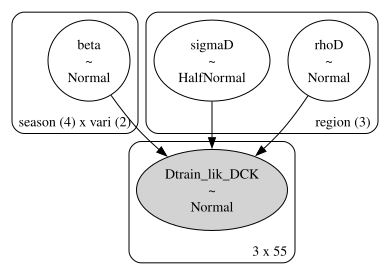

In [536]:
az.plot_hdi(

<xarray.DataArray ()> Size: 8B
array(0.47442346)
Coordinates:
    region   <U3 12B 'DCK'
    lon      float64 8B -100.2
    lat      float64 8B 37.75
    season   <U3 12B 'JJA'
    vari     <U1 4B 'P'

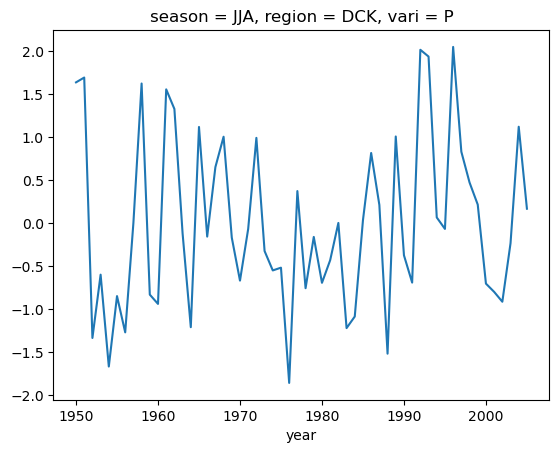

In [487]:
#Does this check out?  Which seasonal precips are the most correlated?
TRAIN["M"].sel(region="DCK",season="JJA",vari="P").plot()
TRAIN["D"].sel(region="DCK").rename({"time":"year"})#.plot()
xr.corr(TRAIN["D"].sel(region="DCK").rename({"time":"year"}),TRAIN["M"].sel(region="DCK"),dim="year").sel(vari="P",season="JJA")

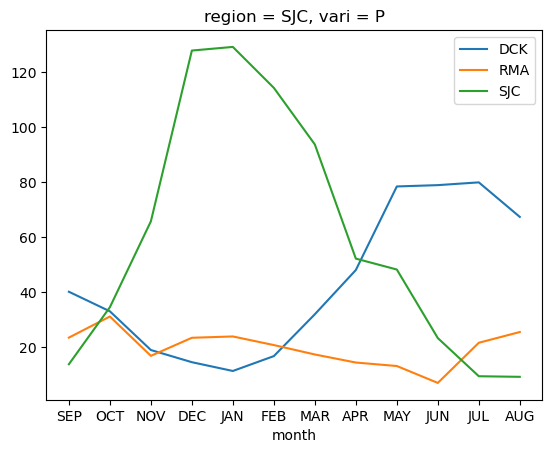

In [467]:
MONTHLY.sel(region="DCK",vari="P").mean(dim="year").plot(label="DCK")
MONTHLY.sel(region="RMA",vari="P").mean(dim="year").plot(label="RMA")
MONTHLY.sel(region="SJC",vari="P").mean(dim="year").plot(label="SJC")
plt.legend()
                                                         

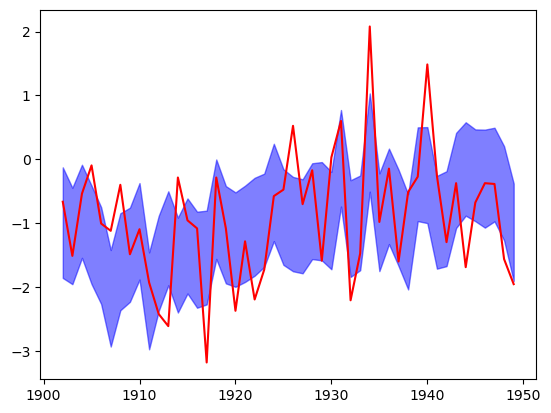

In [1236]:
# It in general does pretty well
#az.plot_hdi(DCK.taxes["val"],inversetrace.posterior.Mval.sel(Mreg="RMA_P"),smooth=False)
az.plot_hdi(DCK.taxes["val"],inversetrace_noforward.posterior.Mval.sel(Mreg="SJC_T"),smooth=False,color="b",hdi_prob=.66)

plt.plot(DCK.taxes["val"],SJC.val["M"][0],c="r")
#plt.axvline(1934)

<Axes: title={'center': 'cov'}>

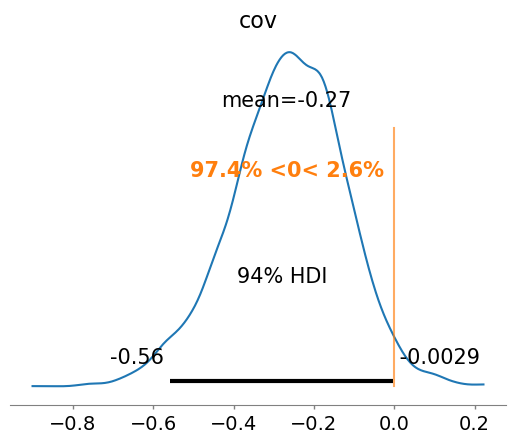

In [1185]:
az.plot_posterior(Mtrace.posterior.cov.sel(Mreg="SJC_P",cross_Mreg="DCK_T"),ref_val=0)

/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/arviz/plots/pairplot.py:232: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  gridsize = int(dataset.dims["draw"] ** 0.35)


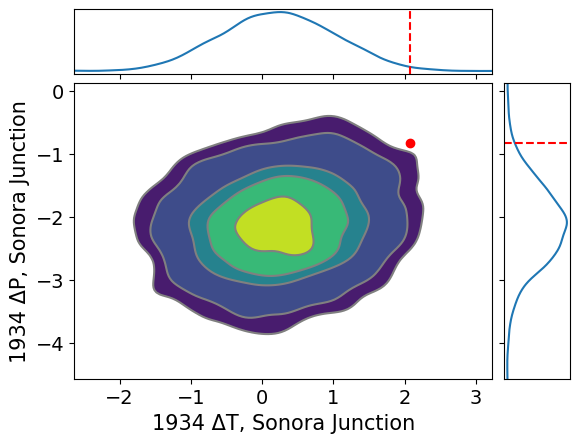

In [1232]:
axes=az.plot_pair(inversetrace_noforward.posterior.Mval.sel(Mreg=["SJC_T","SJC_P"],time_validate=1934),\
                  kind="kde",\
                  kde_kwargs={"hdi_probs":[.2,.5,.66,.9,.95]},\
                  marginals=True)
axes[1,0].plot([SJC.z["M"][0].sel(year=1934)],[SJC.z["M"][1].sel(year=1934)],"ro")
axes[1,0].set_xlabel("1934 ΔT, Sonora Junction")
axes[1,0].set_ylabel("1934 ΔP, Sonora Junction")
axes[0,0].axvline(SJC.z["M"][0].sel(year=1934),ls="--",c="r")
axes[1,1].axhline(SJC.z["M"][1].sel(year=1934),ls="--",c="r")
#axes[1,0]

/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/arviz/plots/pairplot.py:232: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  gridsize = int(dataset.dims["draw"] ** 0.35)


Text(0, 0.5, '1934 ΔP (z), Dodge City KS')

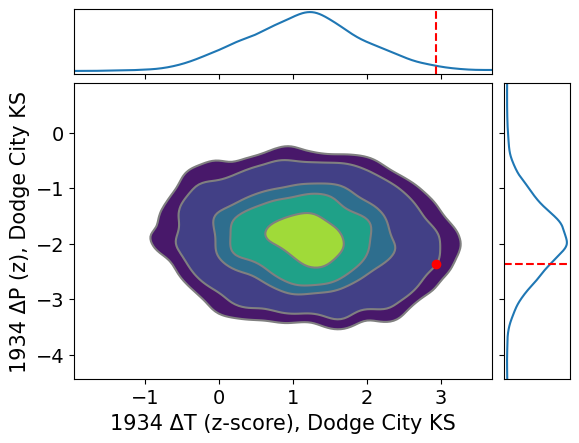

In [1227]:
axes=az.plot_pair(inversetrace_noforward.posterior.Mval.sel(Mreg=["DCK_T","DCK_P"],time_validate=1934),\
                                                            kind="kde",\
                                                            kde_kwargs={"hdi_probs":[.2,.5,.66,.9,.95]},\
                                                            marginals=True)
axes[1,0].plot([DCK.z["M"][0].sel(year=1934)],[DCK.z["M"][1].sel(year=1934)],"ro")
axes[0,0].axvline(DCK.z["M"][0].sel(year=1934),ls="--",c="r")
axes[1,1].axhline(DCK.z["M"][1].sel(year=1934),ls="--",c="r")
axes[1,0].set_xlabel("1934 ΔT (z-score), Dodge City KS")
axes[1,0].set_ylabel("1934 ΔP (z), Dodge City KS")

In [1071]:
trma=fulltrace.posterior.Mval.sel(Mreg="RMA_T").mean(dim=("chain","draw"))
pdck=fulltrace.posterior.Mval.sel(Mreg="DCK_P").mean(dim=("chain","draw"))
xr.corr(trma,pdck)
#these are very correlated, but they should not be
#plt.plot(DCK.taxes["val"],RMA.val["M"][1])

<xarray.DataArray 'Mval' ()> Size: 8B
array(0.43759725)

array([[<Axes: title={'center': 'cov\nDCK_T'}>,
        <Axes: title={'center': 'cov\nDCK_P'}>,
        <Axes: title={'center': 'cov\nRMA_T'}>],
       [<Axes: title={'center': 'cov\nRMA_P'}>,
        <Axes: title={'center': 'cov\nSJC_T'}>,
        <Axes: title={'center': 'cov\nSJC_P'}>]], dtype=object)

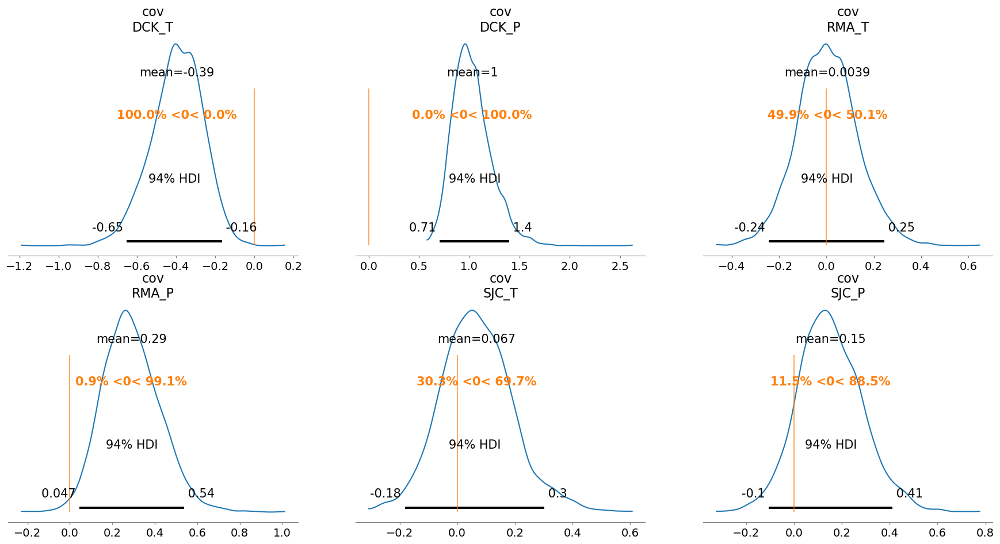

In [1066]:
az.plot_posterior(fulltrace.posterior.cov.sel(Mreg="DCK_P"),ref_val=0)

array([<Axes: title={'center': 'gamma\nT'}>,
       <Axes: title={'center': 'gamma\nP'}>], dtype=object)

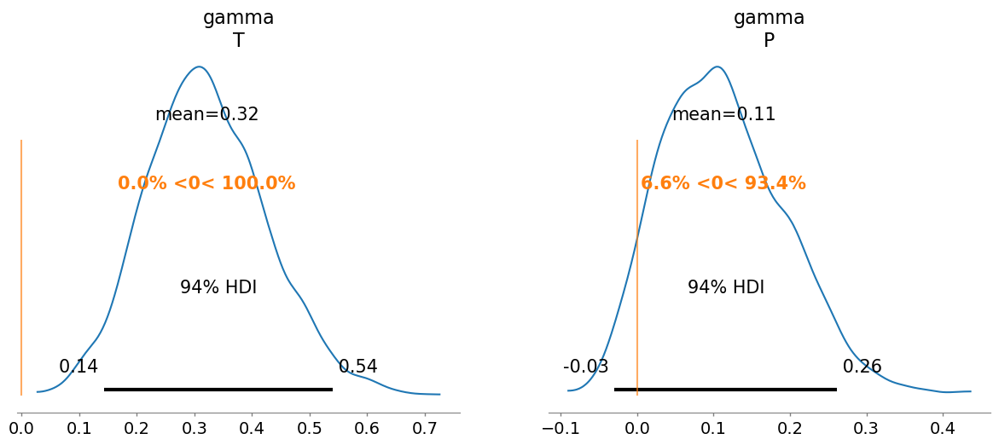

In [1056]:
az.plot_posterior(DCK.trace.posterior.gamma,ref_val=0)

In [728]:
class Linear():
    def __init__(self,\
                 region,
                 training_period=(1950,2005),\
                 validation_period=(1902,1949),\
                reconstruction_period=(1000,1901)):
        
        self.training_period=training_period
        self.validation_period=validation_period
        self.region=region
        
        lat,lon=latlon(self.region)
        self.lat=lat
        self.lon=lon
        T= cru.data["T"].sel(lat=lat,lon=lon).mean(dim="month")
        P= cru.data["P"].sel(lat=lat,lon=lon).mean(dim="month")
        M=xr.concat([T.expand_dims({"vari":["T"]}),P.expand_dims({"vari":["P"]})],dim="vari")
        #
        D=nada.sel(lat=self.lat,lon=self.lon).pdsi
        D=D.rename(time="year")
        #D= cru.data["D"].sel(lat=lat,lon=lon)
        #D=D.assign_coords(time=("time",T.year.values)).rename(time="year")
        #Global mean temperature: JJA for now
        gistemp_data=pd.read_csv("https://data.giss.nasa.gov/gistemp/tabledata_v4/GLB.Ts+dSST.csv",header=1)
        G=xr.DataArray(data=gistemp_data["JJA"].values[:-1].astype(np.float32),\
                     dims=("year"),\
                     coords={"year":gistemp_data["Year"].values[:-1]}).rename("tas")

        self.raw={}
        self.raw["M"]=M
        self.raw["D"]=D
        self.raw["G"]=G
        
        #means and std over the training period
        self.means={}
        #self.means["T"]=float(T.sel(year=slice(*training_period)).mean(dim="year"))
        #self.means["P"]=float(P.sel(year=slice(*training_period)).mean(dim="year"))
        self.means["M"]=M.sel(year=slice(*training_period)).mean(dim="year")
        self.means["D"]=float(D.sel(year=slice(*training_period)).mean(dim="year"))
        self.means["G"]=float(gistemp.sel(year=slice(*training_period)).mean())

        self.stds={}
       #self.stds["T"]=float(T.sel(year=slice(*training_period)).std(dim="year"))
       # self.stds["P"]=float(P.sel(year=slice(*training_period)).std(dim="year"))
        self.stds["M"]=M.sel(year=slice(*training_period)).std(dim="year")
        self.stds["D"]=float(D.sel(year=slice(*training_period)).std(dim="year"))
        self.stds["G"]=float(gistemp.sel(year=slice(*training_period)).std())

        self.z={}

        # self.z["T"]=(T-self.means["T"])/self.stds["T"]
        # self.z["P"]=(P-self.means["P"])/self.stds["P"]
        self.z["M"]=(M-self.means["M"])/self.stds["M"]
        self.z["D"]=(D-self.means["D"])/self.stds["D"]
        self.z["G"]=(G-self.means["G"])/self.stds["G"]

       

        self.train={}
        self.train["M"]=self.z["M"].sel(year=slice(*training_period)).values
        self.train["G"]=self.z["G"].sel(year=slice(*training_period)).values
        self.train["D"]=self.z["D"].sel(year=slice(*training_period)).values

        
        self.val={}
        self.val["M"]=self.z["M"].sel(year=slice(*validation_period)).values
        self.val["G"]=self.z["G"].sel(year=slice(*validation_period)).values
        self.val["D"]=self.z["D"].sel(year=slice(*validation_period)).values

        self.recon={}
        # We don't have G or M over the reconstriction period
        self.recon["D"]=self.z["D"].sel(year=slice(*reconstruction_period)).values

        self.taxes={}
        self.taxes["train"]=self.z["M"].sel(year=slice(*training_period)).year.values
        self.taxes["val"]=self.z["M"].sel(year=slice(*validation_period)).year.values
        self.taxes["recon"]=self.z["D"].sel(year=slice(*reconstruction_period)).year.values

        #modeling global mean temperature preindustrial
        self.Gsigma=detrend(self.val["G"]).std()
        self.Gmean=self.val["G"][:20].mean()

    def make_model(self):
        nlags=1
    
        coords={"vari":["T","P"],\
                "time_train":self.taxes["train"],\
               "cross_vari":["T","P"],\
               "lags":[1],\
               "time_validate":self.taxes["val"],
               "time_recon":self.taxes["recon"]}
        
        with pm.Model(coords=coords) as self.model:
            #################
            #               #
            # TRAINING data #
            #               #
            #################
            Mobs=pm.Data("Mobs",self.train["M"].T,mutable=False)
            #Dobs=pm.Data("Dobs",np.concatenate([self.val["D"],self.train["D"]]),mutable=False)
            Dobs=np.concatenate([self.val["D"],self.train["D"]])
            
            #linear model for D
            beta=pm.Normal("beta",0,1,dims=["vari"])
            #rhoD=pm.Normal("rhoD",0,1)
            sigmaD=pm.HalfNormal("sigmaD",1)
            #L=pm.Normal("L",0,1,dims=("vari"))
        
            # prior on global temperature regression slope
            gamma=pm.Normal("gamma",0,1,dims=["vari"])
            
            # assumed forced response regresses on global mean temperature
            Ftrain=pm.Deterministic("Ftrain",\
                                    gamma*np.stack([self.train["G"],self.train["G"]]).T,\
                                    dims=("time_train","vari")) 
                
            # covariance between T and P at time t (Cholesky decomposition)
            noise_chol, _, _ = pm.LKJCholeskyCov(
                "noise_chol",
                eta=1,
                n=len(coords["vari"]),
                sd_dist=pm.HalfNormal.dist(sigma=1),
            )
            #For display: reconstitute Cholesky -> cov
            cov = pm.Deterministic('cov', noise_chol.dot(noise_chol.T),dims=("vari","cross_vari")) 
            
            #Likelihood for Mobs.  Press the inference button to get posteriors for gamma and noise
            lik_Mobs = pm.MvNormal("lik_Mobs",mu=Ftrain,chol=noise_chol,observed=Mobs,dims=("time_train","vari"))
        
            #Learn parameters from observations
            #soil moisture "memory"
            #Dar=rhoD*self.train["D"][:-2]
           
        #    #Dependence on that year's meteorology
            Dmean=pt.dot(beta.T,self.train["M"])
            
            # Correlation with following year meteorology
           # Dforward=pt.dot(L.T,self.train["M"][:,2:])
            
            #Likelihood for D given M, gamma, L, beta, T
            mu_train=Dmean

            Dtrain_lik=pm.Normal("Dtrain_lik",mu=mu_train,sigma=sigmaD,observed=self.train["D"])
        
            ###################
            #                 #
            # VALIDATION data #
            #                 #
            ###################
            # Forced response: observed GMT
            Fval=pm.Deterministic("Fval",gamma*np.stack([self.val["G"],self.val["G"]]).T,dims=("time_validate","vari")) 
            
            #Prior on the unobserved meteorology
            Munobs=pm.MvNormal("Mval",mu=Fval,chol=noise_chol,dims=("time_validate","vari"))
           
            Munobsconc=Munobs
            Dobsconc=self.val["D"]
        
            #Dar_val=rhoD*Dobsconc[:-2]
            
           # Dforward_val=pt.dot(L.T,Munobsconc[2:].T)
            Dmean_val=pt.dot(beta.T,Munobsconc.T)
           
            mu_val=Dmean_val
            
            Dval_lik=pm.Normal("Dval_lik",mu=mu_val,sigma=sigmaD,observed=Dobsconc)

            
            #######################
            #                     #
            # RECONSTRUCTION data #
            #                     #
            #######################

            #Assume GMT is normally distributed
           # Grecon=pm.Normal("Grecon",mu=self.Gmean,sigma=1,dims=("time_recon"))

            # Forced response: unobserved GMT
    
            #Frecon=pm.Deterministic("Frecon",pm.math.stack([gamma[0]*Grecon,gamma[1]*Grecon]).T,dims=("time_recon","vari"))
            Frecon=np.average(self.val["M"][:,:20],axis=-1)
            #print("Frecon.shape",Frecon.shape.eval())
             
            # #Prior on the reconstructed meteorology
            Mrecon=pm.MvNormal("Mrecon",mu=Frecon,chol=noise_chol,dims=("time_recon","vari"))
            #print(Munobs[:1].shape.eval())
           # print("Mrecon shape",Mrecon.shape.eval())
            Mreconconc=Mrecon#pm.math.concatenate([Mrecon,Munobs[:1]],axis=0)
            
            Dpaleoconc=self.recon["D"]#np.concatenate([self.recon["D"],self.val["D"][:1]])
        
           # Dar_recon=rhoD*Dpaleoconc[:-2]
            
           # Dforward_recon=pt.dot(L.T,Mreconconc[2:].T)
            Dmean_recon=pt.dot(beta.T,Mreconconc.T)
           
            mu_recon=Dmean_recon#+Dforward_recon+Dar_recon
           
            Drecon_lik=pm.Normal("Drecon_lik",mu=mu_recon,sigma=sigmaD,observed=Dpaleoconc)
        
        
    def sample(self):
        if not hasattr(self,"model"):
            self.make_model()
        with self.model:
        
            self.trace=pm.sample()
    def plot_validation(self,z=False):
        if not hasattr(self,"trace"):
            self.sample()
        if z:
            X=self.trace.posterior.Mval
            V=self.val["M"]
        else:
            X=self.undo_z(self.trace.posterior.Mval)
            V=self.raw["M"].sel(year=slice(*self.validation_period)).values
        plt.subplot(211)
        tax=self.taxes["val"]
        az.plot_hdi(tax,X.sel(vari="T"),smooth=False,hdi_prob=.90)
        plt.plot(tax,V[0],"-o")
        plt.subplot(212)
        tax=self.taxes["val"]
        az.plot_hdi(tax,X.sel(vari="P"),smooth=False,hdi_prob=.90)
        plt.plot(tax,V[1],"-o")
    def plot_posteriors(self,var_names=None):
        if var_names==None:
            var_names=["L","beta","rhoD","gamma","cov"]
        if not hasattr(self,"trace"):
            self.sample()
        az.plot_posterior(self.trace,var_names=var_names,ref_val=0)   
    def undo_z(self,Z):
        mu=self.means["M"]
        sigma=self.stds["M"]
        return (sigma*Z)+mu
        
        
            

        



In [729]:
linear_models={}
linear_models["DCK"]=Linear("DCK")

In [730]:
linear_models["DCK"].sample()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [beta, sigmaD, gamma, noise_chol, Mval, Mrecon]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 70 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details


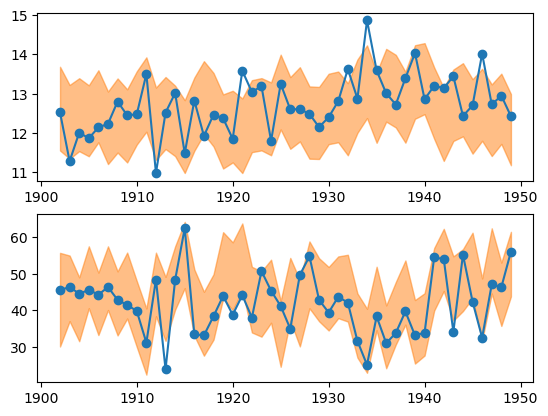

In [751]:
DCK.plot_validation()

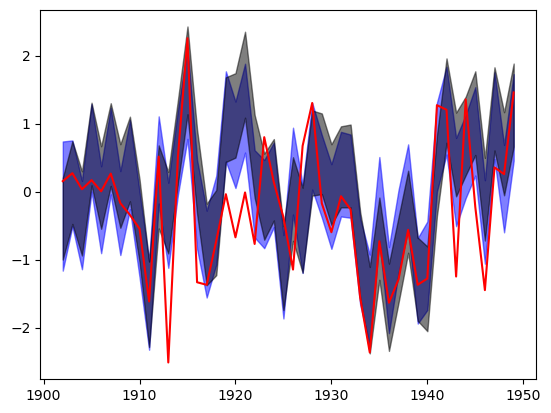

In [734]:
az.plot_hdi(DCK.taxes["val"],DCK.trace.posterior.Mval.sel(vari="P"),smooth=False,hdi_prob=.66,color="b")
az.plot_hdi(linear_models["DCK"].taxes["val"],linear_models["DCK"].trace.posterior.Mval.sel(vari="P"),smooth=False,color="k",hdi_prob=.66)
plt.plot(DCK.taxes["val"],DCK.val["M"][1],c="r")

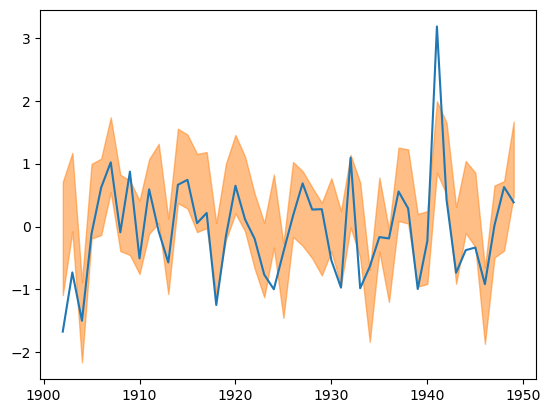

In [773]:
az.plot_hdi(SJC.taxes["val"],RMA.trace.posterior.Mval.sel(vari="P"),smooth=False,hdi_prob=.66)
plt.plot(SJC.taxes["val"],RMA.val["M"][1])

In [743]:
with linear_models["DCK"].model:
    pm.compute_log_likelihood(linear_models["DCK"].trace,var_names=["lik_Mobs"])

In [747]:
az.waic(DCK.trace)

/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/arviz/stats/stats.py:1648: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(


Computed from 4000 posterior samples and 55 observations log-likelihood matrix.

          Estimate       SE
elpd_waic  -147.91     7.46
p_waic        3.64        -

There has been a warning during the calculation. Please check the results.

In [748]:
az.waic(linear_models["DCK"].trace)

/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/arviz/stats/stats.py:1648: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(


Computed from 4000 posterior samples and 56 observations log-likelihood matrix.

          Estimate       SE
elpd_waic  -150.44     7.32
p_waic        3.62        -

There has been a warning during the calculation. Please check the results.

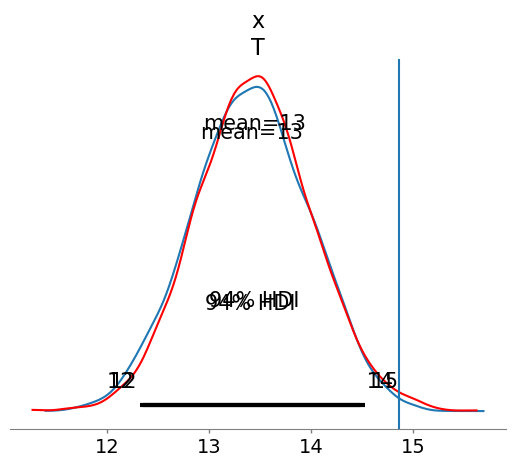

In [727]:
ax=plt.subplot(111)
az.plot_posterior(DCK.undo_z(DCK.trace.posterior.Mval.sel(vari="T",time_validate=1934)),ax=ax)
az.plot_posterior(DCK.undo_z(linear_models["DCK"].trace.posterior.Mval.sel(vari="T",time_validate=1934)),ax=ax,c="r")
ax.axvline(DCK.raw["M"].sel(year=1934)[0])
#ax.axvline(0,c="k")

array([<Axes: title={'center': 'L\nT'}>, <Axes: title={'center': 'L\nP'}>,
       <Axes: title={'center': 'rhoD'}>], dtype=object)

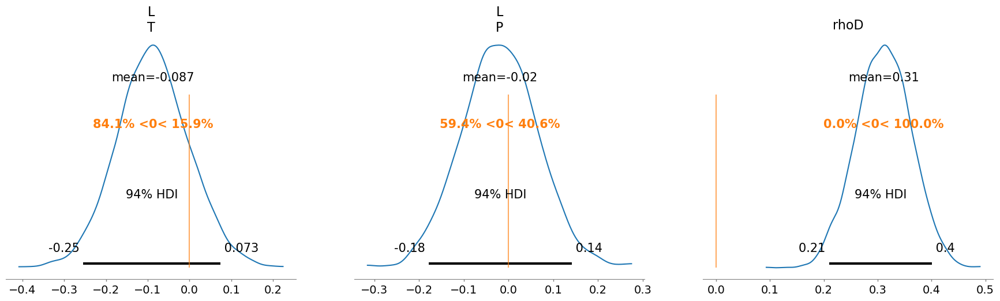

In [722]:
# How much should it matter?  Is there even a significant lag component?
az.plot_posterior(DCK.trace.posterior,var_names=["L","rhoD"],ref_val=0.)

<Axes: title={'center': 'cov'}>

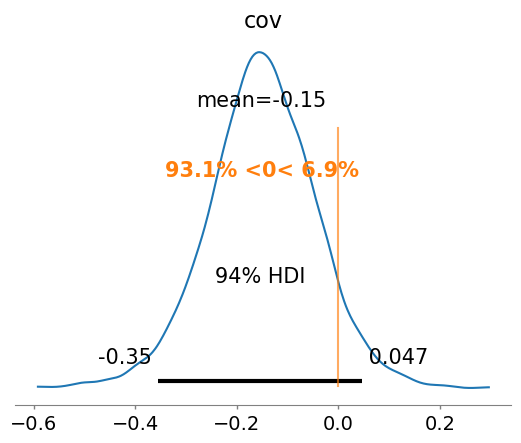

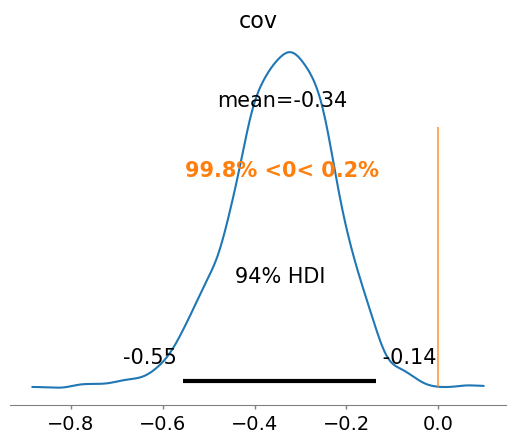

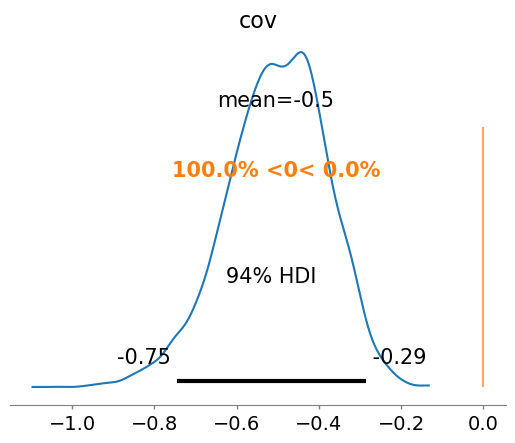

In [587]:
az.plot_posterior(SJC.trace.posterior.cov.sel(vari="T",cross_vari="P"),ref_val=0)
az.plot_posterior(RMA.trace.posterior.cov.sel(vari="T",cross_vari="P"),ref_val=0)
az.plot_posterior(DCK.trace.posterior.cov.sel(vari="T",cross_vari="P"),ref_val=0)#,var_names=["beta"],ref_val=0,hdi_prob=.9)
# az.plot_posterior(RMA.trace.posterior,var_names=["beta"],ref_val=0,hdi_prob=.9)
# az.plot_posterior(DCK.trace.posterior,var_names=["beta"],ref_val=0,hdi_prob=.9)

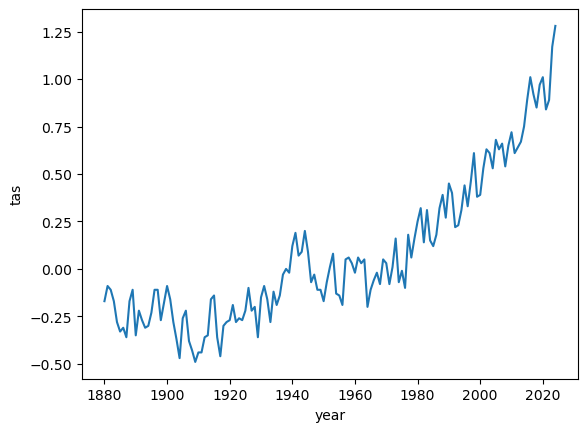

<Axes: >

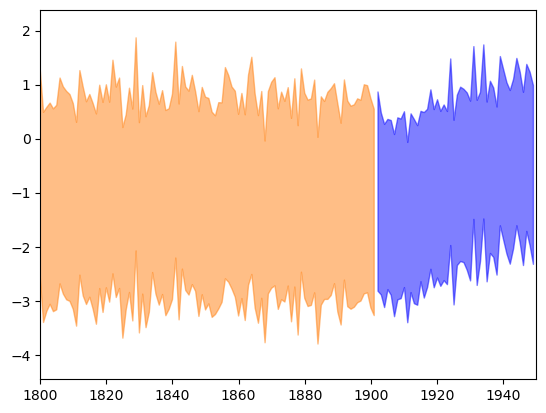

In [667]:
az.plot_hdi(SJC.taxes["recon"],SJC.trace.posterior.Mrecon.sel(vari="T"),smooth=False)
plt.xlim(1800,1950)
az.plot_hdi(SJC.taxes["val"],SJC.trace.posterior.Mval.sel(vari="T"),smooth=False,color="b")
#plt.axhline(self.Gmean)
##plt.plot(SJC.taxes["recon"],SJC.recon["D"])

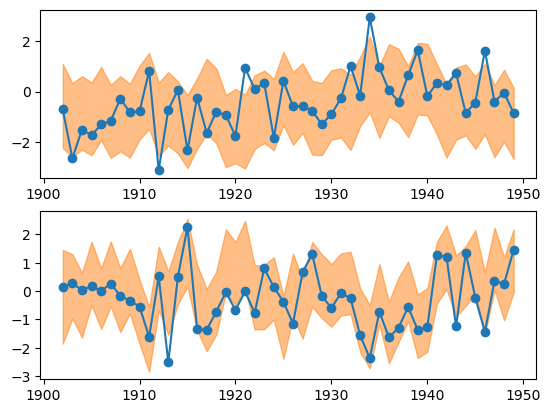

In [656]:
loc=DCK
loc.plot_validation(z=True)

In [653]:
loc=DCK
myyear=loc.taxes["val"][np.argmax(loc.val["D"])]
myyear=1924

/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/arviz/plots/pairplot.py:232: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  gridsize = int(dataset.dims["draw"] ** 0.35)


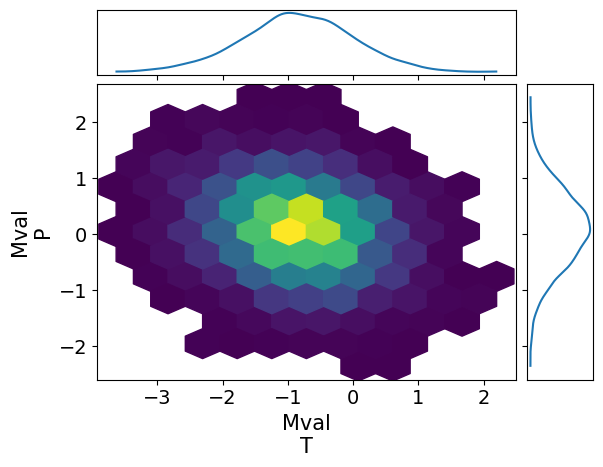

In [657]:
axes=az.plot_pair(loc.trace.posterior.Mval.sel(time_validate=myyear),kind="hexbin",marginals=True)
actual=loc.raw["M"].sel(year=myyear)
#axes[1,0].set_xlabel(r"$\beta_T$")
#axes[1,0].set_ylabel(r"$\beta_P$")
#axes[1,0].plot([actual[0]],[actual[1]],marker="o",color="r")
#plt.plot([actual[0]],[actual[1]],marker="o",color="r")

In [604]:
lat,lon=latlon("SJC")
cru.data["T"].sel(lat=lat,lon=lon).mean(dim="year").mean(dim="month")

<xarray.DataArray ()> Size: 4B
array(5.8786197, dtype=float32)
Coordinates:
    lon      float32 4B -119.2
    lat      float32 4B 38.25

In [594]:
np.corrcoef(RMA.val["M"][0],RMA.val["M"][1])

array([[ 1.       , -0.2320899],
       [-0.2320899,  1.       ]])

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [beta, rhoD, sigmaD, L, gamma, noise_chol, Mval, Grecon, Mrecon]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 97 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details


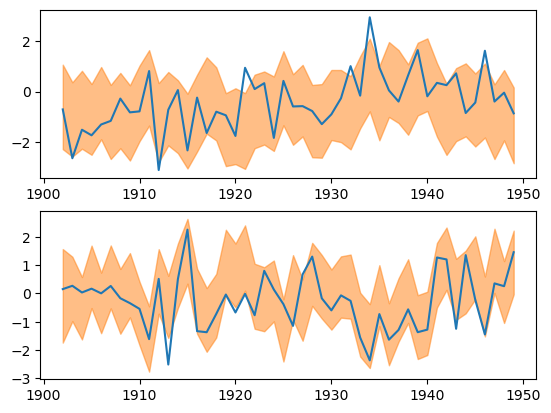

In [593]:
plot_validation(self,z=True)
ax=plt.gca()
#ax.plot(self.taxes["val"],self.val["D"],"r")

<Axes: >

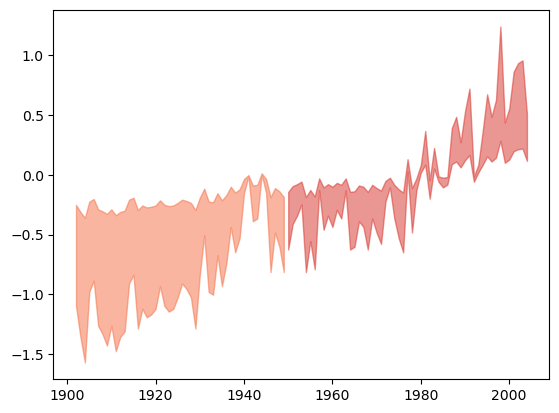

In [559]:
az.plot_hdi(self.taxes["val"],self.trace.posterior.Fval.sel(vari="T"),smooth=False,color=cm.RdYlBu(.2))
az.plot_hdi(self.taxes["train"][:-1],self.trace.posterior.Ftrain.sel(vari="T"),smooth=False,color=cm.RdYlBu(.1))
#az.plot_hdi(self.taxes["recon"],self.undo_z(self.trace.posterior.Frecon).sel(vari="T"),smooth=False,color=cm.RdYlBu(.9))
#plt.xlim(1800,2006)
#plt.plot(self.taxes["val"],self.raw["M"].sel(vari="T",year=slice(*self.validation_period)).values)
#plt.plot(self.taxes["train"],self.raw["M"].sel(vari="T",year=slice(*self.training_period)).values)


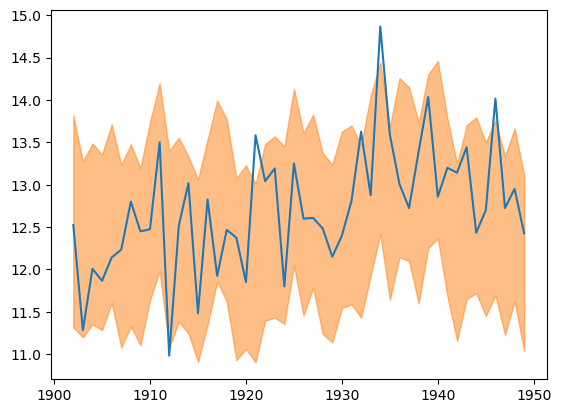

In [505]:
mu=self.means["M"]
sigma=self.stds["M"]
putback=sigma*self.trace.posterior.Munobs+mu
az.plot_hdi(self.taxes["val"],putback.sel(vari="T"),smooth=False)
plt.plot(self.taxes["val"],self.raw["M"].sel(vari="T",year=slice(*self.validation_period)))

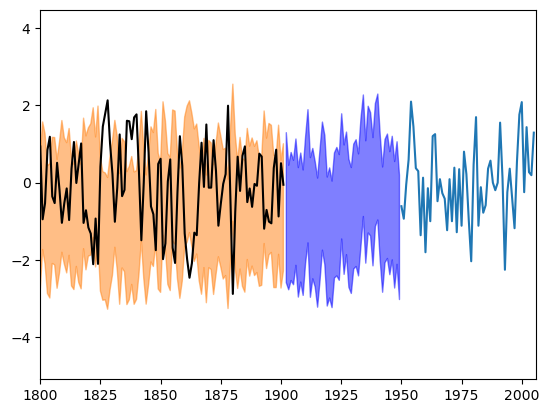

In [500]:
az.plot_hdi(self.taxes["recon"],self.trace.posterior.Mrecon.sel(vari="T"),smooth=False)
az.plot_hdi(self.taxes["val"],self.trace.posterior.Munobs.sel(vari="T"),smooth=False,color="b")
plt.plot(self.taxes["train"],self.train["M"][0])
plt.xlim(1800,2006)
plt.plot(self.taxes["recon"],self.recon["D"],"k")

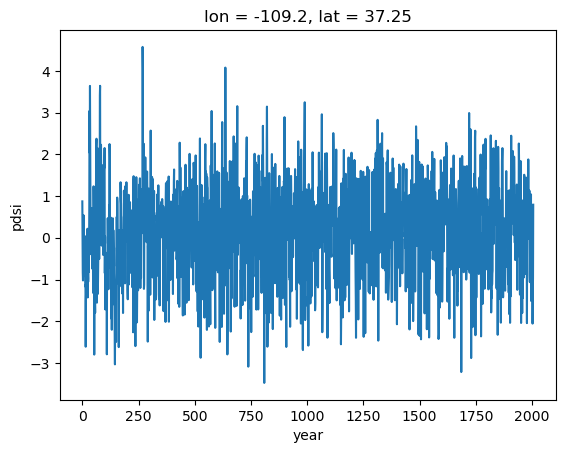

In [365]:
self.z["D"].plot()

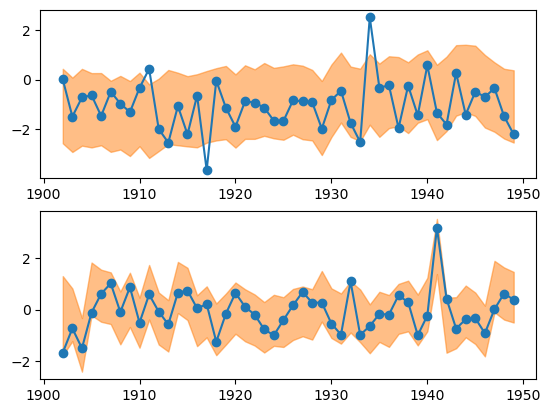

In [358]:
self.plot_validation()

array([[<Axes: title={'center': 'L\nT'}>,
        <Axes: title={'center': 'L\nP'}>,
        <Axes: title={'center': 'beta\nT'}>],
       [<Axes: title={'center': 'beta\nP'}>,
        <Axes: title={'center': 'rhoD'}>,
        <Axes: title={'center': 'gamma\nT'}>],
       [<Axes: title={'center': 'gamma\nP'}>,
        <Axes: title={'center': 'cov\nT, T'}>,
        <Axes: title={'center': 'cov\nT, P'}>],
       [<Axes: title={'center': 'cov\nP, T'}>,
        <Axes: title={'center': 'cov\nP, P'}>, <Axes: >]], dtype=object)

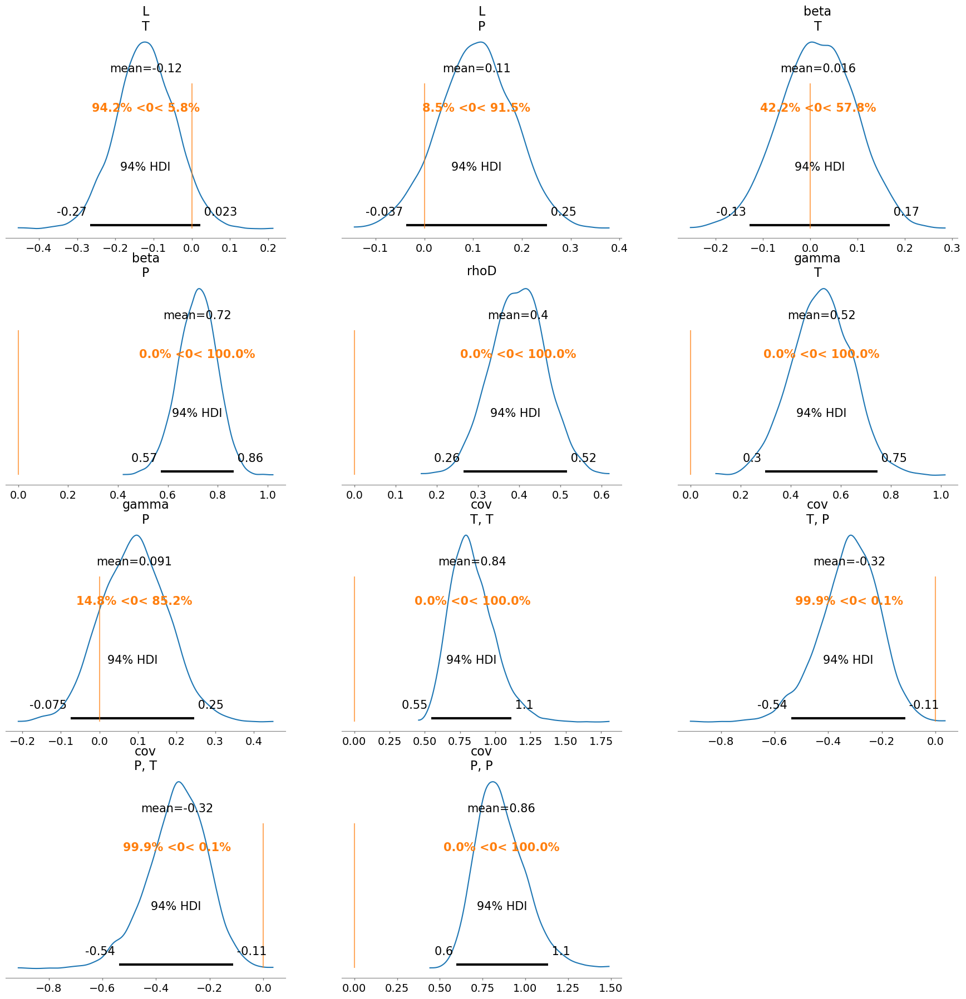

In [359]:
az.plot_posterior(self.trace,var_names=["L","beta","rhoD","gamma","cov"],ref_val=0) 

In [262]:
nlags=1
coords={"vari":["T","P"],\
        "time_train":self.taxes["train"][:-nlags],\
       "cross_vari":["T","P"],\
       "lags":[1],\
       "time_validate":self.taxes["val"],
       "time":np.concatenate([self.taxes["val"],self.taxes["train"]])[:-nlags]}

with pm.Model(coords=coords) as VAR_Model:
    #Observed data
    Mobs=pm.Data("Mobs",self.train["M"].T[:-nlags],mutable=False)
    #Dobs=pm.Data("Dobs",np.concatenate([self.val["D"],self.train["D"]]),mutable=False)
    Dobs=np.concatenate([self.val["D"],self.train["D"]])
    
    #AR(1) model for D
    beta=pm.Normal("beta",0,1,dims=["vari"])
    rhoD=pm.Normal("rhoD",0,1)
    sigmaD=pm.HalfNormal("sigmaD",1)
    L=pm.Normal("L",0,1,dims=("vari"))

    # prior on global temperature regression slope
    gamma=pm.Normal("gamma",0,1,dims=["vari"])
    
    # assumed forced response regresses on global mean temperature
    Ftrain=pm.Deterministic("Ftrain",gamma*np.stack([self.train["G"][:-nlags],self.train["G"][:-nlags]]).T) 
        
    # covariance between T and P at time t (Cholesky decomposition)
    noise_chol, _, _ = pm.LKJCholeskyCov(
        "noise_chol",
        eta=1,
        n=len(coords["vari"]),
        sd_dist=pm.HalfNormal.dist(sigma=1),
    )
    #For display: reconstitute Cholesky -> cov
    cov = pm.Deterministic('cov', noise_chol.dot(noise_chol.T),dims=("vari","cross_vari")) 
    
    #Likelihood for Mobs.  Press the inference button to get posteriors for gamma and noise
    lik_Mobs = pm.MvNormal("lik_Mobs",mu=Ftrain,chol=noise_chol,observed=observed_M_data,dims=("time_train","vari"))

    #Learn parameters from observations
    #soil moisture "memory"
    Dar=rhoD*self.train["D"][:-2]

#    #Dependence on that year's meteorology
    Dmean=pt.dot(beta.T,self.train["M"][:,1:-1])
    # Correlation with following year meteorology
    Dforward=pt.dot(L.T,self.train["M"][:,2:])
    #Likelihood for D given M, gamma, L, beta, T
    mu_train=Dmean+Dforward+Dar
    Dtrain_lik=pm.Normal("Dtrain_lik",mu=Dmean+Dforward+Dar,sigma=sigmaD,observed=self.train["D"][1:-1])

    ###
    #NOW, learn Munobs
    ###
   
    # Forced response: observed GMT
    Fval=pm.Deterministic("Fval",gamma*np.stack([self.val["G"],self.val["G"]]).T) 
     
    #Prior on the unobserved meteorology
    Munobs=pm.MvNormal("Munobs",mu=Fval,chol=noise_chol,dims=("time_validate","vari"))
    Munobsconc=pm.math.concatenate([Munobs,self.train["M"].T[:1]])
    Dobsconc=np.concatenate([self.val["D"],self.train["D"][:1]])

    Dar_val=rhoD*Dobsconc[:-2]
    Dforward_val=pt.dot(L.T,Munobsconc[2:].T)
    Dmean_val=pt.dot(beta.T,Munobsconc[1:-1].T)
    print("Dar_val",Dar_val.shape.eval())
    print("Dforward_val",Dforward_val.shape.eval())
    print("Dmean_val",Dmean_val.shape.eval())
    mu_val=Dmean_val+Dforward_val+Dar_val

# #    #Dependence on that year's meteorology
#     Dmean=pt.dot(beta.T,Mobsconc.T[:,1:-1])
#     # Correlation with following year meteorology
#     Dforward=pt.dot(L.T,self.train["M"][:,2:])
#     #Likelihood for D given M, gamma, L, beta, T
    Dval_lik=pm.Normal("Dval_lik",mu=mu_val,sigma=sigmaD,observed=Dobsconc[1:-1])

    
    testsamp=pm.sample()
    # # #test data

Dar_val [47]
Dforward_val [47]
Dmean_val [47]


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [beta, rhoD, sigmaD, L, gamma, noise_chol, Munobs]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 24 seconds.


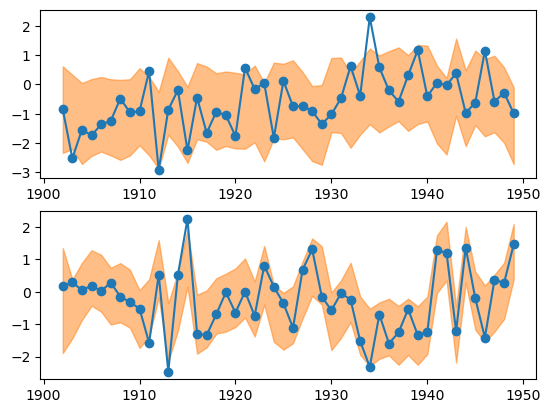

In [280]:
plt.subplot(211)
tax=self.taxes["val"]
az.plot_hdi(tax,testsamp.posterior.Munobs.sel(vari="T"),smooth=False,hdi_prob=.90)
plt.plot(tax,self.val["M"][0],"-o")
plt.subplot(212)
tax=self.taxes["val"]
az.plot_hdi(tax,testsamp.posterior.Munobs.sel(vari="P"),smooth=False,hdi_prob=.90)
plt.plot(tax,self.val["M"][1],"-o")

/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/arviz/plots/pairplot.py:232: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  gridsize = int(dataset.dims["draw"] ** 0.35)


<Axes: xlabel='Munobs\nT', ylabel='Munobs\nP'>

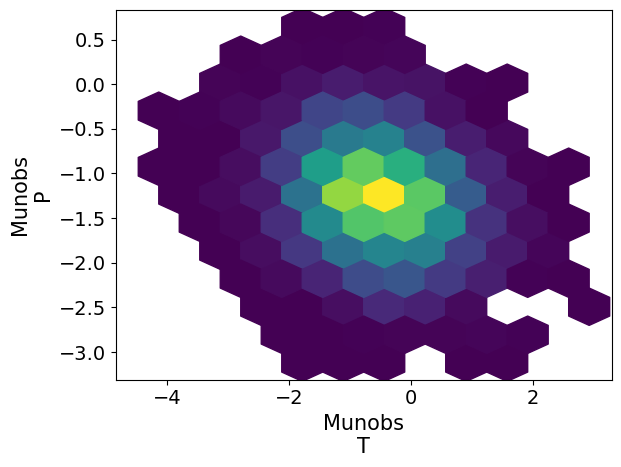

In [348]:
az.plot_pair(self.trace.posterior.Munobs.sel(time_validate=1934),kind="hexbin")

array([[<Axes: title={'center': 'L\nT'}>,
        <Axes: title={'center': 'L\nP'}>,
        <Axes: title={'center': 'beta\nT'}>],
       [<Axes: title={'center': 'beta\nP'}>,
        <Axes: title={'center': 'rhoD'}>,
        <Axes: title={'center': 'gamma\nT'}>],
       [<Axes: title={'center': 'gamma\nP'}>,
        <Axes: title={'center': 'cov\nT, T'}>,
        <Axes: title={'center': 'cov\nT, P'}>],
       [<Axes: title={'center': 'cov\nP, T'}>,
        <Axes: title={'center': 'cov\nP, P'}>, <Axes: >]], dtype=object)

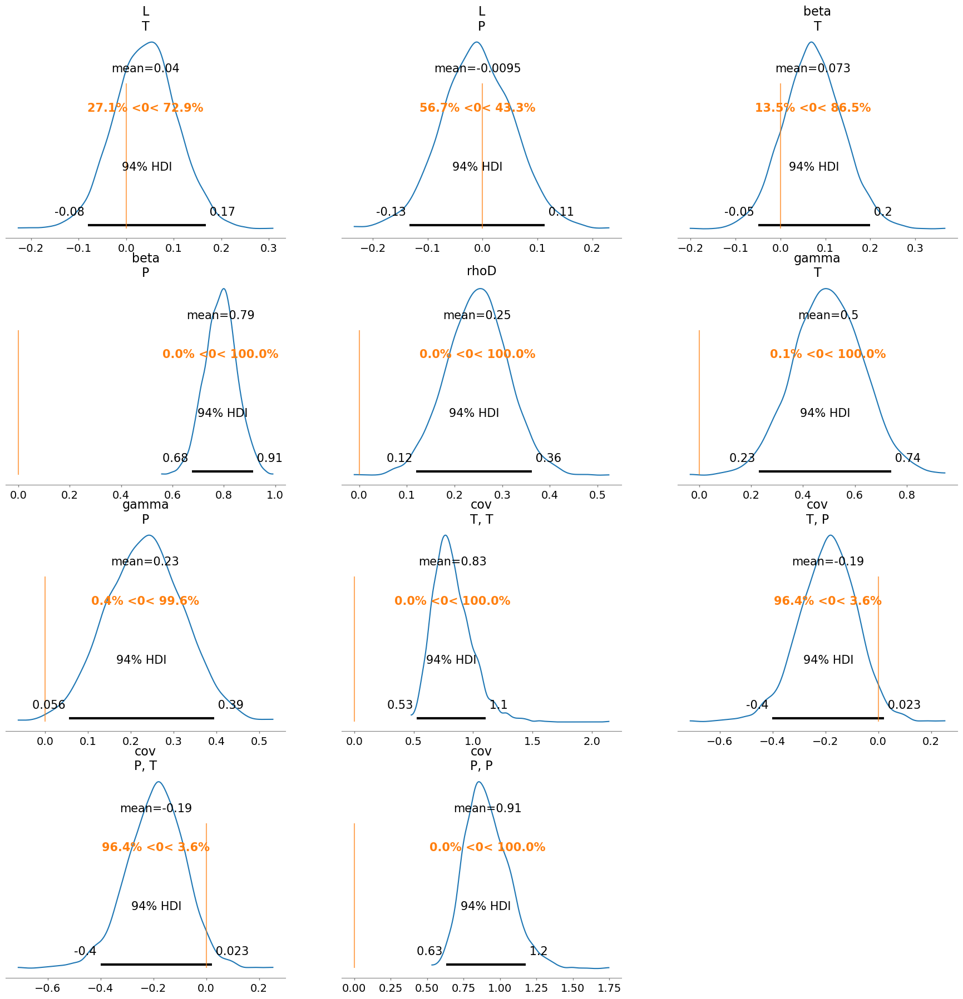

In [351]:
az.plot_posterior(self.trace,var_names=["L","beta","rhoD","gamma","cov"],ref_val=0)

In [246]:
np.corrcoef(self.train["M"][0][1:],self.train["M"][0][:-1])

array([[1.        , 0.53955799],
       [0.53955799, 1.        ]])

In [18]:
# try to build a model without loops.  CURRENT


nlags=1
coords={"vari":["T","P"],\
        "time_train":self.taxes["train"],\
       "cross_vari":["T","P"],\
       "lags":[1],\
       "time_validate":self.taxes["val"],
       "time":np.concatenate([self.taxes["val"],self.taxes["train"]])[:-nlags]}

with pm.Model(coords=coords) as VAR_Model:
     # prior on global T regression slope
    gamma=pm.Normal("gamma",0,1,dims=["vari"])
    
    # assumed forced response regresses on T
    Ftrain=pm.Deterministic("Ftrain",gamma*np.stack([self.train["G"][:-nlags],self.train["G"][:-nlags]]).T) 
    #print("F shape is ",F.shape.eval())
    
    # covariance between T and P at time t
    noise_chol, _, _ = pm.LKJCholeskyCov(
        "noise_chol",
        eta=1,
        n=len(coords["vari"]),
        sd_dist=pm.HalfNormal.dist(sigma=1),
    )
    cov = pm.Deterministic('cov', noise_chol.dot(noise_chol.T),dims=("vari","cross_vari")) 
    #Lag coefficients
    lag_coefs=pm.Normal("lag_coefs",0,1,dims=("vari","cross_vari","lags")) 
    #training data
    data_train=pm.Data("Mtrain",self.train["M"],mutable=True)
    
    
    
    # vector autoregressive step
    VAR_step=calc_var_step(lag_coefs,self.train["M"]) 
    #Obs ~ MN(forced response + VAR, Σ)
    Mobs = pm.MvNormal("Mobs",mu=Ftrain+VAR_step,chol=noise_chol,observed=self.train["M"].T[:-nlags])

    # Loop using scan
    unobs_ar_mean, _ = pt.scan(step, non_sequences=[cov,lag_coefs], sequences=dict(input=data, taps=[1]))

    #AR(1) model for D
    beta=pm.Normal("beta",0,1,dims=["vari"])
    rhoD=pm.Normal("rhoD",0,1)
    sigmaD=pm.HalfNormal("sigmaD",1)
    # #test data
    # Fval=gamma[0]*self.val["G"][yr]+gamma[1]*self.val["G"][yr]
    
    # data_uncorr=pm.math.concatenate([pm.MvNormal("data_uncorr",mu=0,chol=noise_chol,shape=self.val["M"].T.shape),\
    #                             self.train["M"].T[:nlags]],axis=0)

    # Munobs=pm.MvNormal("Munobs",mu=Fval+calc_var_step(lag_coefs,data_uncorr.T),chol=noise_chol,dims=("time_validate","vari"))
    # M=pm.Deterministic("M",pm.math.concatenate([Munobs,Mobs],axis=0),dims=("time","vari"))
    
    
    # # #Assume an AR1 model for D


    # # #Whole record of D
    # D_data=np.concatenate([self.val["D"],self.train["D"]])#[:-nlags]
    # Dmean=beta[0]*M[:,0]+beta[1]*M[:,1]
    # Dar=rhoD*D_data[nlags:]
    # Dobs = pm.Normal("Dobs",mu=Dmean+Dar,sigma=sigmaD,observed=D_data[:-nlags])
    # vectrace=pm.sample()
    #print(Dar.shape.eval())
    # Dmean=pm.math.sum(beta*M.T,axis=-1)
    # print("Dmean shape",Dmean.shape.eval())
    # # #next year
    # Dar=rhoD*D_data[nlags:]

   # Dobs=pm.Normal("Dobs",mu=Dmean+Dar,sigma=sigmaD,observed=D_data)

    

    # # Loop over all times in validation step
    # Munobs={}
    # Dunobs={}
    # subsequent_data=data_train[:,:nlags]
    # for yr in np.arange(int(self.val["D"].shape[0]))[::-1][:20]:
    #     #calculate the lag step for the first unknown M given the first step of the training data
        
    #     uars=[]
    #     for k in range(len(coords["vari"])):
    #         uar_cross=[]
    #         for j in range(len(coords["cross_vari"])):
    #             uar_lags=[]
    #             for i in range(nlags):
    #                 uar_lags.append(lag_coefs[k,j,i]* subsequent_data[j,(i-1)+1])
    #             usum_lags=pm.math.sum(uar_lags,axis=0)
                
    #             uar_cross.append(usum_lags)
    #         usum_cross=pm.math.sum(uar_cross,axis=0)
    #         uars.append(usum_cross)
    #     unobs_VARstep= pm.math.stack(uars,axis=-1)
    #     #print("unobs_VARstep shape",unobs_VARstep.shape.eval())
    #     Funobs=gamma[0]*self.val["G"][yr]+gamma[1]*self.val["G"][yr]
    #     Munobs[yr]=pm.MvNormal("Munobs_"+str(yr),mu=Funobs+unobs_VARstep,chol=noise_chol)
    #     if yr==np.arange(int(self.val["D"].shape[0]))[::-1][0]:
    #         Dar_unobs=rhoD*self.train["D"][0]
    #     else:
    #         Dar_unobs=rhoD*self.val["D"][yr+1]
    #     Dmean_unobs=pm.math.sum(beta*Munobs[yr].T,axis=-1)
    #     Dunobs[yr]=pm.Normal("Dunobs_"+str(yr),mu=Dar_unobs+Dmean_unobs,sigma=sigmaD,observed=self.val["D"][yr])
       
    #    # print("subsequent_data shape",subsequent_data.shape.eval())
    #     #print("Munobs.shape",Munobs.shape.eval())
    #     subsequent_data=pm.math.concatenate([Munobs[yr][:,pt.newaxis],subsequent_data],axis=1)
    # reconstructed=pm.Deterministic("reconstruction",subsequent_data)    
    # looptrace=pm.sample()


AttributeError: module 'pytensor.tensor' has no attribute 'scan'

# PDSI Model
## Priors
\begin{eqnarray}
\gamma \sim N(0,1)\\
F = \gamma^T G \\
\ell \sim N(0,1) \\
\Sigma \sim LKJ(1)  \\
\sigma \sim HalfNormal(1)
\end{eqnarray}
## Model
\begin{eqnarray}
M_{obs}(t) \sim MN(F(t)+VAR(t),\Sigma) \\
VAR(t) = \sum_{i=1}^{nlag} \ell_i M(t+1)\\
D(t) \sim N(\rho D(t+1) + \beta^T M ,\sigma)
\end{eqnarray}
Bayes step:
\begin{equation}
P(M|D) = \frac{P(D|M) P(M)}{P(D)}
\end{equation}

In [113]:
#loop without updating posteriors
nlags=1
coords={"vari":["T","P"],\
        "time_train":self.taxes["train"],\
       "cross_vari":["T","P"],\
       "lags":[1],\
       "time_validate":self.taxes["val"]}

with pm.Model(coords=coords) as ForwardModel:
     # prior on global T regression slope
    gamma=pm.Normal("gamma",0,1,dims=["vari"])
    
    # assumed forced response regresses on T
    F=pm.Deterministic("F",gamma*np.stack([self.train["G"][:-nlags],self.train["G"][:-nlags]]).T) 
    #print("F shape is ",F.shape.eval())
    
    # covariance between T and P at time t
    noise_chol, _, _ = pm.LKJCholeskyCov(
        "noise_chol",
        eta=1,
        n=len(coords["vari"]),
        sd_dist=pm.HalfNormal.dist(sigma=1),
    )
    cov = pm.Deterministic('cov', noise_chol.dot(noise_chol.T),dims=("vari","cross_vari")) 
    #Lag coefficients
    lag_coefs=pm.Normal("lag_coefs",0,1,dims=("vari","cross_vari","lags")) 
    #training data
    data_train=pm.Data("Mtrain",self.train["M"],mutable=True)
    
    # vector autoregressive step
    VAR_step=calc_var_step(lag_coefs,self.train["M"]) 
    #Obs ~ MN(forced response + VAR, Σ)
    Mobs = pm.MvNormal("Mobs",mu=F+VAR_step,chol=noise_chol,observed=self.train["M"].T[:-nlags])

    #Assume an AR1 model for D
    beta=pm.Normal("beta",0,1,dims=["vari"])
    rhoD=pm.Normal("rhoD",0,1)
    sigmaD=pm.HalfNormal("sigmaD",1)
    
    Dmean=pm.math.sum(beta*self.train["M"].T[:-1],axis=-1)
    #next year
    Dar=rhoD*self.train["D"][nlags:]

    
    Dobs=pm.Normal("Dobs",mu=Dmean+Dar,sigma=sigmaD,observed=self.train["D"][:-nlags])
    forward_idata=pm.sample()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [gamma, noise_chol, lag_coefs, beta, rhoD, sigmaD]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 8 seconds.


In [182]:
?stats.invgamma

Signature:       stats.invgamma(*args, **kwds)
Type:            invgamma_gen
String form:     <scipy.stats._continuous_distns.invgamma_gen object at 0x16a49aed0>
File:            ~/anaconda3/envs/pymc_env/lib/python3.11/site-packages/scipy/stats/_continuous_distns.py
Docstring:      
An inverted gamma continuous random variable.

As an instance of the `rv_continuous` class, `invgamma` object inherits from it
a collection of generic methods (see below for the full list),
and completes them with details specific for this particular distribution.

Methods
-------
rvs(a, loc=0, scale=1, size=1, random_state=None)
    Random variates.
pdf(x, a, loc=0, scale=1)
    Probability density function.
logpdf(x, a, loc=0, scale=1)
    Log of the probability density function.
cdf(x, a, loc=0, scale=1)
    Cumulative distribution function.
logcdf(x, a, loc=0, scale=1)
    Log of the cumulative distribution function.
sf(x, a, loc=0, scale=1)
    Survival function  (also defined as ``1 - cdf``, but `sf`

In [211]:
import scipy.stats as stats  
flatten_posterior=lambda variable:getattr(forward_idata.posterior,variable).stack(samples=("chain","draw"))
igshape,igloc,igscale=stats.invgamma.fit(flatten_posterior("sigmaD"))
#check- is it sensible?
x=np.linspace(0,1,100)
#plt.plot(x,stats.invgamma(params[0],loc=params[1],scale=params[2]).pdf(x))

?srng.invgamma


Signature: srng.invgamma(shape, scale, size=None, **kwargs)
Docstring:
An inverse-gamma continuous random variable.

The probability density function for `invgamma` in terms of its shape
parameter :math:`\alpha` and scale parameter :math:`\beta` is:

.. math::

    f(x; \alpha, \beta) = \frac{\beta^\alpha}{\Gamma(\alpha)} x^{-(\alpha+1)} \exp\left(-\frac{\beta}{x}\right)

for :math:`x > 0`, where :math:`\alpha > 0` and :math:`\beta > 0`. :math:`Gamma` is the gamma function :

.. math::

    \Gamma(x) = \int_0^{\infty} t^{x-1} e^{-t} \mathrm{d}t
File:      ~/anaconda3/envs/pymc_env/lib/python3.11/site-packages/pytensor/tensor/random/basic.py
Type:      function

In [151]:
srng = pt.random.utils.RandomStream(seed=123)
posterior_mean=lambda variable:getattr(forward_idata.posterior,variable).stack(samples=("chain","draw")).mean(dim="samples").values
posterior_std=lambda variable:getattr(forward_idata.posterior,variable).stack(samples=("chain","draw")).std(dim="samples").values


In [224]:
forward_idata.posterior.lag_coefs.mean(dim=("chain","draw"))

<xarray.DataArray 'lag_coefs' (vari: 2, cross_vari: 2, lags: 1)> Size: 32B
array([[[ 0.09627963],
        [ 0.03896997]],

       [[-0.08625299],
        [ 0.02129403]]])
Coordinates:
  * vari        (vari) <U1 8B 'T' 'P'
  * cross_vari  (cross_vari) <U1 8B 'T' 'P'
  * lags        (lags) int64 8B 1

<Axes: >

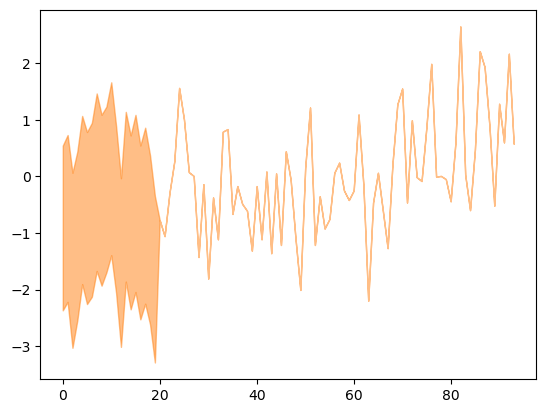

In [259]:
az.plot_hdi(np.arange(94),traceback.posterior.reconstruction.sel(reconstruction_dim_0=0),smooth=False)
#plt.plot(np.arange(94),self.z["M"].sel(vari="P").values[-94:])

<Axes: title={'center': 'sigmaD'}>

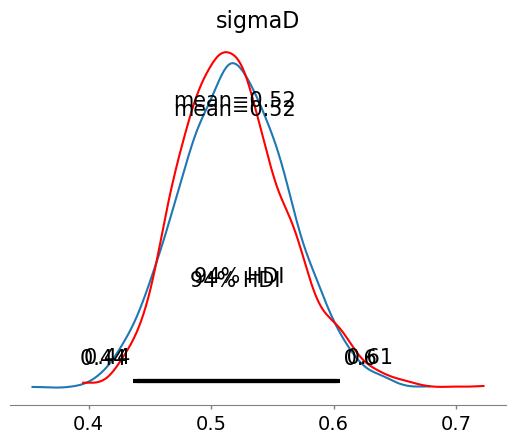

In [216]:
ax=plt.subplot(111)
az.plot_posterior(traceback.posterior.sigmaD,ax=axD)
az.plot_posterior(forward_idata.posterior.sigmaD,ax=ax,c="r")

In [283]:
D=np.concatenate([self.val["D"],self.train["D"]])[:-nlags]
D.shape

(121,)

In [321]:
# try to build a model without loops.  CURRENT


nlags=1
coords={"vari":["T","P"],\
        "time_train":self.taxes["train"],\
       "cross_vari":["T","P"],\
       "lags":[1],\
       "time_validate":self.taxes["val"],
       "time":np.concatenate([self.taxes["val"],self.taxes["train"]])[:-nlags]}

with pm.Model(coords=coords) as VAR_Model:
     # prior on global T regression slope
    gamma=pm.Normal("gamma",0,1,dims=["vari"])
    
    # assumed forced response regresses on T
    F=pm.Deterministic("F",gamma*np.stack([self.train["G"][:-nlags],self.train["G"][:-nlags]]).T) 
    #print("F shape is ",F.shape.eval())
    
    # covariance between T and P at time t
    noise_chol, _, _ = pm.LKJCholeskyCov(
        "noise_chol",
        eta=1,
        n=len(coords["vari"]),
        sd_dist=pm.HalfNormal.dist(sigma=1),
    )
    cov = pm.Deterministic('cov', noise_chol.dot(noise_chol.T),dims=("vari","cross_vari")) 
    #Lag coefficients
    lag_coefs=pm.Normal("lag_coefs",0,1,dims=("vari","cross_vari","lags")) 
    #training data
    data_train=pm.Data("Mtrain",self.train["M"],mutable=True)
    
    
    
    # vector autoregressive step
    VAR_step=calc_var_step(lag_coefs,self.train["M"]) 
    #Obs ~ MN(forced response + VAR, Σ)
    Mobs = pm.MvNormal("Mobs",mu=F+VAR_step,chol=noise_chol,observed=self.train["M"].T[:-nlags])
    
    #test data
    Fval=gamma[0]*self.val["G"][yr]+gamma[1]*self.val["G"][yr]
    
    data_uncorr=pm.math.concatenate([pm.MvNormal("data_uncorr",mu=0,chol=noise_chol,shape=self.val["M"].T.shape),\
                                self.train["M"].T[:nlags]],axis=0)

    Munobs=pm.MvNormal("Munobs",mu=Fval+calc_var_step(lag_coefs,data_uncorr.T),chol=noise_chol,dims=("time_validate","vari"))
    M=pm.Deterministic("M",pm.math.concatenate([Munobs,Mobs],axis=0),dims=("time","vari"))
    
    
    # #Assume an AR1 model for D
    beta=pm.Normal("beta",0,1,dims=["vari"])
    rhoD=pm.Normal("rhoD",0,1)
    sigmaD=pm.HalfNormal("sigmaD",1)

    # #Whole record of D
    D_data=np.concatenate([self.val["D"],self.train["D"]])#[:-nlags]
    Dmean=beta[0]*M[:,0]+beta[1]*M[:,1]
    Dar=rhoD*D_data[nlags:]
    Dobs = pm.Normal("Dobs",mu=Dmean+Dar,sigma=sigmaD,observed=D_data[:-nlags])
    vectrace=pm.sample()
    #print(Dar.shape.eval())
    # Dmean=pm.math.sum(beta*M.T,axis=-1)
    # print("Dmean shape",Dmean.shape.eval())
    # # #next year
    # Dar=rhoD*D_data[nlags:]

   # Dobs=pm.Normal("Dobs",mu=Dmean+Dar,sigma=sigmaD,observed=D_data)

    

    # # Loop over all times in validation step
    # Munobs={}
    # Dunobs={}
    # subsequent_data=data_train[:,:nlags]
    # for yr in np.arange(int(self.val["D"].shape[0]))[::-1][:20]:
    #     #calculate the lag step for the first unknown M given the first step of the training data
        
    #     uars=[]
    #     for k in range(len(coords["vari"])):
    #         uar_cross=[]
    #         for j in range(len(coords["cross_vari"])):
    #             uar_lags=[]
    #             for i in range(nlags):
    #                 uar_lags.append(lag_coefs[k,j,i]* subsequent_data[j,(i-1)+1])
    #             usum_lags=pm.math.sum(uar_lags,axis=0)
                
    #             uar_cross.append(usum_lags)
    #         usum_cross=pm.math.sum(uar_cross,axis=0)
    #         uars.append(usum_cross)
    #     unobs_VARstep= pm.math.stack(uars,axis=-1)
    #     #print("unobs_VARstep shape",unobs_VARstep.shape.eval())
    #     Funobs=gamma[0]*self.val["G"][yr]+gamma[1]*self.val["G"][yr]
    #     Munobs[yr]=pm.MvNormal("Munobs_"+str(yr),mu=Funobs+unobs_VARstep,chol=noise_chol)
    #     if yr==np.arange(int(self.val["D"].shape[0]))[::-1][0]:
    #         Dar_unobs=rhoD*self.train["D"][0]
    #     else:
    #         Dar_unobs=rhoD*self.val["D"][yr+1]
    #     Dmean_unobs=pm.math.sum(beta*Munobs[yr].T,axis=-1)
    #     Dunobs[yr]=pm.Normal("Dunobs_"+str(yr),mu=Dar_unobs+Dmean_unobs,sigma=sigmaD,observed=self.val["D"][yr])
       
    #    # print("subsequent_data shape",subsequent_data.shape.eval())
    #     #print("Munobs.shape",Munobs.shape.eval())
    #     subsequent_data=pm.math.concatenate([Munobs[yr][:,pt.newaxis],subsequent_data],axis=1)
    # reconstructed=pm.Deterministic("reconstruction",subsequent_data)    
    # looptrace=pm.sample()


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [gamma, noise_chol, lag_coefs, data_uncorr, Munobs, beta, rhoD, sigmaD]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 44 seconds.


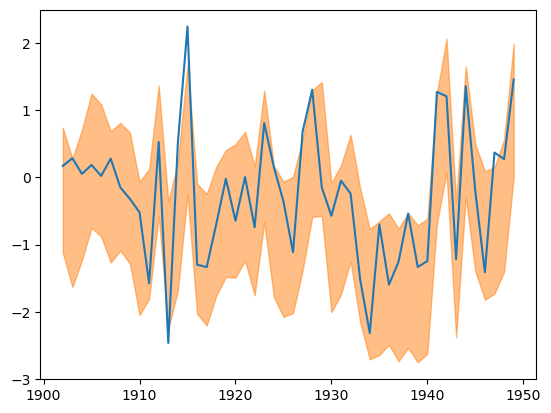

In [356]:
az.plot_hdi(self.taxes["val"],vectrace.posterior.M.sel(time=slice(*self.validation_period)).sel(vari="P"),smooth=False,hdi_prob=.9)
plt.plot(self.taxes["val"],self.val["M"][1])

In [364]:
pred=vectrace.posterior.M.sel(time=slice(*self.validation_period)).sel(vari="P").mean(dim=("chain","draw"))
print(pred.shape)
obs=self.val["M"][1]
print(obs.shape)
np.corrcoef(pred[1:],obs[:-1])

(48,)
(48,)


array([[1.        , 0.30479376],
       [0.30479376, 1.        ]])

/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/arviz/plots/pairplot.py:232: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  gridsize = int(dataset.dims["draw"] ** 0.35)


<Axes: xlabel='M\nT', ylabel='M\nP'>

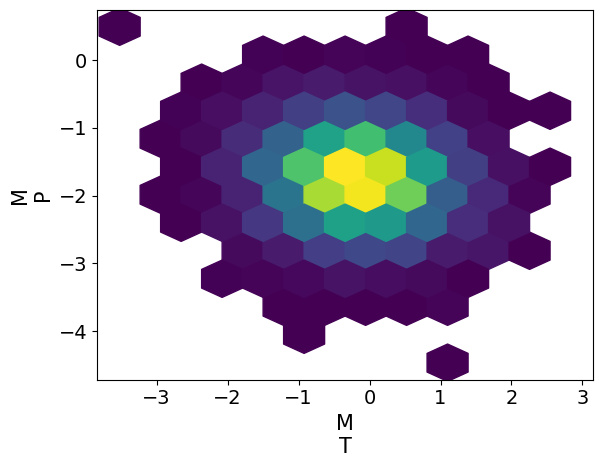

In [365]:
az.plot_pair(vectrace.posterior.M.sel(time=1934),kind="hexbin")

/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/arviz/plots/pairplot.py:232: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  gridsize = int(dataset.dims["draw"] ** 0.35)


<xarray.DataArray 'Munobs_47' ()> Size: 8B
array(-0.10625223)

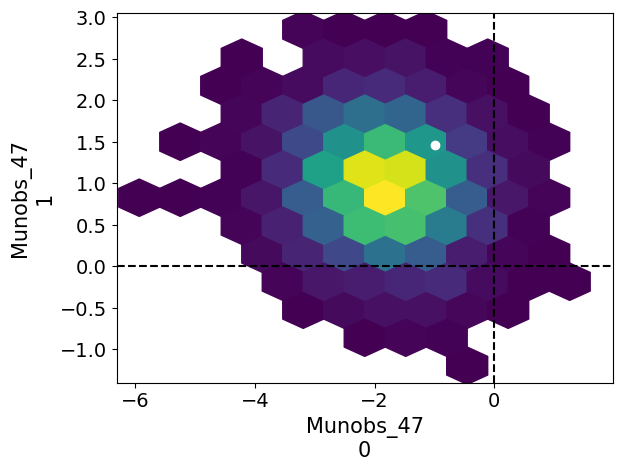

In [352]:
yr=47
az.plot_pair(getattr(looptrace.posterior,"Munobs_"+str(yr)),kind="hexbin")
plt.axvline(0,c="k",ls="--")
plt.axhline(0,c="k",ls="--")
obs=self.val["M"][:,yr]
plt.plot(obs[0],obs[1],"wo")
dat=getattr(looptrace.posterior,"Munobs_"+str(yr))
xr.corr(dat.isel(Munobs_47_dim_0=0),dat.isel(Munobs_47_dim_0=1))

<Axes: title={'center': 'sigmaD'}>

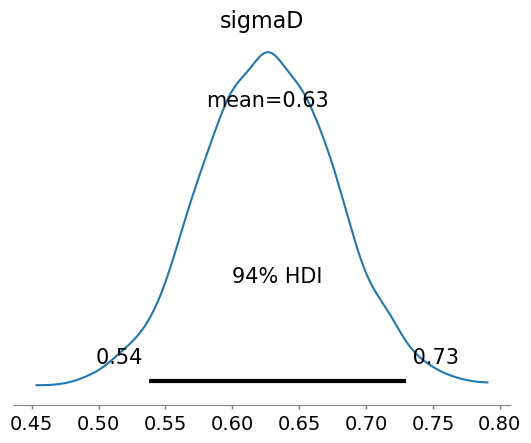

In [311]:
az.plot_posterior(vectrace,var_names=["sigmaD"])

<Axes: >

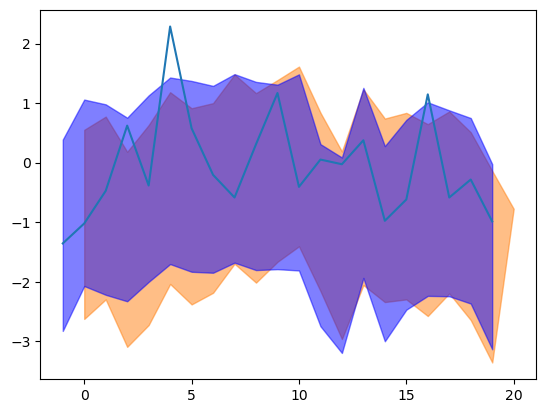

In [344]:
az.plot_hdi(np.arange(21),looptrace.posterior.reconstruction.isel(reconstruction_dim_0=0),smooth=False)
plt.plot(np.arange(21)-1,self.val["M"][0][-21:])
az.plot_hdi(np.arange(21)-1,vectrace.posterior.M.sel(vari="T",time=self.taxes["val"][-21:]),smooth=False,color="b")

In [349]:
xr.corr(looptrace.posterior.reconstruction.isel(reconstruction_dim_0=0),\
         looptrace.posterior.reconstruction.isel(reconstruction_dim_0=1),dim=("chain","draw"))

<xarray.DataArray 'reconstruction' (reconstruction_dim_1: 21)> Size: 168B
array([-0.12393136, -0.11393877, -0.13738868, -0.12449557, -0.1425932 ,
       -0.10855991, -0.11213425, -0.13028749, -0.1270394 , -0.12164839,
       -0.13211276, -0.14686516, -0.1381506 , -0.12199534, -0.14960742,
       -0.13989456, -0.08542266, -0.10269194, -0.14817331, -0.10625223,
               nan])
Coordinates:
  * reconstruction_dim_1  (reconstruction_dim_1) int64 168B 0 1 2 3 ... 18 19 20

In [ ]:
xr.corr(looptrace.posterior.reconstruction.isel(reconstruction_dim_0=0),\
         looptrace.posterior.reconstruction.isel(reconstruction_dim_0=1))

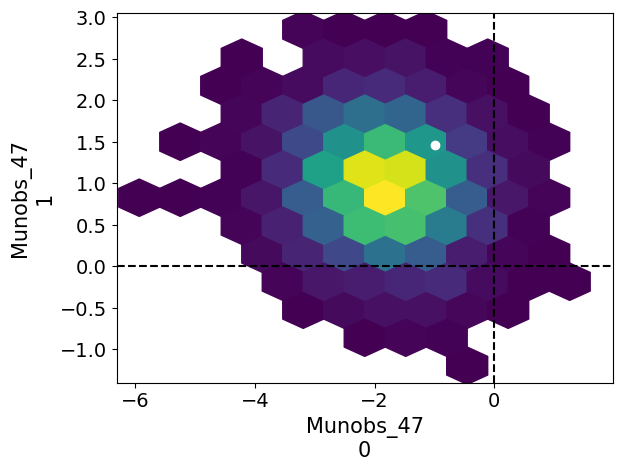

In [332]:
yr=47
az.plot_pair(getattr(looptrace.posterior,"Munobs_"+str(yr)),kind="hexbin")
plt.axvline(0,c="k",ls="--")
plt.axhline(0,c="k",ls="--")
obs=self.val["M"][:,yr]
plt.plot(obs[0],obs[1],"wo")

In [412]:

uars=[]
        for k in range(len(coords["vari"])):
            uar_cross=[]
            for j in range(len(coords["cross_vari"])):
                uar_lags=[]
                for i in range(nlags):
                    uar_lags.append(lag_coefs[k,j,i]* subsequent_data[j,(i-1)+1])
                usum_lags=pm.math.sum(uar_lags,axis=0)
                
                uar_cross.append(usum_lags)
            usum_cross=pm.math.sum(uar_cross,axis=0)
            uars.append(usum_cross)
        unobs_VARstep= pm.math.stack(uars,axis=-1)

(array([1902, 1903, 1904, 1905, 1906, 1907, 1908, 1909, 1910, 1911, 1912,
        1913, 1914, 1915, 1916, 1917, 1918, 1919, 1920, 1921, 1922, 1923,
        1924, 1925, 1926, 1927, 1928, 1929, 1930, 1931, 1932, 1933, 1934,
        1935, 1936, 1937, 1938, 1939, 1940, 1941, 1942, 1943, 1944, 1945,
        1946, 1947, 1948, 1949]),
 array([1950, 1951, 1952, 1953, 1954, 1955, 1956, 1957, 1958, 1959, 1960,
        1961, 1962, 1963, 1964, 1965, 1966, 1967, 1968, 1969, 1970, 1971,
        1972, 1973, 1974, 1975, 1976, 1977, 1978, 1979, 1980, 1981, 1982,
        1983, 1984, 1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993,
        1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004,
        2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015,
        2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]))

In [413]:
# Looping over- works but slow

coords={"vari":["T","P"],\
        "time":np.concatenate([self.taxes["val"],self.taxes["train"]]),\
       "cross_vari":["T","P"],\
       "lags":[1],\
       "time_train":self.taxes["train"][:-1],
       "time_validate":self.taxes["val"]}

with pm.Model(coords=coords) as LoopModel:
     # prior on global T regression slope
    gamma=pm.Normal("gamma",0,1,dims=["vari"])
    
    # assumed forced response regresses on T
    F=pm.Deterministic("F",gamma*np.stack([globalTtrain[:-nlags],globalTtrain[:-nlags]]).T) 
    #print("F shape is ",F.shape.eval())
    
    # covariance between T and P at time t
    noise_chol, _, _ = pm.LKJCholeskyCov(
        "noise_chol",
        eta=1,
        n=len(coords["vari"]),
        sd_dist=pm.HalfNormal.dist(sigma=1),
    )
    cov = pm.Deterministic('cov', noise_chol.dot(noise_chol.T),dims=("vari","cross_vari")) 
    #Lag coefficients
    lag_T=pm.Normal("lag_T",0,1,dims=("lags")) 
    lag_P=pm.Normal("lag_P",0,1,dims=("lags")) 
    sigma_T=pm.HalfNormal("sigma_T",1)
    sigma_P=pm.HalfNormal("sigma_P",1)
    
    #training data
    data_train=pm.Data("Mtrain",Mtrain.values,mutable=True)
    
    #  autoregressive step
    AR_step_T=pm.AR("AR_T",rho=lag_T,sigma=sigma_T)
    AR_step_P=pm.AR("AR_P",rho=lag_P,sigma=sigma_P)
    #print("data_train shape",data_train
    
    #Obs ~ MN(forced response + VAR, Σ)
    Mobs = pm.MvNormal("Mobs",mu=F+VAR_step,chol=noise_chol,observed=Mtrain.values.T[:-nlags])

    #Assume an AR1 model for D
    beta=pm.Normal("beta",0,1,dims=["vari"])
    rhoD=pm.Normal("rhoD",0,1)
    sigmaD=pm.HalfNormal("sigmaD",1)
    
    Dmean=pm.math.sum(beta*Mtrain.values.T[:-1],axis=-1)
    #next year
    Dar=rhoD*Dtrain.values[nlags:]

    
    Dobs=pm.Normal("Dobs",mu=Dmean+Dar,sigma=sigmaD,observed=Dtrain.values[:-nlags])

    # Loop over all times in validation step
    Munobs={}
    Dunobs={}
    subsequent_data=data_train[:,:nlags]
    for yr in np.arange(int(Dval.shape[0]))[::-1][:4]:
        #calculate the lag step for the first unknown M given the first step of the training data
        
        uars=[]
        for k in range(len(coords["vari"])):
            uar_cross=[]
            for j in range(len(coords["cross_vari"])):
                uar_lags=[]
                for i in range(nlags):
                    uar_lags.append(lag_coefs[k,j,i]* subsequent_data[j,(i-1)+1])
                usum_lags=pm.math.sum(uar_lags,axis=0)
                
                uar_cross.append(usum_lags)
            usum_cross=pm.math.sum(uar_cross,axis=0)
            uars.append(usum_cross)
        unobs_VARstep= pm.math.stack(uars,axis=-1)
        #print("unobs_VARstep shape",unobs_VARstep.shape.eval())
        Funobs=gamma[0]*globalTval[yr]+gamma[1]*globalTval[yr]
        Munobs[yr]=pm.MvNormal("Munobs_"+str(yr),mu=Funobs+unobs_VARstep,chol=noise_chol)
    
        Dar_unobs=rhoD*D.values[0]
        Dmean_unobs=pm.math.sum(beta*Munobs[yr].T,axis=-1)
        Dunobs[yr]=pm.Normal("Dunobs_"+str(yr),mu=Dar_unobs+Dmean_unobs,sigma=sigmaD,observed=Dval[yr])
       
       # print("subsequent_data shape",subsequent_data.shape.eval())
        #print("Munobs.shape",Munobs.shape.eval())
        subsequent_data=pm.math.concatenate([Munobs[yr][:,pt.newaxis],subsequent_data],axis=1)
        
    looptrace=pm.sample()


NameError: name 'globalTtrain' is not defined

In [395]:
self=DCK

In [396]:

data=self.train["M"].T


coords={"vari":["T","P"],\
        "time_train":self.taxes["train"],\
       "cross_vari":["T","P"],\
       "lags":[1],\
       "time_validate":self.taxes["val"],
       "time":np.concatenate([self.taxes["val"],self.taxes["train"]])[:-1]}
# with armod:
#     print(pm.math.dot(rho,data).shape.eval())
# Mtrain

In [397]:
with pm.Model(coords=coords) as armod:
    def step(x, rho):
        return pm.math.dot( x.T,rho)
        
     # prior on global T regression slope
    gamma=pm.Normal("gamma",0,1,dims=["vari"])
    
    # assumed forced response regresses on global mean T
    F=pm.Deterministic("F",gamma*np.stack([self.train["G"][:-1],self.train["G"][:-1]]).T) 
    
    rho = pm.Normal('rho',dims=("vari","cross_vari"))
    ar_mean, _ = pytensor.scan(step, non_sequences=[rho], sequences=dict(input=data, taps=[1]))
    
    noise_chol, _, _ = pm.LKJCholeskyCov(
        "noise_chol",
        eta=1,
        n=len(coords["vari"]),
        sd_dist=pm.HalfNormal.dist(sigma=1),
    )
    cov = pm.Deterministic('cov', noise_chol.dot(noise_chol.T),dims=("vari","cross_vari")) 
    
    # Drop last observation from the data 
    obs = pm.MvNormal('obs', mu=ar_mean+F, chol=noise_chol, observed=self.train["M"].T[:-1])
     #Assume an AR1 model for D
    beta=pm.Normal("beta",0,1,dims=["vari"])
    rhoD=pm.Normal("rhoD",0,1)
    sigmaD=pm.HalfNormal("sigmaD",1)
    
    Dmean=pm.math.sum(beta*self.train["M"].T[:-1],axis=-1)
    #next year
    Dar=rhoD*self.train["D"][nlags:]

    
    Dobs=pm.Normal("Dobs",mu=Dmean+Dar,sigma=sigmaD,observed=self.train["D"][:-nlags])

    
    
    idata = pm.sample(init='jitter+adapt_diag_grad')

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag_grad...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [gamma, rho, noise_chol, beta, rhoD, sigmaD]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 9 seconds.


array([<Axes: title={'center': 'cov\nT, T'}>,
       <Axes: title={'center': 'cov\nT, P'}>,
       <Axes: title={'center': 'cov\nP, T'}>,
       <Axes: title={'center': 'cov\nP, P'}>], dtype=object)

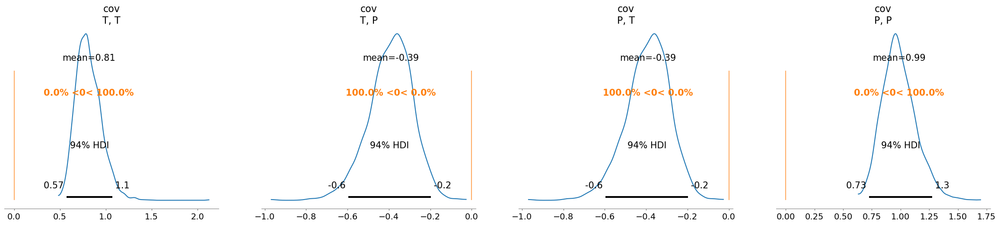

In [393]:
az.plot_posterior(vectrace.posterior.cov,ref_val=0)

array([<Axes: title={'center': 'cov\nT, T'}>,
       <Axes: title={'center': 'cov\nT, P'}>,
       <Axes: title={'center': 'cov\nP, T'}>,
       <Axes: title={'center': 'cov\nP, P'}>], dtype=object)

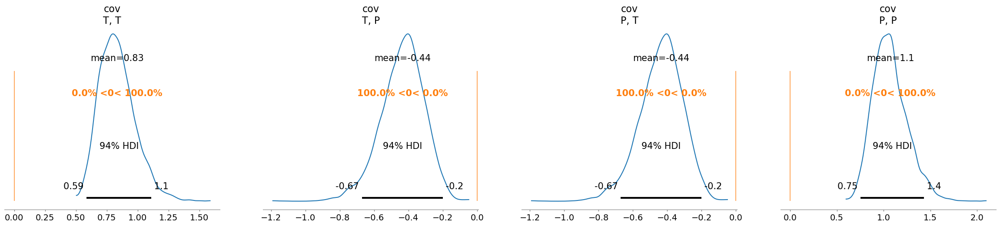

In [394]:
az.plot_posterior(idata.posterior.cov,ref_val=0)

# Do T and P in that year and PDSI the year afer predict PDSI?
Simple AR(1) model:
$$D(t) = \beta_T T(t) + \beta_P P(t) + \rho_D D(t+1) + \epsilon$$
* $M=(T,P)$: the local meterology at time $t$
* $\rho_D$: correlation with soil moisture in year $t+1$
* $\beta_T$: regression coefficient with regional temperature in year $t$
* $\beta_P$: regression coefficient with regional precipitation in year $t$

array([<Axes: title={'center': 'rhoD'}>,
       <Axes: title={'center': 'beta\nT'}>,
       <Axes: title={'center': 'beta\nP'}>], dtype=object)

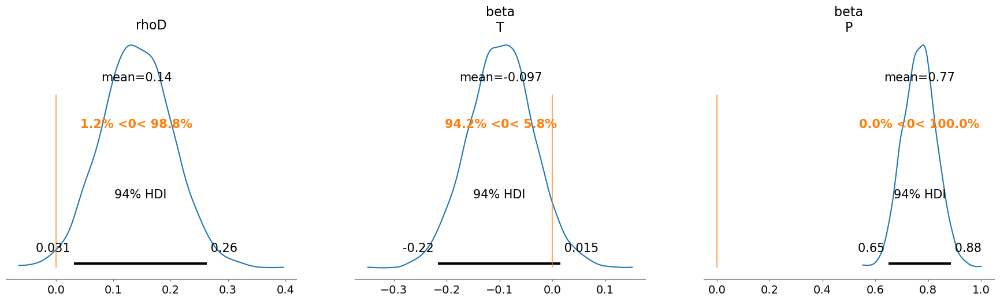

In [392]:
az.plot_posterior(looptrace,var_names=["rhoD","beta"],ref_val=0)

# Lag coefficients
Here we use a vector autoregressive model (VAR) for $M(t)$:
$$\begin{pmatrix}T\\P\end{pmatrix}_t = \ell_1 \begin{pmatrix}T\\P\end{pmatrix}_{t+1}+\ldots+ \ell_{nmax} \begin{pmatrix}T\\P\end{pmatrix}_{t+nmax} + \Sigma$$

array([<Axes: title={'center': 'lag_coefs\nT, T, 1'}>,
       <Axes: title={'center': 'lag_coefs\nT, P, 1'}>,
       <Axes: title={'center': 'lag_coefs\nP, T, 1'}>,
       <Axes: title={'center': 'lag_coefs\nP, P, 1'}>], dtype=object)

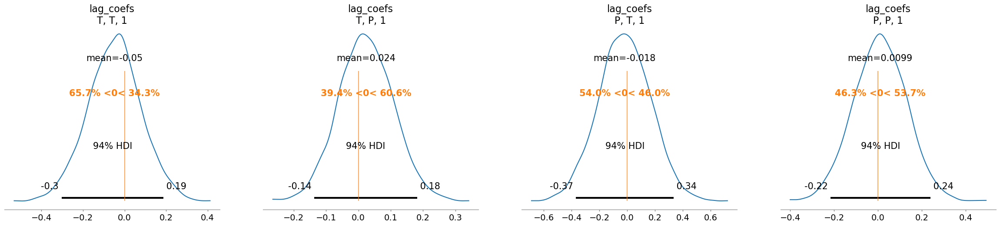

In [466]:

az.plot_posterior(looptrace,var_names=["lag_coefs"],ref_val=0)

# Covariance
$T$ and $P$ in a given year are 

array([<Axes: title={'center': 'cov\nT, T'}>,
       <Axes: title={'center': 'cov\nT, P'}>,
       <Axes: title={'center': 'cov\nP, T'}>,
       <Axes: title={'center': 'cov\nP, P'}>], dtype=object)

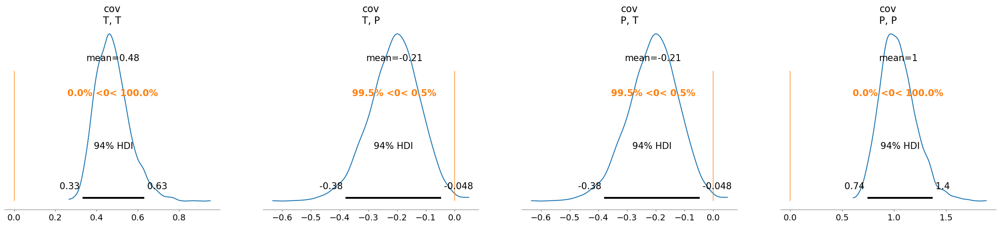

In [382]:
#T and P are inversely correlated
np.corrcoef(Mtrain.sel(vari="P").values,Mtrain.sel(vari="T").values)[0,1]
az.plot_posterior(looptrace,var_names=["cov"],ref_val=0)

array([<Axes: title={'center': 'gamma\nT'}>,
       <Axes: title={'center': 'gamma\nP'}>], dtype=object)

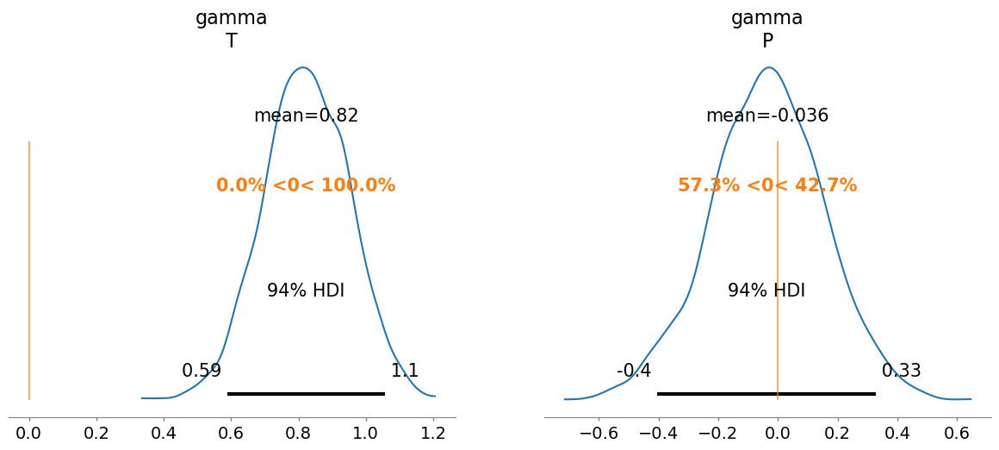

In [383]:

#Sanity check: is T correlated with next year's T?
#yes, but this is probably just due to global warming- there's a strong correlation between global T and regional T
np.corrcoef(Mtrain.sel(vari="T").values[:-1],Mtrain.sel(vari="T").values[1:])[0,1]
az.plot_posterior(looptrace,var_names=["gamma"],ref_val=0)

/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/arviz/plots/pairplot.py:232: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  gridsize = int(dataset.dims["draw"] ** 0.35)


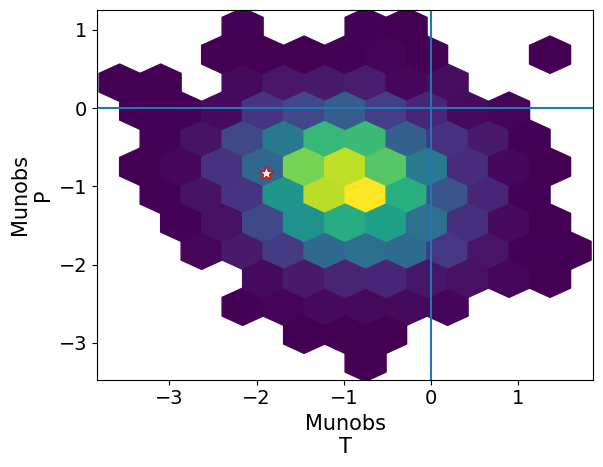

In [384]:
az.plot_pair(looptrace,var_names=["Munobs"],kind="hexbin")
plt.plot(Mval[:,-1].values[0],Mval[:,-1].values[1],marker="*",color="w",ms=10,mec="r")
plt.axhline(0)
plt.axvline(0)


In [17]:
gistemp_norm.sel(year=slice(*training_period)).shape
M.shape

(2, 74)

In [67]:
[i for i in range(nlags)]

[0]

In [405]:

# Assuming you've defined your model and data beforehand...

with pm.Model(coords=coords) as ScanModel:
    # Prior on global T regression slope
    gamma = pm.Normal("gamma", 0, 1, dims=["vari"])

    # Forced response regresses on T
    F = pm.Deterministic("F", gamma * pm.math.stack([self.train["G"][:-nlags], self.train["G"][:-nlags]], axis=1))

    # Covariance between T and P at time t
    noise_chol, _, _ = pm.LKJCholeskyCov(
        "noise_chol",
        eta=1,
        n=len(coords["vari"]),
        sd_dist=pm.HalfNormal.dist(sigma=1),
    )
    cov = pm.Deterministic('cov', noise_chol.dot(noise_chol.T), dims=("vari", "cross_vari"))

    # Lag coefficients
    lag_coefs = pm.Normal("lag_coefs", 0, 1, dims=("vari", "cross_vari", "lags"))

    # Training data
    data_train = pm.Data("Mtrain", self.train["M"], mutable=True)

    # Vector autoregressive step
    VAR_step = calc_var_step(lag_coefs, self.train["M"])

    # Observation model (assumed)
    Mobs = pm.MvNormal("Mobs", mu=F + VAR_step, chol=noise_chol, observed=self.train["M"].T[:-nlags])

    # AR1 model for D
    beta = pm.Normal("beta", 0, 1, dims=["vari"])
    rhoD = pm.Normal("rhoD", 0, 1)
    sigmaD = pm.HalfNormal("sigmaD", 1)

    Dmean = pm.math.sum(beta * self.train["M"].T[:-1], axis=-1)
    Dar = rhoD * self.train["D"][nlags:]
    
    Dobs = pm.Normal("Dobs", mu=Dmean + Dar, sigma=sigmaD, observed=self.train["D"][:-nlags])

    # Define a function to apply on each time step
    def var_step_fn(subsequent_data, yr):
        # Calculate the VAR step (sum over lags for each variable and cross-variable)
        uars = []
        for k in range(len(coords["vari"])):
            uar_cross = []
            for j in range(len(coords["cross_vari"])):
                uar_lags = []
                for i in range(nlags):
                    uar_lags.append(lag_coefs[k, j, i] * subsequent_data[j, (i - 1) + 1])
                usum_lags = pt.sum(uar_lags, axis=0)
                uar_cross.append(usum_lags)
            usum_cross = pt.sum(uar_cross, axis=0)
            uars.append(usum_cross)
        
        unobs_VARstep = pm.math.stack(uars, axis=-1)  # Stack along axis -1

        # Forced response at time step yr
        Funobs = gamma[0] * self.val["G"][yr] + gamma[1] * self.val["G"][yr]
        
        # Create Munobs for this year (dimension should match the data)
        Munobs = pm.MvNormal("Munobs_" + str(yr), mu=Funobs + unobs_VARstep, chol=noise_chol)
        
        # Compute Dmean and Dunobs
        if yr == 0:  # Special case for the first year
            Dar_unobs = rhoD * self.train["D"][0]
        else:
            Dar_unobs = rhoD * self.val["D"][yr + 1]
        
        Dmean_unobs = pt.sum(beta * Munobs.T, axis=-1)
        Dunobs = pm.Normal("Dunobs_" + str(yr), mu=Dar_unobs + Dmean_unobs, sigma=sigmaD, observed=self.val["D"][yr])
        
        # Update subsequent_data for next iteration
        subsequent_data = pt.concatenate([Munobs.T[:, pt.newaxis], subsequent_data], axis=1)  # Concatenate along axis 1
        
        return subsequent_data, Munobs, Dunobs

    # Apply pt.scan to loop over years (reverse order)
    yr_range = np.arange(int(self.val["D"].shape[0]))[::-1]
    
    subsequent_data_init = data_train[:, :nlags]  # Initial data for first time step
    subsequent_data, Munobs_list, Dunobs_list = pt.scan(
        fn=var_step_fn,
        sequences=[yr_range],  # Iterate over years
        outputs_info=[subsequent_data_init, None, None]  # Initialize outputs (subsequent_data, Munobs, Dunobs)
    )

    # Unstack Munobs and Dunobs to get them by year
    Munobs_dict = {yr: Munobs_list[i] for i, yr in enumerate(yr_range)}
    Dunobs_dict = {yr: Dunobs_list[i] for i, yr in enumerate(yr_range)}

    # Final reconstruction step
    reconstructed = pm.Deterministic("reconstruction", subsequent_data)

    # Sampling
    looptrace = pm.sample()


IndexError: too many indices for array

In [523]:
print("same-year correlation",np.corrcoef(train["T"],train["P"])[0,1])
print("P correlated with previous year T",np.corrcoef(train["T"][:-1],train["P"][1:])[0,1])
print("T correlated with previous year P",np.corrcoef(train["P"][:-1],train["T"][1:])[0,1])
print("T correlated with previous year T",np.corrcoef(train["T"][:-1],train["T"][1:])[0,1])
print("P correlated with previous year P",np.corrcoef(train["P"][:-1],train["P"][1:])[0,1])

same-year correlation -0.2542022254068265
P correlated with previous year T 0.13698115946497427
T correlated with previous year P 0.2160514626750395
T correlated with previous year T 0.4343028818208359
P correlated with previous year P -0.12667898926895063


In [ ]:
# Loop through?


In [541]:
#TEST CODE- current
Tglob=gistemp_norm.sel(year=slice(*training_period)).values
n_vars=len(M.vari.values)
n_lags = 1

priors = {
    "lag_coefs": {"mu": 0, "sigma": 1},
    "noise_chol": {"eta": 1, "sigma": 1},
    "noise": {"sigma": 1},
}

coords = {
    "lags": np.arange(n_lags) + 1,
    "vars": ["T","P"],
    "cross_vars": ["T","P"],
    "time":np.append(Mval.year.values,M.year.values)[nlags:],
    "time_train": M.year.values,
    "time_val":Mval.year.values,
    "time_val_nlag":Mval.year.values[n_lags:],\
    "time_train_lag":M.year.values[n_lags:]
}

with pm.Model(coords=coords) as totalmodel:
    #priors on the VAR lag coefficients
    lag_coefs = pm.Normal(
        "lag_coefs",
        mu=priors["lag_coefs"]["mu"],
        sigma=priors["lag_coefs"]["sigma"],
        dims=["vars", "lags", "cross_vars"],
    )
    # F = pm.Normal(
    #     "F", mu=np.zeros_like(M.T.values[n_lags:]), sigma=1, dims=("time","vars")
    # )
    # F = pm.Normal(
    #     "F", mu=0, sigma=1, dims=("vars")
    # )
    s=pm.Normal("s",mu=0,sigma=1,dims=("vars"))
    F_0=np.zeros_like(Mval.T.values[n_lags:])
    F_obs= pm.math.stack([s[0]*Tglob,s[1]*Tglob],axis=1)
    F=pm.math.concatenate([F_0,F_obs])
   # print("F shape",F.shape.eval())
    
    data_obs = pm.Data("data_obs", M.T.values, dims=["time_train", "vars"], mutable=True)
    
    data_total=pm.math.concatenate([data_unobs,data_obs])
    print("data total shape",data_total.shape.eval())
    
    

    ar_step = calc_ar_step(lag_coefs, n_vars, n_lags, data_total)
    ar_step = pm.Deterministic(
        "ar_step",
        ar_step,
        dims=[
            "time",
        ],
    )
    mean = F + ar_step
    print("mean shape",mean.shape.eval())

   
    n = 2
    ## multivariate normal AR(n) for observed M (ie T and P)
    noise_chol, _, _ = pm.LKJCholeskyCov(
        "noise_chol",
        eta=priors["noise_chol"]["eta"],
        n=n,
        sd_dist=pm.HalfNormal.dist(sigma=priors["noise_chol"]["sigma"]),
    )
    cov = pm.Deterministic('cov', noise_chol.dot(noise_chol.T),dims=("vars","cross_vars"))
    obs = pm.MvNormal(
        "obs", mu=mean, chol=noise_chol, observed=data_obs, dims=["time_train", "vars"]
    )
    



data total shape [122   2]
mean shape [121   2]


In [540]:
#TEST CODE- abandoned
Tglob=gistemp_norm.sel(year=slice(*training_period)).values
n_vars=len(M.vari.values)
n_lags = 1

priors = {
    "lag_coefs": {"mu": 0, "sigma": 1},
    "noise_chol": {"eta": 1, "sigma": 1},
    "noise": {"sigma": 1},
}

coords = {
    "lags": np.arange(n_lags) + 1,
    "vars": ["T","P"],
    "cross_vars": ["T","P"],
    "time":np.append(Mval.year.values,M.year.values)[nlags:],
    "time_train": M.year.values,
    "time_val":Mval.year.values,
    "time_val_nlag":Mval.year.values[n_lags:],\
    "time_train_lag":M.year.values[n_lags:]
}

with pm.Model(coords=coords) as totalmodel:
    #priors on the VAR lag coefficients
    lag_coefs = pm.Normal(
        "lag_coefs",
        mu=priors["lag_coefs"]["mu"],
        sigma=priors["lag_coefs"]["sigma"],
        dims=["vars", "lags", "cross_vars"],
    )
    # F = pm.Normal(
    #     "F", mu=np.zeros_like(M.T.values[n_lags:]), sigma=1, dims=("time","vars")
    # )
    # F = pm.Normal(
    #     "F", mu=0, sigma=1, dims=("vars")
    # )
    s=pm.Normal("s",mu=0,sigma=1,dims=("vars"))
    F_0=np.zeros_like(Mval.T.values[n_lags:])
    F_obs= pm.math.stack([s[0]*Tglob,s[1]*Tglob],axis=1)
    F=pm.math.concatenate([F_0,F_obs])
   # print("F shape",F.shape.eval())
    
    data_obs = pm.Data("data_obs", M.T.values, dims=["time_train", "vars"], mutable=True)
    data_unobs=pm.Normal("data_unobs",0,1, dims=["time_val", "vars"])
    data_total=pm.math.concatenate([data_unobs,data_obs])
    print("data total shape",data_total.shape.eval())
    
    

    ar_step = calc_ar_step(lag_coefs, n_vars, n_lags, data_total)
    ar_step = pm.Deterministic(
        "ar_step",
        ar_step,
        dims=[
            "time",
        ],
    )
    mean = F + ar_step
    print("mean shape",mean.shape.eval())

   
    n = 2
    ## multivariate normal AR(n) for observed M (ie T and P)
    noise_chol, _, _ = pm.LKJCholeskyCov(
        "noise_chol",
        eta=priors["noise_chol"]["eta"],
        n=n,
        sd_dist=pm.HalfNormal.dist(sigma=priors["noise_chol"]["sigma"]),
    )
    cov = pm.Deterministic('cov', noise_chol.dot(noise_chol.T),dims=("vars","cross_vars"))
    obs = pm.MvNormal(
        "obs", mu=mean, chol=noise_chol, observed=data_total, dims=["time", "vars"]
    )
    
    #D is a linear combination of T and P
    # beta=pm.Normal("beta",0,1,dims=["vars"])
    # rhoD=pm.Normal("rhoD",0,1)
    # sigmaD=pm.HalfNormal("sigmaD",1)
    # Dmean=beta[0]*M.values[0][nlags:]+beta[1]*M.values[1][nlags:]
    # Dar=pm.AR("D_AR",rho=rhoD,sigma=sigmaD,init_dist=pm.Normal.dist(0,.1),dims=["time"])
    # Dobs=pm.Normal("Dobs",mu=Dmean+Dar,sigma=sigmaD,observed=D.values[nlags:])

    # # unobserved M
    # #dummy T and P: should have dimensions nval
    # Tdummy=pm.Normal("Tdummy",0,1,dims=("time_val_nlag"))
    # Pdummy=pm.Normal("Pdummy",0,1,dims=("time_val_nlag"))
    # Mdummy= pm.math.stack([Tdummy,Pdummy],axis=1)
    # print(Mdummy.shape.eval())
    # ar_unobs=calc_ar_step(lag_coefs, n_vars, n_lags, Mdummy)
    # print("ar_step shape",ar_step.shape.eval())
    # print("ar_unobs shape",ar_unobs.shape.eval())
    
    #noFtrace=pm.sample()

data total shape [122   2]
mean shape [121   2]


TypeError: Variables that depend on other nodes cannot be used for observed data.The data variable was: Join.0

In [192]:
#LAST WORKING CODE- DO NOT BREAK
Tglob=gistemp_norm.sel(year=slice(*training_period)).values
n_vars=len(M.vari.values)
n_lags = 1

priors = {
    "lag_coefs": {"mu": 0, "sigma": 1},
    "noise_chol": {"eta": 1, "sigma": 1},
    "noise": {"sigma": 1},
}

coords = {
    "lags": np.arange(n_lags) + 1,
    "vars": ["T","P"],
    "cross_vars": ["T","P"],
    "time": M.year.values[n_lags:],
    "time_val":Mval.year.values,
    "time_val_nlag":np.append(Mval.year.values,M.year.values[:n_lags])
}

with pm.Model(coords=coords) as noFmodel:
    #priors on the VAR lag coefficients
    lag_coefs = pm.Normal(
        "lag_coefs",
        mu=priors["lag_coefs"]["mu"],
        sigma=priors["lag_coefs"]["sigma"],
        dims=["vars", "lags", "cross_vars"],
    )
    # F = pm.Normal(
    #     "F", mu=np.zeros_like(M.T.values[n_lags:]), sigma=1, dims=("time","vars")
    # )
    # F = pm.Normal(
    #     "F", mu=0, sigma=1, dims=("vars")
    # )
    s=pm.Normal("s",mu=0,sigma=1,dims=("vars"))
    F= pm.math.stack([s[0]*Tglob[nlags:],s[1]*Tglob[nlags:]],axis=1)
   # print("F shape",F.shape.eval())
    
    data_obs = pm.Data("data_obs", M.T.values[n_lags:], dims=["time", "vars"], mutable=True)
    print(data_obs.shape.eval())

    ar_step = calc_ar_step(lag_coefs, n_vars, n_lags, M.T.values)
    ar_step = pm.Deterministic(
        "ar_step",
        ar_step,
        dims=[
            "time",
        ],
    )
    mean = F + ar_step
    print("mean shape",mean.shape.eval())

   
    n = M.T.shape[1]
    ## multivariate normal AR(n) for observed M (ie T and P)
    noise_chol, _, _ = pm.LKJCholeskyCov(
        "noise_chol",
        eta=priors["noise_chol"]["eta"],
        n=n,
        sd_dist=pm.HalfNormal.dist(sigma=priors["noise_chol"]["sigma"]),
    )
    cov = pm.Deterministic('cov', noise_chol.dot(noise_chol.T),dims=("vars","cross_vars"))
    obs = pm.MvNormal(
        "obs", mu=mean, chol=noise_chol, observed=data_obs, dims=["time", "vars"]
    )
    
    #D is a linear combination of T and P
    beta=pm.Normal("beta",0,1,dims=["vars"])
    rhoD=pm.Normal("rhoD",0,1)
    sigmaD=pm.HalfNormal("sigmaD",1)
    Dmean=beta[0]*M.values[0][nlags:]+beta[1]*M.values[1][nlags:]
    Dar=pm.AR("D_AR",rho=rhoD,sigma=sigmaD,init_dist=pm.Normal.dist(0,.1),dims=["time"])
    Dobs=pm.Normal("Dobs",mu=Dmean+Dar,sigma=sigmaD,observed=D.values[nlags:])

    # # unobserved M
    # #dummy T and P: should have dimensions nval
    # Tdummy=pm.Normal("Tdummy",0,1,dims=("time_val_nlag"))
    # Pdummy=pm.Normal("Pdummy",0,1,dims=("time_val_nlag"))
    # Mdummy= pm.math.stack([Tdummy,Pdummy],axis=1)
    # print(Mdummy.shape.eval())
    # ar_unobs=calc_ar_step(lag_coefs, n_vars, n_lags, Mdummy)
    # print("ar_step shape",ar_step.shape.eval())
    # print("ar_unobs shape",ar_unobs.shape.eval())
    
    noFtrace=pm.sample()

[73  2]
mean shape [73  2]


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [lag_coefs, s, noise_chol, beta, rhoD, sigmaD, D_AR]


/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/pytensor/compile/function/types.py:970: RuntimeWarning: invalid value encountered in accumulate
  self.vm()
Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 14 seconds.


array([[<Axes: title={'center': 'rhoD'}>,
        <Axes: title={'center': 'beta\nT'}>,
        <Axes: title={'center': 'beta\nP'}>,
        <Axes: title={'center': 'lag_coefs\nT, 1, T'}>],
       [<Axes: title={'center': 'lag_coefs\nT, 1, P'}>,
        <Axes: title={'center': 'lag_coefs\nP, 1, T'}>,
        <Axes: title={'center': 'lag_coefs\nP, 1, P'}>,
        <Axes: title={'center': 'cov\nT, T'}>],
       [<Axes: title={'center': 'cov\nT, P'}>,
        <Axes: title={'center': 'cov\nP, T'}>,
        <Axes: title={'center': 'cov\nP, P'}>,
        <Axes: title={'center': 's\nT'}>],
       [<Axes: title={'center': 's\nP'}>, <Axes: >, <Axes: >, <Axes: >]],
      dtype=object)

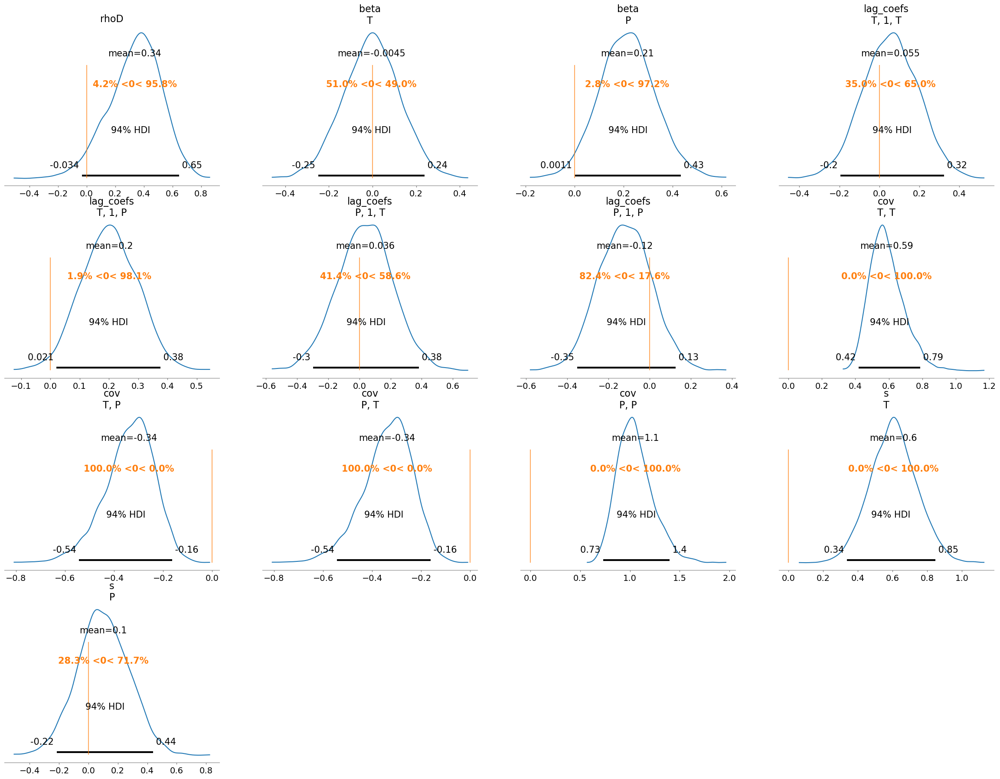

In [190]:
az.plot_posterior(noFtrace,var_names=["rhoD","beta","lag_coefs","cov","s"],ref_val=0)

In [501]:
print("same-year correlation",np.corrcoef(train["T"],train["P"])[0,1])
print("P correlated with previous year T",np.corrcoef(train["T"][:-1],train["P"][1:])[0,1])
print("T correlated with previous year P",np.corrcoef(train["P"][:-1],train["T"][1:])[0,1])
print("T correlated with previous year T",np.corrcoef(train["T"][:-1],train["T"][1:])[0,1])
print("P correlated with previous year P",np.corrcoef(train["P"][:-1],train["P"][1:])[0,1])

same-year correlation -0.2542022254068265
P correlated with previous year T 0.13698115946497427
T correlated with previous year P 0.2160514626750395
T correlated with previous year T 0.4343028818208359
P correlated with previous year P -0.12667898926895063


array([[<Axes: title={'center': 'lag_coefs\nT, 1, T'}>,
        <Axes: title={'center': 'lag_coefs\nT, 1, P'}>,
        <Axes: title={'center': 'lag_coefs\nP, 1, T'}>],
       [<Axes: title={'center': 'lag_coefs\nP, 1, P'}>,
        <Axes: title={'center': 'noise_chol\n0'}>,
        <Axes: title={'center': 'noise_chol\n1'}>],
       [<Axes: title={'center': 'noise_chol\n2'}>,
        <Axes: title={'center': 'F\nT'}>,
        <Axes: title={'center': 'F\nP'}>]], dtype=object)

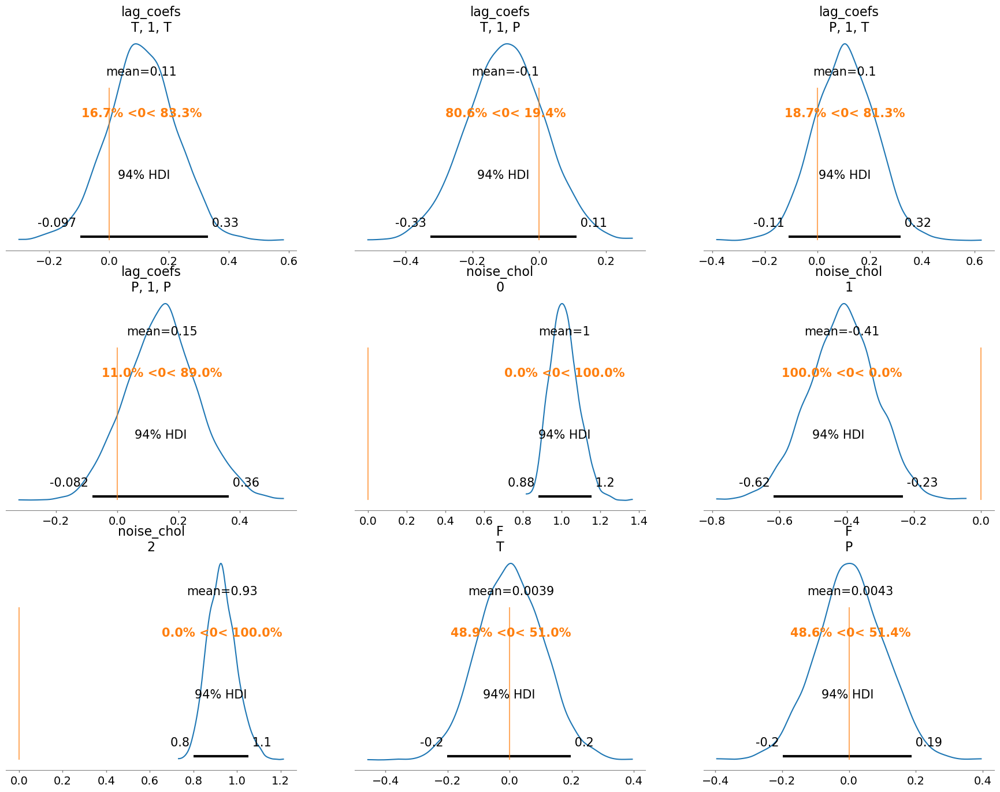

In [428]:
az.plot_posterior(noFtrace.posterior,var_names=["lag_coefs","noise_chol","F"],ref_val=0)

In [416]:
### Make the model in such a way that it can handle different specifications of the likelihood term
### and can be run for simple prior predictive checks. This latter functionality is important for debugging of
### shape handling issues. Building a VAR model involves quite a few moving parts and it is handy to
### inspect the shape implied in the prior predictive checks.
def make_model(n_lags, n_vars, df, priors,  prior_checks=True):
    coords = {
        "lags": np.arange(n_lags) + 1,
        "vars": ["T","P"],
        "cross_vars": ["T","P"],
        "time": df.year[n_lags:],
    }

    with pm.Model(coords=coords) as model:
        lag_coefs = pm.Normal(
            "lag_coefs",
            mu=priors["lag_coefs"]["mu"],
            sigma=priors["lag_coefs"]["sigma"],
            dims=["vars", "lags", "cross_vars"],
        )
        F = pm.Normal(
            "F", mu=np.zeros_like(df.T.values[n_lags:]), sigma=1, dims=("time","vars")
        )
        print("F shape",F.shape.eval())
        
        data_obs = pm.Data("data_obs", df.T.values[n_lags:], dims=["time", "vars"], mutable=True)
        print(data_obs.shape.eval())

        betaX = calc_ar_step(lag_coefs, n_vars, n_lags, df)
        betaX = pm.Deterministic(
            "betaX",
            betaX,
            dims=[
                "time",
            ],
        )
        mean = F + betaX
        print("mean shape",mean.shape.eval())

       
        n = df.T.shape[1]
        ## Under the hood the LKJ prior will retain the correlation matrix too.
        noise_chol, _, _ = pm.LKJCholeskyCov(
            "noise_chol",
            eta=priors["noise_chol"]["eta"],
            n=n,
            sd_dist=pm.HalfNormal.dist(sigma=priors["noise_chol"]["sigma"]),
        )
        cov = pm.Deterministic('cov', noise_chol.dot(noise_chol.T),dims=("vars","cross_vars"))
        obs = pm.MvNormal(
            "obs", mu=mean, chol=noise_chol, observed=data_obs, dims=["time", "vars"]
        )
        print("obs shape",obs.shape.eval())
    
        if prior_checks:
            idata = pm.sample_prior_predictive()
            return model, idata
        else:
            idata = pm.sample_prior_predictive()
            idata.extend(pm.sample(draws=2000, random_seed=130))
            pm.sample_posterior_predictive(idata, extend_inferencedata=True, random_seed=rng)
    return model, idata

In [417]:
n_lags = 1
n_eqs = 2
priors = {
    "lag_coefs": {"mu": 0, "sigma": 1},
    "noise_chol": {"eta": 1, "sigma": 1},
    "noise": {"sigma": 1},
}

model, idata = make_model(n_lags, n_eqs, df, priors,prior_checks=False)

Sampling: [F, lag_coefs, noise_chol, obs]


F shape [97  2]
[97  2]
mean shape [97  2]
obs shape [97  2]


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [lag_coefs, F, noise_chol]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 103 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details
There were 1018 divergences after tuning. Increase `target_accept` or reparameterize.
Sampling: [obs]


array([<Axes: title={'center': 'lag_coefs\nT, 1, T'}>,
       <Axes: title={'center': 'lag_coefs\nT, 1, P'}>,
       <Axes: title={'center': 'lag_coefs\nP, 1, T'}>,
       <Axes: title={'center': 'lag_coefs\nP, 1, P'}>], dtype=object)

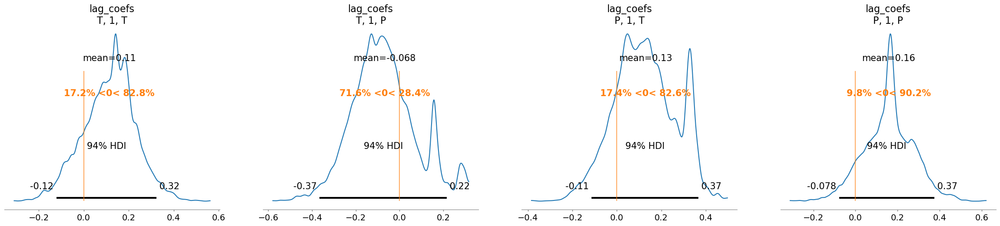

In [418]:
az.plot_posterior(idata.posterior.lag_coefs,ref_val=0)

In [419]:
with model:
    trace=pm.sample()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [lag_coefs, F, noise_chol]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 51 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details
There were 287 divergences after tuning. Increase `target_accept` or reparameterize.


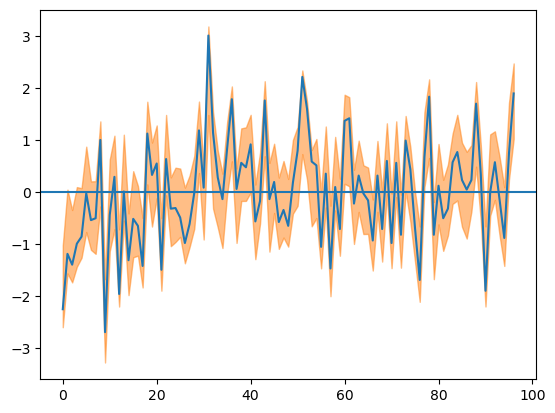

In [420]:
tst=trace.posterior.F.sel(vars="T")
az.plot_hdi(np.arange(97),tst,smooth=False)
plt.plot(df.sel(vari="T")[nlags:].values)
plt.axhline(0)

array([[<Axes: title={'center': 'lag_coefs\nT, 1, T'}>,
        <Axes: title={'center': 'lag_coefs\nT, 1, P'}>,
        <Axes: title={'center': 'lag_coefs\nP, 1, T'}>,
        <Axes: title={'center': 'lag_coefs\nP, 1, P'}>],
       [<Axes: title={'center': 'cov\nT, T'}>,
        <Axes: title={'center': 'cov\nT, P'}>,
        <Axes: title={'center': 'cov\nP, T'}>,
        <Axes: title={'center': 'cov\nP, P'}>]], dtype=object)

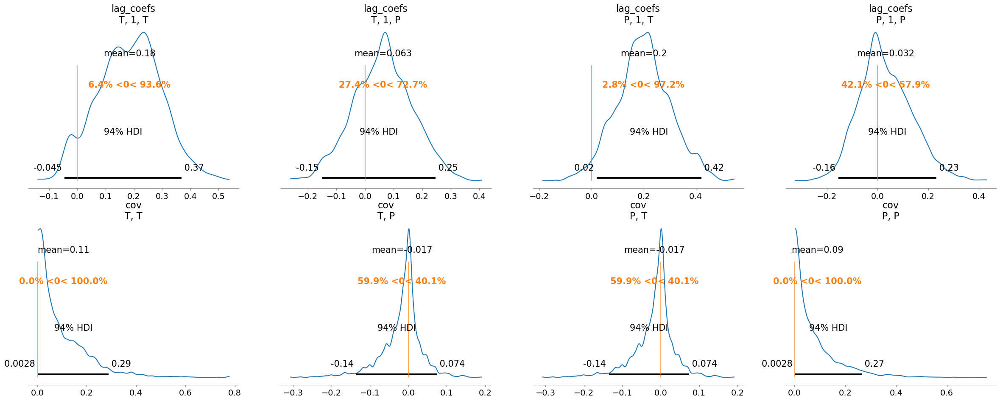

In [375]:
az.plot_posterior(trace,var_names=["lag_coefs","cov"],ref_val=0)

same-year correlation -0.054646940575855445
P correlated with previous year T 0.2032783378738107
T correlated with previous year P 0.05273838937723815
T correlated with previous year T 0.1886708402284377
P correlated with previous year P 0.02350793504111173


In [374]:
trace.posterior.cov.mean(dim=("chain","draw"))

<xarray.DataArray 'cov' (vars: 2, cross_vars: 2)> Size: 32B
array([[ 0.10570856, -0.0167499 ],
       [-0.0167499 ,  0.08954765]])
Coordinates:
  * vars        (vars) <U1 8B 'T' 'P'
  * cross_vars  (cross_vars) <U1 8B 'T' 'P'

In [271]:
with pm.Model(coords=coords) as Mmodel:
    rhoT=pm.Normal("rhoT",0,1)
    sigmaT=pm.HalfNormal("sigmaT",1)
    init = pm.Normal.dist(
        mu=0, 
        sigma=.1, 
        size=M.shape
    )
    ART=pm.AR("ART",rho=rhoT,sigma=sigmaT,dims=("train_year"),init_dist=init)
    obsT=pm.Normal(
    # rhoP=pm.Normal("rhoP",0,1)
    # sigmaP=pm.HalfNormal("sigmaP",1)
    # ARP=pm.AR("ARP",rho=rhoP,sigma=sigmaP,dims=("train_year"),init_dist=init)
    # sigmaDist = pm.Exponential.dist(1.0)
    # chol,_,_ = pm.LKJCholeskyCov('L', eta=4, n=len(coords["vari"]),\
    #                                        sd_dist=sigmaDist,compute_corr=True)
    # stk=pt.stack([ART,ARP])
    # tst=pt.dot(chol,stk)
    # obs=pm.Normal("obs",mu=tst,sigma=.1,observed=M)
    # Msamp=pm.sample()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [rhoT, sigmaT, ART, rhoP, sigmaP, ARP, L]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 24 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details
There were 22 divergences after tuning. Increase `target_accept` or reparameterize.


array([<Axes: title={'center': 'L\n0'}>, <Axes: title={'center': 'L\n1'}>,
       <Axes: title={'center': 'L\n2'}>], dtype=object)

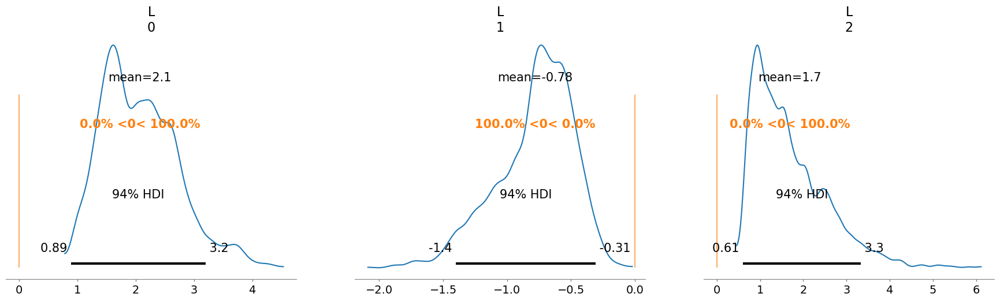

In [274]:
az.plot_posterior(Msamp,var_names=["L"],ref_val=0)

In [256]:
# learn the forced response and internal variability
M=np.stack([train["T"].values,train["P"].values])
#print("M shape is",M.shape)
nvar,nt=M.shape

with pm.Model(coords=coords) as Mmodel:
    rho=pm.Normal("rho",0,1)
    sigma=pm.HalfNormal("sigma",1)
    init = pm.Normal.dist(
        mu=0, 
        sigma=1, 
        size=M.shape
    )
    AR=pm.AR("AR",rho=rho,sigma=sigma,dims=("train_year","vari"),init_dist=init)
    sigmaDist = pm.Exponential.dist(1.0)
    chol,_,_ = pm.LKJCholeskyCov('L', eta=4, n=len(coords["vari"]),\
                                           sd_dist=sigmaDist,compute_corr=True)
    obs=pm.MvNormal("obs",mu=AR,chol=chol,observed=M.T)#,dims=("vari","train_year"))
    Mtrace=pm.sample()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [rho, sigma, AR, L]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 37 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details
There were 470 divergences after tuning. Increase `target_accept` or reparameterize.


array([<Axes: title={'center': 'L\n0'}>, <Axes: title={'center': 'L\n1'}>,
       <Axes: title={'center': 'L\n2'}>], dtype=object)

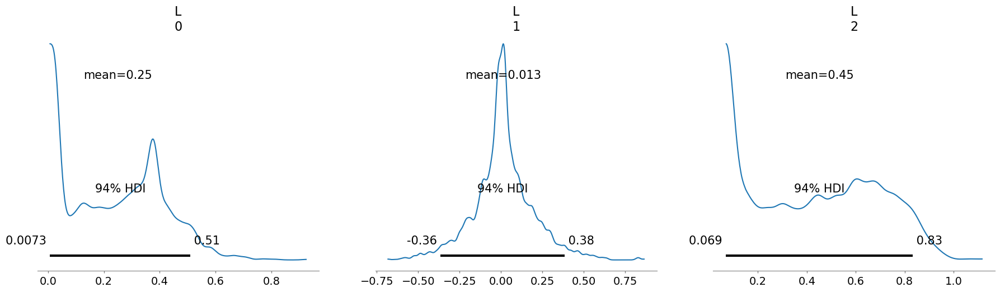

In [258]:
az.plot_posterior(Mtrace,var_names=["L"])

In [254]:
Mtrace.posterior.L.mean(dim=("chain","draw"))

<xarray.DataArray 'L' (L_dim_0: 3)> Size: 24B
array([ 1.00580608, -0.38240271,  0.92635684])
Coordinates:
  * L_dim_0  (L_dim_0) int64 24B 0 1 2

In [255]:
np.corrcoef(train["T"],train["P"])

array([[ 1.        , -0.41078788],
       [-0.41078788,  1.        ]])

In [201]:
with pm.Model() as regressionmodel:
    betaT=pm.Normal("betaT",0,1)
    betaP=pm.Normal("betaP",0,1)
    sigma=pm.HalfNormal("sigma",1)
    obs=pm.Normal("obs",mu=betaT*train["T"].values+betaP*train["P"].values,sigma=sigma,observed=train["D"])
    whitetrace=pm.sample(idata_kwargs={"log_likelihood": True})

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [betaT, betaP, sigma]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 1 seconds.


# Comparing white noise to AR(1)
- For RMA, most of variation is dumped into autoregressive term- can better predict D using year before than P and T (although P helps)
- For DCK, 

In [202]:

indices=["T","P"]

# Specify priors
nlags=1
priors={
    "lag_coefs": {"mu":np.tile(0,nlags),"sigma":np.tile(1,nlags),"size":nlags},
    "sigma": 10,
    "init":{"mu":0,"sigma":0.1,"size":1},
    "beta":{"T":{"mu":0,"sigma":10},\
            "P":{"mu":0,"sigma":10},\
           "gmt":{"mu": 0 ,"sigma":10}}
}
#initialize the model
with pm.Model() as AR:
    pass

#year interval for training_data
train_year=train["T"].year.values

#add coordinates
AR.add_coord("year",train_year,mutable=True)
AR.add_coord("lags",-1*(np.arange(nlags)+1))
#AR.add_coord("index",indices)

with AR:
    M={}
    beta={}
    response={}
    for index in indices:
   
        M[index]=pm.MutableData(index,\
                        train[index].values,\
                         dims="year")
        beta[index]=pm.Normal("beta_"+index,priors["beta"][index]["mu"],priors["beta"][index]["sigma"])
        response[index]=pm.Deterministic("response_to_"+index,beta[index]*M[index],dims="year")
    
    D = pm.MutableData("D",train["D"].values,dims="year")
    lag_coefs = pm.Normal("lag_coefs", priors["lag_coefs"]["mu"], priors["lag_coefs"]["sigma"],dims=("lags"))
    sigma = pm.HalfNormal("sigma", priors["sigma"])
    # We need one init variable for each lag, hence size is variable too
    init = pm.Normal.dist(
        priors["init"]["mu"], 
        priors["init"]["sigma"], 
        size=priors["init"]["size"]
    )
    # Steps of the AR model minus the lags required
    ar_n = pm.AR(
        "ar",
        lag_coefs,
        sigma=sigma,
        init_dist=init,
        constant=False,
        steps=train_year.shape[0] - (priors["lag_coefs"]["size"]),
        dims="year",
    )
    
   
   
    mean = pm.math.sum(pm.math.stack([response[index] for index in indices]),axis=0) + ar_n
    # Likelihood of observing preindustrial soil moisture given 
    train_D = pm.Normal("train_D",mu=mean,sigma=sigma,observed = D)
    idata_ar = pm.sample_prior_predictive()
    idata_ar.extend(pm.sample(2000, random_seed=100, target_accept=0.95))
    idata_ar.extend(pm.sample_posterior_predictive(idata_ar))

Sampling: [ar, beta_P, beta_T, lag_coefs, sigma, train_D]
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [beta_T, beta_P, lag_coefs, sigma, ar]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 4 seconds.
Sampling: [train_D]


array([<Axes: title={'center': 'lag_coefs\n-1'}>,
       <Axes: title={'center': 'beta_T'}>,
       <Axes: title={'center': 'beta_P'}>], dtype=object)

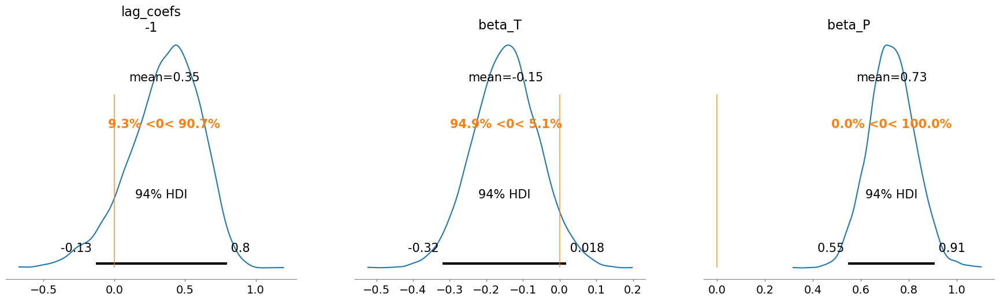

In [203]:
az.plot_posterior(idata_ar.posterior,var_names=["lag_coefs","beta_T","beta_P"],ref_val=0)

# Comparing AR(1) to a white noise model
At least for this region, lag-1 autocorrelations in PDSI appear to be due to autocorrelations in the temperature

array([<Axes: title={'center': 'betaT'}>,
       <Axes: title={'center': 'betaP'}>,
       <Axes: title={'center': 'sigma'}>], dtype=object)

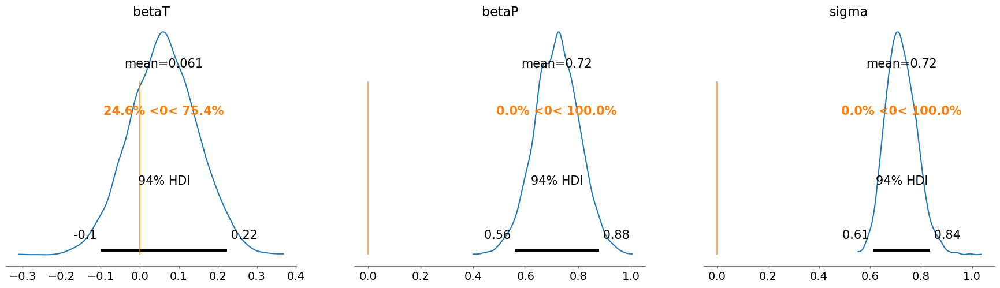

In [127]:
az.plot_posterior(whitetrace,ref_val=0)

array([<Axes: title={'center': 'betaT'}>,
       <Axes: title={'center': 'betaP'}>, <Axes: title={'center': 'rho'}>,
       <Axes: title={'center': 'sigma'}>], dtype=object)

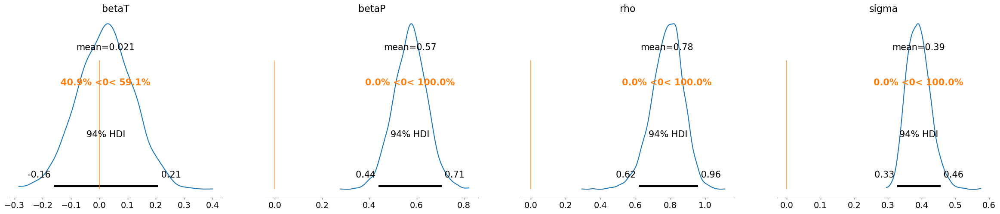

In [128]:
az.plot_posterior(AR1trace,ref_val=0,var_names=["betaT","betaP","rho","sigma"])

In [206]:
from statsmodels.tsa.stattools import acf
acf(train["T"])

array([ 1.        ,  0.09039926, -0.01253398,  0.08842522,  0.14769057,
        0.12975244,  0.18047824,  0.02731786, -0.05670581,  0.04176115,
        0.16882924, -0.09500493,  0.07605071, -0.05526173, -0.21333691,
       -0.06872726,  0.0811883 ])

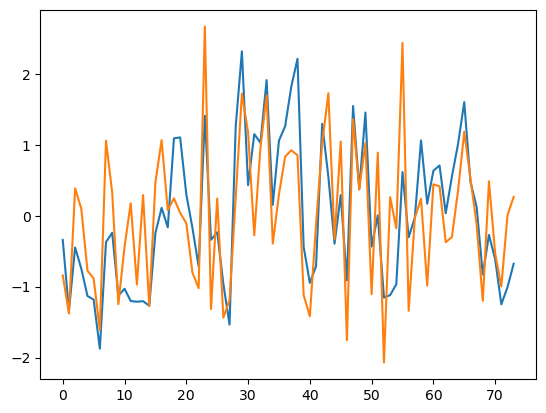

In [134]:
plt.plot(train["D"])
plt.plot(train["P"])

In [141]:
az.compare({"AR1":AR1trace,"Gauss":whitetrace})

/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/arviz/stats/stats.py:805: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/arviz/stats/stats.py:309: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'True' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  df_comp.loc[val] = (
/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/arviz/stats/stats.py:309: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
AR1,0,-58.297244,33.474642,0.000000,1.000000e+00,5.561920,0.000000,True,log
Gauss,1,-81.538708,2.161660,23.241464,4.128253e-12,4.754917,5.242961,False,log


In [278]:
class OBS_old():
    def __init__(self,data=None):
        if data is not None:
            self.data=data
        else:
            
            cru_t=xr.open_dataset("/Users/kmarvel/Documents/Reconstruction/DATA/cru_ts4.08.1901.2023.tmp.dat.nc")
            cru_p=xr.open_dataset("/Users/kmarvel/Documents/Reconstruction/DATA/cru_ts4.08.1901.2023.pre.dat.nc")
            cru_d=xr.open_dataset("/Users/kmarvel/Documents/Reconstruction/DATA/scPDSI.cru_ts4.08early1.1901.2023.cal_1901_23.bams.2024.GLOBAL.IGBP.WHC.1901.2023.nc")
    
            t_nada=cru_t.sel(lat=nada.lat,lon=nada.lon)
            p_nada=cru_p.sel(lat=nada.lat,lon=nada.lon)
            d_nada=cru_d.sel(latitude=nada.lat,longitude=nada.lon)
            seasonal_t=t_nada.resample(time='QS-DEC').mean('time').tmp.expand_dims({"variable":["T"]})
            seasonal_p=p_nada.resample(time='QS-DEC').mean('time').pre.expand_dims({"variable":["P"]})
            seasonal_d = d_nada.resample(time='QS-DEC').mean('time')
    
            seasonal_meteo=xr.concat([seasonal_t,seasonal_p],dim="variable")
            self.seasonal_meteo=seasonal_meteo
            jja_pdsi=seasonal_d.isel(time=np.arange(len(seasonal_d.time))[2::4])
            first_september=seasonal_meteo.groupby("time.month").groups[9][0]
            last_june=seasonal_meteo.groupby("time.month").groups[6][-1]
            truncated=seasonal_meteo.isel(time=slice(first_september,last_june+1))
            newyears=truncated.time.values[3::4]
            nvar,ntime,nlat,nlon=truncated.data.shape
            coorddict={key:truncated.coords[key].values for key in ["lat","lon","variable"]}
            coorddict["time"]=newyears
            TP_sept_to_aug=xr.DataArray(data=np.average(truncated.data.reshape(nvar,int(ntime/4),4,nlat,nlon),axis=2),\
                                                    dims=("variable","time","lat","lon"),
                                                    coords=coorddict)
    
            self.data=xr.concat([TP_sept_to_aug,jja_pdsi.scpdsi.expand_dims({"variable":["PDSI"]})],dim="variable")
    def get_z(self,training_period,test_period,detrend=True):

        data_train=self.data.sel(time=slice(*training_period))
        data_test=self.data.sel(time=slice(*test_period))
        if detrend:
            data_train=detrend_dim(data_train,dim="time")
            data_test=detrend_dim(data_test,dim="time")
    
        z_train=(data_train-data_train.mean(dim="time"))/data_train.std(dim="time")
        z_test=(data_test-data_train.mean(dim="time"))/data_train.std(dim="time")
        return z_train,z_test

In [279]:
#CRU=OBS()

In [280]:
cru_t=xr.open_dataset("/Users/kmarvel/Documents/Reconstruction/DATA/cru_ts4.08.1901.2023.tmp.dat.nc")
cru_p=xr.open_dataset("/Users/kmarvel/Documents/Reconstruction/DATA/cru_ts4.08.1901.2023.pre.dat.nc")
cru_d=xr.open_dataset("/Users/kmarvel/Documents/Reconstruction/DATA/scPDSI.cru_ts4.08early1.1901.2023.cal_1901_23.bams.2024.GLOBAL.IGBP.WHC.1901.2023.nc")
    

In [281]:
cru_p

<xarray.Dataset> Size: 8GB
Dimensions:  (lon: 720, lat: 360, time: 1476)
Coordinates:
  * lon      (lon) float32 3kB -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float32 1kB -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * time     (time) datetime64[ns] 12kB 1901-01-16 1901-02-15 ... 2023-12-16
Data variables:
    pre      (time, lat, lon) float32 2GB ...
    stn      (time, lat, lon) float64 3GB ...
    mae      (time, lat, lon) float32 2GB ...
    maea     (time, lat, lon) float32 2GB ...
Attributes:
    Conventions:  CF-1.4
    title:        CRU TS4.08 Precipitation
    institution:  Data held at British Atmospheric Data Centre, RAL, UK.
    source:       Run ID = 2406270035. Data generated from:pre.2406262226.dtb
    history:      Thu 27 Jun 03:50:41 BST 2024 : User f098 : Program makegrid...
    references:   Information on the data is available at http://badc.nerc.ac...
    comment:      Access to these data is available to any registered CEDA user.
    contact:      support@ceda.ac.uk

In [282]:
t_nada=cru_t.sel(lat=nada.lat,lon=nada.lon)
p_nada=cru_p.sel(lat=nada.lat,lon=nada.lon)
d_nada=cru_d.sel(latitude=nada.lat,longitude=nada.lon)

In [ ]:
seasonal_d = d_nada.resample(time='QS-DEC').mean('time')


# get rid of the first JJA because we won't have September-December the year before
jja_pdsi=seasonal_d.isel(time=np.arange(len(seasonal_d.time))[2::4]).isel(time=slice(1,None))

In [285]:
PDSI=jja_pdsi.scpdsi
#now, we need to get monthly T and P beginning in Sept the year before

In [286]:
years=[x.astype('M8[Y]').astype(int) + 1970 for x in PDSI.time.values]
months=["SEP","OCT","NOV","DEC","JAN","FEB","MAR","APR","MAY","JUN","JUL","AUG"]
firstyear=years[0]
lastyear=years[-1]
truncated=p_nada.pre.sel(time=slice(str(firstyear-1)+"-09-01",str(lastyear)+"-08-31"))
newcoords={}
newcoords["lon"]=truncated.coords["lon"]
newcoords["lat"]=truncated.coords["lat"]
newcoords["year"]=years
newcoords["month"]=months
ntime,nlat,nlon=truncated.values.shape
nyears=int(ntime/12)
reshaped_data=truncated.values.reshape(nyears,12,nlat,nlon)
PRECIP=xr.DataArray(data=reshaped_data,dims=("year","month","lat","lon"),coords=newcoords)

truncated=t_nada.tmp.sel(time=slice(str(firstyear-1)+"-09-01",str(lastyear)+"-08-31"))
newcoords={}
newcoords["lon"]=truncated.coords["lon"]
newcoords["lat"]=truncated.coords["lat"]
newcoords["year"]=years
newcoords["month"]=months
ntime,nlat,nlon=truncated.values.shape
nyears=int(ntime/12)
reshaped_data=truncated.values.reshape(nyears,12,nlat,nlon)
TEMP=xr.DataArray(data=reshaped_data,dims=("year","month","lat","lon"),coords=newcoords)



In [515]:
merged=xr.concat((TEMP.expand_dims({"meteo":["T"]}),PRECIP.expand_dims({"meteo":["P"]})),dim="meteo")
merged.meteo

<xarray.DataArray 'meteo' (meteo: 2)> Size: 16B
array(['T', 'P'], dtype=object)
Coordinates:
  * meteo    (meteo) object 16B 'T' 'P'

In [288]:
import copulas

In [516]:
annualmean=merged.mean(dim="month")
ens=[]
pdsi_ens=[]
for region in ["SJC","RMA","DCK"]:
    latitude,longitude=latlon(region)
    ens+=[annualmean.sel(lat=latitude,lon=longitude).expand_dims({"region":[region]})]
    pdsi_ens+=[PDSI.sel(lat=latitude,lon=longitude).expand_dims({"region":[region]})]
regional_annual=xr.concat(ens,dim="region")
pdsi_annual=xr.concat(pdsi_ens,dim="region")

In [517]:
regional_stacked=regional_annual.stack(Mr=("region","meteo"))

In [302]:
from copulas.multivariate import GaussianMultivariate

copula = GaussianMultivariate()
#data=regional_annual.stack(Mr=("region","variable")).values
data=pd.DataFrame(data,columns=regional_stacked.Mr.values)
copula.fit(data)

/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/scipy/stats/_continuous_distns.py:718: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/scipy/stats/_continuous_distns.py:6338: RuntimeWarning: divide by zero encountered in divide
  return c**2 / (c**2 - n**2)
/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/scipy/stats/_continuous_distns.py:6338: RuntimeWarning: divide by zero encountered in divide
  return c**2 / (c**2 - n**2)
/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/scipy/stats/_continuous_distns.py:6338: RuntimeWarning: divide by zero encountered in divide
  return c**2 / (c**2 - n**2)
/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/scipy/stats/_continuous_distns.py:718: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / 

In [303]:
# sample from the copula
synthetic_data = copula.sample(num_rows=1000)

In [347]:
import scipy.stats as  stats
mykde=stats.gaussian_kde(synthetic_data.values.T)
mykde(regional_stacked.isel(year=[0,1,2]).values.T)

array([1.67934913e-06, 1.65423620e-06, 1.32388330e-06])

TypeError: unsupported operand type(s) for -: 'list' and 'list'

In [374]:
valuemins=regional_stacked.min(dim="year")
valuemaxes=regional_stacked.max(dim="year")
#create grid lattice
vmin=np.floor(2*valuemins)
vmax=np.ceil(2*valuemaxes)
latticepoints=np.stack([np.linspace(x[0],x[1],100) for x in np.vstack([vmin,vmax]).T])
pdf_points=mykde(latticepoints)

<Axes: xlabel='P', ylabel='Probability'>

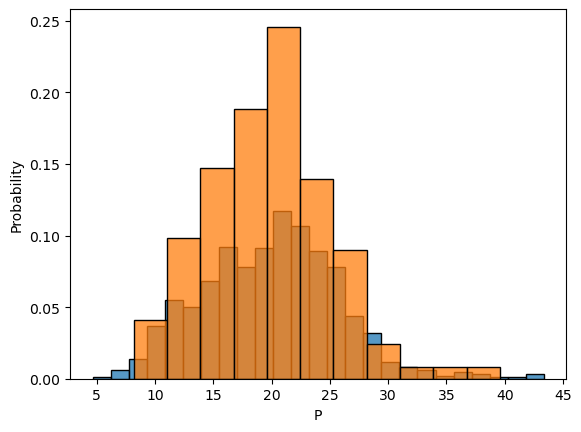

In [319]:
region="RMA"
variable="P"
sns.histplot(synthetic_data[region][variable],stat="probability")
sns.histplot(regional_annual.sel(region=region,variable=variable),stat="probability")

In [323]:
copula_params = copula.to_dict()
copula_params.keys()
[c["type"] for c in copula_params["univariates"]]

['copulas.univariate.gaussian_kde.GaussianKDE',
 'copulas.univariate.gaussian_kde.GaussianKDE',
 'copulas.univariate.gaussian_kde.GaussianKDE',
 'copulas.univariate.gaussian_kde.GaussianKDE',
 'copulas.univariate.log_laplace.LogLaplace',
 'copulas.univariate.student_t.StudentTUnivariate']

In [329]:
copula_params["columns"]

[('SJC', 'T'),
 ('SJC', 'P'),
 ('RMA', 'T'),
 ('RMA', 'P'),
 ('DCK', 'T'),
 ('DCK', 'P')]

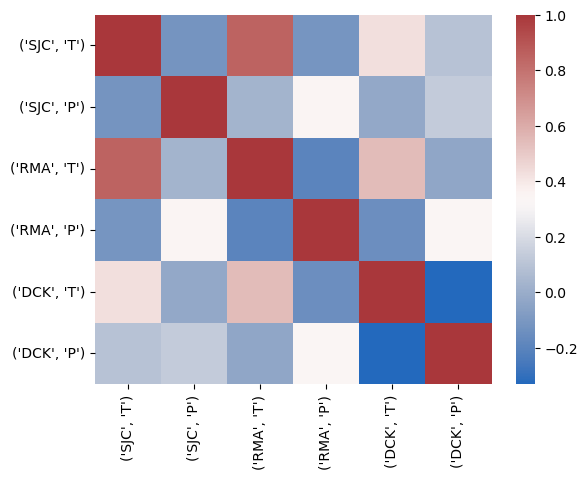

In [334]:
sns.heatmap(copula_params["correlation"],cmap="vlag")
tmp=plt.xticks(0.5+np.arange(6),copula_params["columns"],rotation=90)
tmp=plt.yticks(0.5+np.arange(6),copula_params["columns"],rotation=0)

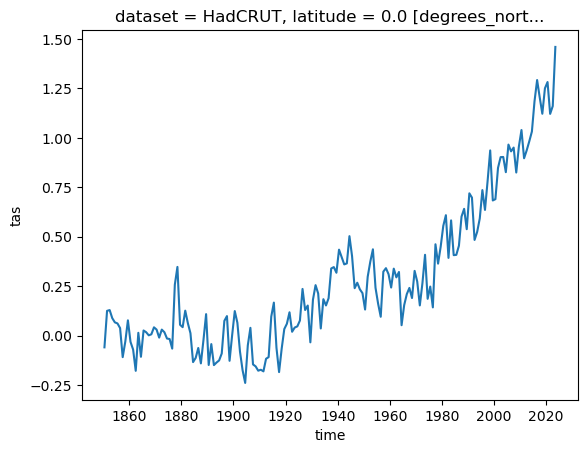

In [408]:
# learn the correlation 
hadunc=xr.open_dataset("/Users/kmarvel/Documents/GEDA_BAYES/DATA/OBS/HadCRUT.5.0.2.0.analysis.ensemble_series.global.annual.nc")
hadcrut_ensemble=hadunc.sel(time=slice("1850-1-1","2023-12-31")).tas
#hadcrut_ensemble["time"]=recent.time
baseline=hadcrut_ensemble.sel(time=slice("1850-1-1","1900-1-1")).mean(dim="time")
hadcrut_ensemble=hadcrut_ensemble-baseline

hadcrut_ensemble=hadcrut_ensemble.expand_dims({"dataset":["HadCRUT"]})
hadcrut_ensemble.mean(dim="realization").plot()

In [530]:
startyear=1950
stopyear=2023
T=hadcrut_ensemble.mean(dim="realization")
T=T.sel(time=slice(str(startyear)+'-1-1',str(stopyear)+"-12-31"))
#pdsi_annual=pdsi_annual.rename({"time":"year"})


ValueError: cannot add coordinates with new dimensions to a DataArray

In [ ]:

clim=regional_stacked.sel(year=slice("1950","1979")).mean(dim="year")
sigma=regional_stacked.sel(year=slice("1950","1979")).std(dim="year")
Z=(regional_stacked-clim)/sigma
Ztrain=Z.sel(year=slice(startyear,stopyear))
Ztest=Z.sel(year=slice(1902,startyear))


climpdsi=pdsi_annual.sel(year=slice("1950","1979")).mean(dim="year")
sigmapdsi=pdsi_annual.sel(year=slice("1950","1979")).std(dim="year")
Zpdsi=(pdsi_annual-climpdsi)/sigmapdsi
Ztrain_pdsi=Zpdsi.sel(year=slice(startyear,stopyear))
Ztest_pdsi=Zpdsi.sel(year=slice(1902,startyear))



In [477]:
# now learn the internal variability covariance matrix
coords={"time":regional_stacked.year.values,\
        "region_variable":regional_stacked.Mr.values,\
       "cross_region_variable":regional_stacked.Mr.values}
with pm.Model(coords=coords) as trend_and_internal_variability:
    fingerprint=pm.Normal("trend",0,1,dims=("region_variable"))
     
   
        

    # Stack autoregressive terms and add intercepts
   
  
    forced_response = pm.Deterministic("forced_response",\
                                       pm.math.stack([T.values.ravel()*fingerprint[i] for i in range(len(coords["region_variable"]))],\
                                                     axis=-1),dims=("time", "region_variable"))



   
   
     #now take into account spatial covariance
    sigmaDist = pm.Exponential.dist(1.0)
    chol,_,_ = pm.LKJCholeskyCov('chol', eta=4, n=len(coords["region_variable"]),\
                                           sd_dist=sigmaDist,compute_corr=True)
    #chol = pm.expand_packed_triangular(len(coords["region"]), packed_chol, lower=True)
    cov = pm.Deterministic('cov', chol.dot(chol.T),dims=("region_variable","cross_region_variable"))
    obs = pm.MvNormal("obs_pi", mu=forced_response, chol=chol, observed=Ztrain.values, dims=("time", "region_variable"))
    #obs_recent = pm.MvNormal("obs_recent",mu=mean_recent,chol=chol,observed=recent[maxlags:],dims=("time_recent","region"))
    map=pm.find_MAP()
    
    


In [526]:
Ztrain.unstack()

<xarray.DataArray (year: 74, region: 3, variable: 2)> Size: 2kB
array([[[ 0.09644447, -0.4367487 ],
        [-0.26494768, -0.6406851 ],
        [-0.44171223,  0.26860136]],

       [[ 1.2187148 ,  1.1041543 ],
        [ 0.79159325, -1.179565  ],
        [-0.77399194,  1.5255713 ]],

       [[-1.7447761 ,  1.6570286 ],
        [-1.3214942 ,  0.5940025 ],
        [ 0.12981014, -0.56436694]],

       [[-0.640044  , -0.12283353],
        [ 0.15766908,  0.30531636],
        [ 0.7943726 , -1.5506977 ]],

       [[ 0.83293396, -0.4548594 ],
        [ 1.5718116 , -0.5711041 ],
        [ 2.336152  , -1.4835391 ]],

...

       [[ 3.2528255 ,  0.7157839 ],
        [ 1.3930107 ,  0.6946715 ],
        [-0.13601302,  1.8242778 ]],

       [[ 3.9542425 , -0.9745306 ],
        [ 3.0672271 , -0.32535094],
        [ 2.0038693 , -0.53529805]],

       [[ 4.603056  , -1.4443978 ],
        [ 3.0509748 , -0.79613096],
        [ 1.1931089 , -0.31678176]],

       [[ 3.9367085 , -0.77481204],
        [ 3.1972632 ,  0.21352878],
        [ 3.053877  , -1.0445018 ]],

       [[ 2.0779505 ,  2.0700486 ],
        [ 1.6693372 ,  0.4740863 ],
        [ 1.1665254 , -0.14036481]]], dtype=float32)
Coordinates:
  * region    (region) object 24B 'SJC' 'RMA' 'DCK'
  * variable  (variable) object 16B 'T' 'P'
    lon       (region, variable) float32 24B -119.2 -119.2 ... -100.2 -100.2
    lat       (region, variable) float32 24B 38.25 38.25 37.25 37.25 37.75 37.75
  * year      (year) int64 592B 1950 1951 1952 1953 1954 ... 2020 2021 2022 2023

In [528]:
coords={"train_time":Ztrain.year.values,\
        "region_variable":regional_stacked.Mr.values,\
       "cross_region_variable":regional_stacked.Mr.values,
       "region":regional_annual.region.values,\
       "meteo":regional_annual.meteo.values}
with pm.Model(coords=coords) as reconstruct_annual_model:
    chol=map["chol"]
    beta={}
    mu={}
    training_pdsi={}
    sigma={}
    for region in coords["region"]:
        beta[region]=pm.Normal("beta_"+region,0,1,dims=("meteo"))
        sigma[region]=pm.HalfNormal("sigma_"+region,1,dims=("meteo"))
        mu[region]=beta[region][0]*Ztrain.unstack().sel(region=region,meteo="T").values+\
        beta[region][1]*Ztrain.unstack().sel(region=region,meteo="P").values
        training_pdsi[region]=pm.Normal("obs_"+region,mu=mu[region],sigma=sigma[region],\
                                        observed=Ztrain_pdsi.sel(region=region).values)
    trace=pm.sample()
        # learn betas from 
        
        
    
    
    

KeyError: "'meteo' is not a valid dimension or coordinate for Dataset with dimensions FrozenMappingWarningOnValuesAccess({'region': 3, 'variable': 2, 'year': 74})"

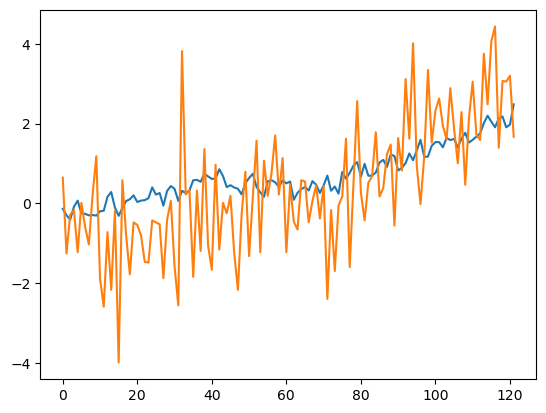

In [473]:
plt.plot(map["trend"][2]*T.values.ravel())
plt.plot(Z.isel(Mr=2).values)

In [532]:
# Global mean temperature in the current and preceding year
df=pd.read_csv("../DATA/gistemp_GLB_Ts_dSST.csv",header=1)
year=df["Year"].values
thisyearmonths=["Jan","Feb","Mar","Apr","May","Jun","Jul","Aug"]
lastyearmonths=["Sep","Oct","Nov","Dec"]
df["Year"].iloc[:-1]
L=df[lastyearmonths].iloc[:-1]
T=df[thisyearmonths].iloc[1:]
L.values.shape
Tglob=xr.DataArray(data=np.average(np.array(np.append(L.values,T.values,axis=-1),dtype=float),axis=-1),\
coords={"year":df["Year"].iloc[1:]})
df

,Year,Jan,Feb,Mar,Apr,May,Jun,Jul,Aug,Sep,Oct,Nov,Dec,J-D,D-N,DJF,MAM,JJA,SON
0,1880,-0.20,-0.25,-0.09,-0.16,-0.09,-0.22,-0.19,-0.09,-0.15,-0.22,-0.22,-.19,-.17,***,***,-0.11,-0.17,-0.20
1,1881,-0.20,-0.15,0.02,0.04,0.07,-0.19,0.01,-0.04,-0.16,-0.22,-0.18,-.07,-.09,-.10,-.18,0.05,-0.07,-0.19
2,1882,0.16,0.14,0.05,-0.16,-0.13,-0.22,-0.16,-0.07,-0.14,-0.23,-0.17,-.36,-.11,-.08,.07,-0.08,-0.15,-0.18
3,1883,-0.29,-0.36,-0.12,-0.18,-0.18,-0.07,-0.07,-0.14,-0.22,-0.11,-0.24,-.11,-.18,-.20,-.34,-0.16,-0.09,-0.19
4,1884,-0.13,-0.08,-0.36,-0.40,-0.33,-0.35,-0.31,-0.28,-0.27,-0.25,-0.33,-.31,-.28,-.27,-.11,-0.37,-0.31,-0.28
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
140,2020,1.17,1.24,1.18,1.12,0.99,0.91,0.89,0.86,0.96,0.87,1.09,.79,1.00,1.03,1.17,1.10,0.88,0.97
141,2021,0.81,0.64,0.89,0.75,0.79,0.84,0.91,0.81,0.92,0.98,0.92,.87,.84,.84,.75,0.81,0.85,0.94
142,2022,0.91,0.89,1.04,0.83,0.84,0.92,0.94,0.94,0.88,0.96,0.73,.80,.89,.90,.89,0.91,0.93,0.86
143,2023,0.88,0.97,1.23,0.99,0.94,1.08,1.19,1.19,1.48,1.34,1.41,1.35,1.17,1.12,.88,1.05,1.15,1.41


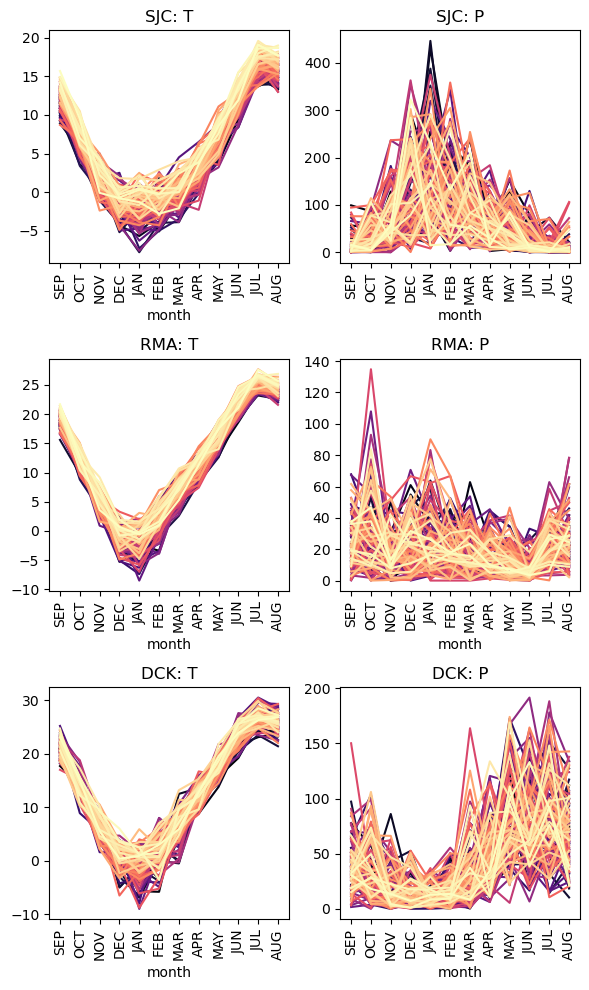

In [15]:
plt.figure(figsize=(6,10))
i=1
for location in ["SJC","RMA","DCK"]:
    plt.subplot(3,2,i)
    latitude,longitude =latlon(location)
    tmp=[TEMP.sel(lat=latitude,lon=longitude).sel(year=y).\
         plot(color=cm.magma((y-years[0])/(years[-1]-years[0]))) for y in years]
    plt.title(location+": T")
    plt.xticks(rotation=90)
    i+=1
    plt.subplot(3,2,i)
    tmp=[PRECIP.sel(lat=latitude,lon=longitude).sel(year=y).\
         plot(color=cm.magma((y-years[0])/(years[-1]-years[0]))) for y in years]
    plt.title(location+": P")
    plt.xticks(rotation=90)
    i+=1
plt.tight_layout()    

In [132]:
# learn the relationship 
location="SJC"
latitude,longitude =latlon(location)
T=TEMP.sel(lat=latitude,lon=longitude)
Tclim=T.sel(year=slice(1901,1950)).mean(dim="year")
Tstd=T.sel(year=slice(1901,1950)).std(dim="year")
Tz=(T-Tclim)/Tstd

P=PRECIP.sel(lat=latitude,lon=longitude)
Pclim=P.sel(year=slice(1901,1950)).mean(dim="year")
Pstd=P.sel(year=slice(1901,1950)).std(dim="year")
Pz=(P-Pclim)/Pstd

D=PDSI.sel(lat=latitude,lon=longitude)
Dclim=D.sel(time=slice("1902-6-1","2024-6-1")).mean(dim="time")
Dstd=D.sel(time=slice("1902-6-1","2024-6-1")).std(dim="time")
Dintermediate=(D-Dclim)/Dstd
Dz=xr.DataArray(data=Dintermediate.values,dims=("year"),coords={"year":convert_timeaxis_years(Dintermediate.time)})

#now need to split into test and training
training_period=(1950,2023)
test_period=(1902,1949)
train={}
train["T"]=Tz.sel(year=slice(*training_period))
train["P"]=Pz.sel(year=slice(*training_period))
train["D"]=Dz.sel(year=slice(*training_period))
test={}
test["T"]=Tz.sel(year=slice(*test_period))
test["P"]=Pz.sel(year=slice(*test_period))
test["D"]=Dz.sel(year=slice(*test_period))

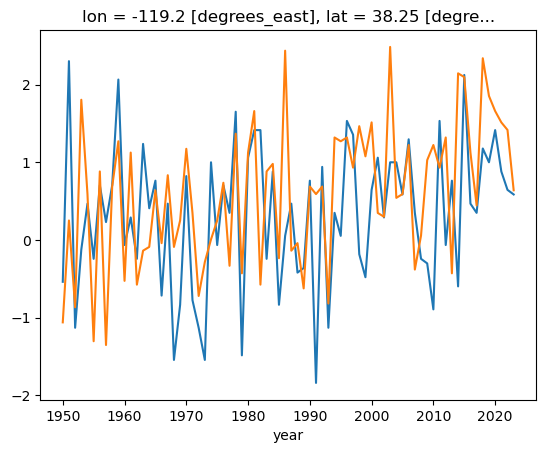

In [21]:
train["T"].sel(month="DEC").plot()
train["T"].sel(month="JAN").plot()

In [33]:
hadunc=xr.open_dataset("/Users/kmarvel/Documents/GEDA_BAYES/DATA/OBS/HadCRUT.5.0.2.0.analysis.ensemble_series.global.annual.nc")
hadcrut_ensemble=hadunc.sel(time=slice("1850-1-1","2020-12-31")).tas
hadcrut_ensemble["time"]=np.arange(1850,2021)
baseline=hadcrut_ensemble.sel(time=slice(1850,1900)).mean(dim="time")
hadcrut_ensemble=hadcrut_ensemble-baseline

#hadcrut_ensemble=hadcrut_ensemble.expand_dims({"dataset":["HadCRUT"]})


array([('T', 'SEP'), ('T', 'OCT'), ('T', 'NOV'), ('T', 'DEC'),
       ('T', 'JAN'), ('T', 'FEB'), ('T', 'MAR'), ('T', 'APR'),
       ('T', 'MAY'), ('T', 'JUN'), ('T', 'JUL'), ('T', 'AUG'),
       ('P', 'SEP'), ('P', 'OCT'), ('P', 'NOV'), ('P', 'DEC'),
       ('P', 'JAN'), ('P', 'FEB'), ('P', 'MAR'), ('P', 'APR'),
       ('P', 'MAY'), ('P', 'JUN'), ('P', 'JUL'), ('P', 'AUG')],
      dtype=object)

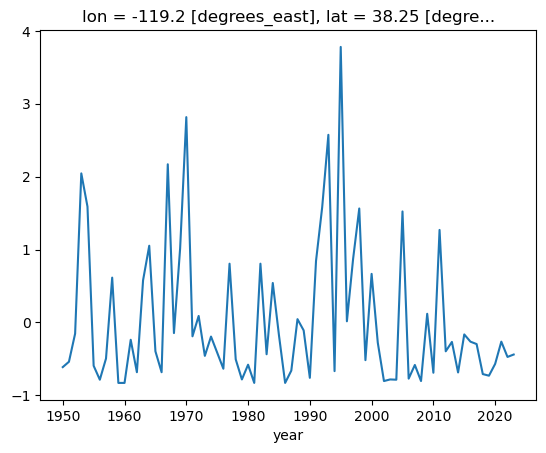

In [153]:
# Learn a prior?
train["P"].sel(month="JUN").plot()
Tex=train["T"].expand_dims({"variable":["T"]})
Pex=train["P"].expand_dims({"variable":["P"]})
M=xr.concat((Tex,Pex),dim="variable")
# assume a forced response
Ms=M.stack(monthlyvar=("variable","month"))
# for any given month, T and P 
Tglob.sel(year=Ms.year)
Ms.monthlyvar.values

In [164]:
fingerprint=np.random.normal(0,1,len(coords["monthlyvar"]))
fingerprint.shape
Tglob.sel(year=Ms.year).shape
np.stack([Tglob.sel(year=Ms.year)*fingerprint[i] for i in range(len(coords["monthlyvar"]))],\
                                                     axis=-1).shape

(74, 24)

In [168]:
coords={"year":Ms.year.values,\
        "monthlyvar":Ms.monthlyvar.values}
with pm.Model(coords=coords) as Mmodel:
    fingerprint=pm.Normal("F",mu=0,sigma=1,dims=("monthlyvar"))
    sigmaDist = pm.Exponential.dist(1.0)
    chol,_,_ = pm.LKJCholeskyCov('L', eta=4, n=len(coords["monthlyvar"]),\
                                sd_dist=sigmaDist,compute_corr=True)
           
    cov = pm.Deterministic('cov', chol.dot(chol.T))
    
    forced_response = pm.Deterministic("forced_response",\
                                       pm.math.stack([Tglob.sel(year=Ms.year).values*fingerprint[i] \
                                                      for i in range(len(coords["monthlyvar"]))],\
                                                     axis=-1),dims=("year", "monthlyvar"))
    training_obs=pm.MvNormal("obs",mu=forced_response,chol=chol,observed=Ms.values)
with Mmodel:
    map=pm.find_MAP()

In [178]:
coords["monthlyvar"]
labs=[x[0]+" "+x[1] for x in coords["monthlyvar"]]

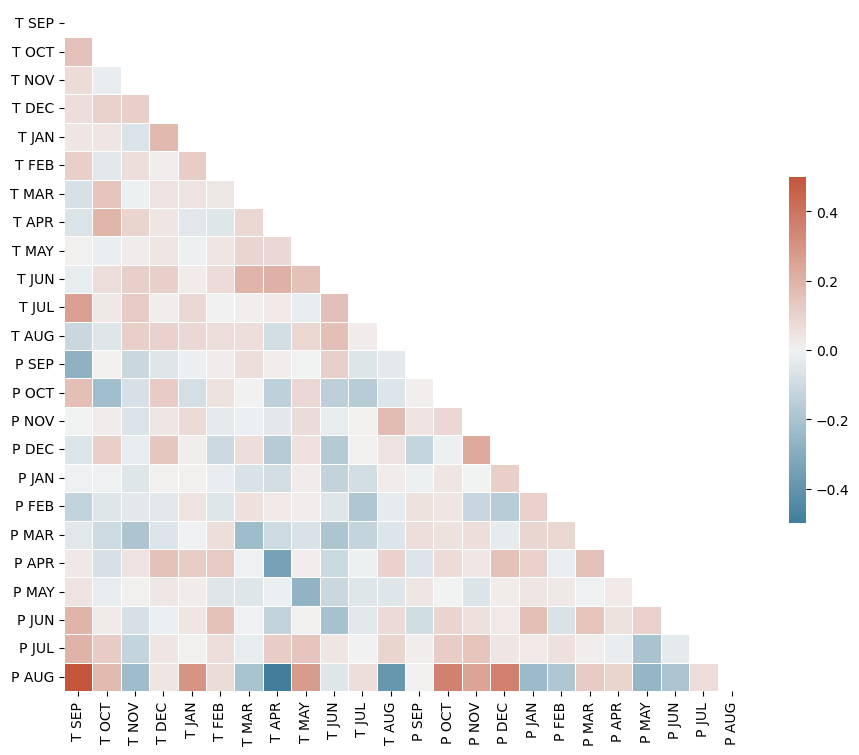

In [180]:
Mcov=map["cov"]
mask = np.triu(np.ones_like(Mcov, dtype=bool))

# Set up the matplotlib figure
f=plt.figure(figsize=(11, 9))
ax=f.add_subplot(111)
#f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(Mcov, mask=mask, cmap=cmap, vmax=.5,vmin=-.5, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})
tmp=plt.xticks(np.arange(24)+.5,labs,rotation=90)
tmp=plt.yticks(np.arange(24)+.5,labs,rotation=0)

<xarray.DataArray ()> Size: 4B
array(0.09335382, dtype=float32)
Coordinates:
    lon      float32 4B -119.2
    lat      float32 4B 38.25

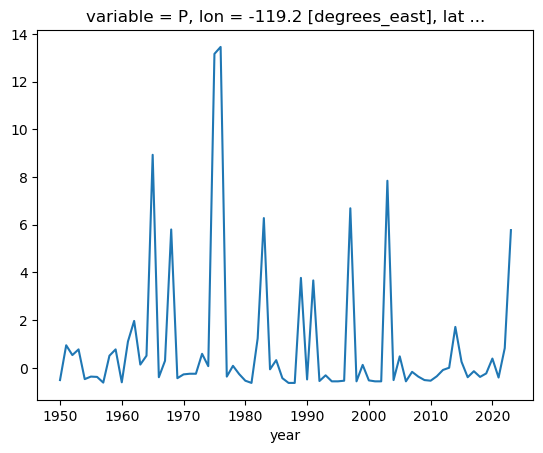

In [186]:
#M.sel(variable="T",month="SEP").plot()
M.sel(variable="P",month="AUG").plot()
xr.corr(M.sel(variable="T",month="SEP"),M.sel(variable="P",month="AUG"))

In [187]:
M.sel(variable="P",month="AUG").std()

<xarray.DataArray ()> Size: 4B
array(2.914835, dtype=float32)
Coordinates:
    variable  <U1 4B 'P'
    lon       float32 4B -119.2
    lat       float32 4B 38.25
    month     <U3 12B 'AUG'

# Compare posteriors when we train with early period (1902-1949) or later period (1950-2023)

In [164]:
coords={"month":P.month.values,\
             "year":P.year.values,\
            "variable":["T","P"]}
# We want to be sure we take the autogregression into account
with pm.Model(coords=coords) as linearmodel:
    beta=pm.Normal("beta",0,1,dims=("variable","month"))
    T_component=pm.math.sum([beta[0,i]*train["T"].sel(month=coords["month"][i]).values for i in range(12)],axis=0)
    P_component=pm.math.sum([beta[1,i]*train["P"].sel(month=coords["month"][i]).values for i in range(12)],axis=0)
    sigma=pm.HalfNormal("sigma",1)
    obs=pm.Normal("obs",mu=T_component+P_component,sigma=sigma,observed=train["D"])
    
    latetrace=pm.sample()
      

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [beta, sigma]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 4 seconds.


In [165]:
coords={"month":P.month.values,\
             "year":P.year.values,\
            "variable":["T","P"]}
# We want to be sure we take the autogregression into account
with pm.Model(coords=coords) as linearmodel:
    beta=pm.Normal("beta",0,1,dims=("variable","month"))
    T_component=pm.math.sum([beta[0,i]*test["T"].sel(month=coords["month"][i]).values for i in range(12)],axis=0)
    P_component=pm.math.sum([beta[1,i]*test["P"].sel(month=coords["month"][i]).values for i in range(12)],axis=0)
    sigma=pm.HalfNormal("sigma",1)
    obs=pm.Normal("obs",mu=T_component+P_component,sigma=sigma,observed=test["D"])
    
    earlytrace=pm.sample()


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [beta, sigma]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 3 seconds.


# Where are the posteriors different?
* January temperature: later in the record has more positive relationship (but P dependence is stronger in early record- is it just a question of partitioning?
* March temperature: earlier has more negative relationship.  Not explained by P differences
* Both are negative in June, early in record is more negative?
* later in record is more negative in Jul- is this because it's correlated with June?
* Neither have dependence in August?
* Precipitation in June: later is positive, earlier is negative.  Is this just because there's not a lot of precipitation in June?

AUG


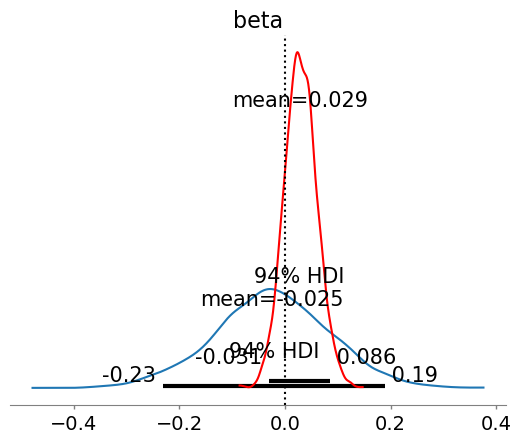

In [200]:
ax=plt.subplot(111)
month=months[11]
print(month)
variable="P"
az.plot_posterior(earlytrace.posterior.beta.sel(month=month,variable=variable),ax=ax)
az.plot_posterior(latetrace.posterior.beta.sel(month=month,variable=variable),ax=ax,color="r")
ax.axvline(0,c="k",ls=":")

# Bayesian inverse modeling
If $D \in \mathbb{R}$ is the PDSI value at time $t$ and $M=[T,P]^T \in \mathbb{R}^2$ represents the temperature and precipitation at time $t$, we want to recover $M$ from observations of $D$.

The forward model is 
$$M \rightarrow A M$$
where we assume a simple linear relationship

\begin{equation}
A = \begin{pmatrix}
\beta_T & 0 \\
0 & \beta_P
\end{pmatrix}
\end{equation}

The inverse problem is ill-posed
$$ M_{LS} = ||\arg \min_{M} D-A^{-1}M||$$
Why?  It's underdetermined (we have one measurement of D and need T and P).  And the solution is highly sensitive to measurement noise.


## The solution:
We want to know $P(M'|D',M,D)$, where $M'$ and $D'$ are test data and $M$ and $D$ are training data.

 Bayes' Theorem:
 $$P(M|D) = \frac{P(D|M) P(M)}{P(D)}$$

 We know $$P(D|M) \propto \exp \left( \frac{(D-AM)^2)}{\sigma^2}\right)$$
Now we can regularize this by putting priors on $M$.

We know that $M \sim MN(0,\Sigma_T)M \sim MN(0, \Sigma_P)$

In [1]:
nada

NameError: name 'nada' is not defined

In [ ]:
#Can we directly learn the prior?


In [373]:
Dnada=nada.pdsi.sel(lat=latitude,lon=longitude)
Dnadaclim=Dnada.sel(time=slice(1902,1949)).mean(dim="time")
Dnadastd=Dnada.sel(time=slice(1902,1949)).std(dim="time")
Dnadaintermediate=(Dnada-Dnadaclim)/Dnadastd
Dnadaz=xr.DataArray(data=Dnadaintermediate.values,dims=("year"),coords={"year":Dnadaintermediate.time.values})
Dnadaz.dropna(dim="year").year

<xarray.DataArray 'year' (year: 1796)> Size: 14kB
array([ 210.,  211.,  212., ..., 2003., 2004., 2005.])
Coordinates:
  * year     (year) float64 14kB 210.0 211.0 212.0 ... 2.004e+03 2.005e+03

In [514]:
labs=[x[0]+" "+x[1] for x in stacked.monthly_variable.values]

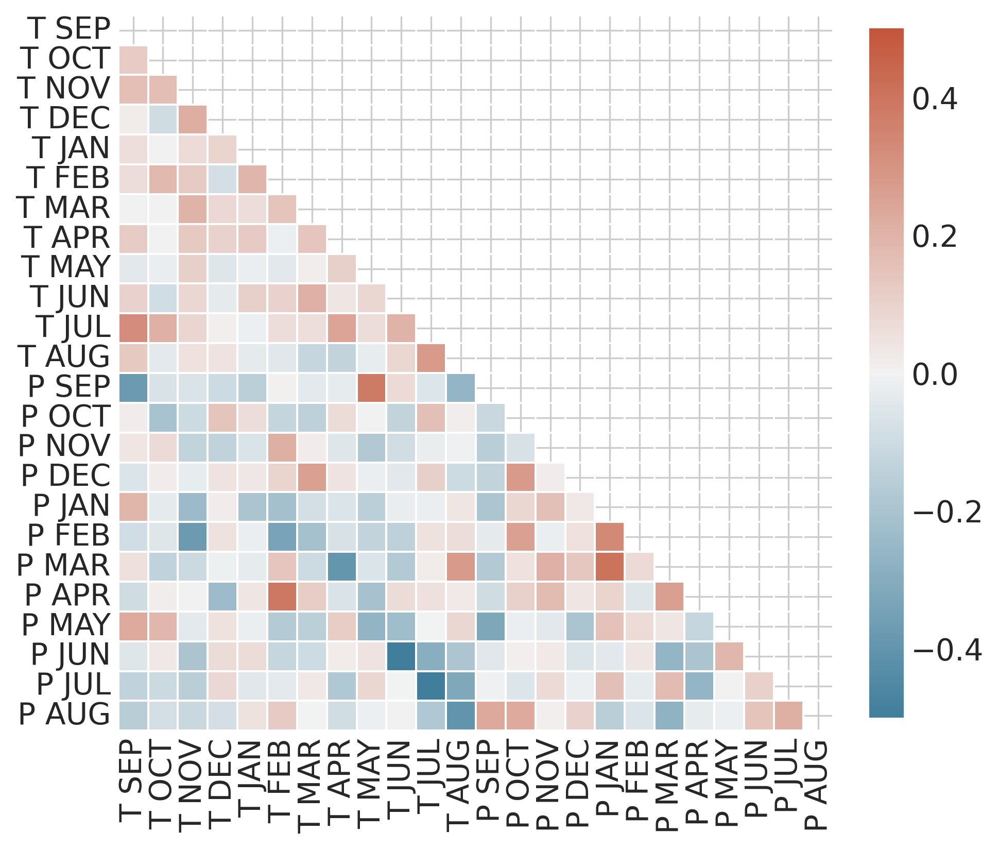

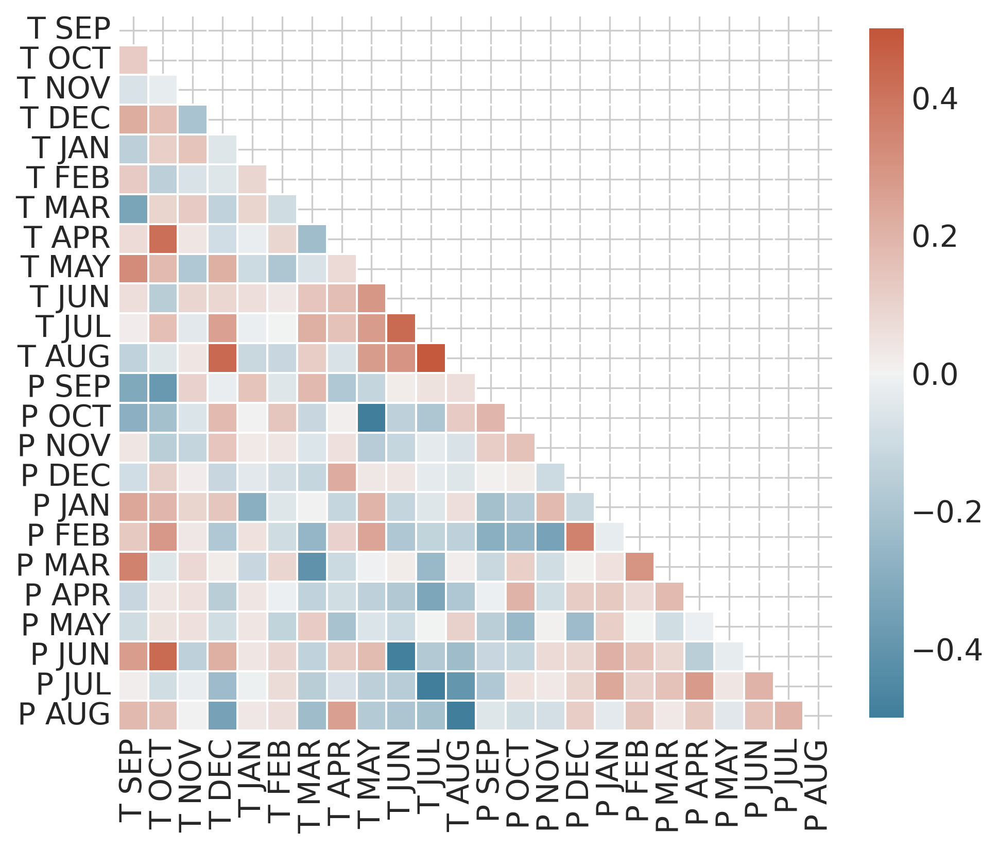

In [536]:
import seaborn as sns
self=Kansas_paleo
Tex=self.train["T"].expand_dims({"variable":["T"]})
Pex=self.train["P"].expand_dims({"variable":["P"]})
M=xr.concat([Tex,Pex],dim="variable")
stacked=M.stack(monthly_variable=("variable","month"))
#corr=np.dot(stacked.values.T,stacked.values)
Mcov=np.cov(stacked.values.T)
mask = np.triu(np.ones_like(Mcov, dtype=bool))

# Set up the matplotlib figure
f=plt.figure(figsize=(11, 9))
ax=f.add_subplot(121)
#f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(Mcov, mask=mask, cmap=cmap, vmax=.5,vmin=-.5, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})
tmp=plt.xticks(np.arange(24)+.5,labs,rotation=90)
tmp=plt.yticks(np.arange(24)+.5,labs,rotation=0)
#AGAIN WITH TEST
Tex=self.test["T"].expand_dims({"variable":["T"]})
Pex=self.test["P"].expand_dims({"variable":["P"]})
M=xr.concat([Tex,Pex],dim="variable")
stacked=M.stack(monthly_variable=("variable","month"))
#corr=np.dot(stacked.values.T,stacked.values)
Mcov_test=np.cov(stacked.values.T)
mask = np.triu(np.ones_like(Mcov, dtype=bool))

# Set up the matplotlib figure
f=plt.figure(figsize=(11, 9))
ax=f.add_subplot(122)
#f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(Mcov_test, mask=mask, cmap=cmap, vmax=.5,vmin=-.5, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})
tmp=plt.xticks(np.arange(24)+.5,labs,rotation=90)
tmp=plt.yticks(np.arange(24)+.5,labs,rotation=0)

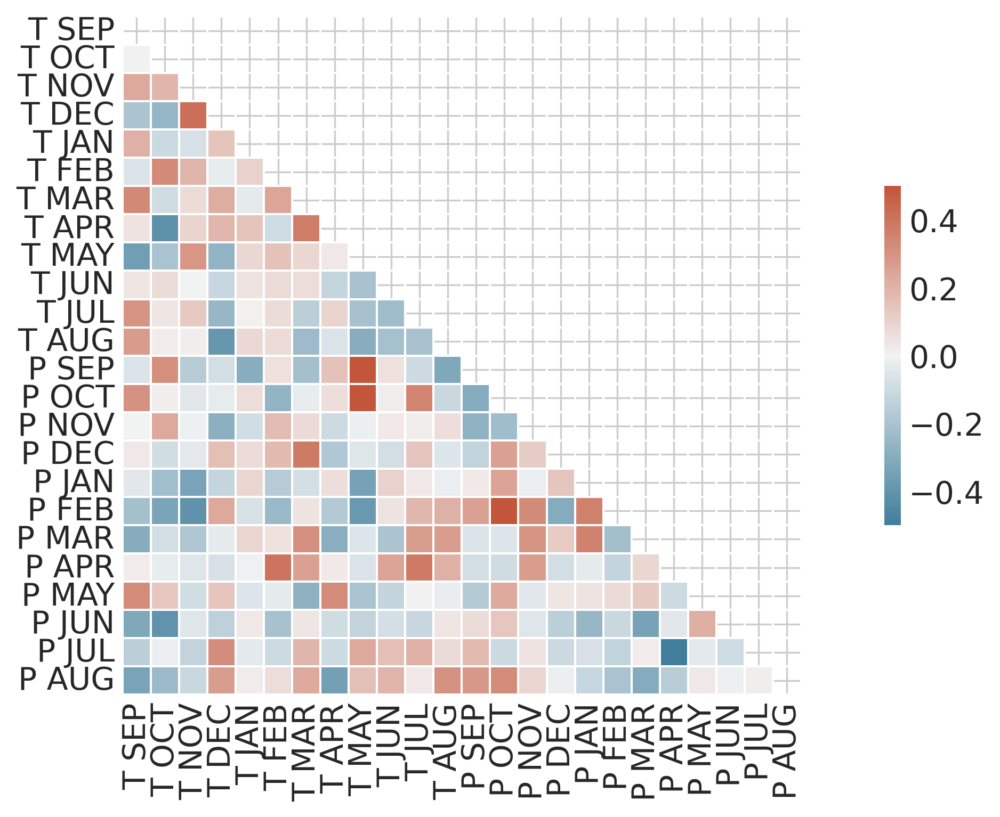

In [539]:
sns.heatmap(Mcov-Mcov_test,mask=mask,cmap=cmap, vmax=.5,vmin=-.5, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})
tmp=plt.xticks(np.arange(24)+.5,labs,rotation=90)
tmp=plt.yticks(np.arange(24)+.5,labs,rotation=0)

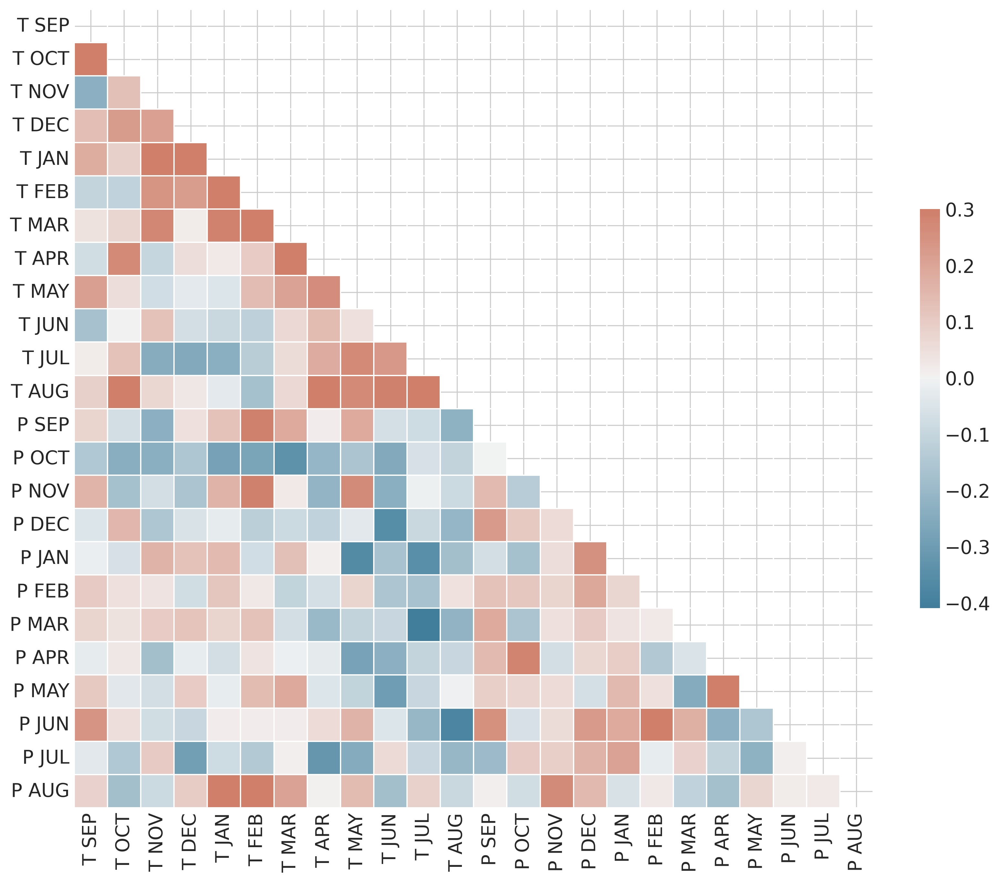

In [526]:
import seaborn as sns
self=Mesa_paleo
Tex=self.test["T"].expand_dims({"variable":["T"]})
Pex=self.test["P"].expand_dims({"variable":["P"]})
M=xr.concat([Tex,Pex],dim="variable")
stacked=M.stack(monthly_variable=("variable","month"))
#corr=np.dot(stacked.values.T,stacked.values)
Mcov=np.cov(stacked.values.T)
mask = np.triu(np.ones_like(Mcov, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(Mcov, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})
tmp=plt.xticks(np.arange(24)+.5,labs,rotation=90)
tmp=plt.yticks(np.arange(24)+.5,labs,rotation=0)

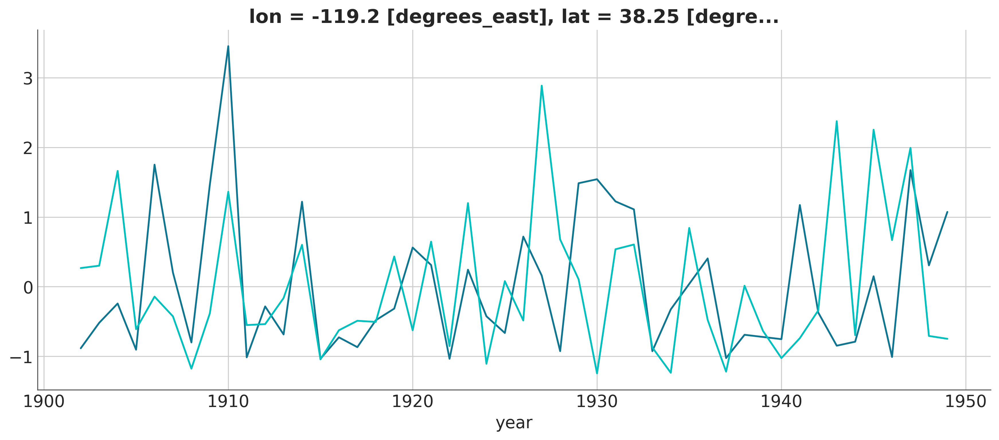

In [525]:
Kansas_paleo.test["P"].sel(month="NOV").plot()
Sonora_paleo.test["P"].sel(month="NOV").plot()

# TO DO
1) Figure out how to calculate the 24x24 covariance matrix from the data.
2) define the prior as an MvNormal with size test_year and cov= 24x24 matrix (or Cholesky decomposition)
3) Reshape the prior and add coordinates
4) 

In [554]:
with pm.Model() as testmod:
    test=pm.MvNormal("test_meteorology",cov=np.identity(24),size=(100))
    newvar=test.reshape((100,12,2))
    testtrace=pm.sample(10)


Only 10 samples in chain.
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [test_meteorology]


Sampling 4 chains for 1_000 tune and 10 draw iterations (4_000 + 40 draws total) took 6 seconds.
The number of samples is too small to check convergence reliably.


In [551]:
testtrace.posterior.test_meteorology.shape

(4, 10, 100, 24)

In [431]:
class Learner():
    def __init__(self,\
                 location,\
                 training_period=(1950,2005),\
                test_period=(1902,1949)):
        
        latitude,longitude =latlon(location)
        self.name=fullname(location)
        self.latitude=latitude
        self.longitude=longitude
        T=TEMP.sel(lat=latitude,lon=longitude)
        Tclim=T.sel(year=slice(1901,1950)).mean(dim="year")
        Tstd=T.sel(year=slice(1901,1950)).std(dim="year")
        Tz=(T-Tclim)/Tstd
        
        P=PRECIP.sel(lat=latitude,lon=longitude)
        Pclim=P.sel(year=slice(1901,1950)).mean(dim="year")
        Pstd=P.sel(year=slice(1901,1950)).std(dim="year")
        Pz=(P-Pclim)/Pstd
        
        
        D=PDSI.sel(lat=latitude,lon=longitude)
        Dclim=D.sel(time=slice("1902-6-1","1950-6-1")).mean(dim="time")
        Dstd=D.sel(time=slice("1902-6-1","1950-6-1")).std(dim="time")
        Dintermediate=(D-Dclim)/Dstd
        Dz=xr.DataArray(data=Dintermediate.values,dims=("year"),coords={"year":convert_timeaxis_years(Dintermediate.time)})

        Dnada=nada.pdsi.sel(lat=latitude,lon=longitude)
        Dnadaclim=Dnada.sel(time=slice(1902,1949)).mean(dim="time")
        Dnadastd=Dnada.sel(time=slice(1902,1949)).std(dim="time")
        Dnadaintermediate=(Dnada-Dnadaclim)/Dnadastd
        Dnadaz=xr.DataArray(data=Dnadaintermediate.values,dims=("year"),coords={"year":Dnadaintermediate.time.values})
        self.raw={}
        self.raw["T"]=T
        self.raw["P"]=P
        self.raw["D"]=D
        self.raw["paleo"]=Dnada
        
        #now need to split into test and training
        training_period=(1950,2023)
        test_period=(1902,1949)
        train={}
        train["T"]=Tz.sel(year=slice(*training_period))
        train["P"]=Pz.sel(year=slice(*training_period))
        train["D"]=Dz.sel(year=slice(*training_period))
        train["paleo"]=Dnadaz.sel(year=slice(*training_period))
        
        test={}
        test["T"]=Tz.sel(year=slice(*test_period))
        test["P"]=Pz.sel(year=slice(*test_period))
        test["D"]=Dz.sel(year=slice(*test_period))
        
        fit={}
        fit["paleo"]=Dnadaz.sel(year=slice(1000,1900))
        
        self.train=train
        self.test=test
        self.fit=fit
        self.unscale={}
        self.unscale["T"]={}
        self.unscale["T"]["mu"]=Tclim
        self.unscale["T"]["sigma"]=Tstd
        self.unscale["P"]={}
        self.unscale["P"]["mu"]=Pclim
        self.unscale["P"]["sigma"]=Pstd
   
        self.coords={"month":P.month.values,\
                "train_year":train["P"].year.values,\
                "test_year":test["P"].year.values,\
                "fit_year":fit["Dnada"].year.values,\
                "variable":["T","P"]}
        # We want to be sure we take the autogregression into account
    def fit_model(self,test_model=True,fit_paleo=True):
        with pm.Model(coords=self.coords) as self.model:
            #prior on beta
            beta=pm.Normal("beta",0,1,dims=("variable","month"))
            # the forward model: beta_T*T + beta_P*P
            mu_T_train=pm.math.sum([beta[0,i]*self.train["T"].sel(month=self.coords["month"][i]).values \
                                    for i in range(12)],axis=0)
            mu_P_train=pm.math.sum([beta[1,i]*self.train["P"].sel(month=self.coords["month"][i]).values \
                                    for i in range(12)],axis=0)
            #prior on white noise standard deviation for PDSI
            sigma=pm.HalfNormal("sigma",1)
            #train the model with observed T, P, PDSI
            obs=pm.Normal("obs",mu=mu_T_train+mu_P_train,sigma=sigma,observed=self.train["D"].values,dims=("train_year"))

            if test_model:
                #priors on unknown T and P
                #need to make this multivariate normal to take into account correlation structure
                test_meteo=pm.MvNormal("test_meteorology",cov=np.identity(24),\
                                 size=(len(self.coords["test_year"])))
                mu_test=
                # #old: treating as iid (bad)
                # T_test=pm.Normal("T_test",0,1,dims=("test_year","month"))
                # P_test=pm.Normal("P_test",0,1,dims=("test_year","month"))
                # #mean with unknown T and P
                # mu_T_test=pm.math.sum([beta[0,i]*T_test[:,i] for i in range(12)],axis=0)
                # mu_P_test=pm.math.sum([beta[1,i]*P_test[:,i] for i in range(12)],axis=0)
                # mu_test=mu_T_test+mu_P_test
                # #inverse model: P(T,P|D) = P(D|T,P)P(T)P(P)/P(T,P)
                # test_obs=pm.Normal("test_obs",mu=mu_test,sigma=sigma,observed=self.test["D"].values,dims=("test_year"))
            if fit_paleo:
                #priors on fit T and P
                T_fit=pm.Normal("T_paleo",0,1,dims=("fit_year","month"))
                P_fit=pm.Normal("P_paleo",0,1,dims=("fit_year","month"))
                #mean with unknown T and P
                mu_T_fit=pm.math.sum([beta[0,i]*T_fit[:,i] for i in range(12)],axis=0)
                mu_P_fit=pm.math.sum([beta[1,i]*P_fit[:,i] for i in range(12)],axis=0)
                mu_fit=mu_T_fit+mu_P_fit
                fit_obs=pm.Normal("last1000",mu=mu_fit,sigma=sigma,observed=self.fit["paleo"].values,dims=("fit_year"))
    def sample(self):
        if not hasattr(self,"model"):
            raise TypeError("Must fit model first")
        if hasattr(self,"trace"):
            pass
        else:
            with self.model:
                self.trace=pm.sample(return_inferencedata=True,random_seed=rng)
    def plot_predictions(self,variable,months=None):
        if not hasattr(self,"trace"):
            self.sample()
        if months==None:
            months=["SEP","OCT","NOV","DEC","JAN","FEB","MAR","APR","MAY","JUN","JUL","AUG"]
        az.plot_hdi(self.coords["test_year"],getattr(self.trace.posterior,variable+"_unknown")\
                .sel(month=months)\
                .mean(dim="month"),smooth=False,hdi_prob=.66)
        self.test[variable].sel(month=months).mean(dim="month").plot()
    
    


In [400]:
Mesa_forward=Learner("RMA")
Mesa_forward.fit_model(test_model=False,fit_paleo=False)
Mesa_forward.sample()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [beta, sigma]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 4 seconds.


In [401]:
Mesa_test=Learner("RMA")
Mesa_test.fit_model(test_model=True)
Mesa_test.sample()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [beta, sigma, T_test, P_test, T_fit, P_fit]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 128 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details


In [423]:
Mesa_paleo=Learner("RMA")
Mesa_paleo.fit_model(test_model=True,fit_paleo=True)
Mesa_paleo.sample()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [beta, sigma, T_test, P_test, T_fit, P_fit]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 129 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details


In [ ]:
Kansas_paleo=Learner("DCK")
Kansas_paleo.fit_model(test_model=True,fit_paleo=True)
Kansas_paleo.sample()

In [429]:
Sonora_paleo=Learner("SJC")
Sonora_paleo.fit_model(test_model=True,fit_paleo=True)
Sonora_paleo.sample()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [beta, sigma, T_test, P_test, T_fit, P_fit]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 129 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details


-0.3106546700000763
<xarray.DataArray 'beta' ()> Size: 8B
array(0.12126824)


/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/arviz/plots/pairplot.py:232: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  gridsize = int(dataset.dims["draw"] ** 0.35)


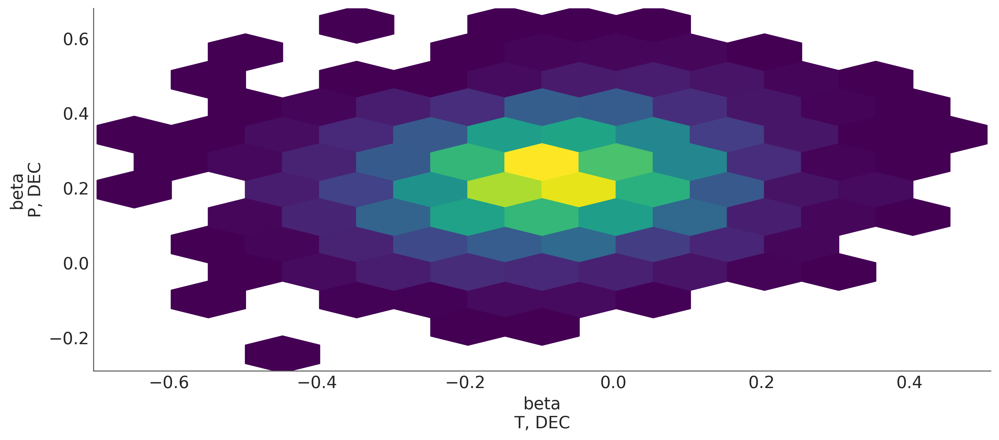

In [469]:
# are the betas correlated?
month=["DEC"]
print(float(xr.corr(Mesa_forward.train["P"].sel(month=month),Mesa_forward.train["T"].sel(month=month),dim=("year"))))
az.plot_pair(Mesa_forward.trace.posterior,var_names=["beta"],coords={"month":["DEC"]},kind="hexbin")
print(xr.corr(Mesa_forward.trace.posterior.beta.sel(variable="P").sel(month=month),\
        Mesa_forward.trace.posterior.beta.sel(variable="T").sel(month=month)))


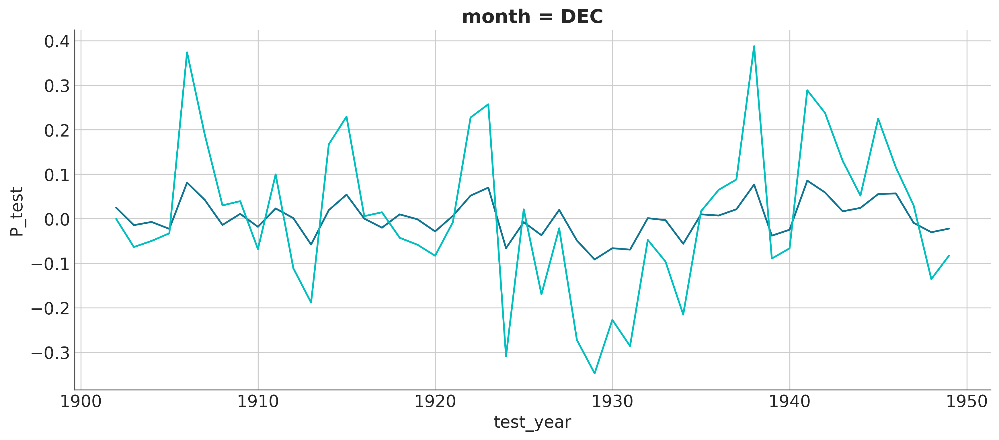

# Why isn't the correlated posterior translating to correlated P and T over the test period?

/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/arviz/plots/pairplot.py:232: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  gridsize = int(dataset.dims["draw"] ** 0.35)


array([[<Axes: >, None],
       [<Axes: xlabel='P_test\n1931, JUL', ylabel='T_test\n1931, JUL'>,
        <Axes: >]], dtype=object)

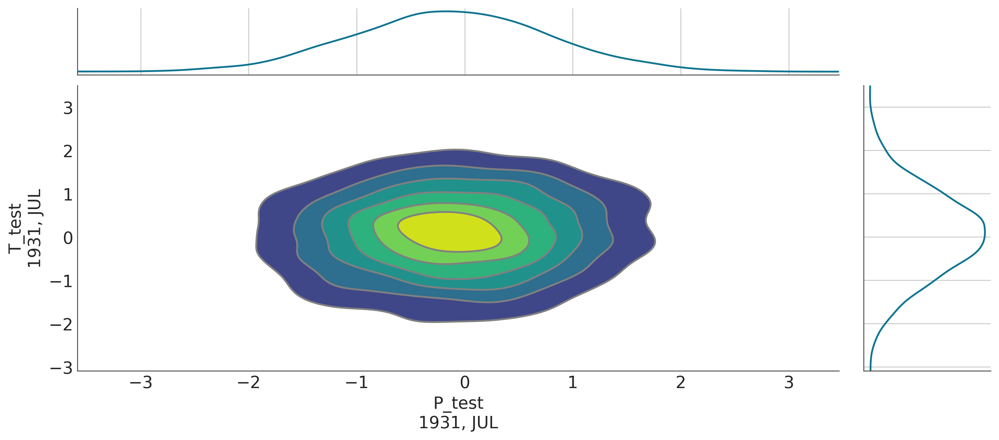

In [542]:
az.plot_pair(Kansas_paleo.trace.posterior,var_names=["P_test","T_test"],kind="kde",\
                  marginals=True,coords={"month":["JUL"],"test_year":[1931]})

/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/arviz/plots/pairplot.py:232: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  gridsize = int(dataset.dims["draw"] ** 0.35)


array([[<Axes: >, None],
       [<Axes: xlabel='beta\nT, JUL', ylabel='beta\nP, JUL'>, <Axes: >]],
      dtype=object)

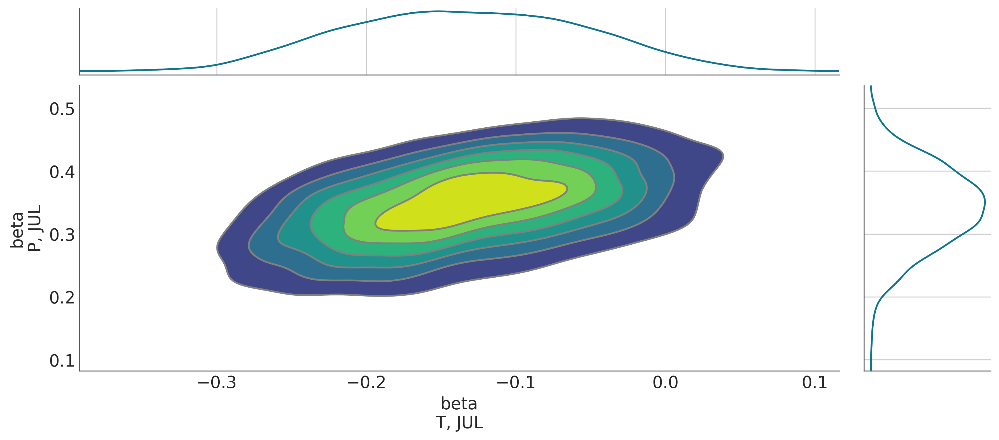

In [543]:
az.plot_pair(Kansas_paleo.trace.posterior,var_names=["beta"],kind="kde",\
                  marginals=True,coords={"month":["JUL"]})

In [424]:
sumtable_test=az.summary(Mesa_test.trace)
sumtable_forward=az.summary(Mesa_forward.trace)
sumtable_paleo=az.summary(Mesa_paleo.trace)

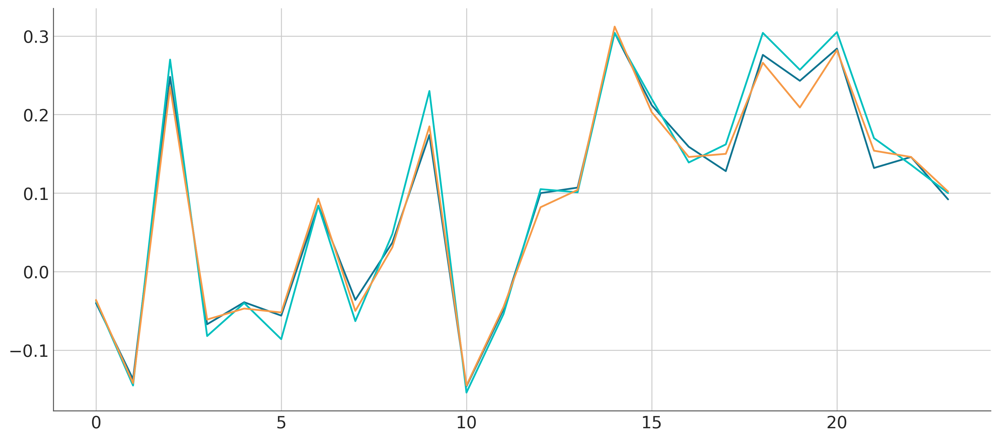

In [425]:
plt.plot(sumtable_test.iloc[:24][["mean"]].values.ravel())
plt.plot(sumtable_forward.iloc[:24][["mean"]].values.ravel())
plt.plot(sumtable_paleo.iloc[:24][["mean"]].values.ravel())

In [426]:
Mesa_paleo.trace

Inference data with groups:
	> posterior
	> sample_stats
	> observed_data

In [391]:
sumtablek

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
"beta[T, SEP]",0.020,0.067,-0.106,0.146,0.001,0.001,2518.0,2660.0,1.0
"beta[T, OCT]",0.045,0.086,-0.120,0.205,0.002,0.002,1609.0,2355.0,1.0
"beta[T, NOV]",-0.013,0.059,-0.123,0.095,0.001,0.001,2926.0,2986.0,1.0
"beta[T, DEC]",0.107,0.066,-0.009,0.238,0.001,0.001,2435.0,2409.0,1.0
"beta[T, JAN]",-0.050,0.084,-0.203,0.113,0.002,0.001,1695.0,2742.0,1.0
...,...,...,...,...,...,...,...,...,...
"P_unknown[1949, MAY]",0.247,0.987,-1.553,2.076,0.014,0.016,4622.0,2874.0,1.0
"P_unknown[1949, JUN]",0.435,0.965,-1.345,2.275,0.014,0.014,4812.0,3064.0,1.0
"P_unknown[1949, JUL]",0.644,0.921,-1.112,2.334,0.014,0.013,4240.0,2942.0,1.0
"P_unknown[1949, AUG]",0.530,0.960,-1.150,2.357,0.013,0.013,5242.0,2746.0,1.0


<Axes: >

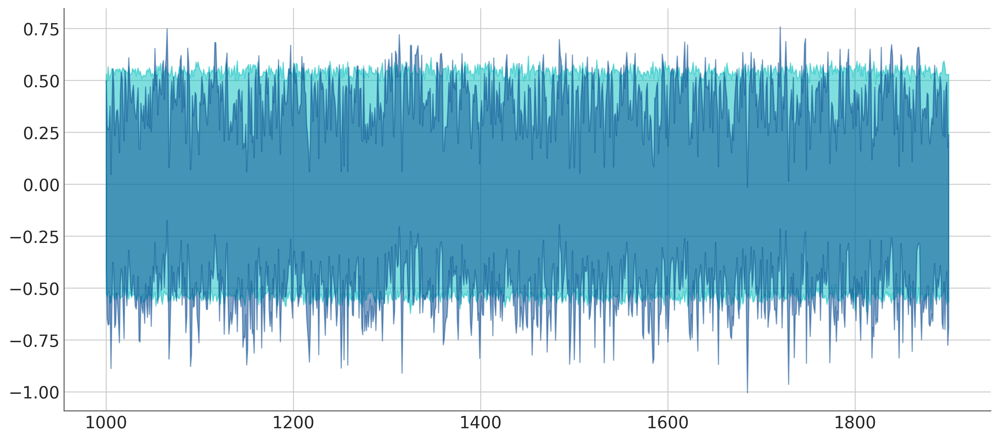

In [383]:
az.plot_hdi(Mesa.coords["fit_year"],Mesa.trace.posterior.T_fit.mean(dim="month"),smooth=False)
az.plot_hdi(Mesa.coords["fit_year"],Mesa.trace.posterior.P_fit.mean(dim="month"),smooth=False,color=cm.Blues(.9))

In [385]:
tmp=az.plot_posterior(Mesa.trace.posterior.beta.sel(variable="T"),ref_val=0.)

In [341]:
Kansas=Learner("DCK")
Kansas.sample()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [beta, sigma, T_unknown, P_unknown]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 9 seconds.


In [343]:
Sonora=Learner("SJC")
Sonora.sample()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [beta, sigma, T_unknown, P_unknown]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 10 seconds.


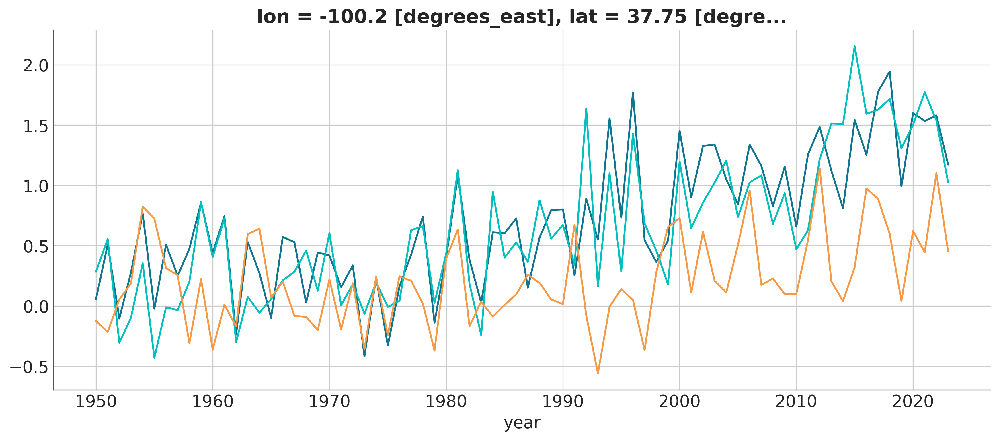

In [361]:
Mesa.train["T"].mean(dim="month").plot()
Sonora.train["T"].mean(dim="month").plot()
Kansas.train["T"].mean(dim="month").plot()

In [ ]:
# do the instrumental and tree ring records line up?

Text(0.5, 1.0, 'DCK')

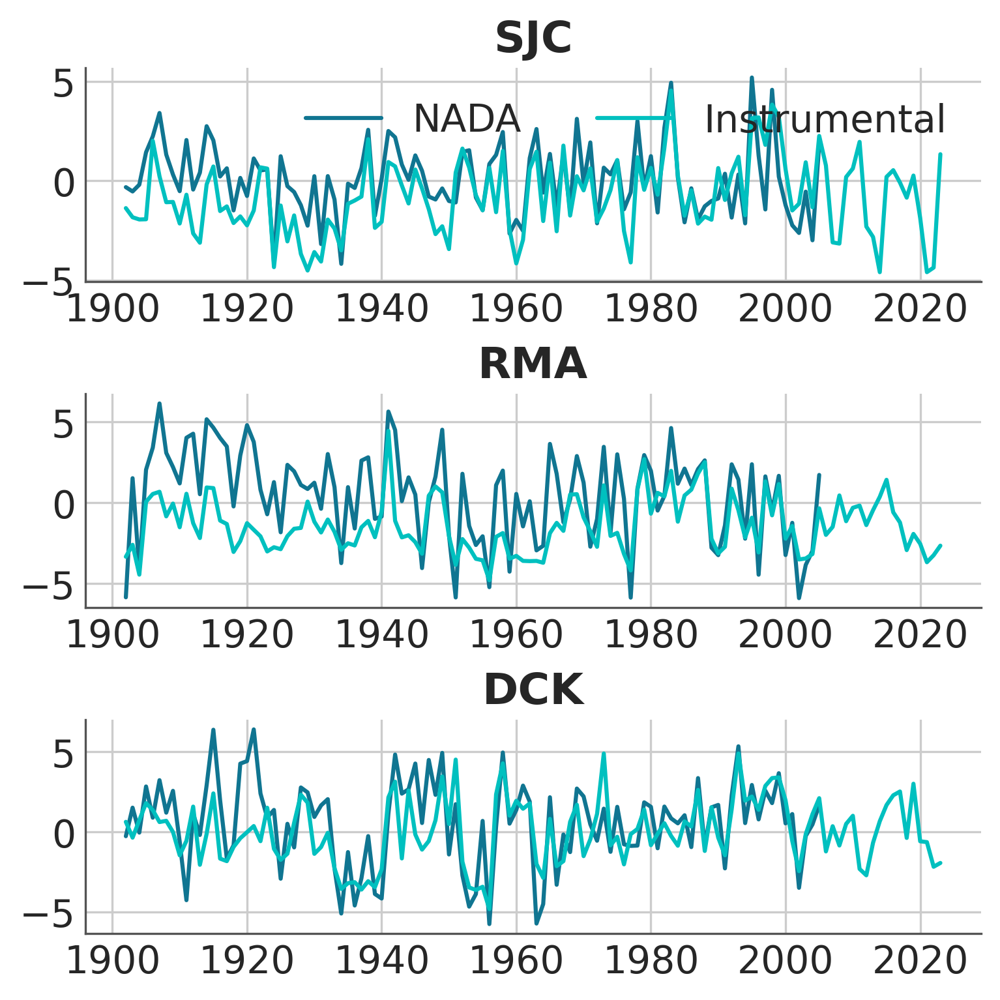

In [352]:
plt.figure(figsize=(5,5))
plt.subplot(311)
self=Sonora
Tnada=nada.sel(time=slice(1902,2005)).time
plt.plot(Tnada,nada.sel(lat=self.latitude,lon=self.longitude,time=slice(1902,2005)).pdsi.values,label="NADA")
self.raw["D"].time
Tcru=convert_timeaxis_years(self.raw["D"])
plt.plot(Tcru,self.raw["D"],label="Instrumental")
plt.legend(ncol=2)
plt.title("SJC")

plt.subplot(312)
self=Mesa
Tnada=nada.sel(time=slice(1902,2005)).time
plt.plot(Tnada,nada.sel(lat=self.latitude,lon=self.longitude,time=slice(1902,2005)).pdsi.values,label="NADA")
self.raw["D"].time
Tcru=convert_timeaxis_years(self.raw["D"])
plt.plot(Tcru,self.raw["D"],label="Instrumental")
#lt.legend(ncol=2)
plt.title("RMA")

plt.subplot(313)
self=Kansas
Tnada=nada.sel(time=slice(1902,2005)).time
plt.plot(Tnada,nada.sel(lat=self.latitude,lon=self.longitude,time=slice(1902,2005)).pdsi.values,label="NADA")
self.raw["D"].time
Tcru=convert_timeaxis_years(self.raw["D"])
plt.plot(Tcru,self.raw["D"],label="Instrumental")
#lt.legend(ncol=2)
plt.title("DCK")


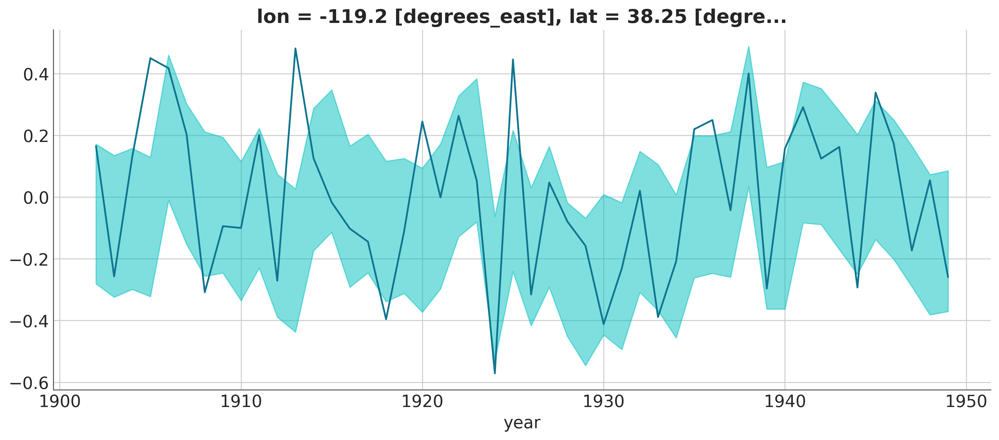

In [353]:
Sonora.plot_predictions("P")

Text(0.5, 1.0, 'P')

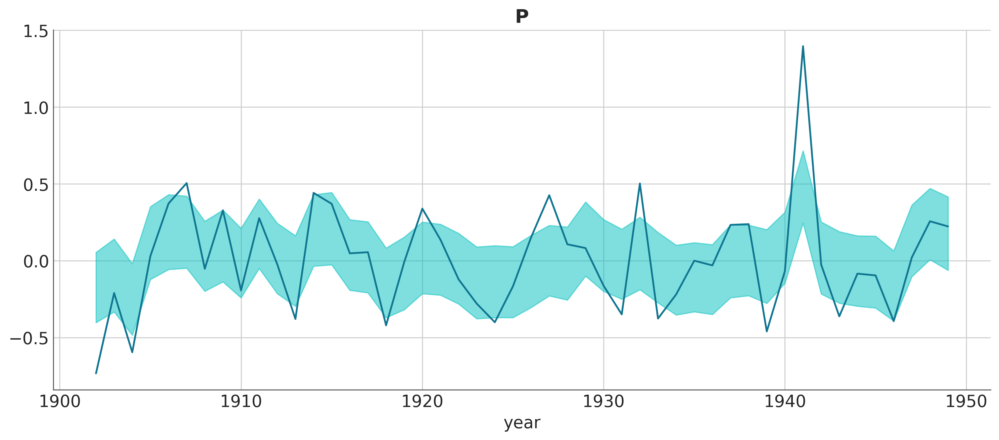

In [302]:
az.style.use("arviz-docgrid")
Mesa.plot_predictions("P")
plt.title("P")

In [297]:
flatposterior=Kansas.trace.posterior.beta.stack(samples=("chain","draw"))
flatposterior.sel(variable="P",month=["SEP"])

<xarray.DataArray 'beta' (month: 1, samples: 4000)> Size: 32kB
array([[0.14711911, 0.09600306, 0.11608763, ..., 0.09347717, 0.12986753,
        0.14138818]])
Coordinates:
    variable  <U1 4B 'P'
  * month     (month) <U3 12B 'SEP'
  * samples   (samples) object 32kB MultiIndex
  * chain     (samples) int64 32kB 0 0 0 0 0 0 0 0 0 0 0 ... 3 3 3 3 3 3 3 3 3 3
  * draw      (samples) int64 32kB 0 1 2 3 4 5 6 ... 993 994 995 996 997 998 999

In [290]:
az.plot_pair(Mesa.trace.posterior.beta.mean(dim="month"),var_names=["beta"],kind="hexbin",\
             coords={"variable":["P"]},marginals=True)

/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/arviz/plots/pairplot.py:232: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  gridsize = int(dataset.dims["draw"] ** 0.35)


ValueError: Number of variables to be plotted must be 2 or greater.

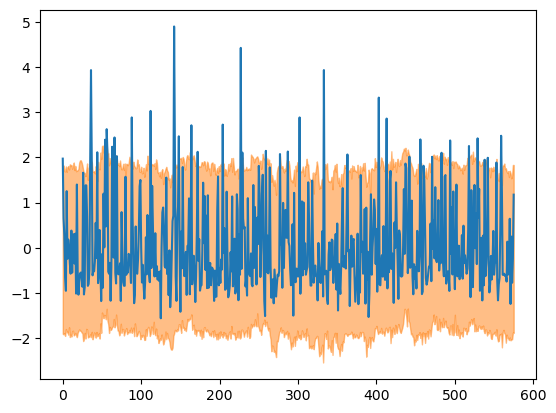

In [226]:
X=np.arange(576)
az.plot_hdi(X,learntrace.posterior.P_unknown.stack(time=("test_year","month")),smooth=False)
plt.plot(X,test["P"].stack(time=("year","month")).values)

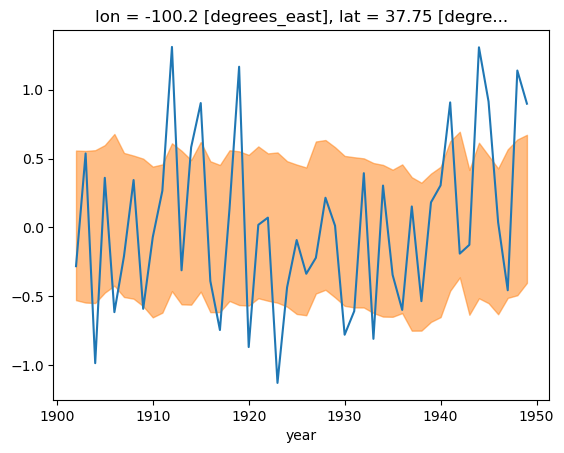

In [249]:
#testmonths=["DEC","JAN","FEB"]
#testmonths=["JUN","JUL","AUG"]
variable="P"
az.plot_hdi(coords["test_year"],getattr(Kansas.trace.posterior,variable+"_unknown")\
            .sel(month=testmonths)\
            .mean(dim="month"),smooth=False,hdi_prob=.66)
Kansas.test[variable].sel(month=testmonths).mean(dim="month").plot()

# Correlating T and PDSI
higher temperatures make drier soil moisture, except in regions where high temperatures melt snow (what's going in in FL though?  Just small correlations?  And is this all explained by the correlation between temperature and precipitation?

In [8]:
z_train,z_test=CRU.get_z(training_period=("1950-1-1","2023-8-31"),test_period=("1901-1-1","1949-12-31"))

/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


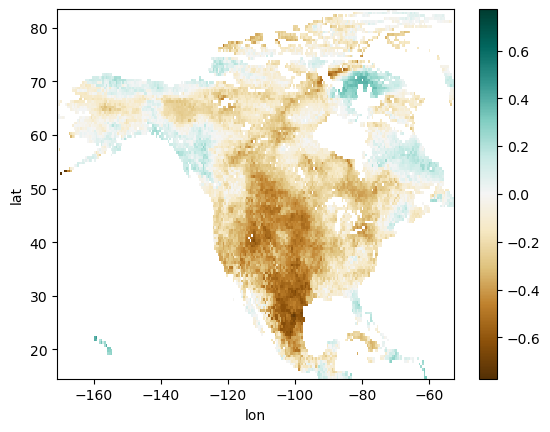

In [9]:
xr.corr(z_train.sel(variable="T"),z_train.sel(variable="PDSI"),dim="time").plot(cmap=cm.BrBG)

# Correlating P and T
When temperatures are higher, there is less rainfall.  It's hard to tease out the evaporative demand signal from the confounding signal of El Nino.

/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


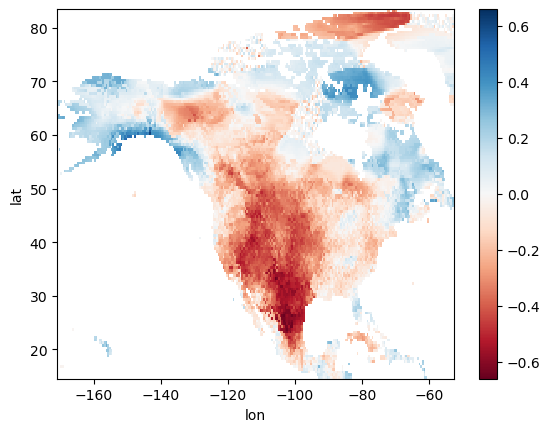

In [10]:
xr.corr(z_train.sel(variable="T"),z_train.sel(variable="P"),dim="time").plot(cmap=cm.RdBu)

In [11]:
# the correlation patterns are themselves highly correlated, suggesting that most of the T impact on PDSI is indirect, through its impact on P
float(xr.corr(xr.corr(z_train.sel(variable="T"),z_train.sel(variable="P"),dim="time"),\
xr.corr(z_train.sel(variable="T"),z_train.sel(variable="PDSI"),dim="time"),dim=("lat","lon")))

/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


0.7806495470597762

# Correlating P and PDSI
more rainfall makes wetter soil moisture (almost) everywhere.

/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/kmarvel/anaconda3/envs/pymc_env/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


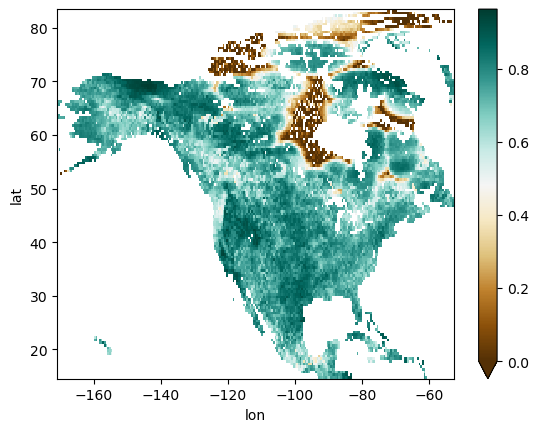

In [12]:
xr.corr(z_train.sel(variable="P"),z_train.sel(variable="PDSI"),dim="time").plot(cmap=cm.BrBG,vmin=0)

In [13]:
from eofs.xarray import Eof

## Temperature covariance
Obviously the overall trend explains most of the temperature variance

In [14]:
Teof=Eof(z_train.sel(variable="T"))
def plot_mode(X,mode):
    plt.figure(figsize=(10,5))
    plt.subplot(121)
    X.eofs().sel(mode=mode).plot()
    plt.subplot(122)
    X.pcs().sel(mode=mode).plot()
    plt.tight_layout()

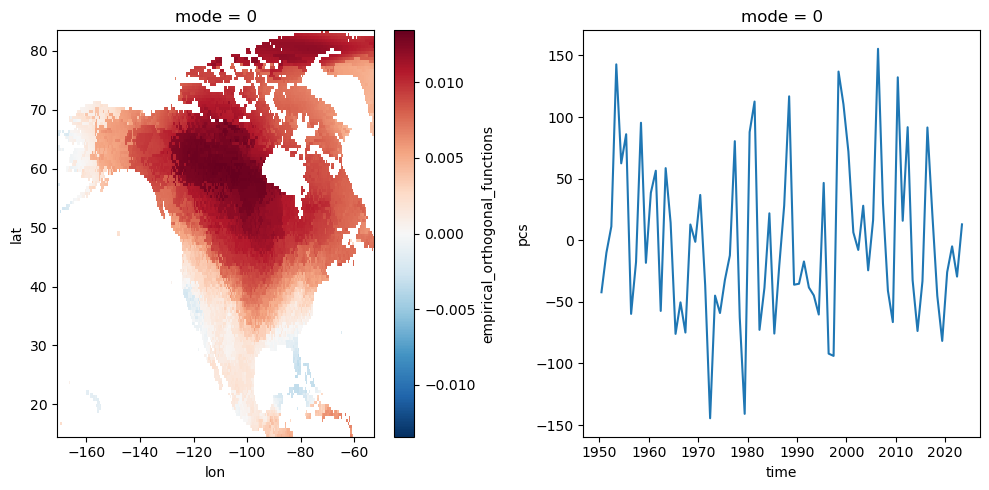

In [15]:
plot_mode(Teof,0)

In [16]:
import regionmask


In [17]:
def match_region_abbrev_to_number(regionabbrev):
    return regionmask.defined_regions.ar6.all.abbrevs.index(regionabbrev)
def coarsen(data):
    region_numbers=[match_region_abbrev_to_number(x) for x in ["NWN","NEN","WNA","CNA","ENA","NCA"]]
    mask=regionmask.defined_regions.ar6.land.mask_3D(data,use_cf=False)
    weights = np.cos(np.deg2rad(data.lat))
    return data.weighted(mask * weights).mean(dim=("lat", "lon")).sel(region=region_numbers)

In [21]:
def plot_NADA_regional(X,cmap=cm.BrBG,**kwargs):
    
    #lon=np.arange(-11, 180)
    #lat=np.arange(-20,90)
    lat = np.arange(20, 90)
    lon=np.arange(-170,-45)
    #lon=geda.lon
    #lat=geda.lat
    
    lon_edges=lon
    lat_edges=lat
    
    # for the plotting
    #lon_edges = np.arange(-180, 181)
    #lat_edges = np.arange(-90, 91)
    mask = regionmask.defined_regions.ar6.land.mask(lon, lat).values
    
    mask_ma = np.ma.masked_invalid(mask)
    my_mask=np.zeros_like(mask_ma)
    the_lag=-2
    
    for region in X.region:
        #regnum=match_region_abbrev_to_number(region)
        my_mask[mask_ma==region]=float(X.sel(region=region))
    
    proj = ccrs.PlateCarree()
    ax = plt.subplot(111, projection=proj)
    
    #mask_ma = np.ma.masked_invalid(mask)
    
    
    my_mask=np.ma.masked_where(my_mask==0,my_mask)
    h = ax.pcolormesh(lon_edges, lat_edges, my_mask, transform=ccrs.PlateCarree(), cmap=cmap,**kwargs)
    cbar=plt.colorbar(h,orientation="horizontal")
    
    ax.coastlines()
    return ax,cbar


In [22]:
def select_region(X,regions):
    if type(regions)==type(""):
        return X.sel(region=match_region_abbrev_to_number(regions))
    else:
        region_numbers=[match_region_abbrev_to_number(x) for x in regions]
        return X.sel(region=region_numbers)
        

In [2]:
CRU.data

NameError: name 'CRU' is not defined

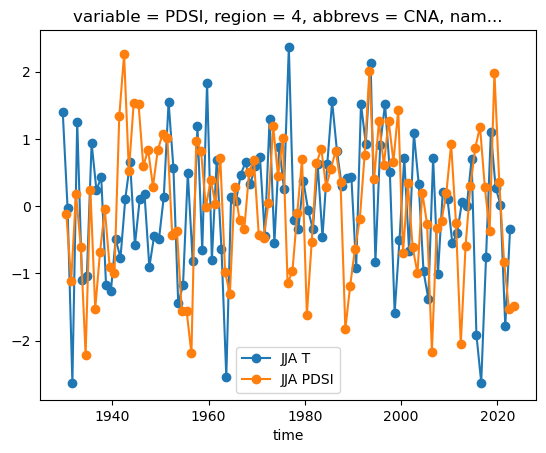

In [87]:
# why would anything depend on the temperature in SON the year before?
(-1*select_region(split.training["SON"],"CNA").sel(variable="T")).plot(label="JJA T",marker="o")
select_region(split.training["PDSI"],"CNA").plot(label="JJA PDSI",marker="o")
plt.legend()

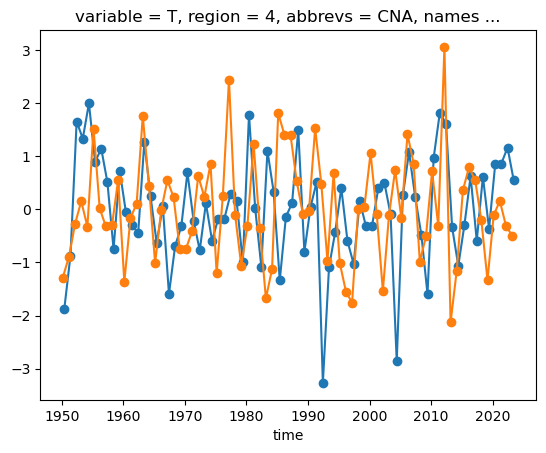

In [1694]:
select_region(split.training["JJA"],"CNA").sel(variable="T").plot(label="JJA T",marker="o")
select_region(split.training["MAM"],"CNA").sel(variable="T").plot(label="MAM T",marker="o")

In [88]:
from sklearn.neural_network import MLPRegressor

In [109]:
# Can I use a custom likelihood 
mylist=[split.training[s].expand_dims(season=[s]) for s in seasons]
#xr.concat([split.training[s].expand_dims(season=[s]) for s in seasons],dim=season)
xr.concat(mylist,dim="season")

<xarray.DataArray (season: 4, variable: 2, time: 376, region: 6)> Size: 144kB
array([[[[ 1.60814141, -0.36170635, -0.60725156, -1.39262971,
          -0.56212008, -0.75352892],
         [        nan,         nan,         nan,         nan,
                  nan,         nan],
         [        nan,         nan,         nan,         nan,
                  nan,         nan],
         ...,
         [        nan,         nan,         nan,         nan,
                  nan,         nan],
         [        nan,         nan,         nan,         nan,
                  nan,         nan],
         [        nan,         nan,         nan,         nan,
                  nan,         nan]],

        [[ 0.58550047, -0.41309034, -2.14698515,  0.95622201,
           1.6633146 , -0.34300818],
         [        nan,         nan,         nan,         nan,
                  nan,         nan],
         [        nan,         nan,         nan,         nan,
                  nan,         nan],
...
         [        nan,         nan,         nan,         nan,
                  nan,         nan],
         [        nan,         nan,         nan,         nan,
                  nan,         nan],
         [ 1.52965715,  0.53060485,  0.53886062,  0.88229393,
           0.08511335,  2.09342906]],

        [[        nan,         nan,         nan,         nan,
                  nan,         nan],
         [        nan,         nan,         nan,         nan,
                  nan,         nan],
         [        nan,         nan,         nan,         nan,
                  nan,         nan],
         ...,
         [        nan,         nan,         nan,         nan,
                  nan,         nan],
         [        nan,         nan,         nan,         nan,
                  nan,         nan],
         [-0.08046774, -0.57415443,  0.37088917, -0.97666806,
           0.98321248, -2.05102797]]]])
Coordinates:
  * variable  (variable) object 16B 'T' 'P'
  * time      (time) datetime64[ns] 3kB 1929-09-01 1929-12-01 ... 2023-06-01
  * region    (region) int64 48B 1 2 3 4 5 6
  * season    (season) object 32B 'SON' 'DJF' 'MAM' 'JJA'
    abbrevs   (region) <U3 72B 'NWN' 'NEN' 'WNA' 'CNA' 'ENA' 'NCA'
    names     (region) <U17 408B 'N.W.North-America' ... 'N.Central-America'

In [99]:
seasons = ["SON","DJF","MAM","JJA"]
xr.concat([split.training[s].expand_dims({"season":[s]}) for s in seasons],dim=season).stack(X=["season","variable","region"])

<xarray.DataArray (SON: 4, time: 376, X: 48)> Size: 578kB
array([[[        nan,         nan,         nan, ...,  0.95622201,
          1.6633146 , -0.34300818],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        ...,
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan]],

       [[        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [-0.18875098, -0.70410969,  0.09409516, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
...
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan]],

       [[        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        ...,
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan]]])
Coordinates:
  * time      (time) datetime64[ns] 3kB 1929-09-01 1929-12-01 ... 2023-06-01
    abbrevs   (X) <U3 576B 'NWN' 'NEN' 'WNA' 'CNA' ... 'WNA' 'CNA' 'ENA' 'NCA'
    names     (X) <U17 3kB 'N.W.North-America' ... 'N.Central-America'
  * X         (X) object 384B MultiIndex
  * season    (X) object 384B 'DJF' 'DJF' 'DJF' 'DJF' ... 'SON' 'SON' 'SON'
  * variable  (X) object 384B 'T' 'T' 'T' 'T' 'T' 'T' ... 'P' 'P' 'P' 'P' 'P'
  * region    (X) int64 384B 1 2 3 4 5 6 1 2 3 4 5 6 ... 1 2 3 4 5 6 1 2 3 4 5 6
Dimensions without coordinates: SON

In [97]:
s="DJF"
test=split.training[s].expand_dims({"season":[s]})
test.stack